In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [6]:
import requests
from bs4 import BeautifulSoup
from html_table_parser import parser_functions
from selenium import webdriver 

In [7]:
import re
import math
import pickle
import time

In [11]:
df = pd.read_csv('data_files/2000이후 데이터.csv', index_col='날짜')

In [12]:
for year in range(2000, 2023):
    globals()[f'df{year}'] = df[df['연도'] == year][['S&P500', '미국채10년', 'GSCI', '기준금리']]

In [13]:
df = df[['S&P500', '미국채10년', 'GSCI', '기준금리']]

In [14]:
df

,S&P500,미국채10년,GSCI,기준금리
날짜,,,,
2022-05-04,4300.17,2.946,3958.5029,1.5
2022-05-03,4175.48,2.975,3837.0591,1.5
2022-05-02,4155.38,2.977,3903.0850,1.5
2022-04-29,4131.93,2.938,3882.9910,1.5
2022-04-28,4287.50,2.832,3884.4270,1.5
...,...,...,...,...
2000-01-07,1441.50,6.513,2689.9790,5.0
2000-01-06,1403.50,6.540,2713.8350,5.0
2000-01-05,1402.10,6.599,2714.8110,5.0


## max 0.5, min 0.1 비율값 조합 가져오기

In [19]:
from itertools import *
from decimal import Decimal

In [20]:
i = Decimal('0.1')
li = []
while i <= Decimal('0.5'):
    li.append(i)
    i += Decimal('0.1')

In [21]:
com_li = list(product(li, repeat=4))

In [22]:
ratio_li = []
for i in com_li:
    if sum(i) == Decimal('1.0'):
        ratio_li.append(i)

In [23]:
len(ratio_li)

68

In [5]:
df365 = df.shift(253).loc['2021-05-04':]

NameError: name 'df' is not defined

In [6]:
df365

NameError: name 'df365' is not defined

In [287]:
money = 10000000
    
for year in range(2000, 2023):      
    sp_split_money = math.floor(money * 0.25)
    mi10_split_money = math.floor(money *  0.25)
    gsci_split_money = math.floor(money *  0.25)
    y_split_money = math.floor(money *  0.25)
    # print(sp_split_money, mi10_split_money, gsci_split_money, y_split_money)

    ## S&P지수
    sp_buy_price = df.loc[year]['S&P500']
    sp_num = int(sp_split_money / sp_buy_price)
    sp_buy_total_price = sp_buy_price * sp_num
    rest_money = sp_split_money - sp_buy_total_price
    sp_sell_price = df365.loc[year]['S&P500']
    sp_result = sp_sell_price * sp_num
    #         print(f"가격변화 {sp_buy_price} => {sp_sell_price} 이익율 {round((sp_sell_price - sp_buy_price) / sp_buy_price, 2)}, 결과 {round(sp_buy_total_price)} => {round(sp_result)}")

    ## 미국 10년채
    mi10_buy_rate = df.loc[year]['미국채10년'] 
    mi10_buy_price = 10000 / (1+mi10_buy_rate / 100)
    mi10_num = int(mi10_split_money / mi10_buy_price)

    # 구입당시 금리만큼 이자계산
    mi10_buy_total_price = mi10_buy_price * mi10_num
    rest_money += mi10_split_money - mi10_buy_total_price
    mi10_rate_price = mi10_buy_total_price * (mi10_buy_rate / 100)

    # 1년후 바뀐 가격으로 판매
    mi10_sell_rate = df365.loc[year]['미국채10년'] 
    mi10_sell_price = 10000 / (1+mi10_sell_rate / 100)
    mi10_sell_total_price = mi10_sell_price * mi10_num
    mi10_result = mi10_sell_total_price + mi10_rate_price
    #         print(f"금리변화 {mi10_buy_rate} => {mi10_sell_rate}, 가격 변화 {round(mi10_buy_total_price)} => {round(mi10_sell_total_price)}, 이자 {round(mi10_rate_price)}, 결과 {round(mi10_buy_total_price)} => {round(mi10_result)}")


    ## GSCI지수(원자재)
    gsci_buy_price = df.loc[year]['GSCI']
    gsci_num = int(gsci_split_money / gsci_buy_price)
    gsci_buy_total_price = gsci_buy_price * gsci_num
    rest_money += gsci_split_money - gsci_buy_total_price
    gsci_sell_price = df365.loc[year]['GSCI']
    gsci_result = gsci_sell_price * gsci_num
    #         print(f"가격변화 {gsci_buy_price} => {gsci_sell_price}, 이익율 {round((gsci_sell_price - gsci_buy_price) / gsci_buy_price, 2)}, 결과 {round(gsci_buy_total_price)} => {round(gsci_result)}")

    ## 예금
    y_rate = df.loc[year]['기준금리']
    y_price = (y_split_money + rest_money) * (y_rate/100)
    y_total_price = y_split_money + rest_money
    y_result = y_total_price + y_price
    #         print(f"금리 {y_rate}, 이자 {round(y_price)}, 결과 {round(y_total_price)} => {round(y_result)}")

    result = sp_result + mi10_result + gsci_result + y_result
    #         print('=' * 50)
    #         print(f"{date} 투자결과")
    #         print(f"투자액 {round(money)}, 1년후 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
    #         print('=' * 50)

KeyError: 2000

## 연도별 가장 이상적인 비율 구하기

In [16]:
max_ratio_dic = {}
for year in range(2000, 2023):
    max_money = 0
    print(f"{year}년 데이터 분석")
    for ratio in ratio_li:
        money = 10000000
    #     print(f"주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")
        df_year = globals()[f'df{year}']

        sp_split_money = math.floor(money * ratio[0])
        mi10_split_money = math.floor(money * ratio[1])
        gsci_split_money = math.floor(money * ratio[2])
        y_split_money = math.floor(money * ratio[3])
        # print(sp_split_money, mi10_split_money, gsci_split_money, y_split_money)

        # S&P지수
        sp_price = df_year.iloc[-1]['S&P500']
        sp_num = int(sp_split_money / sp_price)
        rest_money = sp_split_money - sp_price * sp_num
        sp_result = df_year.iloc[0]['S&P500'] * sp_num

        # 미국 10년채
        mi10_old_rate = df_year.iloc[-1]['미국채10년'] 
        mi10_old_price = 10000 / (1+mi10_old_rate / 100)
        mi10_num = int(mi10_split_money / mi10_old_price)

        # 구입당시 금리만큼 이자계산
        mi10_old_total_price = mi10_old_price * mi10_num
        rest_money += mi10_split_money - mi10_old_total_price
        mi10_rate_price = mi10_old_total_price * (mi10_old_rate / 100)


        # 1년후 바뀐 가격으로 판매
        mi10_new_rate = df_year.iloc[0]['미국채10년'] 
        mi10_new_price = 10000 / (1+mi10_new_rate / 100)
        mi10_new_total_price = mi10_new_price * mi10_num
        mi10_result = mi10_new_total_price + mi10_rate_price
        # print(f"금리변화 {mi10_old_rate} => {mi10_new_rate}, 금리변화에 따른 가격 변환 {round(mi10_old_total_price)} => {round(mi10_new_total_price)}, 이자: {round(mi10_rate_price)}, 최종결과: {round(mi10_result)}")


        # GSCI지수(원자재)
        gsci_buy_price = df_year.iloc[-1]['GSCI']
        gsci_num = int(gsci_split_money / gsci_buy_price)
        gsci_buy_total_price = gsci_buy_price * gsci_num
        rest_money += gsci_split_money - gsci_buy_total_price
        gsci_sell_price = df_year.iloc[0]['GSCI']
        gsci_result = gsci_sell_price * gsci_num
        # print(f"가격 {gsci_buy_price} => {gsci_sell_price}, 이익율 {round((gsci_sell_price - gsci_buy_price) / gsci_buy_price, 2)}, 결과 {round(gsci_buy_total_price)} => {round(gsci_result)}")

        # 예금
        y_rate = df_year.iloc[-1]['기준금리']
        y_price = (y_split_money + rest_money) * (y_rate/100)
        y_result = y_split_money + y_price + rest_money
        # print(f"이자율 {y_rate}, 이자 {y_price}, 수익금 {y_result}")

        result = sp_result + mi10_result + gsci_result + y_result
    #     print(f"투자금액 {round(money)}, 1년후 결과 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
        if result > max_money:
            max_money = result
            max_ratio = ratio
            print(f"주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")
            print(f"투자금액 {round(money)}, 1년후 결과 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
        money = math.floor(result)
    max_ratio_dic[f"{year}년"] = max_ratio
        
    

2000년 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11734395, 이익 1734395, 이익율 17.34%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12183043, 이익 2183043, 이익율 21.83%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12632933, 이익 2632933, 이익율 26.33%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12663087, 이익 2663087, 이익율 26.63%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12692959, 이익 2692959, 이익율 26.93%
2001년 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9312270, 이익 -687730, 이익율 -6.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9657693, 이익 -342307, 이익율 -3.42%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10004527, 이익 4527, 이익율 0.05%
2002년 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10894973, 이익 894973, 이익율 8.95%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11144729, 이익 1144729, 이익율 11.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11394485, 이익 1394485, 이익율 13.94%
주식 0.1, 채권 0

투자금액 10000000, 1년후 결과 9333497, 이익 -666503, 이익율 -6.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9689122, 이익 -310878, 이익율 -3.11%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10044747, 이익 44747, 이익율 0.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10057694, 이익 57694, 이익율 0.58%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10070641, 이익 70641, 이익율 0.71%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10130692, 이익 130692, 이익율 1.31%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10143639, 이익 143639, 이익율 1.44%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10156586, 이익 156586, 이익율 1.57%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10169532, 이익 169532, 이익율 1.7%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10216637, 이익 216637, 이익율 2.17%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10229584, 이익 229584, 이익율 2.3%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10242531, 이익 242531, 이익율 2.43%
주식 0.3, 채권 0.4,

In [17]:
for i in max_ratio_dic:
    ratio = max_ratio_dic[i]
    print(f"{i} 주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")

2000년 주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2001년 주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
2002년 주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2003년 주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2004년 주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2005년 주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2006년 주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2007년 주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2008년 주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
2009년 주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2010년 주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2011년 주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
2012년 주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
2013년 주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
2014년 주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2015년 주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
2016년 주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2017년 주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2018년 주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
2019년 주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2020년 주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2021년 주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2022년 주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3


## 매년 가장 이상적인 비율로 투자했을때

In [18]:
money = 10000000
print(f"주식 {ratio_li[0][0]}, 채권 {ratio_li[0][1]}, 원자재 {ratio_li[0][2]}, 예금 {ratio_li[0][3]}")
for year in range(2000, 2023):
    
    ratio = max_ratio_dic[f"{year}년"]
    df_year = globals()[f'df{year}']
    
    sp_split_money = math.floor(money * ratio[0])
    mi10_split_money = math.floor(money * ratio[1])
    gsci_split_money = math.floor(money * ratio[2])
    y_split_money = math.floor(money * ratio[3])
#     print(sp_split_money, mi10_split_money, gsci_split_money, y_split_money)
    
    # S&P지수
    sp_price = df_year.iloc[-1]['S&P500']
    sp_num = int(sp_split_money / sp_price)
    rest_money = sp_split_money - sp_price * sp_num
    sp_result = df_year.iloc[0]['S&P500'] * sp_num
    
    # 미국 10년채
    mi10_old_rate = df_year.iloc[-1]['미국채10년'] 
    mi10_old_price = 10000 / (1+mi10_old_rate / 100)
    mi10_num = int(mi10_split_money / mi10_old_price)
    
    # 구입당시 금리만큼 이자계산
    mi10_old_total_price = mi10_old_price * mi10_num
    rest_money += mi10_split_money - mi10_old_total_price
    mi10_rate_price = mi10_old_total_price * (mi10_old_rate / 100)
    
    
    # 1년후 바뀐 가격으로 판매
    mi10_new_rate = df_year.iloc[0]['미국채10년'] 
    mi10_new_price = 10000 / (1+mi10_new_rate / 100)
    mi10_new_total_price = mi10_new_price * mi10_num
    mi10_result = mi10_new_total_price + mi10_rate_price
#     print(f"금리변화 {mi10_old_rate} => {mi10_new_rate}, 금리변화에 따른 가격 변환 {round(mi10_old_total_price)} => {round(mi10_new_total_price)}, 이자: {round(mi10_rate_price)}, 최종결과: {round(mi10_result)}")
    
    
    # GSCI지수(원자재)
    gsci_buy_price = df_year.iloc[-1]['GSCI']
    gsci_num = int(gsci_split_money / gsci_buy_price)
    gsci_buy_total_price = gsci_buy_price * gsci_num
    rest_money += gsci_split_money - gsci_buy_total_price
    gsci_sell_price = df_year.iloc[0]['GSCI']
    gsci_result = gsci_sell_price * gsci_num
#     print(f"가격 {gsci_buy_price} => {gsci_sell_price}, 이익율 {round((gsci_sell_price - gsci_buy_price) / gsci_buy_price, 2)}, 결과 {round(gsci_buy_total_price)} => {round(gsci_result)}")
    
    # 예금
    y_rate = df_year.iloc[-1]['기준금리']
    y_price = (y_split_money + rest_money) * (y_rate/100)
    y_result = y_split_money + y_price + rest_money
#     print(f"이자율 {y_rate}, 이자 {y_price}, 수익금 {y_result}")
    
    result = sp_result + mi10_result + gsci_result + y_result
    print(f"투자금액 {round(money)}, 1년후 결과 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
    money = math.floor(result)
    

주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12692959, 이익 2692959, 이익율 26.93%
투자금액 12692958, 1년후 결과 12698337, 이익 5379, 이익율 0.04%
투자금액 12698336, 1년후 결과 14531119, 이익 1832783, 이익율 14.43%
투자금액 14531118, 1년후 결과 17048067, 이익 2516949, 이익율 17.32%
투자금액 17048067, 1년후 결과 19095441, 이익 2047374, 이익율 12.01%
투자금액 19095441, 1년후 결과 22146545, 이익 3051104, 이익율 15.98%
투자금액 22146544, 1년후 결과 23441030, 이익 1294486, 이익율 5.85%
투자금액 23441029, 1년후 결과 28432580, 이익 4991551, 이익율 21.29%
투자금액 28432579, 1년후 결과 27213628, 이익 -1218951, 이익율 -4.29%
투자금액 27213628, 1년후 결과 30840611, 이익 3626983, 이익율 13.33%
투자금액 30840611, 1년후 결과 33317567, 이익 2476956, 이익율 8.03%
투자금액 33317566, 1년후 결과 34272758, 이익 955192, 이익율 2.87%
투자금액 34272757, 1년후 결과 36573331, 이익 2300574, 이익율 6.71%
투자금액 36573330, 1년후 결과 41648220, 이익 5074890, 이익율 13.88%
투자금액 41648219, 1년후 결과 43483752, 이익 1835533, 이익율 4.41%
투자금액 43483752, 1년후 결과 42738407, 이익 -745345, 이익율 -1.71%
투자금액 42738407, 1년후 결과 46913247, 이익 4174840, 이익율 9.77%
투자금액 46913246, 1년후 결과 52506191, 이익 5592945,

## 일별 투자시 1년후 가장 좋은 수익 비율 구하기

In [19]:
max_ratio_dic = {}
max_money_dic = {}

for date in df365.index:
    max_money = 0
    print(f"{date} 데이터 분석")
    for ratio in ratio_li:
#         print(f"주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")
        money = 10000000
    
      
        sp_split_money = math.floor(money * ratio[0])
        mi10_split_money = math.floor(money * ratio[1])
        gsci_split_money = math.floor(money * ratio[2])
        y_split_money = math.floor(money * ratio[3])
        # print(sp_split_money, mi10_split_money, gsci_split_money, y_split_money)

        ## S&P지수
        sp_buy_price = df.loc[date]['S&P500']
        sp_num = int(sp_split_money / sp_buy_price)
        sp_buy_total_price = sp_buy_price * sp_num
        rest_money = sp_split_money - sp_buy_total_price
        sp_sell_price = df365.loc[date]['S&P500']
        sp_result = sp_sell_price * sp_num
#         print(f"가격변화 {sp_buy_price} => {sp_sell_price} 이익율 {round((sp_sell_price - sp_buy_price) / sp_buy_price, 2)}, 결과 {round(sp_buy_total_price)} => {round(sp_result)}")

        ## 미국 10년채
        mi10_buy_rate = df.loc[date]['미국채10년'] 
        mi10_buy_price = 10000 / (1+mi10_buy_rate / 100)
        mi10_num = int(mi10_split_money / mi10_buy_price)

        # 구입당시 금리만큼 이자계산
        mi10_buy_total_price = mi10_buy_price * mi10_num
        rest_money += mi10_split_money - mi10_buy_total_price
        mi10_rate_price = mi10_buy_total_price * (mi10_buy_rate / 100)

        # 1년후 바뀐 가격으로 판매
        mi10_sell_rate = df365.loc[date]['미국채10년'] 
        mi10_sell_price = 10000 / (1+mi10_sell_rate / 100)
        mi10_sell_total_price = mi10_sell_price * mi10_num
        mi10_result = mi10_sell_total_price + mi10_rate_price
#         print(f"금리변화 {mi10_buy_rate} => {mi10_sell_rate}, 가격 변화 {round(mi10_buy_total_price)} => {round(mi10_sell_total_price)}, 이자 {round(mi10_rate_price)}, 결과 {round(mi10_buy_total_price)} => {round(mi10_result)}")


        ## GSCI지수(원자재)
        gsci_buy_price = df.loc[date]['GSCI']
        gsci_num = int(gsci_split_money / gsci_buy_price)
        gsci_buy_total_price = gsci_buy_price * gsci_num
        rest_money += gsci_split_money - gsci_buy_total_price
        gsci_sell_price = df365.loc[date]['GSCI']
        gsci_result = gsci_sell_price * gsci_num
#         print(f"가격변화 {gsci_buy_price} => {gsci_sell_price}, 이익율 {round((gsci_sell_price - gsci_buy_price) / gsci_buy_price, 2)}, 결과 {round(gsci_buy_total_price)} => {round(gsci_result)}")

        ## 예금
        y_rate = df.loc[date]['기준금리']
        y_price = (y_split_money + rest_money) * (y_rate/100)
        y_total_price = y_split_money + rest_money
        y_result = y_total_price + y_price
#         print(f"금리 {y_rate}, 이자 {round(y_price)}, 결과 {round(y_total_price)} => {round(y_result)}")

        result = sp_result + mi10_result + gsci_result + y_result
#         print('=' * 50)
#         print(f"{date} 투자결과")
#         print(f"투자액 {round(money)}, 1년후 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
#         print('=' * 50)
        
        if result > max_money:
            max_money = result
            max_ratio = ratio
            print(f"주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")
            print(f"투자금액 {round(money)}, 1년후 결과 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
            
        
        money = math.floor(result)
    max_ratio_dic[date] = max_ratio
    max_money_dic[date] = max_money

2021-05-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11846788, 이익 1846788, 이익율 18.47%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12437289, 이익 2437289, 이익율 24.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13027790, 이익 3027790, 이익율 30.28%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13055315, 이익 3055315, 이익율 30.55%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13082840, 이익 3082840, 이익율 30.83%
2021-05-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11725524, 이익 1725524, 이익율 17.26%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12288762, 이익 2288762, 이익율 22.89%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12850623, 이익 2850623, 이익율 28.51%
2021-04-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11840288, 이익 1840288, 이익율 18.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12442361, 이익 2442361, 이익율 24.42%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13042972, 이익 3042972, 이

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13585609, 이익 3585609, 이익율 35.86%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13590995, 이익 3590995, 이익율 35.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13596381, 이익 3596381, 이익율 35.96%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13704273, 이익 3704273, 이익율 37.04%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13709658, 이익 3709658, 이익율 37.1%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13822936, 이익 3822936, 이익율 38.23%
2021-04-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12011825, 이익 2011825, 이익율 20.12%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12623769, 이익 2623769, 이익율 26.24%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13234322, 이익 3234322, 이익율 32.34%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13239074, 이익 3239074, 이익율 32.39%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13243827, 이익 3243827, 이익율 32.44%
주식 0.2, 채권 0.1, 원자재 0.5, 예

투자금액 10000000, 1년후 결과 12637555, 이익 2637555, 이익율 26.38%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12726894, 이익 2726894, 이익율 27.27%
2021-03-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11596272, 이익 1596272, 이익율 15.96%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12088049, 이익 2088049, 이익율 20.88%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12578666, 이익 2578666, 이익율 25.79%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12584453, 이익 2584453, 이익율 25.84%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12590182, 이익 2590182, 이익율 25.9%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12647630, 이익 2647630, 이익율 26.48%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12653416, 이익 2653416, 이익율 26.53%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12716594, 이익 2716594, 이익율 27.17%
2021-03-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11728606, 이익 1728606, 이익율 17.29%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 100

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12800313, 이익 2800313, 이익율 28.0%
2021-02-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11350299, 이익 1350299, 이익율 13.5%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11734802, 이익 1734802, 이익율 17.35%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12120210, 이익 2120210, 이익율 21.2%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12126223, 이익 2126223, 이익율 21.26%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12132177, 이익 2132177, 이익율 21.32%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12260141, 이익 2260141, 이익율 22.6%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12266154, 이익 2266154, 이익율 22.66%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12400072, 이익 2400072, 이익율 24.0%
2021-02-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11384332, 이익 1384332, 이익율 13.84%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11799392, 이익 1799392, 이익율 17.99%
주식 0.1, 채권 0

투자금액 10000000, 1년후 결과 12510814, 이익 2510814, 이익율 25.11%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12659259, 이익 2659259, 이익율 26.59%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12807704, 이익 2807704, 이익율 28.08%
2021-02-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11639878, 이익 1639878, 이익율 16.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12117513, 이익 2117513, 이익율 21.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12596177, 이익 2596177, 이익율 25.96%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12753413, 이익 2753413, 이익율 27.53%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12910649, 이익 2910649, 이익율 29.11%
2021-02-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11608142, 이익 1608142, 이익율 16.08%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12073027, 이익 2073027, 이익율 20.73%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12537913, 이익 2537913, 이익율 25.38%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 100

2021-01-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11481242, 이익 1481242, 이익율 14.81%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11876667, 이익 1876667, 이익율 18.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12272091, 이익 2272091, 이익율 22.72%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12520179, 이익 2520179, 이익율 25.2%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12768267, 이익 2768267, 이익율 27.68%
2021-01-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11488830, 이익 1488830, 이익율 14.89%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11883768, 이익 1883768, 이익율 18.84%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12278706, 이익 2278706, 이익율 22.79%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12534669, 이익 2534669, 이익율 25.35%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12790632, 이익 2790632, 이익율 27.91%
2021-01-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11620414, 이익 1620414, 이

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13062555, 이익 3062555, 이익율 30.63%
2020-12-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11587618, 이익 1587618, 이익율 15.88%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12013297, 이익 2013297, 이익율 20.13%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12438975, 이익 2438975, 이익율 24.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12700642, 이익 2700642, 이익율 27.01%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12963277, 이익 2963277, 이익율 29.63%
2020-12-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11509581, 이익 1509581, 이익율 15.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11914755, 이익 1914755, 이익율 19.15%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12319172, 이익 2319172, 이익율 23.19%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12566678, 이익 2566678, 이익율 25.67%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12814184, 이익 2814184, 이익율 28.14%
2020-12-

투자금액 10000000, 1년후 결과 13686872, 이익 3686872, 이익율 36.87%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 14071206, 이익 4071206, 이익율 40.71%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 14455540, 이익 4455540, 이익율 44.56%
2020-11-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12514427, 이익 2514427, 이익율 25.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13202915, 이익 3202915, 이익율 32.03%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13892564, 이익 3892564, 이익율 38.93%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 14295366, 이익 4295366, 이익율 42.95%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 14698167, 이익 4698167, 이익율 46.98%
2020-10-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12693801, 이익 2693801, 이익율 26.94%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13440175, 이익 3440175, 이익율 34.4%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 14185308, 이익 4185308, 이익율 41.85%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 100

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13816605, 이익 3816605, 이익율 38.17%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 14083821, 이익 4083821, 이익율 40.84%
2020-09-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12103859, 이익 2103859, 이익율 21.04%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12693658, 이익 2693658, 이익율 26.94%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13283458, 이익 3283458, 이익율 32.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13573697, 이익 3573697, 이익율 35.74%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13864913, 이익 3864913, 이익율 38.65%
2020-09-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12134772, 이익 2134772, 이익율 21.35%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12737060, 이익 2737060, 이익율 27.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13339349, 이익 3339349, 이익율 33.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13625967, 이익 3625967, 이익율 36.26%
주식 0.3,

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13077123, 이익 3077123, 이익율 30.77%
2020-08-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11569281, 이익 1569281, 이익율 15.69%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11979718, 이익 1979718, 이익율 19.8%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12390894, 이익 2390894, 이익율 23.91%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12683525, 이익 2683525, 이익율 26.84%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12977165, 이익 2977165, 이익율 29.77%
2020-08-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11649435, 이익 1649435, 이익율 16.49%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12082708, 이익 2082708, 이익율 20.83%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12516754, 이익 2516754, 이익율 25.17%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12821651, 이익 2821651, 이익율 28.22%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13127595, 이익 3127595, 이익율 31.28%
2020-08-

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13348212, 이익 3348212, 이익율 33.48%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13694607, 이익 3694607, 이익율 36.95%
2020-07-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11943733, 이익 1943733, 이익율 19.44%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12463152, 이익 2463152, 이익율 24.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12981672, 이익 2981672, 이익율 29.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13325674, 이익 3325674, 이익율 33.26%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13669676, 이익 3669676, 이익율 36.7%
2020-07-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12013267, 이익 2013267, 이익율 20.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12547572, 이익 2547572, 이익율 25.48%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13081877, 이익 3081877, 이익율 30.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13450294, 이익 3450294, 이익율 34.5%
주식 0.3, 채

2020-06-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12164314, 이익 2164314, 이익율 21.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12738080, 이익 2738080, 이익율 27.38%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13310901, 이익 3310901, 이익율 33.11%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13714011, 이익 3714011, 이익율 37.14%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 14115892, 이익 4115892, 이익율 41.16%
2020-06-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12225731, 이익 2225731, 이익율 22.26%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12813259, 이익 2813259, 이익율 28.13%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13400788, 이익 3400788, 이익율 34.01%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13821666, 이익 3821666, 이익율 38.22%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 14242544, 이익 4242544, 이익율 42.43%
2020-06-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12149817, 이익 2149817, 

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13340711, 이익 3340711, 이익율 33.41%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13689961, 이익 3689961, 이익율 36.9%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 14039211, 이익 4039211, 이익율 40.39%
2020-06-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12124635, 이익 2124635, 이익율 21.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12700182, 이익 2700182, 이익율 27.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13276649, 이익 3276649, 이익율 32.77%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13633052, 이익 3633052, 이익율 36.33%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13988359, 이익 3988359, 이익율 39.88%
2020-06-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12262113, 이익 2262113, 이익율 22.62%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12877992, 이익 2877992, 이익율 28.78%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13493870, 이익 3493870, 이익율 34.94%
주식 0.2, 채

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 14647859, 이익 4647859, 이익율 46.48%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 15106701, 이익 5106701, 이익율 51.07%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 15565544, 이익 5565544, 이익율 55.66%
2020-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 13030331, 이익 3030331, 이익율 30.3%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13864214, 이익 3864214, 이익율 38.64%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 14699221, 이익 4699221, 이익율 46.99%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 15162611, 이익 5162611, 이익율 51.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 15626001, 이익 5626001, 이익율 56.26%
2020-04-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12913297, 이익 2913297, 이익율 29.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13719334, 이익 3719334, 이익율 37.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 14525371, 이익 4525371, 이익율 45.25%
주식 0.2, 

투자금액 10000000, 1년후 결과 13982427, 이익 3982427, 이익율 39.82%
2020-04-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11874452, 이익 1874452, 이익율 18.74%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12268292, 이익 2268292, 이익율 22.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12662132, 이익 2662132, 이익율 26.62%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12900491, 이익 2900491, 이익율 29.0%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13294331, 이익 3294331, 이익율 32.94%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 13532691, 이익 3532691, 이익율 35.33%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13926530, 이익 3926530, 이익율 39.27%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 14164890, 이익 4164890, 이익율 41.65%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 14403249, 이익 4403249, 이익율 44.03%
2020-04-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12017992, 이익 2017992, 이익율 20.18%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 100

투자금액 10000000, 1년후 결과 14588729, 이익 4588729, 이익율 45.89%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 14837430, 이익 4837430, 이익율 48.37%
2020-03-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12026933, 이익 2026933, 이익율 20.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12468429, 이익 2468429, 이익율 24.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12910621, 이익 2910621, 이익율 29.11%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 13096377, 이익 3096377, 이익율 30.96%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13538569, 이익 3538569, 이익율 35.39%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 13724326, 이익 3724326, 이익율 37.24%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 14166518, 이익 4166518, 이익율 41.67%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 14352275, 이익 4352275, 이익율 43.52%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 14538728, 이익 4538728, 이익율 45.39%
2020-03-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10

2020-03-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10537357, 이익 537357, 이익율 5.37%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10605791, 이익 605791, 이익율 6.06%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10674076, 이익 674076, 이익율 6.74%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10683662, 이익 683662, 이익율 6.84%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10751947, 이익 751947, 이익율 7.52%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10820381, 이익 820381, 이익율 8.2%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10888665, 이익 888665, 이익율 8.89%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10898924, 이익 898924, 이익율 8.99%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10967209, 이익 967209, 이익율 9.67%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11035642, 이익 1035642, 이익율 10.36%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11103927, 이익 1103927, 이익율 11.04%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 1000000

투자금액 10000000, 1년후 결과 10258617, 이익 258617, 이익율 2.59%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10361050, 이익 361050, 이익율 3.61%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10398628, 이익 398628, 이익율 3.99%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10402159, 이익 402159, 이익율 4.02%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10405656, 이익 405656, 이익율 4.06%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10409187, 이익 409187, 이익율 4.09%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10545199, 이익 545199, 이익율 5.45%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10548696, 이익 548696, 이익율 5.49%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10552227, 이익 552227, 이익율 5.52%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10555723, 이익 555723, 이익율 5.56%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10559254, 이익 559254, 이익율 5.59%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10695769, 이익 695769, 이익율 6.96%
주식 0.4, 채권 0

투자금액 10000000, 1년후 결과 10866873, 이익 866873, 이익율 8.67%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10874666, 이익 874666, 이익율 8.75%
2020-02-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10175890, 이익 175890, 이익율 1.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10220207, 이익 220207, 이익율 2.2%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10264367, 이익 264367, 이익율 2.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10271871, 이익 271871, 이익율 2.72%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10279300, 이익 279300, 이익율 2.79%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10366438, 이익 366438, 이익율 3.66%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10410672, 이익 410672, 이익율 4.11%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10418102, 이익 418102, 이익율 4.18%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10425605, 이익 425605, 이익율 4.26%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10433035, 이익 433035, 이익율 4

투자금액 10000000, 1년후 결과 10571333, 이익 571333, 이익율 5.71%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10579843, 이익 579843, 이익율 5.8%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10588269, 이익 588269, 이익율 5.88%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10596778, 이익 596778, 이익율 5.97%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10707876, 이익 707876, 이익율 7.08%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10716386, 이익 716386, 이익율 7.16%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10724812, 이익 724812, 이익율 7.25%
2020-01-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9843968, 이익 -156032, 이익율 -1.56%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9989572, 이익 -10428, 이익율 -0.1%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10135094, 이익 135094, 이익율 1.35%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10143485, 이익 143485, 이익율 1.43%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10151793, 이익 151793, 이익율 1

투자금액 10000000, 1년후 결과 10104972, 이익 104972, 이익율 1.05%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10117273, 이익 117273, 이익율 1.17%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10129453, 이익 129453, 이익율 1.29%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10225776, 이익 225776, 이익율 2.26%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10238077, 이익 238077, 이익율 2.38%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10250378, 이익 250378, 이익율 2.5%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10262558, 이익 262558, 이익율 2.63%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10346580, 이익 346580, 이익율 3.47%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10358881, 이익 358881, 이익율 3.59%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10371181, 이익 371181, 이익율 3.71%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10383482, 이익 383482, 이익율 3.83%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10395662, 이익 395662, 이익율 3.96%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 10377399, 이익 377399, 이익율 3.77%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10466531, 이익 466531, 이익율 4.67%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10479767, 이익 479767, 이익율 4.8%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10493002, 이익 493002, 이익율 4.93%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10506238, 이익 506238, 이익율 5.06%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10608606, 이익 608606, 이익율 6.09%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10621841, 이익 621841, 이익율 6.22%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10635077, 이익 635077, 이익율 6.35%
2020-01-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9553778, 이익 -446222, 이익율 -4.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9808785, 이익 -191215, 이익율 -1.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10064429, 이익 64429, 이익율 0.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10078188, 이익 78188, 이익율 0

투자금액 10000000, 1년후 결과 10565124, 이익 565124, 이익율 5.65%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10581654, 이익 581654, 이익율 5.82%
2019-12-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9480594, 이익 -519406, 이익율 -5.19%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9761235, 이익 -238765, 이익율 -2.39%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10042555, 이익 42555, 이익율 0.43%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10059148, 이익 59148, 이익율 0.59%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10075740, 이익 75740, 이익율 0.76%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10157954, 이익 157954, 이익율 1.58%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10174546, 이익 174546, 이익율 1.75%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10191138, 이익 191138, 이익율 1.91%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10207730, 이익 207730, 이익율 2.08%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10273777, 이익 273777, 이익율 2

투자금액 10000000, 1년후 결과 10100237, 이익 100237, 이익율 1.0%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10210784, 이익 210784, 이익율 2.11%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10225133, 이익 225133, 이익율 2.25%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10239483, 이익 239483, 이익율 2.39%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10253691, 이익 253691, 이익율 2.54%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10349888, 이익 349888, 이익율 3.5%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10364238, 이익 364238, 이익율 3.64%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10378587, 이익 378587, 이익율 3.79%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10392937, 이익 392937, 이익율 3.93%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10407145, 이익 407145, 이익율 4.07%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10503825, 이익 503825, 이익율 5.04%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10518174, 이익 518174, 이익율 5.18%
주식 0.4, 채권 0.3

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10723790, 이익 723790, 이익율 7.24%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10738293, 이익 738293, 이익율 7.38%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10752796, 이익 752796, 이익율 7.53%
2019-11-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9552615, 이익 -447385, 이익율 -4.47%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9812868, 이익 -187132, 이익율 -1.87%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10073122, 이익 73122, 이익율 0.73%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10086764, 이익 86764, 이익율 0.87%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10100273, 이익 100273, 이익율 1.0%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10212821, 이익 212821, 이익율 2.13%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10226464, 이익 226464, 이익율 2.26%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10240106, 이익 240106, 이익율 2.4%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년

주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9405615, 이익 -594385, 이익율 -5.94%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9714332, 이익 -285668, 이익율 -2.86%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10023048, 이익 23048, 이익율 0.23%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10038590, 이익 38590, 이익율 0.39%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10054132, 이익 54132, 이익율 0.54%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10151527, 이익 151527, 이익율 1.52%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10167069, 이익 167069, 이익율 1.67%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10182610, 이익 182610, 이익율 1.83%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10198152, 이익 198152, 이익율 1.98%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10280456, 이익 280456, 이익율 2.8%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10295998, 이익 295998, 이익율 2.96%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10311539, 이익 

투자금액 10000000, 1년후 결과 10544571, 이익 544571, 이익율 5.45%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10561331, 이익 561331, 이익율 5.61%
2019-11-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9294492, 이익 -705508, 이익율 -7.06%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9635107, 이익 -364893, 이익율 -3.65%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9975722, 이익 -24278, 이익율 -0.24%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9991566, 이익 -8434, 이익율 -0.08%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10007411, 이익 7411, 이익율 0.07%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10087993, 이익 87993, 이익율 0.88%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10103837, 이익 103837, 이익율 1.04%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10119681, 이익 119681, 이익율 1.2%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10135526, 이익 135526, 이익율 1.36%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10200264, 이익 200264, 이익율 2.0

투자금액 10000000, 1년후 결과 9651745, 이익 -348255, 이익율 -3.48%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9974247, 이익 -25753, 이익율 -0.26%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9989970, 이익 -10030, 이익율 -0.1%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10005538, 이익 5538, 이익율 0.06%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10067870, 이익 67870, 이익율 0.68%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10083593, 이익 83593, 이익율 0.84%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10099315, 이익 99315, 이익율 0.99%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10114883, 이익 114883, 이익율 1.15%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10161493, 이익 161493, 이익율 1.61%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10177216, 이익 177216, 이익율 1.77%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10192938, 이익 192938, 이익율 1.93%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10208660, 이익 208660, 이익율 2.09%
주식 0.3, 채권 0.5, 원

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10196808, 이익 196808, 이익율 1.97%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10209792, 이익 209792, 이익율 2.1%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10222775, 이익 222775, 이익율 2.23%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10235631, 이익 235631, 이익율 2.36%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10331695, 이익 331695, 이익율 3.32%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10344678, 이익 344678, 이익율 3.45%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10357662, 이익 357662, 이익율 3.58%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10370645, 이익 370645, 이익율 3.71%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10383501, 이익 383501, 이익율 3.84%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10479565, 이익 479565, 이익율 4.8%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10492548, 이익 492548, 이익율 4.93%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10505532, 이익 

주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10019172, 이익 19172, 이익율 0.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10027392, 이익 27392, 이익율 0.27%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10035532, 이익 35532, 이익율 0.36%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10134652, 이익 134652, 이익율 1.35%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10142792, 이익 142792, 이익율 1.43%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10151012, 이익 151012, 이익율 1.51%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10159151, 이익 159151, 이익율 1.59%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10250052, 이익 250052, 이익율 2.5%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10258272, 이익 258272, 이익율 2.58%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10266412, 이익 266412, 이익율 2.66%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10274632, 이익 274632, 이익율 2.75%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10282771, 이익 28

투자금액 10000000, 1년후 결과 10161663, 이익 161663, 이익율 1.62%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10174807, 이익 174807, 이익율 1.75%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10212416, 이익 212416, 이익율 2.12%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10225559, 이익 225559, 이익율 2.26%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10238702, 이익 238702, 이익율 2.39%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10251717, 이익 251717, 이익율 2.52%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10302469, 이익 302469, 이익율 3.02%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10315613, 이익 315613, 이익율 3.16%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10328756, 이익 328756, 이익율 3.29%
2019-09-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9292391, 이익 -707609, 이익율 -7.08%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9620048, 이익 -379952, 이익율 -3.8%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9947593, 이익 -52407, 이익율 

투자금액 10000000, 1년후 결과 10392570, 이익 392570, 이익율 3.93%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10407393, 이익 407393, 이익율 4.07%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10422217, 이익 422217, 이익율 4.22%
2019-09-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9369369, 이익 -630631, 이익율 -6.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9689896, 이익 -310104, 이익율 -3.1%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10010424, 이익 10424, 이익율 0.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10026577, 이익 26577, 이익율 0.27%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10042730, 이익 42730, 이익율 0.43%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10110387, 이익 110387, 이익율 1.1%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10126540, 이익 126540, 이익율 1.27%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10142694, 이익 142694, 이익율 1.43%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10158847, 이익 158847, 이익율 1.59

투자금액 10000000, 1년후 결과 10136268, 이익 136268, 이익율 1.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10143940, 이익 143940, 이익율 1.44%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10151689, 이익 151689, 이익율 1.52%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10345575, 이익 345575, 이익율 3.46%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10353323, 이익 353323, 이익율 3.53%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10360996, 이익 360996, 이익율 3.61%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10368744, 이익 368744, 이익율 3.69%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10554958, 이익 554958, 이익율 5.55%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10562631, 이익 562631, 이익율 5.63%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10570379, 이익 570379, 이익율 5.7%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10578052, 이익 578052, 이익율 5.78%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10585800, 이익 585800, 이익율 5.86%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 9797158, 이익 -202842, 이익율 -2.03%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10063657, 이익 63657, 이익율 0.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10073944, 이익 73944, 이익율 0.74%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10084231, 이익 84231, 이익율 0.84%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10192783, 이익 192783, 이익율 1.93%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10202969, 이익 202969, 이익율 2.03%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10213256, 이익 213256, 이익율 2.13%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10223543, 이익 223543, 이익율 2.24%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10321809, 이익 321809, 이익율 3.22%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10332095, 이익 332095, 이익율 3.32%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10342281, 이익 342281, 이익율 3.42%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10352568, 이익 352568, 이익율 3.53%
주식 0.3, 채권 0.5

투자금액 10000000, 1년후 결과 10301074, 이익 301074, 이익율 3.01%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10314615, 이익 314615, 이익율 3.15%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10328024, 이익 328024, 이익율 3.28%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10341566, 이익 341566, 이익율 3.42%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10416157, 이익 416157, 이익율 4.16%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10429699, 이익 429699, 이익율 4.3%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10443240, 이익 443240, 이익율 4.43%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10456649, 이익 456649, 이익율 4.57%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10544782, 이익 544782, 이익율 5.45%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10558324, 이익 558324, 이익율 5.58%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10571865, 이익 571865, 이익율 5.72%
2019-08-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9544051, 이익 -455949, 이익율 -

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10152045, 이익 152045, 이익율 1.52%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10172701, 이익 172701, 이익율 1.73%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10193357, 이익 193357, 이익율 1.93%
2019-07-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9293209, 이익 -706791, 이익율 -7.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9627197, 이익 -372803, 이익율 -3.73%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9961184, 이익 -38816, 이익율 -0.39%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9981577, 이익 -18423, 이익율 -0.18%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10001969, 이익 1969, 이익율 0.02%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10004396, 이익 4396, 이익율 0.04%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10024788, 이익 24788, 이익율 0.25%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10045180, 이익 45180, 이익율 0.45%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 

투자금액 10000000, 1년후 결과 9578675, 이익 -421325, 이익율 -4.21%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9939397, 이익 -60603, 이익율 -0.61%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9957259, 이익 -42741, 이익율 -0.43%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9975122, 이익 -24878, 이익율 -0.25%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9992354, 이익 -7646, 이익율 -0.08%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10010217, 이익 10217, 이익율 0.1%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10028079, 이익 28079, 이익율 0.28%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10045311, 이익 45311, 이익율 0.45%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10063174, 이익 63174, 이익율 0.63%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10081036, 이익 81036, 이익율 0.81%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10098268, 이익 98268, 이익율 0.98%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10116131, 이익 116131, 이익율 1.16%
주식 0.5, 채권 0.2, 원자재

투자금액 10000000, 1년후 결과 9973792, 이익 -26208, 이익율 -0.26%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9974868, 이익 -25132, 이익율 -0.25%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9991171, 이익 -8829, 이익율 -0.09%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10007475, 이익 7475, 이익율 0.07%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10008451, 이익 8451, 이익율 0.08%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10024755, 이익 24755, 이익율 0.25%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10025731, 이익 25731, 이익율 0.26%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10042035, 이익 42035, 이익율 0.42%
2019-06-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9158035, 이익 -841965, 이익율 -8.42%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9531008, 이익 -468992, 이익율 -4.69%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9903090, 이익 -96910, 이익율 -0.97%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9919061, 이익 -80939, 이익율 -0.81%


주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9964526, 이익 -35474, 이익율 -0.35%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9968705, 이익 -31295, 이익율 -0.31%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9987321, 이익 -12679, 이익율 -0.13%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9991565, 이익 -8435, 이익율 -0.08%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9995744, 이익 -4256, 이익율 -0.04%
2019-06-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9324765, 이익 -675235, 이익율 -6.75%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9661357, 이익 -338643, 이익율 -3.39%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9997949, 이익 -2051, 이익율 -0.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10015959, 이익 15959, 이익율 0.16%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10033970, 이익 33970, 이익율 0.34%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10067440, 이익 67440, 이익율 0.67%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 

투자금액 10000000, 1년후 결과 10009599, 이익 9599, 이익율 0.1%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10029624, 이익 29624, 이익율 0.3%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10049845, 이익 49845, 이익율 0.5%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10067642, 이익 67642, 이익율 0.68%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10087666, 이익 87666, 이익율 0.88%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10107691, 이익 107691, 이익율 1.08%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10127912, 이익 127912, 이익율 1.28%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10145927, 이익 145927, 이익율 1.46%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10165952, 이익 165952, 이익율 1.66%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10185976, 이익 185976, 이익율 1.86%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10203970, 이익 203970, 이익율 2.04%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10223994, 이익 223994, 이익율 2.24%
주식 0.5, 채권 0.3, 원자재 0

2019-05-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8832759, 이익 -1167241, 이익율 -11.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9307042, 이익 -692958, 이익율 -6.93%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9781554, 이익 -218446, 이익율 -2.18%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9804957, 이익 -195043, 이익율 -1.95%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9828359, 이익 -171641, 이익율 -1.72%
2019-05-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8814451, 이익 -1185549, 이익율 -11.86%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9297195, 이익 -702805, 이익율 -7.03%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9780178, 이익 -219822, 이익율 -2.2%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9804579, 이익 -195421, 이익율 -1.95%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9829219, 이익 -170781, 이익율 -1.71%
2019-05-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8789585, 이익 -1210415, 이익율 -12

2019-04-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8726661, 이익 -1273339, 이익율 -12.73%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9232280, 이익 -767720, 이익율 -7.68%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9737625, 이익 -262375, 이익율 -2.62%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9765835, 이익 -234165, 이익율 -2.34%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9793771, 이익 -206229, 이익율 -2.06%
2019-04-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8812366, 이익 -1187634, 이익율 -11.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9294163, 이익 -705837, 이익율 -7.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9775689, 이익 -224311, 이익율 -2.24%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9803595, 이익 -196405, 이익율 -1.96%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9831230, 이익 -168770, 이익율 -1.69%
2019-04-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8789790, 이익 -1210210, 이익율 -1

2019-03-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8723410, 이익 -1276590, 이익율 -12.77%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9163496, 이익 -836504, 이익율 -8.37%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9603333, 이익 -396667, 이익율 -3.97%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9628963, 이익 -371037, 이익율 -3.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9654345, 이익 -345655, 이익율 -3.46%
2019-03-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8736018, 이익 -1263982, 이익율 -12.64%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9180620, 이익 -819380, 이익율 -8.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9624988, 이익 -375012, 이익율 -3.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9649086, 이익 -350914, 이익율 -3.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9672950, 이익 -327050, 이익율 -3.27%
2019-03-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8841625, 이익 -1158375, 이익율 -1

투자금액 10000000, 1년후 결과 10316427, 이익 316427, 이익율 3.16%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10341638, 이익 341638, 이익율 3.42%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10358517, 이익 358517, 이익율 3.59%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10383728, 이익 383728, 이익율 3.84%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10408694, 이익 408694, 이익율 4.09%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10433905, 이익 433905, 이익율 4.34%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10450784, 이익 450784, 이익율 4.51%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10475995, 이익 475995, 이익율 4.76%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10500961, 이익 500961, 이익율 5.01%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10517840, 이익 517840, 이익율 5.18%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10543051, 이익 543051, 이익율 5.43%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10568262, 이익 568262, 이익율 5.68%
2019-02-27 데

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10309192, 이익 309192, 이익율 3.09%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10382953, 이익 382953, 이익율 3.83%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10402949, 이익 402949, 이익율 4.03%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10422945, 이익 422945, 이익율 4.23%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10491507, 이익 491507, 이익율 4.92%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10565462, 이익 565462, 이익율 5.65%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10585264, 이익 585264, 이익율 5.85%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10605260, 이익 605260, 이익율 6.05%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10625256, 이익 625256, 이익율 6.25%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10747778, 이익 747778, 이익율 7.48%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10767774, 이익 767774, 이익율 7.68%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10787576, 이

주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10565127, 이익 565127, 이익율 5.65%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10585493, 이익 585493, 이익율 5.85%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10606058, 이익 606058, 이익율 6.06%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10724672, 이익 724672, 이익율 7.25%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10745237, 이익 745237, 이익율 7.45%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10765803, 이익 765803, 이익율 7.66%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10786169, 이익 786169, 이익율 7.86%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10806735, 이익 806735, 이익율 8.07%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10925348, 이익 925348, 이익율 9.25%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10945914, 이익 945914, 이익율 9.46%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10966480, 이익 966480, 이익율 9.66%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10986846, 이

투자금액 10000000, 1년후 결과 11013147, 이익 1013147, 이익율 10.13%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11034086, 이익 1034086, 이익율 10.34%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11055026, 이익 1055026, 이익율 10.55%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11075965, 이익 1075965, 이익율 10.76%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11224964, 이익 1224964, 이익율 12.25%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11245904, 이익 1245904, 이익율 12.46%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11266843, 이익 1266843, 이익율 12.67%
2019-01-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10320696, 이익 320696, 이익율 3.21%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10369453, 이익 369453, 이익율 3.69%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10418210, 이익 418210, 이익율 4.18%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10438582, 이익 438582, 이익율 4.39%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10459153, 이

투자금액 10000000, 1년후 결과 10864619, 이익 864619, 이익율 8.65%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10908025, 이익 908025, 이익율 9.08%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10926848, 이익 926848, 이익율 9.27%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10983130, 이익 983130, 이익율 9.83%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11026536, 이익 1026536, 이익율 10.27%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11069942, 이익 1069942, 이익율 10.7%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11113348, 이익 1113348, 이익율 11.13%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11156754, 이익 1156754, 이익율 11.57%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11231858, 이익 1231858, 이익율 12.32%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11275264, 이익 1275264, 이익율 12.75%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11318670, 이익 1318670, 이익율 13.19%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11362077, 이익 1362077, 이익율 13.6

2018-12-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10945087, 이익 945087, 이익율 9.45%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11101990, 이익 1101990, 이익율 11.02%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11258893, 이익 1258893, 이익율 12.59%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11276421, 이익 1276421, 이익율 12.76%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11293950, 이익 1293950, 이익율 12.94%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11384009, 이익 1384009, 이익율 13.84%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11540912, 이익 1540912, 이익율 15.41%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11558440, 이익 1558440, 이익율 15.58%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11666028, 이익 1666028, 이익율 16.66%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11822931, 이익 1822931, 이익율 18.23%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11948748, 이익 1948748, 이익율 19.49%
주식 0.5, 채권 0.1, 원자재 0.3, 예금

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11436752, 이익 1436752, 이익율 14.37%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11448571, 이익 1448571, 이익율 14.49%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11523174, 이익 1523174, 이익율 15.23%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11597602, 이익 1597602, 이익율 15.98%
2018-12-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10590315, 이익 590315, 이익율 5.9%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10651685, 이익 651685, 이익율 6.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10713055, 이익 713055, 이익율 7.13%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10734539, 이익 734539, 이익율 7.35%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10756024, 이익 756024, 이익율 7.56%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10800937, 이익 800937, 이익율 8.01%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10862307, 이익 862307, 이익율 8.62%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 100

투자금액 10000000, 1년후 결과 10416093, 이익 416093, 이익율 4.16%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10436727, 이익 436727, 이익율 4.37%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10440463, 이익 440463, 이익율 4.4%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10461097, 이익 461097, 이익율 4.61%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10464832, 이익 464832, 이익율 4.65%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10468567, 이익 468567, 이익율 4.69%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10481241, 이익 481241, 이익율 4.81%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10501876, 이익 501876, 이익율 5.02%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10522510, 이익 522510, 이익율 5.23%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10526245, 이익 526245, 이익율 5.26%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10546879, 이익 546879, 이익율 5.47%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10550614, 이익 550614, 이익율 5.51%
주식 0.2, 채권 0.

투자금액 10000000, 1년후 결과 10586882, 이익 586882, 이익율 5.87%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10615418, 이익 615418, 이익율 6.15%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10669092, 이익 669092, 이익율 6.69%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10697628, 이익 697628, 이익율 6.98%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10726164, 이익 726164, 이익율 7.26%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10754700, 이익 754700, 이익율 7.55%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10783236, 이익 783236, 이익율 7.83%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10836465, 이익 836465, 이익율 8.36%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10865001, 이익 865001, 이익율 8.65%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10893537, 이익 893537, 이익율 8.94%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10922073, 이익 922073, 이익율 9.22%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11003839, 이익 1003839, 이익율 10.04%
주식 0.5, 채권

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10375468, 이익 375468, 이익율 3.75%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10405943, 이익 405943, 이익율 4.06%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10431761, 이익 431761, 이익율 4.32%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10461943, 이익 461943, 이익율 4.62%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10492418, 이익 492418, 이익율 4.92%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10518479, 이익 518479, 이익율 5.18%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10548661, 이익 548661, 이익율 5.49%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10574772, 이익 574772, 이익율 5.75%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10604954, 이익 604954, 이익율 6.05%
2018-11-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10027598, 이익 27598, 이익율 0.28%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10135980, 이익 135980, 이익율 1.36%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10270914, 이익 270914, 이익율 2.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10300556, 이익 300556, 이익율 3.01%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10346817, 이익 346817, 이익율 3.47%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10376459, 이익 376459, 이익율 3.76%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10406100, 이익 406100, 이익율 4.06%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10435742, 이익 435742, 이익율 4.36%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10452004, 이익 452004, 이익율 4.52%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10481646, 이익 481646, 이익율 4.82%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10511288, 이익 511288, 이익율 5.11%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10540930, 이익 540930, 이익율 5.41%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10570572, 이익 570572, 이익율 5.71%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10587190, 이익 587190, 이익율 5.87%
주식 0.4, 채권 0

투자금액 10000000, 1년후 결과 10403967, 이익 403967, 이익율 4.04%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10418044, 이익 418044, 이익율 4.18%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10448376, 이익 448376, 이익율 4.48%
2018-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9751573, 이익 -248427, 이익율 -2.48%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9946964, 이익 -53036, 이익율 -0.53%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10142355, 이익 142355, 이익율 1.42%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10172952, 이익 172952, 이익율 1.73%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10203548, 이익 203548, 이익율 2.04%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10207715, 이익 207715, 이익율 2.08%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10238312, 이익 238312, 이익율 2.38%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10268908, 이익 268908, 이익율 2.69%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10273257, 이익 273257, 이익율

2018-09-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9842704, 이익 -157296, 이익율 -1.57%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9988084, 이익 -11916, 이익율 -0.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10133788, 이익 133788, 이익율 1.34%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10162632, 이익 162632, 이익율 1.63%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10191476, 이익 191476, 이익율 1.91%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10205309, 이익 205309, 이익율 2.05%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10219141, 이익 219141, 이익율 2.19%
2018-09-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9848250, 이익 -151750, 이익율 -1.52%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9992244, 이익 -7756, 이익율 -0.08%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10136238, 이익 136238, 이익율 1.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10164916, 이익 164916, 이익율 1.65%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 

주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10158829, 이익 158829, 이익율 1.59%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10169478, 이익 169478, 이익율 1.69%
2018-08-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9734697, 이익 -265303, 이익율 -2.65%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9908664, 이익 -91336, 이익율 -0.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10082630, 이익 82630, 이익율 0.83%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10109937, 이익 109937, 이익율 1.1%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10137243, 이익 137243, 이익율 1.37%
2018-08-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9654375, 이익 -345625, 이익율 -3.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9850841, 이익 -149159, 이익율 -1.49%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10047307, 이익 47307, 이익율 0.47%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10075233, 이익 75233, 이익율 0.75%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.

2018-08-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9730447, 이익 -269553, 이익율 -2.7%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9908210, 이익 -91790, 이익율 -0.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10085973, 이익 85973, 이익율 0.86%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10112858, 이익 112858, 이익율 1.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10139742, 이익 139742, 이익율 1.4%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10145805, 이익 145805, 이익율 1.46%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10151868, 이익 151868, 이익율 1.52%
2018-08-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9715470, 이익 -284530, 이익율 -2.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9900681, 이익 -99319, 이익율 -0.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10086326, 이익 86326, 이익율 0.86%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10112843, 이익 112843, 이익율 1.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3

투자금액 10000000, 1년후 결과 10375086, 이익 375086, 이익율 3.75%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10398286, 이익 398286, 이익율 3.98%
2018-07-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9949118, 이익 -50882, 이익율 -0.51%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10066697, 이익 66697, 이익율 0.67%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10184021, 이익 184021, 이익율 1.84%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10206274, 이익 206274, 이익율 2.06%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10228527, 이익 228527, 이익율 2.29%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10246747, 이익 246747, 이익율 2.47%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10269000, 이익 269000, 이익율 2.69%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10291253, 이익 291253, 이익율 2.91%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10309473, 이익 309473, 이익율 3.09%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10331726, 이익 331726, 이익율 3

주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10193940, 이익 193940, 이익율 1.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10214548, 이익 214548, 이익율 2.15%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10215181, 이익 215181, 이익율 2.15%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10235789, 이익 235789, 이익율 2.36%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10256398, 이익 256398, 이익율 2.56%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10277006, 이익 277006, 이익율 2.77%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10277639, 이익 277639, 이익율 2.78%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10298247, 이익 298247, 이익율 2.98%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10318856, 이익 318856, 이익율 3.19%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10339464, 이익 339464, 이익율 3.39%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10340097, 이익 340097, 이익율 3.4%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10360705, 이익

투자금액 10000000, 1년후 결과 10220111, 이익 220111, 이익율 2.2%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10239806, 이익 239806, 이익율 2.4%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10260893, 이익 260893, 이익율 2.61%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10281980, 이익 281980, 이익율 2.82%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10303067, 이익 303067, 이익율 3.03%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10322986, 이익 322986, 이익율 3.23%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10344073, 이익 344073, 이익율 3.44%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10365161, 이익 365161, 이익율 3.65%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10386248, 이익 386248, 이익율 3.86%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10405942, 이익 405942, 이익율 4.06%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10427029, 이익 427029, 이익율 4.27%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10448117, 이익 448117, 이익율 4.48%
주식 0.5, 채권 0.1

투자금액 10000000, 1년후 결과 10135609, 이익 135609, 이익율 1.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10158599, 이익 158599, 이익율 1.59%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10181589, 이익 181589, 이익율 1.82%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10196437, 이익 196437, 이익율 1.96%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10219426, 이익 219426, 이익율 2.19%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10234274, 이익 234274, 이익율 2.34%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10257264, 이익 257264, 이익율 2.57%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10272112, 이익 272112, 이익율 2.72%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10286855, 이익 286855, 이익율 2.87%
2018-06-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9795899, 이익 -204101, 이익율 -2.04%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9955535, 이익 -44465, 이익율 -0.44%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10115546, 이익 115546, 이익율

투자금액 10000000, 1년후 결과 10087241, 이익 87241, 이익율 0.87%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10108831, 이익 108831, 이익율 1.09%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10127318, 이익 127318, 이익율 1.27%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10145805, 이익 145805, 이익율 1.46%
2018-05-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9719709, 이익 -280291, 이익율 -2.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9897955, 이익 -102045, 이익율 -1.02%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10076200, 이익 76200, 이익율 0.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10097065, 이익 97065, 이익율 0.97%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10117930, 이익 117930, 이익율 1.18%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10118311, 이익 118311, 이익율 1.18%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10139175, 이익 139175, 이익율 1.39%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10139499, 이익 139499, 이익율 1.

투자금액 10000000, 1년후 결과 10222735, 이익 222735, 이익율 2.23%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10242134, 이익 242134, 이익율 2.42%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10261534, 이익 261534, 이익율 2.62%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10262427, 이익 262427, 이익율 2.62%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10281827, 이익 281827, 이익율 2.82%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10301227, 이익 301227, 이익율 3.01%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10320626, 이익 320626, 이익율 3.21%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10321520, 이익 321520, 이익율 3.22%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10340919, 이익 340919, 이익율 3.41%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10360319, 이익 360319, 이익율 3.6%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10361212, 이익 361212, 이익율 3.61%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10380612, 이익 380612, 이익율 3.81%
주식 0.5, 채권 0.

투자금액 10000000, 1년후 결과 10289746, 이익 289746, 이익율 2.9%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10329099, 이익 329099, 이익율 3.29%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10349338, 이익 349338, 이익율 3.49%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10369577, 이익 369577, 이익율 3.7%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10389816, 이익 389816, 이익율 3.9%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10408930, 이익 408930, 이익율 4.09%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10429169, 이익 429169, 이익율 4.29%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10449409, 이익 449409, 이익율 4.49%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10469648, 이익 469648, 이익율 4.7%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10489887, 이익 489887, 이익율 4.9%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10509001, 이익 509001, 이익율 5.09%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10529240, 이익 529240, 이익율 5.29%
주식 0.4, 채권 0.3, 원

투자금액 10000000, 1년후 결과 10250789, 이익 250789, 이익율 2.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10267042, 이익 267042, 이익율 2.67%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10293894, 이익 293894, 이익율 2.94%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10310147, 이익 310147, 이익율 3.1%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10326400, 이익 326400, 이익율 3.26%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10342654, 이익 342654, 이익율 3.43%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10353454, 이익 353454, 이익율 3.53%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10369707, 이익 369707, 이익율 3.7%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10385960, 이익 385960, 이익율 3.86%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10402213, 이익 402213, 이익율 4.02%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10418467, 이익 418467, 이익율 4.18%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10429065, 이익 429065, 이익율 4.29%
주식 0.4, 채권 0.2

투자금액 10000000, 1년후 결과 10241697, 이익 241697, 이익율 2.42%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10262862, 이익 262862, 이익율 2.63%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10284010, 이익 284010, 이익율 2.84%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10298237, 이익 298237, 이익율 2.98%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10312604, 이익 312604, 이익율 3.13%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10346326, 이익 346326, 이익율 3.46%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10367474, 이익 367474, 이익율 3.67%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10381840, 이익 381840, 이익율 3.82%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10396068, 이익 396068, 이익율 3.96%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10410434, 이익 410434, 이익율 4.1%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10450937, 이익 450937, 이익율 4.51%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10465304, 이익 465304, 이익율 4.65%
주식 0.3, 채권 0.

투자금액 10000000, 1년후 결과 10200388, 이익 200388, 이익율 2.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10227057, 이익 227057, 이익율 2.27%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10243712, 이익 243712, 이익율 2.44%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10260367, 이익 260367, 이익율 2.6%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10264424, 이익 264424, 이익율 2.64%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10281079, 이익 281079, 이익율 2.81%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10297734, 이익 297734, 이익율 2.98%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10301690, 이익 301690, 이익율 3.02%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10318345, 이익 318345, 이익율 3.18%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10335000, 이익 335000, 이익율 3.35%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10339057, 이익 339057, 이익율 3.39%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10355712, 이익 355712, 이익율 3.56%
주식 0.5, 채권 0.2

투자금액 10000000, 1년후 결과 10201124, 이익 201124, 이익율 2.01%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10203906, 이익 203906, 이익율 2.04%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10221200, 이익 221200, 이익율 2.21%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10223982, 이익 223982, 이익율 2.24%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10241276, 이익 241276, 이익율 2.41%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10244058, 이익 244058, 이익율 2.44%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10246840, 이익 246840, 이익율 2.47%
2018-02-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10076262, 이익 76262, 이익율 0.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10126841, 이익 126841, 이익율 1.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10177420, 이익 177420, 이익율 1.77%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10193656, 이익 193656, 이익율 1.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10209892, 이익 209892, 이익율 2

주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10130605, 이익 130605, 이익율 1.31%
2018-02-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9846847, 이익 -153153, 이익율 -1.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9958909, 이익 -41091, 이익율 -0.41%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10070971, 이익 70971, 이익율 0.71%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10085777, 이익 85777, 이익율 0.86%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10100583, 이익 100583, 이익율 1.01%
2018-02-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9792854, 이익 -207146, 이익율 -2.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9915063, 이익 -84937, 이익율 -0.85%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10037272, 이익 37272, 이익율 0.37%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10050880, 이익 50880, 이익율 0.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10064356, 이익 64356, 이익율 0.64%
2018-01-31 데이터 분석
주식 0.1, 채권 0.1

2018-01-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9707378, 이익 -292622, 이익율 -2.93%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9839907, 이익 -160093, 이익율 -1.6%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9972510, 이익 -27490, 이익율 -0.27%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9980070, 이익 -19930, 이익율 -0.2%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9987703, 이익 -12297, 이익율 -0.12%
2017-12-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9646809, 이익 -353191, 이익율 -3.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9791515, 이익 -208485, 이익율 -2.08%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9936296, 이익 -63704, 이익율 -0.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9943882, 이익 -56118, 이익율 -0.56%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9951543, 이익 -48457, 이익율 -0.48%
2017-12-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9657132, 이익 -342868, 이익율 -3.43%
주식 0.1, 

투자금액 10000000, 1년후 결과 10128456, 이익 128456, 이익율 1.28%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10131974, 이익 131974, 이익율 1.32%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10134770, 이익 134770, 이익율 1.35%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10138289, 이익 138289, 이익율 1.38%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10141807, 이익 141807, 이익율 1.42%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10145360, 이익 145360, 이익율 1.45%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10148878, 이익 148878, 이익율 1.49%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10151675, 이익 151675, 이익율 1.52%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10155193, 이익 155193, 이익율 1.55%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10158711, 이익 158711, 이익율 1.59%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10162264, 이익 162264, 이익율 1.62%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10168579, 이익 168579, 이익율 1.69%
주식 0.5, 채권 0

투자금액 10000000, 1년후 결과 10331511, 이익 331511, 이익율 3.32%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10334568, 이익 334568, 이익율 3.35%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10339078, 이익 339078, 이익율 3.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10370779, 이익 370779, 이익율 3.71%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10373807, 이익 373807, 이익율 3.74%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10381374, 이익 381374, 이익율 3.81%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10413075, 이익 413075, 이익율 4.13%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10423670, 이익 423670, 이익율 4.24%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10434344, 이익 434344, 이익율 4.34%
2017-11-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10286207, 이익 286207, 이익율 2.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10319268, 이익 319268, 이익율 3.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10352411, 이익 352411, 이익율 

2017-10-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10796733, 이익 796733, 이익율 7.97%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11000464, 이익 1000464, 이익율 10.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11204667, 이익 1204667, 이익율 12.05%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11208036, 이익 1208036, 이익율 12.08%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11211439, 이익 1211439, 이익율 12.11%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11261839, 이익 1261839, 이익율 12.62%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11265208, 이익 1265208, 이익율 12.65%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11319011, 이익 1319011, 이익율 13.19%
2017-10-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10949924, 이익 949924, 이익율 9.5%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11196123, 이익 1196123, 이익율 11.96%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11442885, 이익 1442885, 이익율 14.43%
주식 0.1, 채권 0.

투자금액 10000000, 1년후 결과 11482721, 이익 1482721, 이익율 14.83%
2017-09-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10851998, 이익 851998, 이익율 8.52%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11043544, 이익 1043544, 이익율 10.44%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11235523, 이익 1235523, 이익율 12.36%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11236854, 이익 1236854, 이익율 12.37%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11238185, 이익 1238185, 이익율 12.38%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11386497, 이익 1386497, 이익율 13.86%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11387828, 이익 1387828, 이익율 13.88%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11537095, 이익 1537095, 이익율 15.37%
2017-09-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10907368, 이익 907368, 이익율 9.07%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11118639, 이익 1118639, 이익율 11.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 100000

투자금액 10000000, 1년후 결과 11418273, 이익 1418273, 이익율 14.18%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11421406, 이익 1421406, 이익율 14.21%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11590325, 이익 1590325, 이익율 15.9%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11593459, 이익 1593459, 이익율 15.93%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11765511, 이익 1765511, 이익율 17.66%
2017-08-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10937947, 이익 937947, 이익율 9.38%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11153409, 이익 1153409, 이익율 11.53%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11369348, 이익 1369348, 이익율 13.69%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11372269, 이익 1372269, 이익율 13.72%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11375191, 이익 1375191, 이익율 13.75%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11532989, 이익 1532989, 이익율 15.33%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 115359

투자금액 10000000, 1년후 결과 11316868, 이익 1316868, 이익율 13.17%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11427936, 이익 1427936, 이익율 14.28%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11432242, 이익 1432242, 이익율 14.32%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11547616, 이익 1547616, 이익율 15.48%
2017-07-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10876731, 이익 876731, 이익율 8.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11084651, 이익 1084651, 이익율 10.85%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11292108, 이익 1292108, 이익율 12.92%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11296067, 이익 1296067, 이익율 12.96%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11300027, 이익 1300027, 이익율 13.0%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11417355, 이익 1417355, 이익율 14.17%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11421314, 이익 1421314, 이익율 14.21%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 115422

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11833539, 이익 1833539, 이익율 18.34%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11937023, 이익 1937023, 이익율 19.37%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11940352, 이익 1940352, 이익율 19.4%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12047165, 이익 2047165, 이익율 20.47%
2017-06-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11217839, 이익 1217839, 이익율 12.18%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11550276, 이익 1550276, 이익율 15.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11882025, 이익 1882025, 이익율 18.82%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11884142, 이익 1884142, 이익율 18.84%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11886260, 이익 1886260, 이익율 18.86%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11976354, 이익 1976354, 이익율 19.76%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11978472, 이익 1978472, 이익율 19.78%
주식 0.3, 채권 0.1, 원자재 0.5, 예금

2017-06-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10902312, 이익 902312, 이익율 9.02%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11121657, 이익 1121657, 이익율 11.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11340517, 이익 1340517, 이익율 13.41%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11343040, 이익 1343040, 이익율 13.43%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11345564, 이익 1345564, 이익율 13.46%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11458527, 이익 1458527, 이익율 14.59%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11461051, 이익 1461051, 이익율 14.61%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11576252, 이익 1576252, 이익율 15.76%
2017-05-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10952895, 이익 952895, 이익율 9.53%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11187541, 이익 1187541, 이익율 11.88%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11422187, 이익 1422187, 이익율 14.22%
주식 0.1, 채권 

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11803782, 이익 1803782, 이익율 18.04%
2017-05-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11122210, 이익 1122210, 이익율 11.22%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11411040, 이익 1411040, 이익율 14.11%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11700495, 이익 1700495, 이익율 17.0%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11706454, 이익 1706454, 이익율 17.06%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11712473, 이익 1712473, 이익율 17.12%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11824005, 이익 1824005, 이익율 18.24%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11829965, 이익 1829965, 이익율 18.3%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11947516, 이익 1947516, 이익율 19.48%
2017-05-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11070225, 이익 1070225, 이익율 10.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11346687, 이익 1346687, 이익율 13.47%
주식 0.1, 채권

투자금액 10000000, 1년후 결과 11151642, 이익 1151642, 이익율 11.52%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11154865, 이익 1154865, 이익율 11.55%
2017-04-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10641802, 이익 641802, 이익율 6.42%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10773692, 이익 773692, 이익율 7.74%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10905582, 이익 905582, 이익율 9.06%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10910922, 이익 910922, 이익율 9.11%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10916261, 이익 916261, 이익율 9.16%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11021649, 이익 1021649, 이익율 10.22%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11026988, 이익 1026988, 이익율 10.27%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11137715, 이익 1137715, 이익율 11.38%
2017-04-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10643882, 이익 643882, 이익율 6.44%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10767672, 이익 767672, 이익율 7.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10890771, 이익 890771, 이익율 8.91%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10899872, 이익 899872, 이익율 9.0%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10909062, 이익 909062, 이익율 9.09%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11031947, 이익 1031947, 이익율 10.32%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11041047, 이익 1041047, 이익율 10.41%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11050023, 이익 1050023, 이익율 10.5%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11173122, 이익 1173122, 이익율 11.73%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11191199, 이익 1191199, 이익율 11.91%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11209612, 이익 1209612, 이익율 12.1%
2017-03-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10670630, 이익 670630, 이익율 6.71%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 1

주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10846988, 이익 846988, 이익율 8.47%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10926404, 이익 926404, 이익율 9.26%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10979377, 이익 979377, 이익율 9.79%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11032538, 이익 1032538, 이익율 10.33%
2017-03-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10516008, 이익 516008, 이익율 5.16%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10600364, 이익 600364, 이익율 6.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10684721, 이익 684721, 이익율 6.85%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10693084, 이익 693084, 이익율 6.93%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10701530, 이익 701530, 이익율 7.02%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10730248, 이익 730248, 이익율 7.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10814605, 이익 814605, 이익율 8.15%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 

주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11119453, 이익 1119453, 이익율 11.19%
2017-02-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10455287, 이익 455287, 이익율 4.55%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10519723, 이익 519723, 이익율 5.2%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10584005, 이익 584005, 이익율 5.84%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10591043, 이익 591043, 이익율 5.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10598151, 이익 598151, 이익율 5.98%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10650435, 이익 650435, 이익율 6.5%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10714717, 이익 714717, 이익율 7.15%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10721756, 이익 721756, 이익율 7.22%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10781148, 이익 781148, 이익율 7.81%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10845429, 이익 845429, 이익율 8.45%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10528816, 이익 528816, 이익율 5.29%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10569338, 이익 569338, 이익율 5.69%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10592032, 이익 592032, 이익율 5.92%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10614726, 이익 614726, 이익율 6.15%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10637419, 이익 637419, 이익율 6.37%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10660113, 이익 660113, 이익율 6.6%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10707906, 이익 707906, 이익율 7.08%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10730600, 이익 730600, 이익율 7.31%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10753294, 이익 753294, 이익율 7.53%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10775988, 이익 775988, 이익율 7.76%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10846155, 이익 846155, 이익율 8.46%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10868849, 이익 868849, 이익율 8.69%
주식 0.5, 채권 0.

2017-01-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10671137, 이익 671137, 이익율 6.71%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10774688, 이익 774688, 이익율 7.75%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10878238, 이익 878238, 이익율 8.78%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10888418, 이익 888418, 이익율 8.88%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10898698, 이익 898698, 이익율 8.99%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10999994, 이익 999994, 이익율 10.0%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11103545, 이익 1103545, 이익율 11.04%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11113725, 이익 1113725, 이익율 11.14%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11122265, 이익 1122265, 이익율 11.22%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11225815, 이익 1225815, 이익율 12.26%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11329366, 이익 1329366, 이익율 13.29%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 

투자금액 10000000, 1년후 결과 10880016, 이익 880016, 이익율 8.8%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10969153, 이익 969153, 이익율 9.69%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11058290, 이익 1058290, 이익율 10.58%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11068630, 이익 1068630, 이익율 10.69%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11119131, 이익 1119131, 이익율 11.19%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11208268, 이익 1208268, 이익율 12.08%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11297404, 이익 1297404, 이익율 12.97%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11358246, 이익 1358246, 이익율 13.58%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11447383, 이익 1447383, 이익율 14.47%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11507895, 이익 1507895, 이익율 15.08%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11596820, 이익 1596820, 이익율 15.97%
2017-01-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10609450

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11225859, 이익 1225859, 이익율 12.26%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11275400, 이익 1275400, 이익율 12.75%
2017-01-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10494001, 이익 494001, 이익율 4.94%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10548083, 이익 548083, 이익율 5.48%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10602165, 이익 602165, 이익율 6.02%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10613684, 이익 613684, 이익율 6.14%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10625315, 이익 625315, 이익율 6.25%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10635286, 이익 635286, 이익율 6.35%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10689368, 이익 689368, 이익율 6.89%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10743450, 이익 743450, 이익율 7.43%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10797532, 이익 797532, 이익율 7.98%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 100000

투자금액 10000000, 1년후 결과 10490809, 이익 490809, 이익율 4.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10504136, 이익 504136, 이익율 5.04%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10548996, 이익 548996, 이익율 5.49%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10582448, 이익 582448, 이익율 5.82%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10615821, 이익 615821, 이익율 6.16%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10649274, 이익 649274, 이익율 6.49%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10662731, 이익 662731, 이익율 6.63%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10687855, 이익 687855, 이익율 6.88%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10721307, 이익 721307, 이익율 7.21%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10754760, 이익 754760, 이익율 7.55%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10788133, 이익 788133, 이익율 7.88%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10821585, 이익 821585, 이익율 8.22%
주식 0.4, 채권 0

2016-12-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10312951, 이익 312951, 이익율 3.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10315916, 이익 315916, 이익율 3.16%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10318888, 이익 318888, 이익율 3.19%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10322704, 이익 322704, 이익율 3.23%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10325669, 이익 325669, 이익율 3.26%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10328633, 이익 328633, 이익율 3.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10331605, 이익 331605, 이익율 3.32%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10332581, 이익 332581, 이익율 3.33%
주식 0.1, 채권 0.3, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10335546, 이익 335546, 이익율 3.36%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10338510, 이익 338510, 이익율 3.39%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10341475, 이익 341475, 이익율 3.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 

2016-11-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10532363, 이익 532363, 이익율 5.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10604815, 이익 604815, 이익율 6.05%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10677266, 이익 677266, 이익율 6.77%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10687114, 이익 687114, 이익율 6.87%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10696962, 이익 696962, 이익율 6.97%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10712523, 이익 712523, 이익율 7.13%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10784975, 이익 784975, 이익율 7.85%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10857427, 이익 857427, 이익율 8.57%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10867274, 이익 867274, 이익율 8.67%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10892683, 이익 892683, 이익율 8.93%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10965135, 이익 965135, 이익율 9.65%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 

투자금액 10000000, 1년후 결과 11086194, 이익 1086194, 이익율 10.86%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11195323, 이익 1195323, 이익율 11.95%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11258180, 이익 1258180, 이익율 12.58%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11321037, 이익 1321037, 이익율 13.21%
2016-11-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10564969, 이익 564969, 이익율 5.65%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10651193, 이익 651193, 이익율 6.51%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10737417, 이익 737417, 이익율 7.37%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10745782, 이익 745782, 이익율 7.46%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10754147, 이익 754147, 이익율 7.54%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10824693, 이익 824693, 이익율 8.25%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10910917, 이익 910917, 이익율 9.11%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10919282, 이익 9192

투자금액 10000000, 1년후 결과 10636018, 이익 636018, 이익율 6.36%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10636670, 이익 636670, 이익율 6.37%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10650730, 이익 650730, 이익율 6.51%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10712525, 이익 712525, 이익율 7.13%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10774320, 이익 774320, 이익율 7.74%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10836115, 이익 836115, 이익율 8.36%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10836766, 이익 836766, 이익율 8.37%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10851905, 이익 851905, 이익율 8.52%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10913700, 이익 913700, 이익율 9.14%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10975495, 이익 975495, 이익율 9.75%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11037290, 이익 1037290, 이익율 10.37%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11052653, 이익 1052653, 이익율 10.53%
주식 0.4, 

투자금액 10000000, 1년후 결과 10294833, 이익 294833, 이익율 2.95%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10304453, 이익 304453, 이익율 3.04%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10304727, 이익 304727, 이익율 3.05%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10305002, 이익 305002, 이익율 3.05%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10482917, 이익 482917, 이익율 4.83%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10492538, 이익 492538, 이익율 4.93%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10492812, 이익 492812, 이익율 4.93%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10493086, 이익 493086, 이익율 4.93%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10493360, 이익 493360, 이익율 4.93%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10680622, 이익 680622, 이익율 6.81%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10680896, 이익 680896, 이익율 6.81%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10681170, 이익 681170, 이익율 6.81%
주식 0.3, 채권 0

투자금액 10000000, 1년후 결과 10249648, 이익 249648, 이익율 2.5%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10269492, 이익 269492, 이익율 2.69%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10424771, 이익 424771, 이익율 4.25%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10444614, 이익 444614, 이익율 4.45%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10619737, 이익 619737, 이익율 6.2%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10792698, 이익 792698, 이익율 7.93%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10965659, 이익 965659, 이익율 9.66%
2016-10-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10282344, 이익 282344, 이익율 2.82%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10453312, 이익 453312, 이익율 4.53%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10624279, 이익 624279, 이익율 6.24%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10792380, 이익 792380, 이익율 7.92%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10960845, 이익 960845, 이익율 9.

주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10546429, 이익 546429, 이익율 5.46%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10597877, 이익 597877, 이익율 5.98%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10649325, 이익 649325, 이익율 6.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10700773, 이익 700773, 이익율 7.01%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10706644, 이익 706644, 이익율 7.07%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10758092, 이익 758092, 이익율 7.58%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10809540, 이익 809540, 이익율 8.1%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10860988, 이익 860988, 이익율 8.61%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10866517, 이익 866517, 이익율 8.67%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10917965, 이익 917965, 이익율 9.18%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10969413, 이익 969413, 이익율 9.69%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10975285, 이익

주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10692716, 이익 692716, 이익율 6.93%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10742795, 이익 742795, 이익율 7.43%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10765975, 이익 765975, 이익율 7.66%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10816054, 이익 816054, 이익율 8.16%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10839234, 이익 839234, 이익율 8.39%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10889313, 이익 889313, 이익율 8.89%
2016-08-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10315509, 이익 315509, 이익율 3.16%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10339705, 이익 339705, 이익율 3.4%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10363901, 이익 363901, 이익율 3.64%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10411117, 이익 411117, 이익율 4.11%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10435260, 이익 435260, 이익율 4.35%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10444937, 이익 444937, 이익율 4.45%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10545630, 이익 545630, 이익율 5.46%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10546856, 이익 546856, 이익율 5.47%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10548082, 이익 548082, 이익율 5.48%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10549308, 이익 549308, 이익율 5.49%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10650997, 이익 650997, 이익율 6.51%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10652223, 이익 652223, 이익율 6.52%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10653449, 이익 653449, 이익율 6.53%
2016-08-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10327143, 이익 327143, 이익율 3.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10355270, 이익 355270, 이익율 3.55%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10383398, 이익 383398, 이익율 3.83%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10479002, 이익 479002, 이익율 4.79%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10523209, 이익 523209, 이익율 5.23%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10543944, 이익 543944, 이익율 5.44%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10564679, 이익 564679, 이익율 5.65%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10585414, 이익 585414, 이익율 5.85%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10606148, 이익 606148, 이익율 6.06%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10650355, 이익 650355, 이익율 6.5%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10671090, 이익 671090, 이익율 6.71%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10691825, 이익 691825, 이익율 6.92%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10712560, 이익 712560, 이익율 7.13%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10777501, 이익 777501, 이익율 7.78%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10798236, 이익 798236, 이익율 7.98%
주식 0.5, 채권 0.

투자금액 10000000, 1년후 결과 10309693, 이익 309693, 이익율 3.1%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10467026, 이익 467026, 이익율 4.67%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10615767, 이익 615767, 이익율 6.16%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10764507, 이익 764507, 이익율 7.65%
2016-07-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9919105, 이익 -80895, 이익율 -0.81%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10022971, 이익 22971, 이익율 0.23%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10127037, 이익 127037, 이익율 1.27%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10163314, 이익 163314, 이익율 1.63%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10267447, 이익 267447, 이익율 2.67%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10407509, 이익 407509, 이익율 4.08%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10541033, 이익 541033, 이익율 5.41%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10674276, 이익 674276, 이익율 6.

투자금액 10000000, 1년후 결과 9938289, 이익 -61711, 이익율 -0.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10109261, 이익 109261, 이익율 1.09%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10265683, 이익 265683, 이익율 2.66%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10422106, 이익 422106, 이익율 4.22%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10578207, 이익 578207, 이익율 5.78%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10734307, 이익 734307, 이익율 7.34%
2016-06-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9814919, 이익 -185081, 이익율 -1.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9970245, 이익 -29755, 이익율 -0.3%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10125588, 이익 125588, 이익율 1.26%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10135559, 이익 135559, 이익율 1.36%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10290885, 이익 290885, 이익율 2.91%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10456200, 이익 456200, 이익율 

투자금액 10000000, 1년후 결과 10463197, 이익 463197, 이익율 4.63%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10602130, 이익 602130, 이익율 6.02%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10741063, 이익 741063, 이익율 7.41%
2016-06-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9985763, 이익 -14237, 이익율 -0.14%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10089060, 이익 89060, 이익율 0.89%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10192357, 이익 192357, 이익율 1.92%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10192380, 이익 192380, 이익율 1.92%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10192404, 이익 192404, 이익율 1.92%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10234350, 이익 234350, 이익율 2.34%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10337647, 이익 337647, 이익율 3.38%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10337670, 이익 337670, 이익율 3.38%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10337694, 이익 337694, 이익율 3

투자금액 10000000, 1년후 결과 10733561, 이익 733561, 이익율 7.34%
2016-05-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10143471, 이익 143471, 이익율 1.43%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10187117, 이익 187117, 이익율 1.87%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10230654, 이익 230654, 이익율 2.31%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10326986, 이익 326986, 이익율 3.27%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10370523, 이익 370523, 이익율 3.71%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10510113, 이익 510113, 이익율 5.1%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10646896, 이익 646896, 이익율 6.47%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10783680, 이익 783680, 이익율 7.84%
2016-05-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10125676, 이익 125676, 이익율 1.26%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10178862, 이익 178862, 이익율 1.79%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10232048

투자금액 10000000, 1년후 결과 10222112, 이익 222112, 이익율 2.22%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10250113, 이익 250113, 이익율 2.5%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10250924, 이익 250924, 이익율 2.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10251734, 이익 251734, 이익율 2.52%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10346119, 이익 346119, 이익율 3.46%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10374120, 이익 374120, 이익율 3.74%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10374931, 이익 374931, 이익율 3.75%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10375741, 이익 375741, 이익율 3.76%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10376552, 이익 376552, 이익율 3.77%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10498127, 이익 498127, 이익율 4.98%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10498938, 이익 498938, 이익율 4.99%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10499748, 이익 499748, 이익율 5.0%
주식 0.3, 채권 0.4

2016-04-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10394577, 이익 394577, 이익율 3.95%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10439126, 이익 439126, 이익율 4.39%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10483675, 이익 483675, 이익율 4.84%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10507547, 이익 507547, 이익율 5.08%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10552096, 이익 552096, 이익율 5.52%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10596645, 이익 596645, 이익율 5.97%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10620517, 이익 620517, 이익율 6.21%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10665066, 이익 665066, 이익율 6.65%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10709614, 이익 709614, 이익율 7.1%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10733487, 이익 733487, 이익율 7.33%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10778035, 이익 778035, 이익율 7.78%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10403514, 이익 403514, 이익율 4.04%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10532257, 이익 532257, 이익율 5.32%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10660813, 이익 660813, 이익율 6.61%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10789368, 이익 789368, 이익율 7.89%
2016-03-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10275630, 이익 275630, 이익율 2.76%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10404669, 이익 404669, 이익율 4.05%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10533974, 이익 533974, 이익율 5.34%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10662341, 이익 662341, 이익율 6.62%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10790971, 이익 790971, 이익율 7.91%
2016-03-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10291181, 이익 291181, 이익율 2.91%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10295169, 이익 295169, 이익율 2.95%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0

투자금액 10000000, 1년후 결과 10953672, 이익 953672, 이익율 9.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11108008, 이익 1108008, 이익율 11.08%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11143095, 이익 1143095, 이익율 11.43%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11297431, 이익 1297431, 이익율 12.97%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11332893, 이익 1332893, 이익율 13.33%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11487229, 이익 1487229, 이익율 14.87%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11522316, 이익 1522316, 이익율 15.22%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11557777, 이익 1557777, 이익율 15.58%
2016-02-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10816620, 이익 816620, 이익율 8.17%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10968039, 이익 968039, 이익율 9.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11119152, 이익 1119152, 이익율 11.19%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11185965,

투자금액 10000000, 1년후 결과 11165225, 이익 1165225, 이익율 11.65%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11182203, 이익 1182203, 이익율 11.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11348977, 이익 1348977, 이익율 13.49%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11365955, 이익 1365955, 이익율 13.66%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11532729, 이익 1532729, 이익율 15.33%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11549707, 이익 1549707, 이익율 15.5%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11566684, 이익 1566684, 이익율 15.67%
2016-02-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10993770, 이익 993770, 이익율 9.94%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11212109, 이익 1212109, 이익율 12.12%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11430021, 이익 1430021, 이익율 14.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11622090, 이익 1622090, 이익율 16.22%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1181452

2016-01-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11026697, 이익 1026697, 이익율 10.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11256124, 이익 1256124, 이익율 12.56%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11485113, 이익 1485113, 이익율 14.85%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11486257, 이익 1486257, 이익율 14.86%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11487401, 이익 1487401, 이익율 14.87%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11674055, 이익 1674055, 이익율 16.74%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11675199, 이익 1675199, 이익율 16.75%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11862998, 이익 1862998, 이익율 18.63%
2016-01-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10906452, 이익 906452, 이익율 9.06%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11102179, 이익 1102179, 이익율 11.02%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11297907, 이익 1297907, 이익율 12.98%
주식 0.1, 채

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10722690, 이익 722690, 이익율 7.23%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10728685, 이익 728685, 이익율 7.29%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10812612, 이익 812612, 이익율 8.13%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10818608, 이익 818608, 이익율 8.19%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10908530, 이익 908530, 이익율 9.09%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10911607, 이익 911607, 이익율 9.12%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10914690, 이익 914690, 이익율 9.15%
2015-12-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10495274, 이익 495274, 이익율 4.95%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10581782, 이익 581782, 이익율 5.82%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10668477, 이익 668477, 이익율 6.68%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10674896, 이익 674896, 이익율 6.75%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10634314, 이익 634314, 이익율 6.34%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10639176, 이익 639176, 이익율 6.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10715410, 이익 715410, 이익율 7.15%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10719853, 이익 719853, 이익율 7.2%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10729340, 이익 729340, 이익율 7.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10805575, 이익 805575, 이익율 8.06%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10819320, 이익 819320, 이익율 8.19%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10833066, 이익 833066, 이익율 8.33%
2015-12-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10469724, 이익 469724, 이익율 4.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10540685, 이익 540685, 이익율 5.41%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10611645, 이익 611645, 이익율 6.12%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10615174, 이익 615174, 이익율 6.

투자금액 10000000, 1년후 결과 9957208, 이익 -42792, 이익율 -0.43%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10045155, 이익 45155, 이익율 0.45%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10133102, 이익 133102, 이익율 1.33%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10139383, 이익 139383, 이익율 1.39%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10145727, 이익 145727, 이익율 1.46%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10172546, 이익 172546, 이익율 1.73%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10178828, 이익 178828, 이익율 1.79%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10185109, 이익 185109, 이익율 1.85%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10191453, 이익 191453, 이익율 1.91%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10211990, 이익 211990, 이익율 2.12%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10218272, 이익 218272, 이익율 2.18%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10224553, 이익 224553, 이익율 2.25%
주식 0.3, 채권 0.

투자금액 10000000, 1년후 결과 10119995, 이익 119995, 이익율 1.2%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10123320, 이익 123320, 이익율 1.23%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10134525, 이익 134525, 이익율 1.35%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10145730, 이익 145730, 이익율 1.46%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10149054, 이익 149054, 이익율 1.49%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10160259, 이익 160259, 이익율 1.6%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10163474, 이익 163474, 이익율 1.63%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10174788, 이익 174788, 이익율 1.75%
2015-11-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9721006, 이익 -278994, 이익율 -2.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9882471, 이익 -117529, 이익율 -1.18%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10043935, 이익 43935, 이익율 0.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10056854, 이익 56854, 이익율 0.

투자금액 10000000, 1년후 결과 9937761, 이익 -62239, 이익율 -0.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10079030, 이익 79030, 이익율 0.79%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10087277, 이익 87277, 이익율 0.87%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10095524, 이익 95524, 이익율 0.96%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10108172, 이익 108172, 이익율 1.08%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10116419, 이익 116419, 이익율 1.16%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10124666, 이익 124666, 이익율 1.25%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10132912, 이익 132912, 이익율 1.33%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10137314, 이익 137314, 이익율 1.37%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10145561, 이익 145561, 이익율 1.46%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10153808, 이익 153808, 이익율 1.54%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10162054, 이익 162054, 이익율 1.62%
주식 0.3, 채권 0.5,

투자금액 10000000, 1년후 결과 10190466, 이익 190466, 이익율 1.9%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10233771, 이익 233771, 이익율 2.34%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10242028, 이익 242028, 이익율 2.42%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10250284, 이익 250284, 이익율 2.5%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10258541, 이익 258541, 이익율 2.59%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10266797, 이익 266797, 이익율 2.67%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10310102, 이익 310102, 이익율 3.1%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10318359, 이익 318359, 이익율 3.18%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10326616, 이익 326616, 이익율 3.27%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10334872, 이익 334872, 이익율 3.35%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10386434, 이익 386434, 이익율 3.86%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10394690, 이익 394690, 이익율 3.95%
주식 0.5, 채권 0.3,

투자금액 10000000, 1년후 결과 9773169, 이익 -226831, 이익율 -2.27%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9948196, 이익 -51804, 이익율 -0.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10123222, 이익 123222, 이익율 1.23%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10134940, 이익 134940, 이익율 1.35%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10146658, 이익 146658, 이익율 1.47%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10213078, 이익 213078, 이익율 2.13%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10224796, 이익 224796, 이익율 2.25%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10236514, 이익 236514, 이익율 2.37%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10248232, 이익 248232, 이익율 2.48%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10302934, 이익 302934, 이익율 3.03%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10314652, 이익 314652, 이익율 3.15%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10326370, 이익 326370, 이익율 3.26%
주식 0.3, 채권 

투자금액 10000000, 1년후 결과 10162338, 이익 162338, 이익율 1.62%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10173916, 이익 173916, 이익율 1.74%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10201047, 이익 201047, 이익율 2.01%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10212625, 이익 212625, 이익율 2.13%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10224203, 이익 224203, 이익율 2.24%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10235781, 이익 235781, 이익율 2.36%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10247360, 이익 247360, 이익율 2.47%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10274490, 이익 274490, 이익율 2.74%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10286068, 이익 286068, 이익율 2.86%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10297647, 이익 297647, 이익율 2.98%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10309225, 이익 309225, 이익율 3.09%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10347934, 이익 347934, 이익율 3.48%
주식 0.5, 채권 0

투자금액 10000000, 1년후 결과 10316096, 이익 316096, 이익율 3.16%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10328486, 이익 328486, 이익율 3.28%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10340875, 이익 340875, 이익율 3.41%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10353265, 이익 353265, 이익율 3.53%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10365654, 이익 365654, 이익율 3.66%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10435498, 이익 435498, 이익율 4.35%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10447888, 이익 447888, 이익율 4.48%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10460277, 이익 460277, 이익율 4.6%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10472667, 이익 472667, 이익율 4.73%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10554672, 이익 554672, 이익율 5.55%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10567062, 이익 567062, 이익율 5.67%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10579451, 이익 579451, 이익율 5.79%
2015-08-31 데이

투자금액 10000000, 1년후 결과 10236336, 이익 236336, 이익율 2.36%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10247267, 이익 247267, 이익율 2.47%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10260680, 이익 260680, 이익율 2.61%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10271612, 이익 271612, 이익율 2.72%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10282543, 이익 282543, 이익율 2.83%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10293475, 이익 293475, 이익율 2.93%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10317936, 이익 317936, 이익율 3.18%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10328868, 이익 328868, 이익율 3.29%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10339800, 이익 339800, 이익율 3.4%
2015-08-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9856842, 이익 -143158, 이익율 -1.43%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9981825, 이익 -18175, 이익율 -0.18%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10106808, 이익 106808, 이익율 

투자금액 10000000, 1년후 결과 9812112, 이익 -187888, 이익율 -1.88%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10024129, 이익 24129, 이익율 0.24%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10037620, 이익 37620, 이익율 0.38%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10051243, 이익 51243, 이익율 0.51%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10055846, 이익 55846, 이익율 0.56%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10069337, 이익 69337, 이익율 0.69%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10082959, 이익 82959, 이익율 0.83%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10087563, 이익 87563, 이익율 0.88%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10101053, 이익 101053, 이익율 1.01%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10114676, 이익 114676, 이익율 1.15%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10119280, 이익 119280, 이익율 1.19%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10132770, 이익 132770, 이익율 1.33%
주식 0.5, 채권 0.2, 원자

투자금액 10000000, 1년후 결과 9388580, 이익 -611420, 이익율 -6.11%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9671060, 이익 -328940, 이익율 -3.29%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9953726, 이익 -46274, 이익율 -0.46%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9972691, 이익 -27309, 이익율 -0.27%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9991843, 이익 -8157, 이익율 -0.08%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10001999, 이익 1999, 이익율 0.02%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10012155, 이익 12155, 이익율 0.12%
2015-07-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9437005, 이익 -562995, 이익율 -5.63%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9705193, 이익 -294807, 이익율 -2.95%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9974318, 이익 -25682, 이익율 -0.26%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9992066, 이익 -7934, 이익율 -0.08%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10009987, 이익 9987, 이익율 0.1

2015-06-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9362795, 이익 -637205, 이익율 -6.37%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9640387, 이익 -359613, 이익율 -3.6%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9917310, 이익 -82690, 이익율 -0.83%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9933581, 이익 -66419, 이익율 -0.66%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9949852, 이익 -50148, 이익율 -0.5%
2015-06-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9360036, 이익 -639964, 이익율 -6.4%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9637632, 이익 -362368, 이익율 -3.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9915390, 이익 -84610, 이익율 -0.85%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9931874, 이익 -68126, 이익율 -0.68%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9948358, 이익 -51642, 이익율 -0.52%
2015-06-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9341358, 이익 -658642, 이익율 -6.59%
주식 0.1, 채

2015-05-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9120716, 이익 -879284, 이익율 -8.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9471637, 이익 -528363, 이익율 -5.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9822557, 이익 -177443, 이익율 -1.77%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9831187, 이익 -168813, 이익율 -1.69%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9839816, 이익 -160184, 이익율 -1.6%
2015-05-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9138018, 이익 -861982, 이익율 -8.62%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9477622, 이익 -522378, 이익율 -5.22%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9818319, 이익 -181681, 이익율 -1.82%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9825893, 이익 -174107, 이익율 -1.74%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9833468, 이익 -166532, 이익율 -1.67%
2015-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9149768, 이익 -850232, 이익율 -8.5%
주식

2015-04-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9073791, 이익 -926209, 이익율 -9.26%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9434331, 이익 -565669, 이익율 -5.66%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9794872, 이익 -205128, 이익율 -2.05%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9798212, 이익 -201788, 이익율 -2.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9801553, 이익 -198447, 이익율 -1.98%
2015-04-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9119452, 이익 -880548, 이익율 -8.81%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9466715, 이익 -533285, 이익율 -5.33%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9815045, 이익 -184955, 이익율 -1.85%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9817923, 이익 -182077, 이익율 -1.82%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9820802, 이익 -179198, 이익율 -1.79%
2015-04-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9129943, 이익 -870057, 이익율 -8.7%
주

주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9832099, 이익 -167901, 이익율 -1.68%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9837072, 이익 -162928, 이익율 -1.63%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9842045, 이익 -157955, 이익율 -1.58%
2015-03-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9126760, 이익 -873240, 이익율 -8.73%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9472139, 이익 -527861, 이익율 -5.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9817519, 이익 -182481, 이익율 -1.82%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9824058, 이익 -175942, 이익율 -1.76%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9830662, 이익 -169338, 이익율 -1.69%
2015-03-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9130711, 이익 -869289, 이익율 -8.69%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9469110, 이익 -530890, 이익율 -5.31%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9807509, 이익 -192491, 이익율 -1.92%
주식 0.1, 채권 0.4, 원자

2015-02-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8807962, 이익 -1192038, 이익율 -11.92%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9238218, 이익 -761782, 이익율 -7.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9667118, 이익 -332882, 이익율 -3.33%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9669898, 이익 -330102, 이익율 -3.3%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9672678, 이익 -327322, 이익율 -3.27%
2015-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8827706, 이익 -1172294, 이익율 -11.72%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9248836, 이익 -751164, 이익율 -7.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9668652, 이익 -331348, 이익율 -3.31%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9670464, 이익 -329536, 이익율 -3.3%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9672276, 이익 -327724, 이익율 -3.28%
2015-02-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8910001, 이익 -1089999, 이익율 -10.

2014-12-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9042045, 이익 -957955, 이익율 -9.58%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9421868, 이익 -578132, 이익율 -5.78%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9801690, 이익 -198310, 이익율 -1.98%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9804636, 이익 -195364, 이익율 -1.95%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9807553, 이익 -192447, 이익율 -1.92%
2014-12-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9059014, 이익 -940986, 이익율 -9.41%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9430713, 이익 -569287, 이익율 -5.69%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9803658, 이익 -196342, 이익율 -1.96%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9804210, 이익 -195790, 이익율 -1.96%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9804762, 이익 -195238, 이익율 -1.95%
2014-12-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8976502, 이익 -1023498, 이익율 -10.23

2014-11-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8920935, 이익 -1079065, 이익율 -10.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9351102, 이익 -648898, 이익율 -6.49%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9781269, 이익 -218731, 이익율 -2.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9785149, 이익 -214851, 이익율 -2.15%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9788992, 이익 -211008, 이익율 -2.11%
2014-11-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8909750, 이익 -1090250, 이익율 -10.9%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9345456, 이익 -654544, 이익율 -6.55%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9781201, 이익 -218799, 이익율 -2.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9785243, 이익 -214757, 이익율 -2.15%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9789285, 이익 -210715, 이익율 -2.11%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9789987, 이익 -210013, 이익율 -2.1%
주식 0.3, 채권 0.5, 

주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9922736, 이익 -77264, 이익율 -0.77%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9925993, 이익 -74007, 이익율 -0.74%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9929250, 이익 -70750, 이익율 -0.71%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9972547, 이익 -27453, 이익율 -0.27%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9975804, 이익 -24196, 이익율 -0.24%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9979061, 이익 -20939, 이익율 -0.21%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9982319, 이익 -17681, 이익율 -0.18%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9985576, 이익 -14424, 이익율 -0.14%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10028872, 이익 28872, 이익율 0.29%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10032130, 이익 32130, 이익율 0.32%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10035387, 이익 35387, 이익율 0.35%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10038644, 이익 3

투자금액 10000000, 1년후 결과 9885416, 이익 -114584, 이익율 -1.15%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9888656, 이익 -111344, 이익율 -1.11%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9891896, 이익 -108104, 이익율 -1.08%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9896891, 이익 -103109, 이익율 -1.03%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9900131, 이익 -99869, 이익율 -1.0%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9903403, 이익 -96597, 이익율 -0.97%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9906643, 이익 -93357, 이익율 -0.93%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9914843, 이익 -85157, 이익율 -0.85%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9918083, 이익 -81917, 이익율 -0.82%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9921355, 이익 -78645, 이익율 -0.79%
2014-10-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8977987, 이익 -1022013, 이익율 -10.22%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9399527, 이익 -600473

2014-09-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8801468, 이익 -1198532, 이익율 -11.99%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9265109, 이익 -734891, 이익율 -7.35%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9728797, 이익 -271203, 이익율 -2.71%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9733685, 이익 -266315, 이익율 -2.66%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9738621, 이익 -261379, 이익율 -2.61%
2014-09-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8839433, 이익 -1160567, 이익율 -11.61%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9294454, 이익 -705546, 이익율 -7.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9749521, 이익 -250479, 이익율 -2.5%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9754261, 이익 -245739, 이익율 -2.46%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9759048, 이익 -240952, 이익율 -2.41%
2014-09-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8804702, 이익 -1195298, 이익율 -11

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9945405, 이익 -54595, 이익율 -0.55%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9947457, 이익 -52543, 이익율 -0.53%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9949490, 이익 -50510, 이익율 -0.51%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9951542, 이익 -48458, 이익율 -0.48%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9995438, 이익 -4562, 이익율 -0.05%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9997471, 이익 -2529, 이익율 -0.03%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9999523, 이익 -477, 이익율 -0.0%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10001555, 이익 1555, 이익율 0.02%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10047403, 이익 47403, 이익율 0.47%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10049435, 이익 49435, 이익율 0.49%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10051488, 이익 51488, 이익율 0.51%
2014-08-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 890

주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9848729, 이익 -151271, 이익율 -1.51%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9852998, 이익 -147002, 이익율 -1.47%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9857225, 이익 -142775, 이익율 -1.43%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9887438, 이익 -112562, 이익율 -1.13%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9891665, 이익 -108335, 이익율 -1.08%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9895933, 이익 -104067, 이익율 -1.04%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9900160, 이익 -99840, 이익율 -1.0%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9926020, 이익 -73980, 이익율 -0.74%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9930288, 이익 -69712, 이익율 -0.7%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9934515, 이익 -65485, 이익율 -0.65%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9938784, 이익 -61216, 이익율 -0.61%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9943011

투자금액 10000000, 1년후 결과 8986161, 이익 -1013839, 이익율 -10.14%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9424250, 이익 -575750, 이익율 -5.76%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9862349, 이익 -137651, 이익율 -1.38%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9863422, 이익 -136578, 이익율 -1.37%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9864506, 이익 -135494, 이익율 -1.35%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9907494, 이익 -92506, 이익율 -0.93%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9908577, 이익 -91423, 이익율 -0.91%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9909650, 이익 -90350, 이익율 -0.9%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9910733, 이익 -89267, 이익율 -0.89%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9952649, 이익 -47351, 이익율 -0.47%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9953722, 이익 -46278, 이익율 -0.46%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9954805, 이익 -45195, 이익율 -0.45%
주식 0.3

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10055839, 이익 55839, 이익율 0.56%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10057123, 이익 57123, 이익율 0.57%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10058394, 이익 58394, 이익율 0.58%
2014-07-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9046141, 이익 -953859, 이익율 -9.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9460064, 이익 -539936, 이익율 -5.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9873967, 이익 -126033, 이익율 -1.26%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9876050, 이익 -123950, 이익율 -1.24%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9878112, 이익 -121888, 이익율 -1.22%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9899521, 이익 -100479, 이익율 -1.0%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9901583, 이익 -98417, 이익율 -0.98%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9903666, 이익 -96334, 이익율 -0.96%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000,

투자금액 10000000, 1년후 결과 10023696, 이익 23696, 이익율 0.24%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10025034, 이익 25034, 이익율 0.25%
2014-06-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9086590, 이익 -913410, 이익율 -9.13%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9487693, 이익 -512307, 이익율 -5.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9886729, 이익 -113271, 이익율 -1.13%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9888926, 이익 -111074, 이익율 -1.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9891102, 이익 -108898, 이익율 -1.09%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9911648, 이익 -88352, 이익율 -0.88%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9913823, 이익 -86177, 이익율 -0.86%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9916020, 이익 -83980, 이익율 -0.84%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9918196, 이익 -81804, 이익율 -0.82%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9936545, 이익 -63455, 이익

투자금액 10000000, 1년후 결과 10012024, 이익 12024, 이익율 0.12%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10016158, 이익 16158, 이익율 0.16%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10020252, 이익 20252, 이익율 0.2%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10056985, 이익 56985, 이익율 0.57%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10061119, 이익 61119, 이익율 0.61%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10065212, 이익 65212, 이익율 0.65%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10069346, 이익 69346, 이익율 0.69%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10110173, 이익 110173, 이익율 1.1%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10114306, 이익 114306, 이익율 1.14%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10118400, 이익 118400, 이익율 1.18%
2014-06-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9120445, 이익 -879555, 이익율 -8.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9526244, 이익 -473756, 이익율 -4.74%
주식

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9931774, 이익 -68226, 이익율 -0.68%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9966396, 이익 -33604, 이익율 -0.34%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9968865, 이익 -31135, 이익율 -0.31%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9971358, 이익 -28642, 이익율 -0.29%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9973826, 이익 -26174, 이익율 -0.26%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10005956, 이익 5956, 이익율 0.06%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10008449, 이익 8449, 이익율 0.08%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10010918, 이익 10918, 이익율 0.11%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10013410, 이익 13410, 이익율 0.13%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10015879, 이익 15879, 이익율 0.16%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10048009, 이익 48009, 이익율 0.48%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10050502, 이익 50502,

투자금액 10000000, 1년후 결과 10186894, 이익 186894, 이익율 1.87%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10189511, 이익 189511, 이익율 1.9%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10192103, 이익 192103, 이익율 1.92%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10262832, 이익 262832, 이익율 2.63%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10265423, 이익 265423, 이익율 2.65%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10268041, 이익 268041, 이익율 2.68%
2014-05-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9142008, 이익 -857992, 이익율 -8.58%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9544672, 이익 -455328, 이익율 -4.55%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9947298, 이익 -52702, 이익율 -0.53%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9951247, 이익 -48753, 이익율 -0.49%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9955157, 이익 -44843, 이익율 -0.45%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10027634, 이익 27634, 이익율 

주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10287897, 이익 287897, 이익율 2.88%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10292269, 이익 292269, 이익율 2.92%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10296684, 이익 296684, 이익율 2.97%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10382397, 이익 382397, 이익율 3.82%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10386813, 이익 386813, 이익율 3.87%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10391185, 이익 391185, 이익율 3.91%
2014-05-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9261102, 이익 -738898, 이익율 -7.39%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9628082, 이익 -371918, 이익율 -3.72%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9995015, 이익 -4985, 이익율 -0.05%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9999821, 이익 -179, 이익율 -0.0%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10004627, 이익 4627, 이익율 0.05%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 

투자금액 10000000, 1년후 결과 10150039, 이익 150039, 이익율 1.5%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10154578, 이익 154578, 이익율 1.55%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10215251, 이익 215251, 이익율 2.15%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10219791, 이익 219791, 이익율 2.2%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10224286, 이익 224286, 이익율 2.24%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10228825, 이익 228825, 이익율 2.29%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10293889, 이익 293889, 이익율 2.94%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10298429, 이익 298429, 이익율 2.98%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10302924, 이익 302924, 이익율 3.03%
2014-05-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9267079, 이익 -732921, 이익율 -7.33%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9629696, 이익 -370304, 이익율 -3.7%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9992267, 이익 -7733, 이익율 -0.

투자금액 10000000, 1년후 결과 10009133, 이익 9133, 이익율 0.09%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10079701, 이익 79701, 이익율 0.8%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10089263, 이익 89263, 이익율 0.89%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10098732, 이익 98732, 이익율 0.99%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10108293, 이익 108293, 이익율 1.08%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10169299, 이익 169299, 이익율 1.69%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10178861, 이익 178861, 이익율 1.79%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10188423, 이익 188423, 이익율 1.88%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10197892, 이익 197892, 이익율 1.98%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10207454, 이익 207454, 이익율 2.07%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10268460, 이익 268460, 이익율 2.68%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10278021, 이익 278021, 이익율 2.78%
주식 0.4, 채권 0.3, 원자

투자금액 10000000, 1년후 결과 10106060, 이익 106060, 이익율 1.06%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10114891, 이익 114891, 이익율 1.15%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10123722, 이익 123722, 이익율 1.24%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10206713, 이익 206713, 이익율 2.07%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10215544, 이익 215544, 이익율 2.16%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10224289, 이익 224289, 이익율 2.24%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10233120, 이익 233120, 이익율 2.33%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10241951, 이익 241951, 이익율 2.42%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10325158, 이익 325158, 이익율 3.25%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10333989, 이익 333989, 이익율 3.34%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10342734, 이익 342734, 이익율 3.43%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10351565, 이익 351565, 이익율 3.52%
주식 0.5, 채권 0

투자금액 10000000, 1년후 결과 10083620, 이익 83620, 이익율 0.84%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10094282, 이익 94282, 이익율 0.94%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10104841, 이익 104841, 이익율 1.05%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10115503, 이익 115503, 이익율 1.16%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10148007, 이익 148007, 이익율 1.48%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10158669, 이익 158669, 이익율 1.59%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10169332, 이익 169332, 이익율 1.69%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10179890, 이익 179890, 이익율 1.8%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10223056, 이익 223056, 이익율 2.23%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10233719, 이익 233719, 이익율 2.34%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10244381, 이익 244381, 이익율 2.44%
2014-03-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9060195, 이익 -939805, 이익율 -9.

투자금액 10000000, 1년후 결과 9501168, 이익 -498832, 이익율 -4.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9938332, 이익 -61668, 이익율 -0.62%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9946919, 이익 -53081, 이익율 -0.53%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9955591, 이익 -44409, 이익율 -0.44%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10020555, 이익 20555, 이익율 0.21%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10029226, 이익 29226, 이익율 0.29%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10037813, 이익 37813, 이익율 0.38%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10046485, 이익 46485, 이익율 0.46%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10102777, 이익 102777, 이익율 1.03%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10111449, 이익 111449, 이익율 1.11%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10120120, 이익 120120, 이익율 1.2%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10128707, 이익 128707, 이익율 1.29%
주식 0.3, 채권 0.5, 

투자금액 10000000, 1년후 결과 10094349, 이익 94349, 이익율 0.94%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10103820, 이익 103820, 이익율 1.04%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10113290, 이익 113290, 이익율 1.13%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10122760, 이익 122760, 이익율 1.23%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10157866, 이익 157866, 이익율 1.58%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10167337, 이익 167337, 이익율 1.67%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10176807, 이익 176807, 이익율 1.77%
2014-03-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9130632, 이익 -869368, 이익율 -8.69%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9541650, 이익 -458350, 이익율 -4.58%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9952668, 이익 -47332, 이익율 -0.47%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9960355, 이익 -39645, 이익율 -0.4%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9968118, 이익 -31882, 이익율 -

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10028970, 이익 28970, 이익율 0.29%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10118190, 이익 118190, 이익율 1.18%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10128166, 이익 128166, 이익율 1.28%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10138046, 이익 138046, 이익율 1.38%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10148022, 이익 148022, 이익율 1.48%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10227266, 이익 227266, 이익율 2.27%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10237242, 이익 237242, 이익율 2.37%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10247219, 이익 247219, 이익율 2.47%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10257098, 이익 257098, 이익율 2.57%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10267075, 이익 267075, 이익율 2.67%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10346318, 이익 346318, 이익율 3.46%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10356295, 이익

투자금액 10000000, 1년후 결과 10498161, 이익 498161, 이익율 4.98%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10507682, 이익 507682, 이익율 5.08%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10517204, 이익 517204, 이익율 5.17%
2014-02-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9210355, 이익 -789645, 이익율 -7.9%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9609017, 이익 -390983, 이익율 -3.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10007680, 이익 7680, 이익율 0.08%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10015669, 이익 15669, 이익율 0.16%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10023736, 이익 23736, 이익율 0.24%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10123986, 이익 123986, 이익율 1.24%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10132053, 이익 132053, 이익율 1.32%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10140043, 이익 140043, 이익율 1.4%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10148110, 이익 148110, 이익율 1.48

투자금액 10000000, 1년후 결과 10290112, 이익 290112, 이익율 2.9%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10302179, 이익 302179, 이익율 3.02%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10314129, 이익 314129, 이익율 3.14%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10379310, 이익 379310, 이익율 3.79%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10391377, 이익 391377, 이익율 3.91%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10403444, 이익 403444, 이익율 4.03%
2014-01-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9162369, 이익 -837631, 이익율 -8.38%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9574703, 이익 -425297, 이익율 -4.25%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9987037, 이익 -12963, 이익율 -0.13%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9998979, 이익 -1021, 이익율 -0.01%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10011039, 이익 11039, 이익율 0.11%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10074486, 이익 74486, 이익율 0.

투자금액 10000000, 1년후 결과 10122487, 이익 122487, 이익율 1.22%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10135005, 이익 135005, 이익율 1.35%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10147523, 이익 147523, 이익율 1.48%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10160040, 이익 160040, 이익율 1.6%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10190184, 이익 190184, 이익율 1.9%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10202702, 이익 202702, 이익율 2.03%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10215219, 이익 215219, 이익율 2.15%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10227737, 이익 227737, 이익율 2.28%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10270398, 이익 270398, 이익율 2.7%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10282916, 이익 282916, 이익율 2.83%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10295433, 이익 295433, 이익율 2.95%
2014-01-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9134514, 이익 -865486, 이익율 -8.

투자금액 10000000, 1년후 결과 10034864, 이익 34864, 이익율 0.35%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10075952, 이익 75952, 이익율 0.76%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10090237, 이익 90237, 이익율 0.9%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10104522, 이익 104522, 이익율 1.05%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10118807, 이익 118807, 이익율 1.19%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10145764, 이익 145764, 이익율 1.46%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10160049, 이익 160049, 이익율 1.6%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10174334, 이익 174334, 이익율 1.74%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10188619, 이익 188619, 이익율 1.89%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10202903, 이익 202903, 이익율 2.03%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10229707, 이익 229707, 이익율 2.3%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10243992, 이익 243992, 이익율 2.44%
주식 0.4, 채권 0.3, 원자

투자금액 10000000, 1년후 결과 10388750, 이익 388750, 이익율 3.89%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10400691, 이익 400691, 이익율 4.01%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10412633, 이익 412633, 이익율 4.13%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10491259, 이익 491259, 이익율 4.91%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10503200, 이익 503200, 이익율 5.03%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10515142, 이익 515142, 이익율 5.15%
2013-12-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9363207, 이익 -636793, 이익율 -6.37%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9711729, 이익 -288271, 이익율 -2.88%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10060251, 이익 60251, 이익율 0.6%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10071090, 이익 71090, 이익율 0.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10081930, 이익 81930, 이익율 0.82%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10163291, 이익 163291, 이익율 1.

투자금액 10000000, 1년후 결과 10270275, 이익 270275, 이익율 2.7%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10281560, 이익 281560, 이익율 2.82%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10331985, 이익 331985, 이익율 3.32%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10343270, 이익 343270, 이익율 3.43%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10354555, 이익 354555, 이익율 3.55%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10365840, 이익 365840, 이익율 3.66%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10427719, 이익 427719, 이익율 4.28%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10439004, 이익 439004, 이익율 4.39%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10450289, 이익 450289, 이익율 4.5%
2013-12-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9443009, 이익 -556991, 이익율 -5.57%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9760127, 이익 -239873, 이익율 -2.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10077244, 이익 77244, 이익율 0.

투자금액 10000000, 1년후 결과 10168409, 이익 168409, 이익율 1.68%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10267228, 이익 267228, 이익율 2.67%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10274124, 이익 274124, 이익율 2.74%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10280953, 이익 280953, 이익율 2.81%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10287848, 이익 287848, 이익율 2.88%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10379772, 이익 379772, 이익율 3.8%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10386668, 이익 386668, 이익율 3.87%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10393563, 이익 393563, 이익율 3.94%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10400392, 이익 400392, 이익율 4.0%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10407288, 이익 407288, 이익율 4.07%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10499212, 이익 499212, 이익율 4.99%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10506107, 이익 506107, 이익율 5.06%
주식 0.4, 채권 0.3

투자금액 10000000, 1년후 결과 10361401, 이익 361401, 이익율 3.61%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10367192, 이익 367192, 이익율 3.67%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10467168, 이익 467168, 이익율 4.67%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10472959, 이익 472959, 이익율 4.73%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10478749, 이익 478749, 이익율 4.79%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10484484, 이익 484484, 이익율 4.84%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10490275, 이익 490275, 이익율 4.9%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10590470, 이익 590470, 이익율 5.9%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10596261, 이익 596261, 이익율 5.96%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10602052, 이익 602052, 이익율 6.02%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10607786, 이익 607786, 이익율 6.08%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10713553, 이익 713553, 이익율 7.14%
주식 0.5, 채권 0.2

투자금액 10000000, 1년후 결과 10406039, 이익 406039, 이익율 4.06%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10409436, 이익 409436, 이익율 4.09%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10412833, 이익 412833, 이익율 4.13%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10541055, 이익 541055, 이익율 5.41%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10544453, 이익 544453, 이익율 5.44%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10547817, 이익 547817, 이익율 5.48%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10551214, 이익 551214, 이익율 5.51%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10554612, 이익 554612, 이익율 5.55%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10682586, 이익 682586, 이익율 6.83%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10685983, 이익 685983, 이익율 6.86%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10689348, 이익 689348, 이익율 6.89%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10692745, 이익 692745, 이익율 6.93%
주식 0.5, 채권 0

투자금액 10000000, 1년후 결과 10312955, 이익 312955, 이익율 3.13%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10315170, 이익 315170, 이익율 3.15%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10317363, 이익 317363, 이익율 3.17%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10408418, 이익 408418, 이익율 4.08%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10410632, 이익 410632, 이익율 4.11%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10412825, 이익 412825, 이익율 4.13%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10415039, 이익 415039, 이익율 4.15%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10417232, 이익 417232, 이익율 4.17%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10508464, 이익 508464, 이익율 5.08%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10510678, 이익 510678, 이익율 5.11%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10512871, 이익 512871, 이익율 5.13%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10515085, 이익 515085, 이익율 5.15%
주식 0.5, 채권 0

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10194412, 이익 194412, 이익율 1.94%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10269271, 이익 269271, 이익율 2.69%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10273559, 이익 273559, 이익율 2.74%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10277889, 이익 277889, 이익율 2.78%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10282177, 이익 282177, 이익율 2.82%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10352706, 이익 352706, 이익율 3.53%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10357036, 이익 357036, 이익율 3.57%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10361324, 이익 361324, 이익율 3.61%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10365654, 이익 365654, 이익율 3.66%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10369942, 이익 369942, 이익율 3.7%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10440471, 이익 440471, 이익율 4.4%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10444801, 이익 

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10266335, 이익 266335, 이익율 2.66%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10376331, 이익 376331, 이익율 3.76%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10381573, 이익 381573, 이익율 3.82%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10386867, 이익 386867, 이익율 3.87%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10392160, 이익 392160, 이익율 3.92%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10496863, 이익 496863, 이익율 4.97%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10502156, 이익 502156, 이익율 5.02%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10507399, 이익 507399, 이익율 5.07%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10512692, 이익 512692, 이익율 5.13%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10517986, 이익 517986, 이익율 5.18%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10622480, 이익 622480, 이익율 6.22%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10627773, 이

투자금액 10000000, 1년후 결과 10678250, 이익 678250, 이익율 6.78%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10681620, 이익 681620, 이익율 6.82%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10684957, 이익 684957, 이익율 6.85%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10688327, 이익 688327, 이익율 6.88%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10810680, 이익 810680, 이익율 8.11%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10814050, 이익 814050, 이익율 8.14%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10817387, 이익 817387, 이익율 8.17%
2013-09-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10068367, 이익 68367, 이익율 0.68%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10179287, 이익 179287, 이익율 1.79%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10290181, 이익 290181, 이익율 2.9%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10292768, 이익 292768, 이익율 2.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10295355, 이익 295355, 이익율 2.

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10428053, 이익 428053, 이익율 4.28%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10431093, 이익 431093, 이익율 4.31%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10434104, 이익 434104, 이익율 4.34%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10437144, 이익 437144, 이익율 4.37%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10564981, 이익 564981, 이익율 5.65%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10568021, 이익 568021, 이익율 5.68%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10571062, 이익 571062, 이익율 5.71%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10574073, 이익 574073, 이익율 5.74%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10577113, 이익 577113, 이익율 5.77%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10705191, 이익 705191, 이익율 7.05%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10708232, 이익 708232, 이익율 7.08%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10711272, 이

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10507069, 이익 507069, 이익율 5.07%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10514834, 이익 514834, 이익율 5.15%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10652524, 이익 652524, 이익율 6.53%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10660288, 이익 660288, 이익율 6.6%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10668053, 이익 668053, 이익율 6.68%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10675817, 이익 675817, 이익율 6.76%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10683582, 이익 683582, 이익율 6.84%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10821272, 이익 821272, 이익율 8.21%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10829036, 이익 829036, 이익율 8.29%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10836801, 이익 836801, 이익율 8.37%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10844565, 이익 844565, 이익율 8.45%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10990020, 이익

주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10971926, 이익 971926, 이익율 9.72%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10978696, 이익 978696, 이익율 9.79%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10985465, 이익 985465, 이익율 9.85%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11165609, 이익 1165609, 이익율 11.66%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11172378, 이익 1172378, 이익율 11.72%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11179148, 이익 1179148, 이익율 11.79%
2013-08-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10181129, 이익 181129, 이익율 1.81%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10278065, 이익 278065, 이익율 2.78%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10375464, 이익 375464, 이익율 3.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10381140, 이익 381140, 이익율 3.81%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10386871, 이익 386871, 이익율 3.87%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 1000

투자금액 10000000, 1년후 결과 10702966, 이익 702966, 이익율 7.03%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10710349, 이익 710349, 이익율 7.1%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10717733, 이익 717733, 이익율 7.18%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10859961, 이익 859961, 이익율 8.6%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10867344, 이익 867344, 이익율 8.67%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10874728, 이익 874728, 이익율 8.75%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10882111, 이익 882111, 이익율 8.82%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11031723, 이익 1031723, 이익율 10.32%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11039106, 이익 1039106, 이익율 10.39%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11046490, 이익 1046490, 이익율 10.46%
2013-08-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10173817, 이익 173817, 이익율 1.74%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10261550, 이익 261550, 

투자금액 10000000, 1년후 결과 10381903, 이익 381903, 이익율 3.82%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10420424, 이익 420424, 이익율 4.2%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10423473, 이익 423473, 이익율 4.23%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10426553, 이익 426553, 이익율 4.27%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10429633, 이익 429633, 이익율 4.3%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10517211, 이익 517211, 이익율 5.17%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10520291, 이익 520291, 이익율 5.2%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10523340, 이익 523340, 이익율 5.23%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10526420, 이익 526420, 이익율 5.26%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10529500, 이익 529500, 이익율 5.29%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10617078, 이익 617078, 이익율 6.17%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10620158, 이익 620158, 이익율 6.2%
주식 0.4, 채권 0.3, 

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10980063, 이익 980063, 이익율 9.8%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10982052, 이익 982052, 이익율 9.82%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10984023, 이익 984023, 이익율 9.84%
2013-07-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10312018, 이익 312018, 이익율 3.12%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10341364, 이익 341364, 이익율 3.41%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10370709, 이익 370709, 이익율 3.71%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10370828, 이익 370828, 이익율 3.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10370946, 이익 370946, 이익율 3.71%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10490933, 이익 490933, 이익율 4.91%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10520279, 이익 520279, 이익율 5.2%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10520397, 이익 520397, 이익율 5.2%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 10970391, 이익 970391, 이익율 9.7%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10971706, 이익 971706, 이익율 9.72%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10973008, 이익 973008, 이익율 9.73%
2013-07-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10360805, 이익 360805, 이익율 3.61%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10376987, 이익 376987, 이익율 3.77%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10393086, 이익 393086, 이익율 3.93%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10394054, 이익 394054, 이익율 3.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10395012, 이익 395012, 이익율 3.95%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10531361, 이익 531361, 이익율 5.31%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10547470, 이익 547470, 이익율 5.47%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10548428, 이익 548428, 이익율 5.48%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10549396, 이익 549396, 이익율 5

투자금액 10000000, 1년후 결과 11091766, 이익 1091766, 이익율 10.92%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11169227, 이익 1169227, 이익율 11.69%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11247046, 이익 1247046, 이익율 12.47%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11295415, 이익 1295415, 이익율 12.95%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11372875, 이익 1372875, 이익율 13.73%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11421275, 이익 1421275, 이익율 14.21%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11498736, 이익 1498736, 이익율 14.99%
2013-06-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10651181, 이익 651181, 이익율 6.51%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10722120, 이익 722120, 이익율 7.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10793058, 이익 793058, 이익율 7.93%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10841335, 이익 841335, 이익율 8.41%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10912274, 이

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11161467, 이익 1161467, 이익율 11.61%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11218004, 이익 1218004, 이익율 12.18%
2013-06-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10571089, 이익 571089, 이익율 5.71%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10624380, 이익 624380, 이익율 6.24%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10677671, 이익 677671, 이익율 6.78%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10687000, 이익 687000, 이익율 6.87%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10740037, 이익 740037, 이익율 7.4%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10793328, 이익 793328, 이익율 7.93%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10846619, 이익 846619, 이익율 8.47%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10855948, 이익 855948, 이익율 8.56%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10908985, 이익 908985, 이익율 9.09%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 1000000

투자금액 10000000, 1년후 결과 10593169, 이익 593169, 이익율 5.93%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10622558, 이익 622558, 이익율 6.23%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10662810, 이익 662810, 이익율 6.63%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10703251, 이익 703251, 이익율 7.03%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10743503, 이익 743503, 이익율 7.44%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10772646, 이익 772646, 이익율 7.73%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10812898, 이익 812898, 이익율 8.13%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10853338, 이익 853338, 이익율 8.53%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10893591, 이익 893591, 이익율 8.94%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10922980, 이익 922980, 이익율 9.23%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10963232, 이익 963232, 이익율 9.63%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11003673, 이익 1003673, 이익율 10.04%
주식 0.5, 채권

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10566081, 이익 566081, 이익율 5.66%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10586906, 이익 586906, 이익율 5.87%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10625437, 이익 625437, 이익율 6.25%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10663969, 이익 663969, 이익율 6.64%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10702501, 이익 702501, 이익율 7.03%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10723325, 이익 723325, 이익율 7.23%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10761857, 이익 761857, 이익율 7.62%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10800388, 이익 800388, 이익율 8.0%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10838920, 이익 838920, 이익율 8.39%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10859744, 이익 859744, 이익율 8.6%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10898276, 이익 898276, 이익율 8.98%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10936808, 이익 

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11003419, 이익 1003419, 이익율 10.03%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11048402, 이익 1048402, 이익율 10.48%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11083997, 이익 1083997, 이익율 10.84%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11119426, 이익 1119426, 이익율 11.19%
2013-04-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10506633, 이익 506633, 이익율 5.07%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10539169, 이익 539169, 이익율 5.39%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10571705, 이익 571705, 이익율 5.72%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10629062, 이익 629062, 이익율 6.29%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10661445, 이익 661445, 이익율 6.61%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10693981, 이익 693981, 이익율 6.94%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10726517, 이익 726517, 이익율 7.27%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10

투자금액 10000000, 1년후 결과 11364657, 이익 1364657, 이익율 13.65%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11452939, 이익 1452939, 이익율 14.53%
2013-04-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10724251, 이익 724251, 이익율 7.24%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10822935, 이익 822935, 이익율 8.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10921619, 이익 921619, 이익율 9.22%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10996918, 이익 996918, 이익율 9.97%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11095602, 이익 1095602, 이익율 10.96%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11170901, 이익 1170901, 이익율 11.71%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11269585, 이익 1269585, 이익율 12.7%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11345154, 이익 1345154, 이익율 13.45%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11420453, 이익 1420453, 이익율 14.2%
2013-04-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년

주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10786513, 이익 786513, 이익율 7.87%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10803326, 이익 803326, 이익율 8.03%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10820138, 이익 820138, 이익율 8.2%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10913273, 이익 913273, 이익율 9.13%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10930085, 이익 930085, 이익율 9.3%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10946898, 이익 946898, 이익율 9.47%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10963710, 이익 963710, 이익율 9.64%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11073408, 이익 1073408, 이익율 10.73%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11090221, 이익 1090221, 이익율 10.9%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11107034, 이익 1107034, 이익율 11.07%
2013-04-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10463411, 이익 463411, 이익율 4.63%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 1000000

주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10586129, 이익 586129, 이익율 5.86%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10776610, 이익 776610, 이익율 7.77%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10952933, 이익 952933, 이익율 9.53%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11129529, 이익 1129529, 이익율 11.3%
2013-03-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10419169, 이익 419169, 이익율 4.19%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10616933, 이익 616933, 이익율 6.17%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10814453, 이익 814453, 이익율 8.14%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11002660, 이익 1002660, 이익율 10.03%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11190576, 이익 1190576, 이익율 11.91%
2013-03-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10470022, 이익 470022, 이익율 4.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10476897, 이익 476897, 이익율 4.77%
주식 0.1, 채권 0.1, 원자재 0.5, 

투자금액 10000000, 1년후 결과 10358087, 이익 358087, 이익율 3.58%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10512959, 이익 512959, 이익율 5.13%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10554875, 이익 554875, 이익율 5.55%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10751663, 이익 751663, 이익율 7.52%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10934286, 이익 934286, 이익율 9.34%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11116631, 이익 1116631, 이익율 11.17%
2013-02-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10231145, 이익 231145, 이익율 2.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10287269, 이익 287269, 이익율 2.87%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10343753, 이익 343753, 이익율 3.44%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10483394, 이익 483394, 이익율 4.83%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10539878, 이익 539878, 이익율 5.4%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10736004, 이익 736004, 이익율

투자금액 10000000, 1년후 결과 10309904, 이익 309904, 이익율 3.1%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10367923, 이익 367923, 이익율 3.68%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10554995, 이익 554995, 이익율 5.55%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10613014, 이익 613014, 이익율 6.13%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10858105, 이익 858105, 이익율 8.58%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11084253, 이익 1084253, 이익율 10.84%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11310401, 이익 1310401, 이익율 13.1%
2013-01-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10247010, 이익 247010, 이익율 2.47%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10307129, 이익 307129, 이익율 3.07%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10367247, 이익 367247, 이익율 3.67%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10555668, 이익 555668, 이익율 5.56%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10615787, 이익 615787, 이익

2012-12-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10424848, 이익 424848, 이익율 4.25%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10435604, 이익 435604, 이익율 4.36%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10446361, 이익 446361, 이익율 4.46%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10728545, 이익 728545, 이익율 7.29%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10739302, 이익 739302, 이익율 7.39%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11032243, 이익 1032243, 이익율 10.32%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11302943, 이익 1302943, 이익율 13.03%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11573644, 이익 1573644, 이익율 15.74%
2012-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10443946, 이익 443946, 이익율 4.44%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10447787, 이익 447787, 이익율 4.48%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10451756, 이익 451756, 이익율 4.52%
주식 0.2, 채권 0.1, 원자재 0.2

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10364473, 이익 364473, 이익율 3.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10404082, 이익 404082, 이익율 4.04%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10636950, 이익 636950, 이익율 6.37%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10676560, 이익 676560, 이익율 6.77%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10948683, 이익 948683, 이익율 9.49%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11200433, 이익 1200433, 이익율 12.0%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11452184, 이익 1452184, 이익율 14.52%
2012-11-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10367903, 이익 367903, 이익율 3.68%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10398875, 이익 398875, 이익율 3.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10429593, 이익 429593, 이익율 4.3%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10689965, 이익 689965, 이익율 6.9%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000,

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11316227, 이익 1316227, 이익율 13.16%
2012-10-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10294273, 이익 294273, 이익율 2.94%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10336649, 이익 336649, 이익율 3.37%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10379025, 이익 379025, 이익율 3.79%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10575289, 이익 575289, 이익율 5.75%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10617666, 이익 617666, 이익율 6.18%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10856306, 이익 856306, 이익율 8.56%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11076403, 이익 1076403, 이익율 10.76%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11296811, 이익 1296811, 이익율 12.97%
2012-10-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10347198, 이익 347198, 이익율 3.47%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10372829, 이익 372829, 이익율 3.73%
주식 0.1, 채권 0.3, 원자재 0.1

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10788940, 이익 788940, 이익율 7.89%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10929627, 이익 929627, 이익율 9.3%
2012-10-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10231525, 이익 231525, 이익율 2.32%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10268652, 이익 268652, 이익율 2.69%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10305778, 이익 305778, 이익율 3.06%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10427313, 이익 427313, 이익율 4.27%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10464439, 이익 464439, 이익율 4.64%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10623100, 이익 623100, 이익율 6.23%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10758702, 이익 758702, 이익율 7.59%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10894105, 이익 894105, 이익율 8.94%
2012-10-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10320760, 이익 320760, 이익율 3.21%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.

주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10672893, 이익 672893, 이익율 6.73%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10816370, 이익 816370, 이익율 8.16%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10959847, 이익 959847, 이익율 9.6%
2012-08-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10290845, 이익 290845, 이익율 2.91%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10306256, 이익 306256, 이익율 3.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10321932, 이익 321932, 이익율 3.22%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10477662, 이익 477662, 이익율 4.78%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10493074, 이익 493074, 이익율 4.93%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10664277, 이익 664277, 이익율 6.64%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10808762, 이익 808762, 이익율 8.09%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10953044, 이익 953044, 이익율 9.53%
2012-08-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.

투자금액 10000000, 1년후 결과 11162836, 이익 1162836, 이익율 11.63%
2012-08-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10346714, 이익 346714, 이익율 3.47%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10359683, 이익 359683, 이익율 3.6%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10373080, 이익 373080, 이익율 3.73%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10568982, 이익 568982, 이익율 5.69%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10582137, 이익 582137, 이익율 5.82%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10791436, 이익 791436, 이익율 7.91%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10976039, 이익 976039, 이익율 9.76%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11160643, 이익 1160643, 이익율 11.61%
2012-08-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10429000, 이익 429000, 이익율 4.29%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10656291, 이익 656291, 이익율 6.56%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 1088

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11256434, 이익 1256434, 이익율 12.56%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11287319, 이익 1287319, 이익율 12.87%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11318059, 이익 1318059, 이익율 13.18%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11348944, 이익 1348944, 이익율 13.49%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11494082, 이익 1494082, 이익율 14.94%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11524967, 이익 1524967, 이익율 15.25%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11555708, 이익 1555708, 이익율 15.56%
2012-07-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10626210, 이익 626210, 이익율 6.26%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10660195, 이익 660195, 이익율 6.6%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10694180, 이익 694180, 이익율 6.94%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10819104, 이익 819104, 이익율 8.19%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자

투자금액 10000000, 1년후 결과 10642179, 이익 642179, 이익율 6.42%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10725243, 이익 725243, 이익율 7.25%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10757618, 이익 757618, 이익율 7.58%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10790140, 이익 790140, 이익율 7.9%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10822662, 이익 822662, 이익율 8.23%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10873204, 이익 873204, 이익율 8.73%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10905726, 이익 905726, 이익율 9.06%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10938101, 이익 938101, 이익율 9.38%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10970623, 이익 970623, 이익율 9.71%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11003146, 이익 1003146, 이익율 10.03%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11053687, 이익 1053687, 이익율 10.54%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11086209, 이익 1086209, 이익율 10.86%
주식 0.4,

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10912062, 이익 912062, 이익율 9.12%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10932402, 이익 932402, 이익율 9.32%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10952831, 이익 952831, 이익율 9.53%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10973171, 이익 973171, 이익율 9.73%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11060523, 이익 1060523, 이익율 10.61%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11080863, 이익 1080863, 이익율 10.81%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11101292, 이익 1101292, 이익율 11.01%
2012-06-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10485008, 이익 485008, 이익율 4.85%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10500676, 이익 500676, 이익율 5.01%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10516344, 이익 516344, 이익율 5.16%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10608362, 이익 608362, 이익율 6.08%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 1000

주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11122108, 이익 1122108, 이익율 11.22%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11160907, 이익 1160907, 이익율 11.61%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11227968, 이익 1227968, 이익율 12.28%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11266597, 이익 1266597, 이익율 12.67%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11305396, 이익 1305396, 이익율 13.05%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11344026, 이익 1344026, 이익율 13.44%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11449886, 이익 1449886, 이익율 14.5%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11488515, 이익 1488515, 이익율 14.89%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11527314, 이익 1527314, 이익율 15.27%
2012-06-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10649299, 이익 649299, 이익율 6.49%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10685466, 이익 685466, 이익율 6.85%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.

주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10642228, 이익 642228, 이익율 6.42%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10658932, 이익 658932, 이익율 6.59%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10881974, 이익 881974, 이익율 8.82%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11085889, 이익 1085889, 이익율 10.86%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11290073, 이익 1290073, 이익율 12.9%
2012-05-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10400156, 이익 400156, 이익율 4.0%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10425706, 이익 425706, 이익율 4.26%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10451256, 이익 451256, 이익율 4.51%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10668017, 이익 668017, 이익율 6.68%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10693567, 이익 693567, 이익율 6.94%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10935583, 이익 935583, 이익율 9.36%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000

주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10343501, 이익 343501, 이익율 3.44%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10446460, 이익 446460, 이익율 4.46%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10586586, 이익 586586, 이익율 5.87%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10715587, 이익 715587, 이익율 7.16%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10844406, 이익 844406, 이익율 8.44%
2012-04-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10103114, 이익 103114, 이익율 1.03%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10204700, 이익 204700, 이익율 2.05%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10306287, 이익 306287, 이익율 3.06%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10347226, 이익 347226, 이익율 3.47%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10448813, 이익 448813, 이익율 4.49%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10591521, 이익 591521, 이익율 5.92%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 

주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10235126, 이익 235126, 이익율 2.35%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10318799, 이익 318799, 이익율 3.19%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10402473, 이익 402473, 이익율 4.02%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10480404, 이익 480404, 이익율 4.8%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10558226, 이익 558226, 이익율 5.58%
2012-04-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10056789, 이익 56789, 이익율 0.57%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10173677, 이익 173677, 이익율 1.74%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10290565, 이익 290565, 이익율 2.91%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10399151, 이익 399151, 이익율 3.99%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10507737, 이익 507737, 이익율 5.08%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10611000, 이익 611000, 이익율 6.11%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년

주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10440979, 이익 440979, 이익율 4.41%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10518486, 이익 518486, 이익율 5.18%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10595993, 이익 595993, 이익율 5.96%
2012-03-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10045910, 이익 45910, 이익율 0.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10156438, 이익 156438, 이익율 1.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10266353, 이익 266353, 이익율 2.66%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10348723, 이익 348723, 이익율 3.49%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10431093, 이익 431093, 이익율 4.31%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10507243, 이익 507243, 이익율 5.07%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10583499, 이익 583499, 이익율 5.83%
2012-03-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10045273, 이익 45273, 이익율 0.45%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5

2012-02-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10064077, 이익 64077, 이익율 0.64%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10163888, 이익 163888, 이익율 1.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10263699, 이익 263699, 이익율 2.64%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10358196, 이익 358196, 이익율 3.58%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10452580, 이익 452580, 이익율 4.53%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10535784, 이익 535784, 이익율 5.36%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10618875, 이익 618875, 이익율 6.19%
2012-02-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10082891, 이익 82891, 이익율 0.83%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10176831, 이익 176831, 이익율 1.77%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10270772, 이익 270772, 이익율 2.71%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10361455, 이익 361455, 이익율 3.61%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5

주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10519378, 이익 519378, 이익율 5.19%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10636463, 이익 636463, 이익율 6.36%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10746492, 이익 746492, 이익율 7.46%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10856520, 이익 856520, 이익율 8.57%
2012-01-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10380451, 이익 380451, 이익율 3.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10384594, 이익 384594, 이익율 3.85%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10388737, 이익 388737, 이익율 3.89%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10509222, 이익 509222, 이익율 5.09%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10513366, 이익 513366, 이익율 5.13%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10637994, 이익 637994, 이익율 6.38%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10751287, 이익 751287, 이익율 7.51%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10523792, 이익 523792, 이익율 5.24%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10663580, 이익 663580, 이익율 6.64%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10789729, 이익 789729, 이익율 7.9%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10915878, 이익 915878, 이익율 9.16%
2011-12-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10346943, 이익 346943, 이익율 3.47%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10363325, 이익 363325, 이익율 3.63%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10379562, 이익 379562, 이익율 3.8%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10501863, 이익 501863, 이익율 5.02%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10518099, 이익 518099, 이익율 5.18%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10656637, 이익 656637, 이익율 6.57%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10781632, 이익 781632, 이익율 7.82%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10481395, 이익 481395, 이익율 4.81%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10604265, 이익 604265, 이익율 6.04%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10716947, 이익 716947, 이익율 7.17%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10829629, 이익 829629, 이익율 8.3%
2011-12-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10201513, 이익 201513, 이익율 2.02%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10261560, 이익 261560, 이익율 2.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10321607, 이익 321607, 이익율 3.22%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10363912, 이익 363912, 이익율 3.64%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10423958, 이익 423958, 이익율 4.24%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10526310, 이익 526310, 이익율 5.26%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10619454, 이익 619454, 이익율 6.19%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10390042, 이익 390042, 이익율 3.9%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10471830, 이익 471830, 이익율 4.72%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10545242, 이익 545242, 이익율 5.45%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10618653, 이익 618653, 이익율 6.19%
2011-11-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10206488, 이익 206488, 이익율 2.06%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10260445, 이익 260445, 이익율 2.6%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10314089, 이익 314089, 이익율 3.14%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10344965, 이익 344965, 이익율 3.45%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10398610, 이익 398610, 이익율 3.99%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10483131, 이익 483131, 이익율 4.83%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10559313, 이익 559313, 이익율 5.59%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10810862, 이익 810862, 이익율 8.11%
2011-10-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10292284, 이익 292284, 이익율 2.92%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10331653, 이익 331653, 이익율 3.32%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10371022, 이익 371022, 이익율 3.71%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10455775, 이익 455775, 이익율 4.56%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10495144, 이익 495144, 이익율 4.95%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10619123, 이익 619123, 이익율 6.19%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10735481, 이익 735481, 이익율 7.35%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10851839, 이익 851839, 이익율 8.52%
2011-10-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10282222, 이익 282222, 이익율 2.82%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10319833, 이익 319833, 이익율 3.2%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.

2011-09-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10731012, 이익 731012, 이익율 7.31%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10798539, 이익 798539, 이익율 7.99%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10866378, 이익 866378, 이익율 8.66%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10875862, 이익 875862, 이익율 8.76%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10943389, 이익 943389, 이익율 9.43%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11010916, 이익 1010916, 이익율 10.11%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11078755, 이익 1078755, 이익율 10.79%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11088238, 이익 1088238, 이익율 10.88%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11155766, 이익 1155766, 이익율 11.56%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11223293, 이익 1223293, 이익율 12.23%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11291132, 이익 1291132, 이익율 12.91%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11033711, 이익 1033711, 이익율 10.34%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11214508, 이익 1214508, 이익율 12.15%
2011-09-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10466211, 이익 466211, 이익율 4.66%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10639331, 이익 639331, 이익율 6.39%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10812654, 이익 812654, 이익율 8.13%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10980169, 이익 980169, 이익율 9.8%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11147684, 이익 1147684, 이익율 11.48%
2011-09-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10488209, 이익 488209, 이익율 4.88%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10665334, 이익 665334, 이익율 6.65%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10842459, 이익 842459, 이익율 8.42%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11018431, 이익 1018431, 이익율 10.18%
주식 0.5, 채권 0.1, 원자재 0.

주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10796347, 이익 796347, 이익율 7.96%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10963635, 이익 963635, 이익율 9.64%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11130723, 이익 1130723, 이익율 11.31%
2011-09-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10488800, 이익 488800, 이익율 4.89%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10693007, 이익 693007, 이익율 6.93%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10897215, 이익 897215, 이익율 8.97%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11093705, 이익 1093705, 이익율 10.94%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11290195, 이익 1290195, 이익율 12.9%
2011-09-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10425970, 이익 425970, 이익율 4.26%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10435117, 이익 435117, 이익율 4.35%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10444264, 이익 444264, 이익율 4.44%
주식 0.2, 채권 0.1, 원자재 0.2,

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11087588, 이익 1087588, 이익율 10.88%
2011-08-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10409621, 이익 409621, 이익율 4.1%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10420093, 이익 420093, 이익율 4.2%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10430565, 이익 430565, 이익율 4.31%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10559049, 이익 559049, 이익율 5.59%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10569521, 이익 569521, 이익율 5.7%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10708477, 이익 708477, 이익율 7.08%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10842849, 이익 842849, 이익율 8.43%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10977383, 이익 977383, 이익율 9.77%
2011-08-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10451318, 이익 451318, 이익율 4.51%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10455725, 이익 455725, 이익율 4.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.

주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10860326, 이익 860326, 이익율 8.6%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10862644, 이익 862644, 이익율 8.63%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10864984, 이익 864984, 이익율 8.65%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10993757, 이익 993757, 이익율 9.94%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10996097, 이익 996097, 이익율 9.96%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10998414, 이익 998414, 이익율 9.98%
2011-08-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10382385, 이익 382385, 이익율 3.82%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10406114, 이익 406114, 이익율 4.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10429959, 이익 429959, 이익율 4.3%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10535500, 이익 535500, 이익율 5.35%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10559346, 이익 559346, 이익율 5.59%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년

2011-07-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9936105, 이익 -63895, 이익율 -0.64%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10072879, 이익 72879, 이익율 0.73%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10209653, 이익 209653, 이익율 2.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10223041, 이익 223041, 이익율 2.23%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10236429, 이익 236429, 이익율 2.36%
2011-07-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9897843, 이익 -102157, 이익율 -1.02%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10044578, 이익 44578, 이익율 0.45%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10191312, 이익 191312, 이익율 1.91%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10203971, 이익 203971, 이익율 2.04%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10216630, 이익 216630, 이익율 2.17%
2011-07-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9946514, 이익 -53486, 이익율 -0.53%
주식 0.1, 채권 0.

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10169404, 이익 169404, 이익율 1.69%
2011-06-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9842847, 이익 -157153, 이익율 -1.57%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10025783, 이익 25783, 이익율 0.26%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10209598, 이익 209598, 이익율 2.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10219511, 이익 219511, 이익율 2.2%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10229423, 이익 229423, 이익율 2.29%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10237581, 이익 237581, 이익율 2.38%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10247493, 이익 247493, 이익율 2.47%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10257406, 이익 257406, 이익율 2.57%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10265564, 이익 265564, 이익율 2.66%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10275476, 이익 275476, 이익율 2.75%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9938136, 이익 -61864, 이익율 -0.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10127875, 이익 127875, 이익율 1.28%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10142883, 이익 142883, 이익율 1.43%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10157891, 이익 157891, 이익율 1.58%
2011-05-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9842469, 이익 -157531, 이익율 -1.58%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10004893, 이익 4893, 이익율 0.05%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10167316, 이익 167316, 이익율 1.67%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10180783, 이익 180783, 이익율 1.81%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10194250, 이익 194250, 이익율 1.94%
2011-05-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9841013, 이익 -158987, 이익율 -1.59%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10003760, 이익 3760, 이익율 0.04%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10290735, 이익 290735, 이익율 2.91%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10308114, 이익 308114, 이익율 3.08%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10310952, 이익 310952, 이익율 3.11%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10328330, 이익 328330, 이익율 3.28%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10331169, 이익 331169, 이익율 3.31%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10334008, 이익 334008, 이익율 3.34%
2011-04-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9976300, 이익 -23700, 이익율 -0.24%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10115747, 이익 115747, 이익율 1.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10256046, 이익 256046, 이익율 2.56%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10273628, 이익 273628, 이익율 2.74%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10291211, 이익 291211, 이익율 2.91%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 

주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10378600, 이익 378600, 이익율 3.79%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10395230, 이익 395230, 이익율 3.95%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10412021, 이익 412021, 이익율 4.12%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10423732, 이익 423732, 이익율 4.24%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10440362, 이익 440362, 이익율 4.4%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10457153, 이익 457153, 이익율 4.57%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10468864, 이익 468864, 이익율 4.69%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10485494, 이익 485494, 이익율 4.85%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10497204, 이익 497204, 이익율 4.97%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10513996, 이익 513996, 이익율 5.14%
2011-03-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10184879, 이익 184879, 이익율 1.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1

주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10681322, 이익 681322, 이익율 6.81%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10692480, 이익 692480, 이익율 6.92%
2011-03-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10416051, 이익 416051, 이익율 4.16%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10422149, 이익 422149, 이익율 4.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10428278, 이익 428278, 이익율 4.28%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10432788, 이익 432788, 이익율 4.33%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10438917, 이익 438917, 이익율 4.39%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10443427, 이익 443427, 이익율 4.43%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10449556, 이익 449556, 이익율 4.5%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10454067, 이익 454067, 이익율 4.54%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10458608, 이익 458608, 이익율 4.59%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1

주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10276279, 이익 276279, 이익율 2.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10299187, 이익 299187, 이익율 2.99%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10321875, 이익 321875, 이익율 3.22%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10326813, 이익 326813, 이익율 3.27%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10331750, 이익 331750, 이익율 3.32%
2011-03-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10046637, 이익 46637, 이익율 0.47%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10148969, 이익 148969, 이익율 1.49%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10251961, 이익 251961, 이익율 2.52%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10274399, 이익 274399, 이익율 2.74%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10297055, 이익 297055, 이익율 2.97%
2011-03-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10131812, 이익 131812, 이익율 1.32%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.

2011-02-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10285936, 이익 285936, 이익율 2.86%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10315414, 이익 315414, 이익율 3.15%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10344892, 이익 344892, 이익율 3.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10371244, 이익 371244, 이익율 3.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10397852, 이익 397852, 이익율 3.98%
2011-02-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10266720, 이익 266720, 이익율 2.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10301720, 이익 301720, 이익율 3.02%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10336478, 이익 336478, 이익율 3.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10361723, 이익 361723, 이익율 3.62%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10386968, 이익 386968, 이익율 3.87%
2011-02-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10243834, 이익 243834, 이익율 2.44%
주식 0.1, 채권 

2011-01-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10188001, 이익 188001, 이익율 1.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10235475, 이익 235475, 이익율 2.35%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10283165, 이익 283165, 이익율 2.83%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10305364, 이익 305364, 이익율 3.05%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10327564, 이익 327564, 이익율 3.28%
2011-01-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10273121, 이익 273121, 이익율 2.73%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10276073, 이익 276073, 이익율 2.76%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10279011, 이익 279011, 이익율 2.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10291540, 이익 291540, 이익율 2.92%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10294493, 이익 294493, 이익율 2.94%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10297445, 이익 297445, 이익율 2.97%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0

2010-12-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10096843, 이익 96843, 이익율 0.97%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10169587, 이익 169587, 이익율 1.7%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10242076, 이익 242076, 이익율 2.42%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10268539, 이익 268539, 이익율 2.69%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10294747, 이익 294747, 이익율 2.95%
2010-12-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10108939, 이익 108939, 이익율 1.09%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10172991, 이익 172991, 이익율 1.73%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10237286, 이익 237286, 이익율 2.37%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10262298, 이익 262298, 이익율 2.62%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10287553, 이익 287553, 이익율 2.88%
2010-12-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10231271, 이익 231271, 이익율 2.31%
주식 0.1, 채권 0.

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10666064, 이익 666064, 이익율 6.66%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10677819, 이익 677819, 이익율 6.78%
2010-11-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10445717, 이익 445717, 이익율 4.46%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10516983, 이익 516983, 이익율 5.17%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10588248, 이익 588248, 이익율 5.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10600899, 이익 600899, 이익율 6.01%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10613549, 이익 613549, 이익율 6.14%
2010-11-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10470228, 이익 470228, 이익율 4.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10542460, 이익 542460, 이익율 5.42%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10614692, 이익 614692, 이익율 6.15%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10627498, 이익 627498, 이익율 6.27%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10773589, 이익 773589, 이익율 7.74%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10781623, 이익 781623, 이익율 7.82%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10789656, 이익 789656, 이익율 7.9%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10837492, 이익 837492, 이익율 8.37%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10845525, 이익 845525, 이익율 8.46%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10901394, 이익 901394, 이익율 9.01%
2010-10-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10423729, 이익 423729, 이익율 4.24%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10479069, 이익 479069, 이익율 4.79%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10534161, 이익 534161, 이익율 5.34%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10542425, 이익 542425, 이익율 5.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10550608, 이익 550608, 이익율 5.51%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10181512, 이익 181512, 이익율 1.82%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10200742, 이익 200742, 이익율 2.01%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10208667, 이익 208667, 이익율 2.09%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10216670, 이익 216670, 이익율 2.17%
2010-10-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10130169, 이익 130169, 이익율 1.3%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10162153, 이익 162153, 이익율 1.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10194222, 이익 194222, 이익율 1.94%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10202973, 이익 202973, 이익율 2.03%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10211809, 이익 211809, 이익율 2.12%
2010-10-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10142872, 이익 142872, 이익율 1.43%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10162651, 이익 162651, 이익율 1.63%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.

2010-09-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10714726, 이익 714726, 이익율 7.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10866240, 이익 866240, 이익율 8.66%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11017753, 이익 1017753, 이익율 10.18%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11030136, 이익 1030136, 이익율 10.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11042520, 이익 1042520, 이익율 10.43%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11053059, 이익 1053059, 이익율 10.53%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11063625, 이익 1063625, 이익율 10.64%
2010-09-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10738724, 이익 738724, 이익율 7.39%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10896857, 이익 896857, 이익율 8.97%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11055656, 이익 1055656, 이익율 10.56%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11069442, 이익 1069442, 이익율 10.69%
주식 0.1, 채권 0.3, 

투자금액 10000000, 1년후 결과 11384793, 이익 1384793, 이익율 13.85%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11390692, 이익 1390692, 이익율 13.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11396535, 이익 1396535, 이익율 13.97%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11460818, 이익 1460818, 이익율 14.61%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11466717, 이익 1466717, 이익율 14.67%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11536762, 이익 1536762, 이익율 15.37%
2010-08-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10969249, 이익 969249, 이익율 9.69%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11184447, 이익 1184447, 이익율 11.84%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11398791, 이익 1398791, 이익율 13.99%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11403048, 이익 1403048, 이익율 14.03%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11407345, 이익 1407345, 이익율 14.07%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11495

2010-07-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10968955, 이익 968955, 이익율 9.69%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11165746, 이익 1165746, 이익율 11.66%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11362537, 이익 1362537, 이익율 13.63%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11370574, 이익 1370574, 이익율 13.71%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11378611, 이익 1378611, 이익율 13.79%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11508320, 이익 1508320, 이익율 15.08%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11516357, 이익 1516357, 이익율 15.16%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11654103, 이익 1654103, 이익율 16.54%
2010-07-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11031306, 이익 1031306, 이익율 10.31%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11246832, 이익 1246832, 이익율 12.47%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11462358, 이익 1462358, 이익율 14.62%
주식 0.1, 채

투자금액 10000000, 1년후 결과 11782304, 이익 1782304, 이익율 17.82%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11792679, 이익 1792679, 이익율 17.93%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11803054, 이익 1803054, 이익율 18.03%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12017807, 이익 2017807, 이익율 20.18%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12028182, 이익 2028182, 이익율 20.28%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12253563, 이익 2253563, 이익율 22.54%
2010-07-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11344893, 이익 1344893, 이익율 13.45%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11637947, 이익 1637947, 이익율 16.38%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11932172, 이익 1932172, 이익율 19.32%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11940560, 이익 1940560, 이익율 19.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11948947, 이익 1948947, 이익율 19.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 121

투자금액 10000000, 1년후 결과 12310794, 이익 2310794, 이익율 23.11%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12501149, 이익 2501149, 이익율 25.01%
2010-06-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11377809, 이익 1377809, 이익율 13.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11702692, 이익 1702692, 이익율 17.03%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12028843, 이익 2028843, 이익율 20.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12042943, 이익 2042943, 이익율 20.43%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12057044, 이익 2057044, 이익율 20.57%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12216636, 이익 2216636, 이익율 22.17%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12230736, 이익 2230736, 이익율 22.31%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12404429, 이익 2404429, 이익율 24.04%
2010-06-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11270255, 이익 1270255, 이익율 12.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 100

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11364683, 이익 1364683, 이익율 13.65%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11462628, 이익 1462628, 이익율 14.63%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11481649, 이익 1481649, 이익율 14.82%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11598432, 이익 1598432, 이익율 15.98%
2010-05-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10892357, 이익 892357, 이익율 8.92%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11073688, 이익 1073688, 이익율 10.74%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11254240, 이익 1254240, 이익율 12.54%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11273371, 이익 1273371, 이익율 12.73%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11292318, 이익 1292318, 이익율 12.92%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11385215, 이익 1385215, 이익율 13.85%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11404347, 이익 1404347, 이익율 14.04%
주식 0.3, 채권 0.1, 원자재 0.5, 예금

2010-04-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10874252, 이익 874252, 이익율 8.74%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11066660, 이익 1066660, 이익율 10.67%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11258190, 이익 1258190, 이익율 12.58%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11279596, 이익 1279596, 이익율 12.8%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11301003, 이익 1301003, 이익율 13.01%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11335773, 이익 1335773, 이익율 13.36%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11357180, 이익 1357180, 이익율 13.57%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11413356, 이익 1413356, 이익율 14.13%
2010-04-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10983771, 이익 983771, 이익율 9.84%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11209878, 이익 1209878, 이익율 12.1%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11435984, 이익 1435984, 이익율 14.36%
주식 0.1, 채권 0.

2010-03-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10855798, 이익 855798, 이익율 8.56%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11029671, 이익 1029671, 이익율 10.3%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11203545, 이익 1203545, 이익율 12.04%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11224051, 이익 1224051, 이익율 12.24%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11244556, 이익 1244556, 이익율 12.45%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11317414, 이익 1317414, 이익율 13.17%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11337920, 이익 1337920, 이익율 13.38%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11431415, 이익 1431415, 이익율 14.31%
2010-03-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10877426, 이익 877426, 이익율 8.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11059321, 이익 1059321, 이익율 10.59%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11241216, 이익 1241216, 이익율 12.41%
주식 0.1, 채권 0

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11028755, 이익 1028755, 이익율 10.29%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11045845, 이익 1045845, 이익율 10.46%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11083741, 이익 1083741, 이익율 10.84%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11204365, 이익 1204365, 이익율 12.04%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11221620, 이익 1221620, 이익율 12.22%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11276816, 이익 1276816, 이익율 12.77%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11397440, 이익 1397440, 이익율 13.97%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11469681, 이익 1469681, 이익율 14.7%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11542446, 이익 1542446, 이익율 15.42%
2010-02-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10946046, 이익 946046, 이익율 9.46%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11116268, 이익 1116268, 이익율 11.16%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 

주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11493577, 이익 1493577, 이익율 14.94%
2010-02-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10946310, 이익 946310, 이익율 9.46%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11128723, 이익 1128723, 이익율 11.29%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11311135, 이익 1311135, 이익율 13.11%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11329894, 이익 1329894, 이익율 13.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11348472, 이익 1348472, 이익율 13.48%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11491629, 이익 1491629, 이익율 14.92%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11510388, 이익 1510388, 이익율 15.1%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11672123, 이익 1672123, 이익율 16.72%
2010-01-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10994647, 이익 994647, 이익율 9.95%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11194099, 이익 1194099, 이익율 11.94%
주식 0.1, 채권 0.

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10773549, 이익 773549, 이익율 7.74%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10794082, 이익 794082, 이익율 7.94%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10814615, 이익 814615, 이익율 8.15%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10867997, 이익 867997, 이익율 8.68%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10888530, 이익 888530, 이익율 8.89%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10962553, 이익 962553, 이익율 9.63%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10965412, 이익 965412, 이익율 9.65%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10967859, 이익 967859, 이익율 9.68%
2010-01-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10638231, 이익 638231, 이익율 6.38%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10737508, 이익 737508, 이익율 7.38%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10837230, 이익 837230, 이익율 8.37%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10423286, 이익 423286, 이익율 4.23%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10428735, 이익 428735, 이익율 4.29%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10433521, 이익 433521, 이익율 4.34%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10438970, 이익 438970, 이익율 4.39%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10444418, 이익 444418, 이익율 4.44%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10449867, 이익 449867, 이익율 4.5%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10450558, 이익 450558, 이익율 4.51%
주식 0.2, 채권 0.2, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10456007, 이익 456007, 이익율 4.56%
주식 0.2, 채권 0.2, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10461455, 이익 461455, 이익율 4.61%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10466904, 이익 466904, 이익율 4.67%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10472352, 이익 472352, 이익율 4.72%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10473044, 이익 473044, 이익율 4.73%
주식 0.2, 채권 0.

투자금액 10000000, 1년후 결과 10867228, 이익 867228, 이익율 8.67%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10943253, 이익 943253, 이익율 9.43%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10954327, 이익 954327, 이익율 9.54%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10965127, 이익 965127, 이익율 9.65%
2009-12-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10586044, 이익 586044, 이익율 5.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10673498, 이익 673498, 이익율 6.73%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10760951, 이익 760951, 이익율 7.61%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10782675, 이익 782675, 이익율 7.83%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10804399, 이익 804399, 이익율 8.04%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10863120, 이익 863120, 이익율 8.63%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10884843, 이익 884843, 이익율 8.85%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10965402, 이익 965402, 이익율 

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10660727, 이익 660727, 이익율 6.61%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10679278, 이익 679278, 이익율 6.79%
2009-11-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10340665, 이익 340665, 이익율 3.41%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10355883, 이익 355883, 이익율 3.56%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10371169, 이익 371169, 이익율 3.71%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10385375, 이익 385375, 이익율 3.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10399581, 이익 399581, 이익율 4.0%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10406204, 이익 406204, 이익율 4.06%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10421490, 이익 421490, 이익율 4.21%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10436708, 이익 436708, 이익율 4.37%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10451995, 이익 451995, 이익율 4.52%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1

주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10372790, 이익 372790, 이익율 3.73%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10391362, 이익 391362, 이익율 3.91%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10409934, 이익 409934, 이익율 4.1%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10428029, 이익 428029, 이익율 4.28%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10446781, 이익 446781, 이익율 4.47%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10465353, 이익 465353, 이익율 4.65%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10483925, 이익 483925, 이익율 4.84%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10502101, 이익 502101, 이익율 5.02%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10520853, 이익 520853, 이익율 5.21%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10539426, 이익 539426, 이익율 5.39%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10557520, 이익 557520, 이익율 5.58%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10576092, 이익

투자금액 10000000, 1년후 결과 10618279, 이익 618279, 이익율 6.18%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10649596, 이익 649596, 이익율 6.5%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10677385, 이익 677385, 이익율 6.77%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10708561, 이익 708561, 이익율 7.09%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10736351, 이익 736351, 이익율 7.36%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10767668, 이익 767668, 이익율 7.68%
2009-11-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10408358, 이익 408358, 이익율 4.08%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10438677, 이익 438677, 이익율 4.39%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10468860, 이익 468860, 이익율 4.69%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10491825, 이익 491825, 이익율 4.92%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10515013, 이익 515013, 이익율 5.15%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10533625, 이익 533625, 이익율 5

주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10671162, 이익 671162, 이익율 6.71%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10694704, 이익 694704, 이익율 6.95%
2009-10-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10296267, 이익 296267, 이익율 2.96%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10331767, 이익 331767, 이익율 3.32%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10367481, 이익 367481, 이익율 3.67%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10389457, 이익 389457, 이익율 3.89%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10411645, 이익 411645, 이익율 4.12%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10424658, 이익 424658, 이익율 4.25%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10460159, 이익 460159, 이익율 4.6%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10482348, 이익 482348, 이익율 4.82%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10504323, 이익 504323, 이익율 5.04%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1

주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10415133, 이익 415133, 이익율 4.15%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10436265, 이익 436265, 이익율 4.36%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10455788, 이익 455788, 이익율 4.56%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10476920, 이익 476920, 이익율 4.77%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10496170, 이익 496170, 이익율 4.96%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10517507, 이익 517507, 이익율 5.18%
2009-10-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10144865, 이익 144865, 이익율 1.45%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10211163, 이익 211163, 이익율 2.11%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10277680, 이익 277680, 이익율 2.78%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10300305, 이익 300305, 이익율 3.0%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10322931, 이익 322931, 이익율 3.23%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1

주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10591723, 이익 591723, 이익율 5.92%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10599801, 이익 599801, 이익율 6.0%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10640386, 이익 640386, 이익율 6.4%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10671579, 이익 671579, 이익율 6.72%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10702865, 이익 702865, 이익율 7.03%
2009-10-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10405215, 이익 405215, 이익율 4.05%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10442074, 이익 442074, 이익율 4.42%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10479090, 이익 479090, 이익율 4.79%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10499910, 이익 499910, 이익율 5.0%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10520729, 이익 520729, 이익율 5.21%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10552830, 이익 552830, 이익율 5.53%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 10370287, 이익 370287, 이익율 3.7%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10375006, 이익 375006, 이익율 3.75%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10392194, 이익 392194, 이익율 3.92%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10397126, 이익 397126, 이익율 3.97%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10414314, 이익 414314, 이익율 4.14%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10419033, 이익 419033, 이익율 4.19%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10424034, 이익 424034, 이익율 4.24%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10433075, 이익 433075, 이익율 4.33%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10437793, 이익 437793, 이익율 4.38%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10454981, 이익 454981, 이익율 4.55%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10459913, 이익 459913, 이익율 4.6%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10464702, 이익 464702, 이익율 4.65%
주식 0.2, 채권 0.5

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10528977, 이익 528977, 이익율 5.29%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10539915, 이익 539915, 이익율 5.4%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10562024, 이익 562024, 이익율 5.62%
2009-09-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10252859, 이익 252859, 이익율 2.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10279238, 이익 279238, 이익율 2.79%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10305805, 이익 305805, 이익율 3.06%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10325195, 이익 325195, 이익율 3.25%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10344586, 이익 344586, 이익율 3.45%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10360293, 이익 360293, 이익율 3.6%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10379684, 이익 379684, 이익율 3.8%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10399075, 이익 399075, 이익율 3.99%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10326438, 이익 326438, 이익율 3.26%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10348579, 이익 348579, 이익율 3.49%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10364910, 이익 364910, 이익율 3.65%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10387051, 이익 387051, 이익율 3.87%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10403383, 이익 403383, 이익율 4.03%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10419888, 이익 419888, 이익율 4.2%
2009-08-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9971111, 이익 -28889, 이익율 -0.29%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10079389, 이익 79389, 이익율 0.79%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10187901, 이익 187901, 이익율 1.88%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10211840, 이익 211840, 이익율 2.12%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10236012, 이익 236012, 이익율 2.36%
2009-08-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5

주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10604203, 이익 604203, 이익율 6.04%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10630584, 이익 630584, 이익율 6.31%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10635391, 이익 635391, 이익율 6.35%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10662028, 이익 662028, 이익율 6.62%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10688666, 이익 688666, 이익율 6.89%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10715303, 이익 715303, 이익율 7.15%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10746492, 이익 746492, 이익율 7.46%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10773129, 이익 773129, 이익율 7.73%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10799767, 이익 799767, 이익율 8.0%
2009-08-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10176467, 이익 176467, 이익율 1.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10252994, 이익 252994, 이익율 2.53%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10552167, 이익 552167, 이익율 5.52%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10575876, 이익 575876, 이익율 5.76%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10599357, 이익 599357, 이익율 5.99%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10623066, 이익 623066, 이익율 6.23%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10632924, 이익 632924, 이익율 6.33%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10656633, 이익 656633, 이익율 6.57%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10680342, 이익 680342, 이익율 6.8%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10703824, 이익 703824, 이익율 7.04%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10737391, 이익 737391, 이익율 7.37%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10761100, 이익 761100, 이익율 7.61%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10784809, 이익 784809, 이익율 7.85%
2009-07-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10379908, 이익 379908, 이익율 3.8%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10401906, 이익 401906, 이익율 4.02%
주식 0.1, 채권 0.3, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10402180, 이익 402180, 이익율 4.02%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10402455, 이익 402455, 이익율 4.02%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10402729, 이익 402729, 이익율 4.03%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10403003, 이익 403003, 이익율 4.03%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10425225, 이익 425225, 이익율 4.25%
주식 0.1, 채권 0.4, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10425500, 이익 425500, 이익율 4.25%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10425774, 이익 425774, 이익율 4.26%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10426048, 이익 426048, 이익율 4.26%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10448544, 이익 448544, 이익율 4.49%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10448819, 이익

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10453123, 이익 453123, 이익율 4.53%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10463089, 이익 463089, 이익율 4.63%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10471658, 이익 471658, 이익율 4.72%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10481624, 이익 481624, 이익율 4.82%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10490373, 이익 490373, 이익율 4.9%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10500338, 이익 500338, 이익율 5.0%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10508907, 이익 508907, 이익율 5.09%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10517656, 이익 517656, 이익율 5.18%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10627957, 이익 627957, 이익율 6.28%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10637923, 이익 637923, 이익율 6.38%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10647889, 이익 647889, 이익율 6.48%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10657854, 이익 

투자금액 10000000, 1년후 결과 10493835, 이익 493835, 이익율 4.94%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10555832, 이익 555832, 이익율 5.56%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10578405, 이익 578405, 이익율 5.78%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10600761, 이익 600761, 이익율 6.01%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10623334, 이익 623334, 이익율 6.23%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10708419, 이익 708419, 이익율 7.08%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10730991, 이익 730991, 이익율 7.31%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10753564, 이익 753564, 이익율 7.54%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10775920, 이익 775920, 이익율 7.76%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10798493, 이익 798493, 이익율 7.98%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10883578, 이익 883578, 이익율 8.84%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10906151, 이익 906151, 이익율 9.06%
주식 0.4, 채권 0

투자금액 10000000, 1년후 결과 10774389, 이익 774389, 이익율 7.74%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10795966, 이익 795966, 이익율 7.96%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10896593, 이익 896593, 이익율 8.97%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10918170, 이익 918170, 이익율 9.18%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10939746, 이익 939746, 이익율 9.4%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10961115, 이익 961115, 이익율 9.61%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11083147, 이익 1083147, 이익율 10.83%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11104723, 이익 1104723, 이익율 11.05%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11126300, 이익 1126300, 이익율 11.26%
2009-06-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10096479, 이익 96479, 이익율 0.96%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10214400, 이익 214400, 이익율 2.14%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10332321, 이익 332321, 

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10318137, 이익 318137, 이익율 3.18%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10385474, 이익 385474, 이익율 3.85%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10403916, 이익 403916, 이익율 4.04%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10422537, 이익 422537, 이익율 4.23%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10440979, 이익 440979, 이익율 4.41%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10489695, 이익 489695, 이익율 4.9%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10508316, 이익 508316, 이익율 5.08%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10526758, 이익 526758, 이익율 5.27%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10545379, 이익 545379, 이익율 5.45%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10563821, 이익 563821, 이익율 5.64%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10612537, 이익 612537, 이익율 6.13%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10631158, 이익

주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10800176, 이익 800176, 이익율 8.0%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10818987, 이익 818987, 이익율 8.19%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10837980, 이익 837980, 이익율 8.38%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10934259, 이익 934259, 이익율 9.34%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10953252, 이익 953252, 이익율 9.53%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10972063, 이익 972063, 이익율 9.72%
2009-05-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10205401, 이익 205401, 이익율 2.05%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10290178, 이익 290178, 이익율 2.9%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10375123, 이익 375123, 이익율 3.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10392359, 이익 392359, 이익율 3.92%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10409762, 이익 409762, 이익율 4.1%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 11214701, 이익 1214701, 이익율 12.15%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11221760, 이익 1221760, 이익율 12.22%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11228818, 이익 1228818, 이익율 12.29%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11235876, 이익 1235876, 이익율 12.36%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11467831, 이익 1467831, 이익율 14.68%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11474889, 이익 1474889, 이익율 14.75%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11481948, 이익 1481948, 이익율 14.82%
2009-05-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10562200, 이익 562200, 이익율 5.62%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10592125, 이익 592125, 이익율 5.92%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10622050, 이익 622050, 이익율 6.22%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10629846, 이익 629846, 이익율 6.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10637642, 이익

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11562015, 이익 1562015, 이익율 15.62%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11569317, 이익 1569317, 이익율 15.69%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11576619, 이익 1576619, 이익율 15.77%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11671893, 이익 1671893, 이익율 16.72%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11879539, 이익 1879539, 이익율 18.8%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11886841, 이익 1886841, 이익율 18.87%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11989138, 이익 1989138, 이익율 19.89%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12196784, 이익 2196784, 이익율 21.97%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12306662, 이익 2306662, 이익율 23.07%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12416262, 이익 2416262, 이익율 24.16%
2009-04-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11441618, 이익 1441618, 이익율 14.42%
주식 0.1, 채권 0.1, 원자재 0.4, 예

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12081210, 이익 2081210, 이익율 20.81%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12081866, 이익 2081866, 이익율 20.82%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12186213, 이익 2186213, 이익율 21.86%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12482262, 이익 2482262, 이익율 24.82%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12482918, 이익 2482918, 이익율 24.83%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12588262, 이익 2588262, 이익율 25.88%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12884311, 이익 2884311, 이익율 28.84%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12989970, 이익 2989970, 이익율 29.9%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 13096654, 이익 3096654, 이익율 30.97%
2009-04-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11513199, 이익 1513199, 이익율 15.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11809099, 이익 1809099, 이익율 18.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예

투자금액 10000000, 1년후 결과 12159622, 이익 2159622, 이익율 21.6%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 12289806, 이익 2289806, 이익율 22.9%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12419496, 이익 2419496, 이익율 24.19%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12455857, 이익 2455857, 이익율 24.56%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12585547, 이익 2585547, 이익율 25.86%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12715730, 이익 2715730, 이익율 27.16%
2009-03-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10991578, 이익 991578, 이익율 9.92%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11124119, 이익 1124119, 이익율 11.24%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11256661, 이익 1256661, 이익율 12.57%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11257971, 이익 1257971, 이익율 12.58%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11390513, 이익 1390513, 이익율 13.91%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 1152305

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11983998, 이익 1983998, 이익율 19.84%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11987418, 이익 1987418, 이익율 19.87%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12241367, 이익 2241367, 이익율 22.41%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12495316, 이익 2495316, 이익율 24.95%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12495904, 이익 2495904, 이익율 24.96%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 12499912, 이익 2499912, 이익율 25.0%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12753861, 이익 2753861, 이익율 27.54%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13007810, 이익 3007810, 이익율 30.08%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 13012406, 이익 3012406, 이익율 30.12%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 13266355, 이익 3266355, 이익율 32.66%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 13270950, 이익 3270950, 이익율 32.71%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 1000000

투자금액 10000000, 1년후 결과 12632713, 이익 2632713, 이익율 26.33%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12715653, 이익 2715653, 이익율 27.16%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13039375, 이익 3039375, 이익율 30.39%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 13122091, 이익 3122091, 이익율 31.22%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 13204076, 이익 3204076, 이익율 32.04%
2009-02-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11809812, 이익 1809812, 이익율 18.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12191326, 이익 2191326, 이익율 21.91%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12572840, 이익 2572840, 이익율 25.73%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12658099, 이익 2658099, 이익율 26.58%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13039614, 이익 3039614, 이익율 30.4%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 13124873, 이익 3124873, 이익율 31.25%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13506

투자금액 10000000, 1년후 결과 11348932, 이익 1348932, 이익율 13.49%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11488078, 이익 1488078, 이익율 14.88%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11649231, 이익 1649231, 이익율 16.49%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11788626, 이익 1788626, 이익율 17.89%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11949780, 이익 1949780, 이익율 19.5%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12088926, 이익 2088926, 이익율 20.89%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12227730, 이익 2227730, 이익율 22.28%
2009-01-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10958355, 이익 958355, 이익율 9.58%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11106804, 이익 1106804, 이익율 11.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11254709, 이익 1254709, 이익율 12.55%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11381116, 이익 1381116, 이익율 13.81%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 115290

주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11798214, 이익 1798214, 이익율 17.98%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11979904, 이익 1979904, 이익율 19.8%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12063769, 이익 2063769, 이익율 20.64%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12147635, 이익 2147635, 이익율 21.48%
2008-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11176176, 이익 1176176, 이익율 11.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11389211, 이익 1389211, 이익율 13.89%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11603024, 이익 1603024, 이익율 16.03%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11649601, 이익 1649601, 이익율 16.5%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11863413, 이익 1863413, 이익율 18.63%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11909990, 이익 1909990, 이익율 19.1%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12123803, 이익 2123803, 이익율 21.24%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10986333, 이익 986333, 이익율 9.86%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11045195, 이익 1045195, 이익율 10.45%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11113811, 이익 1113811, 이익율 11.14%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11182699, 이익 1182699, 이익율 11.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11251586, 이익 1251586, 이익율 12.52%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11310449, 이익 1310449, 이익율 13.1%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11379065, 이익 1379065, 이익율 13.79%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11447953, 이익 1447953, 이익율 14.48%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11516840, 이익 1516840, 이익율 15.17%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11575703, 이익 1575703, 이익율 15.76%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11644319, 이익 1644319, 이익율 16.44%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000,

투자금액 10000000, 1년후 결과 10724735, 이익 724735, 이익율 7.25%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10792358, 이익 792358, 이익율 7.92%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11029718, 이익 1029718, 이익율 10.3%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11264166, 이익 1264166, 이익율 12.64%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11498613, 이익 1498613, 이익율 14.99%
2008-11-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10473124, 이익 473124, 이익율 4.73%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10536088, 이익 536088, 이익율 5.36%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10599058, 이익 599058, 이익율 5.99%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10801083, 이익 801083, 이익율 8.01%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10864048, 이익 864048, 이익율 8.64%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11129268, 이익 1129268, 이익율 11.29%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11393667, 이익 13936

주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10433189, 이익 433189, 이익율 4.33%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10433528, 이익 433528, 이익율 4.34%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10433867, 이익 433867, 이익율 4.34%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10434206, 이익 434206, 이익율 4.34%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10434545, 이익 434545, 이익율 4.35%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10494525, 이익 494525, 이익율 4.95%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10494864, 이익 494864, 이익율 4.95%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10495204, 이익 495204, 이익율 4.95%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10495543, 이익 495543, 이익율 4.96%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10555862, 이익 555862, 이익율 5.56%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10556201, 이익 556201, 이익율 5.56%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10556540, 이

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10890434, 이익 890434, 이익율 8.9%
2008-10-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10015223, 이익 15223, 이익율 0.15%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10204827, 이익 204827, 이익율 2.05%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10395656, 이익 395656, 이익율 3.96%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10548955, 이익 548955, 이익율 5.49%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10702386, 이익 702386, 이익율 7.02%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10842130, 이익 842130, 이익율 8.42%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10981874, 이익 981874, 이익율 9.82%
2008-10-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9857909, 이익 -142091, 이익율 -1.42%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10084579, 이익 84579, 이익율 0.85%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10312604, 이익 312604, 이익율 3.13%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5

2008-09-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8758324, 이익 -1241676, 이익율 -12.42%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9274012, 이익 -725988, 이익율 -7.26%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9793894, 이익 -206106, 이익율 -2.06%
2008-09-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8679842, 이익 -1320158, 이익율 -13.2%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9225092, 이익 -774908, 이익율 -7.75%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9770341, 이익 -229659, 이익율 -2.3%
2008-09-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8721272, 이익 -1278728, 이익율 -12.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9256725, 이익 -743275, 이익율 -7.43%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9796535, 이익 -203465, 이익율 -2.03%
2008-09-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8681581, 이익 -1318419, 이익율 -13.18%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9226696,

2008-08-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8544399, 이익 -1455601, 이익율 -14.56%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9101346, 이익 -898654, 이익율 -8.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9658293, 이익 -341707, 이익율 -3.42%
2008-08-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8558402, 이익 -1441598, 이익율 -14.42%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9110516, 이익 -889484, 이익율 -8.89%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9657728, 이익 -342272, 이익율 -3.42%
2008-08-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8554932, 이익 -1445068, 이익율 -14.45%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9106236, 이익 -893764, 이익율 -8.94%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9657540, 이익 -342460, 이익율 -3.42%
2008-08-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8558984, 이익 -1441016, 이익율 -14.41%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 911119

2008-06-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8277532, 이익 -1722468, 이익율 -17.22%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8896146, 이익 -1103854, 이익율 -11.04%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9521167, 이익 -478833, 이익율 -4.79%
2008-06-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8230710, 이익 -1769290, 이익율 -17.69%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8870182, 이익 -1129818, 이익율 -11.3%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9503027, 이익 -496973, 이익율 -4.97%
2008-06-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8248345, 이익 -1751655, 이익율 -17.52%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8878645, 이익 -1121355, 이익율 -11.21%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9508945, 이익 -491055, 이익율 -4.91%
2008-06-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8220450, 이익 -1779550, 이익율 -17.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 88

2008-05-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8207494, 이익 -1792506, 이익율 -17.93%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8832678, 이익 -1167322, 이익율 -11.67%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9457862, 이익 -542138, 이익율 -5.42%
2008-05-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8229718, 이익 -1770282, 이익율 -17.7%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8848700, 이익 -1151300, 이익율 -11.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9467682, 이익 -532318, 이익율 -5.32%
2008-05-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8204199, 이익 -1795801, 이익율 -17.96%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8828241, 이익 -1171759, 이익율 -11.72%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9452283, 이익 -547717, 이익율 -5.48%
2008-05-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8228498, 이익 -1771502, 이익율 -17.72%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8

2008-03-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8206591, 이익 -1793409, 이익율 -17.93%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8816115, 이익 -1183885, 이익율 -11.84%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9420363, 이익 -579637, 이익율 -5.8%
2008-03-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8289950, 이익 -1710050, 이익율 -17.1%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8873589, 이익 -1126411, 이익율 -11.26%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9457299, 이익 -542701, 이익율 -5.43%
2008-03-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8272242, 이익 -1727758, 이익율 -17.28%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8856645, 이익 -1143355, 이익율 -11.43%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9441115, 이익 -558885, 이익율 -5.59%
2008-03-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8303137, 이익 -1696863, 이익율 -16.97%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 88

2008-01-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8332939, 이익 -1667061, 이익율 -16.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8899956, 이익 -1100044, 이익율 -11.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9467042, 이익 -532958, 이익율 -5.33%
2008-01-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8328125, 이익 -1671875, 이익율 -16.72%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8900596, 이익 -1099404, 이익율 -10.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9473111, 이익 -526889, 이익율 -5.27%
2008-01-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8368780, 이익 -1631220, 이익율 -16.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8924393, 이익 -1075607, 이익율 -10.76%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9480006, 이익 -519994, 이익율 -5.2%
2008-01-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8390824, 이익 -1609176, 이익율 -16.09%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 89

2007-12-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8431805, 이익 -1568195, 이익율 -15.68%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8980245, 이익 -1019755, 이익율 -10.2%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9528686, 이익 -471314, 이익율 -4.71%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9537531, 이익 -462469, 이익율 -4.62%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9546377, 이익 -453623, 이익율 -4.54%
2007-12-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8443042, 이익 -1556958, 이익율 -15.57%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8991412, 이익 -1008588, 이익율 -10.09%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9539782, 이익 -460218, 이익율 -4.6%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9548333, 이익 -451667, 이익율 -4.52%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9556884, 이익 -443116, 이익율 -4.43%
2007-12-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8518101, 이익 -1481899, 이익율 

2007-11-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8665050, 이익 -1334950, 이익율 -13.35%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9122259, 이익 -877741, 이익율 -8.78%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9582942, 이익 -417058, 이익율 -4.17%
2007-11-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8768560, 이익 -1231440, 이익율 -12.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9192039, 이익 -807961, 이익율 -8.08%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9615519, 이익 -384481, 이익율 -3.84%
2007-11-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8598828, 이익 -1401172, 이익율 -14.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9065922, 이익 -934078, 이익율 -9.34%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9536532, 이익 -463468, 이익율 -4.63%
2007-11-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8600652, 이익 -1399348, 이익율 -13.99%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 906158

2007-10-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9448465, 이익 -551535, 이익율 -5.52%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9650054, 이익 -349946, 이익율 -3.5%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9851643, 이익 -148357, 이익율 -1.48%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9855413, 이익 -144587, 이익율 -1.45%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9859218, 이익 -140782, 이익율 -1.41%
2007-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9678885, 이익 -321115, 이익율 -3.21%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9819557, 이익 -180443, 이익율 -1.8%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9960228, 이익 -39772, 이익율 -0.4%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9962902, 이익 -37098, 이익율 -0.37%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9965603, 이익 -34397, 이익율 -0.34%
2007-10-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9748495, 이익 -251505, 이익율 -2.52%
주식 0.1

2007-09-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10517946, 이익 517946, 이익율 5.18%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10607786, 이익 607786, 이익율 6.08%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10698217, 이익 698217, 이익율 6.98%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10701795, 이익 701795, 이익율 7.02%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10705408, 이익 705408, 이익율 7.05%
2007-09-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10537291, 이익 537291, 이익율 5.37%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10636856, 이익 636856, 이익율 6.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10736422, 이익 736422, 이익율 7.36%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10741165, 이익 741165, 이익율 7.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10745954, 이익 745954, 이익율 7.46%
2007-09-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10458335, 이익 458335, 이익율 4.58%
주식 0.1, 채권 

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12213557, 이익 2213557, 이익율 22.14%
2007-08-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11579656, 이익 1579656, 이익율 15.8%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12009276, 이익 2009276, 이익율 20.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12438897, 이익 2438897, 이익율 24.39%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12447452, 이익 2447452, 이익율 24.47%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12456007, 이익 2456007, 이익율 24.56%
2007-08-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11571372, 이익 1571372, 이익율 15.71%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11990205, 이익 1990205, 이익율 19.9%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12411561, 이익 2411561, 이익율 24.12%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12417992, 이익 2417992, 이익율 24.18%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12424423, 이익 2424423, 이익율 24.24%
2007-08-0

2007-07-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12314286, 이익 2314286, 이익율 23.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13005632, 이익 3005632, 이익율 30.06%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13696978, 이익 3696978, 이익율 36.97%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13715278, 이익 3715278, 이익율 37.15%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13733578, 이익 3733578, 이익율 37.34%
2007-07-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12513692, 이익 2513692, 이익율 25.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13273147, 이익 3273147, 이익율 32.73%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 14028027, 이익 4028027, 이익율 40.28%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 14043615, 이익 4043615, 이익율 40.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 14059204, 이익 4059204, 이익율 40.59%
2007-07-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12480703, 이익 2480703, 

2007-05-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12218672, 이익 2218672, 이익율 22.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12845648, 이익 2845648, 이익율 28.46%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13472625, 이익 3472625, 이익율 34.73%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13484290, 이익 3484290, 이익율 34.84%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13495956, 이익 3495956, 이익율 34.96%
2007-05-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12257778, 이익 2257778, 이익율 22.58%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12897574, 이익 2897574, 이익율 28.98%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13537370, 이익 3537370, 이익율 35.37%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13549362, 이익 3549362, 이익율 35.49%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13561355, 이익 3561355, 이익율 35.61%
2007-05-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12253349, 이익 2253349, 

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12878150, 이익 2878150, 이익율 28.78%
2007-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11700102, 이익 1700102, 이익율 17.0%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12147510, 이익 2147510, 이익율 21.48%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12594918, 이익 2594918, 이익율 25.95%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12604785, 이익 2604785, 이익율 26.05%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12614557, 이익 2614557, 이익율 26.15%
2007-04-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11716666, 이익 1716666, 이익율 17.17%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12171442, 이익 2171442, 이익율 21.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12626217, 이익 2626217, 이익율 26.26%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12636151, 이익 2636151, 이익율 26.36%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12645990, 이익 2645990, 이익율 26.46%
2007-04-

2007-03-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11476828, 이익 1476828, 이익율 14.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11843479, 이익 1843479, 이익율 18.43%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12210130, 이익 2210130, 이익율 22.1%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12221726, 이익 2221726, 이익율 22.22%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12233211, 이익 2233211, 이익율 22.33%
2007-03-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11363113, 이익 1363113, 이익율 13.63%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11691422, 이익 1691422, 이익율 16.91%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12019731, 이익 2019731, 이익율 20.2%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12031660, 이익 2031660, 이익율 20.32%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12043474, 이익 2043474, 이익율 20.43%
2007-03-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11448577, 이익 1448577, 이익

2007-02-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11491579, 이익 1491579, 이익율 14.92%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11869700, 이익 1869700, 이익율 18.7%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12247820, 이익 2247820, 이익율 22.48%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12258116, 이익 2258116, 이익율 22.58%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12268412, 이익 2268412, 이익율 22.68%
2007-02-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11517957, 이익 1517957, 이익율 15.18%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11909364, 이익 1909364, 이익율 19.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12300771, 이익 2300771, 이익율 23.01%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12311306, 이익 2311306, 이익율 23.11%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12321841, 이익 2321841, 이익율 23.22%
2007-02-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11563469, 이익 1563469, 이

2007-01-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11323856, 이익 1323856, 이익율 13.24%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11646973, 이익 1646973, 이익율 16.47%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11968424, 이익 1968424, 이익율 19.68%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11982223, 이익 1982223, 이익율 19.82%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11996022, 이익 1996022, 이익율 19.96%
2007-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11392609, 이익 1392609, 이익율 13.93%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11746280, 이익 1746280, 이익율 17.46%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12098129, 이익 2098129, 이익율 20.98%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12114221, 이익 2114221, 이익율 21.14%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12130312, 이익 2130312, 이익율 21.3%
2007-01-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11563781, 이익 1563781, 이

2006-12-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11005871, 이익 1005871, 이익율 10.06%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11197596, 이익 1197596, 이익율 11.98%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11390449, 이익 1390449, 이익율 13.9%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11396894, 이익 1396894, 이익율 13.97%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11403278, 이익 1403278, 이익율 14.03%
2006-12-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10968976, 이익 968976, 이익율 9.69%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11148908, 이익 1148908, 이익율 11.49%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11328840, 이익 1328840, 이익율 13.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11334472, 이익 1334472, 이익율 13.34%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11340050, 이익 1340050, 이익율 13.4%
2006-12-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11045091, 이익 1045091, 이익율 

2006-11-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11269127, 이익 1269127, 이익율 12.69%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11544725, 이익 1544725, 이익율 15.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11821888, 이익 1821888, 이익율 18.22%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11829184, 이익 1829184, 이익율 18.29%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11836479, 이익 1836479, 이익율 18.36%
2006-11-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11080313, 이익 1080313, 이익율 10.8%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11294499, 이익 1294499, 이익율 12.94%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11509930, 이익 1509930, 이익율 15.1%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11516468, 이익 1516468, 이익율 15.16%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11522945, 이익 1522945, 이익율 15.23%
2006-11-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11134182, 이익 1134182, 이익

2006-10-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11079222, 이익 1079222, 이익율 10.79%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11262618, 이익 1262618, 이익율 12.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11447086, 이익 1447086, 이익율 14.47%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11454410, 이익 1454410, 이익율 14.54%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11461734, 이익 1461734, 이익율 14.62%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11516723, 이익 1516723, 이익율 15.17%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11524046, 이익 1524046, 이익율 15.24%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11586359, 이익 1586359, 이익율 15.86%
2006-10-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11052937, 이익 1052937, 이익율 10.53%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11233139, 이익 1233139, 이익율 12.33%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11413341, 이익 1413341, 이익율 14.13%
주식 0.1,

투자금액 10000000, 1년후 결과 11201974, 이익 1201974, 이익율 12.02%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11212312, 이익 1212312, 이익율 12.12%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11316518, 이익 1316518, 이익율 13.17%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11327584, 이익 1327584, 이익율 13.28%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11338499, 이익 1338499, 이익율 13.38%
2006-09-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10811127, 이익 811127, 이익율 8.11%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10895326, 이익 895326, 이익율 8.95%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10980017, 이익 980017, 이익율 9.8%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10981557, 이익 981557, 이익율 9.82%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10983082, 이익 983082, 이익율 9.83%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11001486, 이익 1001486, 이익율 10.01%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11086177, 이익 1

투자금액 10000000, 1년후 결과 10555463, 이익 555463, 이익율 5.55%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10563741, 이익 563741, 이익율 5.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10570048, 이익 570048, 이익율 5.7%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10576355, 이익 576355, 이익율 5.76%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10646123, 이익 646123, 이익율 6.46%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10654401, 이익 654401, 이익율 6.54%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10660708, 이익 660708, 이익율 6.61%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10667015, 이익 667015, 이익율 6.67%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10673322, 이익 673322, 이익율 6.73%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10744935, 이익 744935, 이익율 7.45%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10751242, 이익 751242, 이익율 7.51%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10757549, 이익 757549, 이익율 7.58%
주식 0.3, 채권 0.

투자금액 10000000, 1년후 결과 10823671, 이익 823671, 이익율 8.24%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10828125, 이익 828125, 이익율 8.28%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10832578, 이익 832578, 이익율 8.33%
2006-08-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10170855, 이익 170855, 이익율 1.71%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10299609, 이익 299609, 이익율 3.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10428363, 이익 428363, 이익율 4.28%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10433692, 이익 433692, 이익율 4.34%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10438971, 이익 438971, 이익율 4.39%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10508184, 이익 508184, 이익율 5.08%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10513514, 이익 513514, 이익율 5.14%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10518843, 이익 518843, 이익율 5.19%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10524121, 이익 524121, 이익율 5

투자금액 10000000, 1년후 결과 10525811, 이익 525811, 이익율 5.26%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10531181, 이익 531181, 이익율 5.31%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10536551, 이익 536551, 이익율 5.37%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10594303, 이익 594303, 이익율 5.94%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10599673, 이익 599673, 이익율 6.0%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10605043, 이익 605043, 이익율 6.05%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10610413, 이익 610413, 이익율 6.1%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10673535, 이익 673535, 이익율 6.74%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10678905, 이익 678905, 이익율 6.79%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10684275, 이익 684275, 이익율 6.84%
2006-08-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10009147, 이익 9147, 이익율 0.09%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10188295, 이익 188295, 이익율 1.88

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10630256, 이익 630256, 이익율 6.3%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10638089, 이익 638089, 이익율 6.38%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10645923, 이익 645923, 이익율 6.46%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10653757, 이익 653757, 이익율 6.54%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10731088, 이익 731088, 이익율 7.31%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10738922, 이익 738922, 이익율 7.39%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10746755, 이익 746755, 이익율 7.47%
2006-08-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9898975, 이익 -101025, 이익율 -1.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10117726, 이익 117726, 이익율 1.18%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10336477, 이익 336477, 이익율 3.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10344578, 이익 344578, 이익율 3.45%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10547710, 이익 547710, 이익율 5.48%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10558537, 이익 558537, 이익율 5.59%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10624690, 이익 624690, 이익율 6.25%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10635517, 이익 635517, 이익율 6.36%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10646344, 이익 646344, 이익율 6.46%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10657171, 이익 657171, 이익율 6.57%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10667998, 이익 667998, 이익율 6.68%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10734290, 이익 734290, 이익율 7.34%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10745117, 이익 745117, 이익율 7.45%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10755944, 이익 755944, 이익율 7.56%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10766771, 이익 766771, 이익율 7.67%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10843890, 이

투자금액 10000000, 1년후 결과 10713411, 이익 713411, 이익율 7.13%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10724010, 이익 724010, 이익율 7.24%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10734610, 이익 734610, 이익율 7.35%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10890153, 이익 890153, 이익율 8.9%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10900752, 이익 900752, 이익율 9.01%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10911352, 이익 911352, 이익율 9.11%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10921951, 이익 921951, 이익율 9.22%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10932551, 이익 932551, 이익율 9.33%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11087849, 이익 1087849, 이익율 10.88%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11098449, 이익 1098449, 이익율 10.98%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11109048, 이익 1109048, 이익율 11.09%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11119647, 이익 1119647, 이익율 11.2%
주식 0.5

투자금액 10000000, 1년후 결과 10255654, 이익 255654, 이익율 2.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10433183, 이익 433183, 이익율 4.33%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10443961, 이익 443961, 이익율 4.44%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10454738, 이익 454738, 이익율 4.55%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10565191, 이익 565191, 이익율 5.65%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10575968, 이익 575968, 이익율 5.76%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10586746, 이익 586746, 이익율 5.87%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10597523, 이익 597523, 이익율 5.98%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10697198, 이익 697198, 이익율 6.97%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10707976, 이익 707976, 이익율 7.08%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10718753, 이익 718753, 이익율 7.19%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10729531, 이익 729531, 이익율 7.3%
주식 0.3, 채권 0.

투자금액 10000000, 1년후 결과 10926381, 이익 926381, 이익율 9.26%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10937473, 이익 937473, 이익율 9.37%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10948565, 이익 948565, 이익율 9.49%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11076890, 이익 1076890, 이익율 10.77%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11087982, 이익 1087982, 이익율 10.88%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11099074, 이익 1099074, 이익율 10.99%
2006-06-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10129468, 이익 129468, 이익율 1.29%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10298349, 이익 298349, 이익율 2.98%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10468296, 이익 468296, 이익율 4.68%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10479393, 이익 479393, 이익율 4.79%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10490597, 이익 490597, 이익율 4.91%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10625193, 이익 625193

투자금액 10000000, 1년후 결과 10603689, 이익 603689, 이익율 6.04%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10732397, 이익 732397, 이익율 7.32%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10737687, 이익 737687, 이익율 7.38%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10742977, 이익 742977, 이익율 7.43%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10748267, 이익 748267, 이익율 7.48%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10937251, 이익 937251, 이익율 9.37%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10942540, 이익 942540, 이익율 9.43%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10947830, 이익 947830, 이익율 9.48%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10953120, 이익 953120, 이익율 9.53%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10958410, 이익 958410, 이익율 9.58%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11147394, 이익 1147394, 이익율 11.47%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11152684, 이익 1152684, 이익율 11.53%
주식 0.4, 

투자금액 10000000, 1년후 결과 10789501, 이익 789501, 이익율 7.9%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10799689, 이익 799689, 이익율 8.0%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10906966, 이익 906966, 이익율 9.07%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10917155, 이익 917155, 이익율 9.17%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10927343, 이익 927343, 이익율 9.27%
2006-06-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10043152, 이익 43152, 이익율 0.43%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10228361, 이익 228361, 이익율 2.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10413571, 이익 413571, 이익율 4.14%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10425618, 이익 425618, 이익율 4.26%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10437665, 이익 437665, 이익율 4.38%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10552309, 이익 552309, 이익율 5.52%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10564356, 이익 564356, 이익율 5.6

투자금액 10000000, 1년후 결과 10843685, 이익 843685, 이익율 8.44%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10856018, 이익 856018, 이익율 8.56%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10868351, 이익 868351, 이익율 8.68%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10880684, 이익 880684, 이익율 8.81%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10998092, 이익 998092, 이익율 9.98%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11010424, 이익 1010424, 이익율 10.1%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11022757, 이익 1022757, 이익율 10.23%
2006-05-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10065079, 이익 65079, 이익율 0.65%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10247432, 이익 247432, 이익율 2.47%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10429784, 이익 429784, 이익율 4.3%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10442467, 이익 442467, 이익율 4.42%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10455150, 이익 455150, 이익율

투자금액 10000000, 1년후 결과 10409281, 이익 409281, 이익율 4.09%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10424669, 이익 424669, 이익율 4.25%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10440057, 이익 440057, 이익율 4.4%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10474809, 이익 474809, 이익율 4.75%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10490197, 이익 490197, 이익율 4.9%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10505585, 이익 505585, 이익율 5.06%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10520973, 이익 520973, 이익율 5.21%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10536361, 이익 536361, 이익율 5.36%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10571113, 이익 571113, 이익율 5.71%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10586501, 이익 586501, 이익율 5.87%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10601889, 이익 601889, 이익율 6.02%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10617277, 이익 617277, 이익율 6.17%
주식 0.5, 채권 0.1

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10459657, 이익 459657, 이익율 4.6%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10474496, 이익 474496, 이익율 4.74%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10509900, 이익 509900, 이익율 5.1%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10524738, 이익 524738, 이익율 5.25%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10539577, 이익 539577, 이익율 5.4%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10554415, 이익 554415, 이익율 5.54%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10569254, 이익 569254, 이익율 5.69%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10604782, 이익 604782, 이익율 6.05%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10619620, 이익 619620, 이익율 6.2%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10634459, 이익 634459, 이익율 6.34%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10649297, 이익 649297, 이익율 6.49%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10699540, 이익 69

투자금액 10000000, 1년후 결과 10512666, 이익 512666, 이익율 5.13%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10525993, 이익 525993, 이익율 5.26%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10539321, 이익 539321, 이익율 5.39%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10552649, 이익 552649, 이익율 5.53%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10565976, 이익 565976, 이익율 5.66%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10616908, 이익 616908, 이익율 6.17%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10630235, 이익 630235, 이익율 6.3%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10643563, 이익 643563, 이익율 6.44%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10656890, 이익 656890, 이익율 6.57%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10721149, 이익 721149, 이익율 7.21%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10734477, 이익 734477, 이익율 7.34%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10747805, 이익 747805, 이익율 7.48%
2006-04-13 데이

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10183066, 이익 183066, 이익율 1.83%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10344169, 이익 344169, 이익율 3.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10353979, 이익 353979, 이익율 3.54%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10363788, 이익 363788, 이익율 3.64%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10400575, 이익 400575, 이익율 4.01%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10410384, 이익 410384, 이익율 4.1%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10420194, 이익 420194, 이익율 4.2%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10430003, 이익 430003, 이익율 4.3%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10456981, 이익 456981, 이익율 4.57%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10466790, 이익 466790, 이익율 4.67%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10476600, 이익 476600, 이익율 4.77%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10486409, 이익 4

투자금액 10000000, 1년후 결과 10441802, 이익 441802, 이익율 4.42%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10449811, 이익 449811, 이익율 4.5%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10479328, 이익 479328, 이익율 4.79%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10487338, 이익 487338, 이익율 4.87%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10495347, 이익 495347, 이익율 4.95%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10503280, 이익 503280, 이익율 5.03%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10511289, 이익 511289, 이익율 5.11%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10540886, 이익 540886, 이익율 5.41%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10548896, 이익 548896, 이익율 5.49%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10556905, 이익 556905, 이익율 5.57%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10564838, 이익 564838, 이익율 5.65%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10602364, 이익 602364, 이익율 6.02%
주식 0.5, 채권 0.

투자금액 10000000, 1년후 결과 10406469, 이익 406469, 이익율 4.06%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10416411, 이익 416411, 이익율 4.16%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10426258, 이익 426258, 이익율 4.26%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10430763, 이익 430763, 이익율 4.31%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10440705, 이익 440705, 이익율 4.41%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10450647, 이익 450647, 이익율 4.51%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10460589, 이익 460589, 이익율 4.61%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10474999, 이익 474999, 이익율 4.75%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10484941, 이익 484941, 이익율 4.85%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10494882, 이익 494882, 이익율 4.95%
2006-03-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10050095, 이익 50095, 이익율 0.5%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10193914, 이익 193914, 이익율 1.

투자금액 10000000, 1년후 결과 10429810, 이익 429810, 이익율 4.3%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10437024, 이익 437024, 이익율 4.37%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10444307, 이익 444307, 이익율 4.44%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10464978, 이익 464978, 이익율 4.65%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10472261, 이익 472261, 이익율 4.72%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10479474, 이익 479474, 이익율 4.79%
2006-03-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9996029, 이익 -3971, 이익율 -0.04%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10148113, 이익 148113, 이익율 1.48%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10300132, 이익 300132, 이익율 3.0%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10306948, 이익 306948, 이익율 3.07%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10313699, 이익 313699, 이익율 3.14%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10317553, 이익 317553, 이익율 3.1

투자금액 10000000, 1년후 결과 10131412, 이익 131412, 이익율 1.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10257335, 이익 257335, 이익율 2.57%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10383954, 이익 383954, 이익율 3.84%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10388841, 이익 388841, 이익율 3.89%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10393681, 이익 393681, 이익율 3.94%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10469653, 이익 469653, 이익율 4.7%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10474493, 이익 474493, 이익율 4.74%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10479380, 이익 479380, 이익율 4.79%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10484220, 이익 484220, 이익율 4.84%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10555190, 이익 555190, 이익율 5.55%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10560076, 이익 560076, 이익율 5.6%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10564916, 이익 564916, 이익율 5.65%
주식 0.3, 채권 0.4

투자금액 10000000, 1년후 결과 10552275, 이익 552275, 이익율 5.52%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10558400, 이익 558400, 이익율 5.58%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10642356, 이익 642356, 이익율 6.42%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10648539, 이익 648539, 이익율 6.49%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10654664, 이익 654664, 이익율 6.55%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10660847, 이익 660847, 이익율 6.61%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10750928, 이익 750928, 이익율 7.51%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10757111, 이익 757111, 이익율 7.57%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10763236, 이익 763236, 이익율 7.63%
2006-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9888882, 이익 -111118, 이익율 -1.11%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10095768, 이익 95768, 이익율 0.96%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10301265, 이익 301265, 이익율 

투자금액 10000000, 1년후 결과 10300596, 이익 300596, 이익율 3.01%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10303986, 이익 303986, 이익율 3.04%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10376328, 이익 376328, 이익율 3.76%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10379685, 이익 379685, 이익율 3.8%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10383074, 이익 383074, 이익율 3.83%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10386431, 이익 386431, 이익율 3.86%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10389821, 이익 389821, 이익율 3.9%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10462054, 이익 462054, 이익율 4.62%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10465411, 이익 465411, 이익율 4.65%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10468801, 이익 468801, 이익율 4.69%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10472158, 이익 472158, 이익율 4.72%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10547889, 이익 547889, 이익율 5.48%
주식 0.5, 채권 0.2

투자금액 10000000, 1년후 결과 10186193, 이익 186193, 이익율 1.86%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10190438, 이익 190438, 이익율 1.9%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10194724, 이익 194724, 이익율 1.95%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10250850, 이익 250850, 이익율 2.51%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10255136, 이익 255136, 이익율 2.55%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10259381, 이익 259381, 이익율 2.59%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10263667, 이익 263667, 이익율 2.64%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10315547, 이익 315547, 이익율 3.16%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10319792, 이익 319792, 이익율 3.2%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10324078, 이익 324078, 이익율 3.24%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10328323, 이익 328323, 이익율 3.28%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10332609, 이익 332609, 이익율 3.33%
주식 0.4, 채권 0.1

주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10427641, 이익 427641, 이익율 4.28%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10431172, 이익 431172, 이익율 4.31%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10494089, 이익 494089, 이익율 4.94%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10497620, 이익 497620, 이익율 4.98%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10501185, 이익 501185, 이익율 5.01%
2005-12-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9749086, 이익 -250914, 이익율 -2.51%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9997026, 이익 -2974, 이익율 -0.03%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10245009, 이익 245009, 이익율 2.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10249406, 이익 249406, 이익율 2.49%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10253804, 이익 253804, 이익율 2.54%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10339276, 이익 339276, 이익율 3.39%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10571746, 이익 571746, 이익율 5.72%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10578145, 이익 578145, 이익율 5.78%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10584482, 이익 584482, 이익율 5.84%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10653911, 이익 653911, 이익율 6.54%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10660249, 이익 660249, 이익율 6.6%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10666648, 이익 666648, 이익율 6.67%
2005-12-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9989387, 이익 -10613, 이익율 -0.11%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10155987, 이익 155987, 이익율 1.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10322640, 이익 322640, 이익율 3.23%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10328114, 이익 328114, 이익율 3.28%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10333640, 이익 333640, 이익율 3.34%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10409522, 이익 409522, 이익율 4

투자금액 10000000, 1년후 결과 10532924, 이익 532924, 이익율 5.33%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10542768, 이익 542768, 이익율 5.43%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10591737, 이익 591737, 이익율 5.92%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10601580, 이익 601580, 이익율 6.02%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10611519, 이익 611519, 이익율 6.12%
2005-12-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9949179, 이익 -50821, 이익율 -0.51%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10126766, 이익 126766, 이익율 1.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10304242, 이익 304242, 이익율 3.04%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10315862, 이익 315862, 이익율 3.16%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10327371, 이익 327371, 이익율 3.27%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10377181, 이익 377181, 이익율 3.77%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10388690, 이익 388690, 이익율 

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10419291, 이익 419291, 이익율 4.19%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10428018, 이익 428018, 이익율 4.28%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10436662, 이익 436662, 이익율 4.37%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10445390, 이익 445390, 이익율 4.45%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10469138, 이익 469138, 이익율 4.69%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10477782, 이익 477782, 이익율 4.78%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10486509, 이익 486509, 이익율 4.87%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10495153, 이익 495153, 이익율 4.95%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10527555, 이익 527555, 이익율 5.28%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10536199, 이익 536199, 이익율 5.36%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10544926, 이익 544926, 이익율 5.45%
2005-11-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10337290, 이익 337290, 이익율 3.37%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10348287, 이익 348287, 이익율 3.48%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10359285, 이익 359285, 이익율 3.59%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10423382, 이익 423382, 이익율 4.23%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10434275, 이익 434275, 이익율 4.34%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10445272, 이익 445272, 이익율 4.45%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10456270, 이익 456270, 이익율 4.56%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10509250, 이익 509250, 이익율 5.09%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10520247, 이익 520247, 이익율 5.2%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10531140, 이익 531140, 이익율 5.31%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10542138, 이익 542138, 이익율 5.42%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10553135, 이익 553135, 이익율 5.53%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 10669625, 이익 669625, 이익율 6.7%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10680772, 이익 680772, 이익율 6.81%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10691812, 이익 691812, 이익율 6.92%
2005-11-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9970686, 이익 -29314, 이익율 -0.29%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10140204, 이익 140204, 이익율 1.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10309626, 이익 309626, 이익율 3.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10319684, 이익 319684, 이익율 3.2%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10329743, 이익 329743, 이익율 3.3%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10387710, 이익 387710, 이익율 3.88%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10397672, 이익 397672, 이익율 3.98%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10407730, 이익 407730, 이익율 4.08%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10417789, 이익 417789, 이익율 4.18%

투자금액 10000000, 1년후 결과 10560046, 이익 560046, 이익율 5.6%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10568654, 이익 568654, 이익율 5.69%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10660044, 이익 660044, 이익율 6.6%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10668735, 이익 668735, 이익율 6.69%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10677343, 이익 677343, 이익율 6.77%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10686033, 이익 686033, 이익율 6.86%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10785881, 이익 785881, 이익율 7.86%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10794571, 이익 794571, 이익율 7.95%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10803179, 이익 803179, 이익율 8.03%
2005-10-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9997721, 이익 -2279, 이익율 -0.02%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10162436, 이익 162436, 이익율 1.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10328297, 이익 328297, 이익율 3.2

투자금액 10000000, 1년후 결과 10297159, 이익 297159, 이익율 2.97%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10303793, 이익 303793, 이익율 3.04%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10310491, 이익 310491, 이익율 3.1%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10418873, 이익 418873, 이익율 4.19%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10425570, 이익 425570, 이익율 4.26%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10432204, 이익 432204, 이익율 4.32%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10438902, 이익 438902, 이익율 4.39%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10540650, 이익 540650, 이익율 5.41%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10547284, 이익 547284, 이익율 5.47%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10553981, 이익 553981, 이익율 5.54%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10560615, 이익 560615, 이익율 5.61%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10567313, 이익 567313, 이익율 5.67%
주식 0.4, 채권 0.

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10208654, 이익 208654, 이익율 2.09%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10263569, 이익 263569, 이익율 2.64%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10272548, 이익 272548, 이익율 2.73%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10281442, 이익 281442, 이익율 2.81%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10290336, 이익 290336, 이익율 2.9%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10336457, 이익 336457, 이익율 3.36%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10345350, 이익 345350, 이익율 3.45%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10354329, 이익 354329, 이익율 3.54%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10363223, 이익 363223, 이익율 3.63%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10372117, 이익 372117, 이익율 3.72%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10418138, 이익 418138, 이익율 4.18%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10427032, 이익

주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10440276, 이익 440276, 이익율 4.4%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10447770, 이익 447770, 이익율 4.48%
2005-09-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9717078, 이익 -282922, 이익율 -2.83%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9950562, 이익 -49438, 이익율 -0.49%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10185677, 이익 185677, 이익율 1.86%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10192523, 이익 192523, 이익율 1.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10199304, 이익 199304, 이익율 1.99%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10246014, 이익 246014, 이익율 2.46%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10252795, 이익 252795, 이익율 2.53%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10259641, 이익 259641, 이익율 2.6%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10266422, 이익 266422, 이익율 2.66%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10219261, 이익 219261, 이익율 2.19%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10222482, 이익 222482, 이익율 2.22%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10225703, 이익 225703, 이익율 2.26%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10228924, 이익 228924, 이익율 2.29%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10258889, 이익 258889, 이익율 2.59%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10262110, 이익 262110, 이익율 2.62%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10265331, 이익 265331, 이익율 2.65%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10268553, 이익 268553, 이익율 2.69%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10271774, 이익 271774, 이익율 2.72%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10301738, 이익 301738, 이익율 3.02%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10304960, 이익 304960, 이익율 3.05%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10308181, 이익 308181, 이익율 3.08%
주식 0.4, 채권 0

투자금액 10000000, 1년후 결과 10265563, 이익 265563, 이익율 2.66%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10266298, 이익 266298, 이익율 2.66%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10267034, 이익 267034, 이익율 2.67%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10267769, 이익 267769, 이익율 2.68%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10299864, 이익 299864, 이익율 3.0%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10300599, 이익 300599, 이익율 3.01%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10301334, 이익 301334, 이익율 3.01%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10302070, 이익 302070, 이익율 3.02%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10334900, 이익 334900, 이익율 3.35%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10335635, 이익 335635, 이익율 3.36%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10336371, 이익 336371, 이익율 3.36%
2005-09-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9818633, 이익 -181367, 이익율 -

주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10382307, 이익 382307, 이익율 3.82%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10385652, 이익 385652, 이익율 3.86%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10410416, 이익 410416, 이익율 4.1%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10413761, 이익 413761, 이익율 4.14%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10417106, 이익 417106, 이익율 4.17%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10420450, 이익 420450, 이익율 4.2%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10448605, 이익 448605, 이익율 4.49%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10451950, 이익 451950, 이익율 4.52%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10455295, 이익 455295, 이익율 4.55%
2005-08-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10191008, 이익 191008, 이익율 1.91%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10250990, 이익 250990, 이익율 2.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 10359945, 이익 359945, 이익율 3.6%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10364790, 이익 364790, 이익율 3.65%
2005-08-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10157003, 이익 157003, 이익율 1.57%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10222022, 이익 222022, 이익율 2.22%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10286606, 이익 286606, 이익율 2.87%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10290104, 이익 290104, 이익율 2.9%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10293567, 이익 293567, 이익율 2.94%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10295494, 이익 295494, 이익율 2.95%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10298957, 이익 298957, 이익율 2.99%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10302455, 이익 302455, 이익율 3.02%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10305918, 이익 305918, 이익율 3.06%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10307845, 이익 307845, 이익율 3.

투자금액 10000000, 1년후 결과 10650130, 이익 650130, 이익율 6.5%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10650362, 이익 650362, 이익율 6.5%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10650595, 이익 650595, 이익율 6.51%
2005-07-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10541011, 이익 541011, 이익율 5.41%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10613496, 이익 613496, 이익율 6.13%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10685981, 이익 685981, 이익율 6.86%
2005-07-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10493040, 이익 493040, 이익율 4.93%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10543826, 이익 543826, 이익율 5.44%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10594285, 이익 594285, 이익율 5.94%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10611729, 이익 611729, 이익율 6.12%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10629172, 이익 629172, 이익율 6.29%
2005-07-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000

투자금액 10000000, 1년후 결과 11174481, 이익 1174481, 이익율 11.74%
2005-05-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10866632, 이익 866632, 이익율 8.67%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11040715, 이익 1040715, 이익율 10.41%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11215804, 이익 1215804, 이익율 12.16%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11235299, 이익 1235299, 이익율 12.35%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11254795, 이익 1254795, 이익율 12.55%
2005-05-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10881611, 이익 881611, 이익율 8.82%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11053656, 이익 1053656, 이익율 10.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11225701, 이익 1225701, 이익율 12.26%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11268948, 이익 1268948, 이익율 12.69%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11312247, 이익 1312247, 이익율 13.12%
2005-05-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11291923, 이익 1291923, 이익율 12.92%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11401154, 이익 1401154, 이익율 14.01%
2005-04-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10809014, 이익 809014, 이익율 8.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10936383, 이익 936383, 이익율 9.36%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11063752, 이익 1063752, 이익율 10.64%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11065656, 이익 1065656, 이익율 10.66%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11067561, 이익 1067561, 이익율 10.68%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11164634, 이익 1164634, 이익율 11.65%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11166539, 이익 1166539, 이익율 11.67%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11265517, 이익 1265517, 이익율 12.66%
2005-04-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10669258, 이익 669258, 이익율 6.69%
주식 0.1, 채권 0.

투자금액 10000000, 1년후 결과 10400574, 이익 400574, 이익율 4.01%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10408865, 이익 408865, 이익율 4.09%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10418275, 이익 418275, 이익율 4.18%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10461937, 이익 461937, 이익율 4.62%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10470228, 이익 470228, 이익율 4.7%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10478440, 이익 478440, 이익율 4.78%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10486731, 이익 486731, 이익율 4.87%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10531591, 이익 531591, 이익율 5.32%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10539803, 이익 539803, 이익율 5.4%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10548094, 이익 548094, 이익율 5.48%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10556306, 이익 556306, 이익율 5.56%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10564597, 이익 564597, 이익율 5.65%
주식 0.4, 채권 0.1

주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10718622, 이익 718622, 이익율 7.19%
2005-03-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10181192, 이익 181192, 이익율 1.81%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10267366, 이익 267366, 이익율 2.67%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10353434, 이익 353434, 이익율 3.53%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10364554, 이익 364554, 이익율 3.65%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10375568, 이익 375568, 이익율 3.76%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10412357, 이익 412357, 이익율 4.12%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10423371, 이익 423371, 이익율 4.23%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10434492, 이익 434492, 이익율 4.34%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10445506, 이익 445506, 이익율 4.46%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10471175, 이익 471175, 이익율 4.71%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10391974, 이익 391974, 이익율 3.92%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10401221, 이익 401221, 이익율 4.01%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10410556, 이익 410556, 이익율 4.11%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10412105, 이익 412105, 이익율 4.12%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10421441, 이익 421441, 이익율 4.21%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10430688, 이익 430688, 이익율 4.31%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10440023, 이익 440023, 이익율 4.4%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10441572, 이익 441572, 이익율 4.42%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10450908, 이익 450908, 이익율 4.51%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10460154, 이익 460154, 이익율 4.6%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10461792, 이익 461792, 이익율 4.62%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10471039, 이익 471039, 이익율 4.71%
주식 0.5, 채권 0.3

투자금액 10000000, 1년후 결과 10436953, 이익 436953, 이익율 4.37%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10444406, 이익 444406, 이익율 4.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10451860, 이익 451860, 이익율 4.52%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10459179, 이익 459179, 이익율 4.59%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10470972, 이익 470972, 이익율 4.71%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10482696, 이익 482696, 이익율 4.83%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10490149, 이익 490149, 이익율 4.9%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10493199, 이익 493199, 이익율 4.93%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10504922, 이익 504922, 이익율 5.05%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10516715, 이익 516715, 이익율 5.17%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10528439, 이익 528439, 이익율 5.28%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10538942, 이익 538942, 이익율 5.39%
주식 0.4, 채권 0.

2005-02-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10824774, 이익 824774, 이익율 8.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10984546, 이익 984546, 이익율 9.85%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11144319, 이익 1144319, 이익율 11.44%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11147017, 이익 1147017, 이익율 11.47%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11149715, 이익 1149715, 이익율 11.5%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11162960, 이익 1162960, 이익율 11.63%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11165658, 이익 1165658, 이익율 11.66%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11181601, 이익 1181601, 이익율 11.82%
2005-02-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10852690, 이익 852690, 이익율 8.53%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11021001, 이익 1021001, 이익율 10.21%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11188413, 이익 1188413, 이익율 11.88%
주식 0.1, 채권 0.2

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11393282, 이익 1393282, 이익율 13.93%
2005-01-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10939763, 이익 939763, 이익율 9.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11123368, 이익 1123368, 이익율 11.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11306974, 이익 1306974, 이익율 13.07%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11315324, 이익 1315324, 이익율 13.15%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11323674, 이익 1323674, 이익율 13.24%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11361572, 이익 1361572, 이익율 13.62%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11369922, 이익 1369922, 이익율 13.7%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11416169, 이익 1416169, 이익율 14.16%
2005-01-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10962469, 이익 962469, 이익율 9.62%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11153863, 이익 1153863, 이익율 11.54%
주식 0.1, 채권 0.

투자금액 10000000, 1년후 결과 11052332, 이익 1052332, 이익율 10.52%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11059522, 이익 1059522, 이익율 10.6%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11066711, 이익 1066711, 이익율 10.67%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11074838, 이익 1074838, 이익율 10.75%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11082027, 이익 1082027, 이익율 10.82%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11097370, 이익 1097370, 이익율 10.97%
2004-12-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10923151, 이익 923151, 이익율 9.23%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11112606, 이익 1112606, 이익율 11.13%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11303096, 이익 1303096, 이익율 13.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11310040, 이익 1310040, 이익율 13.1%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11316985, 이익 1316985, 이익율 13.17%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 1132386

투자금액 10000000, 1년후 결과 10618070, 이익 618070, 이익율 6.18%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10700334, 이익 700334, 이익율 7.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10783080, 이익 783080, 이익율 7.83%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10790042, 이익 790042, 이익율 7.9%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10797005, 이익 797005, 이익율 7.97%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10821914, 이익 821914, 이익율 8.22%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10828876, 이익 828876, 이익율 8.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10860794, 이익 860794, 이익율 8.61%
2004-11-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10543041, 이익 543041, 이익율 5.43%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10599914, 이익 599914, 이익율 6.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10657124, 이익 657124, 이익율 6.57%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10664190, 이익 664190, 이익율 6.6

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10769544, 이익 769544, 이익율 7.7%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10769769, 이익 769769, 이익율 7.7%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10808907, 이익 808907, 이익율 8.09%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10809132, 이익 809132, 이익율 8.09%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10848451, 이익 848451, 이익율 8.48%
2004-11-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10600055, 이익 600055, 이익율 6.0%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10673440, 이익 673440, 이익율 6.73%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10746824, 이익 746824, 이익율 7.47%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10747791, 이익 747791, 이익율 7.48%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10748757, 이익 748757, 이익율 7.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10775793, 이익 775793, 이익율 7.76%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 11220064, 이익 1220064, 이익율 12.2%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11225127, 이익 1225127, 이익율 12.25%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11239637, 이익 1239637, 이익율 12.4%
2004-10-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11007250, 이익 1007250, 이익율 10.07%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11213164, 이익 1213164, 이익율 12.13%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11420296, 이익 1420296, 이익율 14.2%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11424985, 이익 1424985, 이익율 14.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11429673, 이익 1429673, 이익율 14.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11455156, 이익 1455156, 이익율 14.55%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11459844, 이익 1459844, 이익율 14.6%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11490015, 이익 1490015, 이익율 14.9%
2004-10-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000

투자금액 10000000, 1년후 결과 12355609, 이익 2355609, 이익율 23.56%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12364216, 이익 2364216, 이익율 23.64%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12372823, 이익 2372823, 이익율 23.73%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12419971, 이익 2419971, 이익율 24.2%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12428578, 이익 2428578, 이익율 24.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12484334, 이익 2484334, 이익율 24.84%
2004-08-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11383290, 이익 1383290, 이익율 13.83%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11705028, 이익 1705028, 이익율 17.05%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12028477, 이익 2028477, 이익율 20.28%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12035557, 이익 2035557, 이익율 20.36%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12042637, 이익 2042637, 이익율 20.43%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 1208

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11256788, 이익 1256788, 이익율 12.57%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11330322, 이익 1330322, 이익율 13.3%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11342561, 이익 1342561, 이익율 13.43%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11428216, 이익 1428216, 이익율 14.28%
2004-07-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10947019, 이익 947019, 이익율 9.47%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11103512, 이익 1103512, 이익율 11.04%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11259172, 이익 1259172, 이익율 12.59%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11271331, 이익 1271331, 이익율 12.71%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11283373, 이익 1283373, 이익율 12.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11351335, 이익 1351335, 이익율 13.51%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11363493, 이익 1363493, 이익율 13.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 

주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10920441, 이익 920441, 이익율 9.2%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11095127, 이익 1095127, 이익율 10.95%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11269814, 이익 1269814, 이익율 12.7%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11284572, 이익 1284572, 이익율 12.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11299191, 이익 1299191, 이익율 12.99%
2004-06-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11042161, 이익 1042161, 이익율 10.42%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11252700, 이익 1252700, 이익율 12.53%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11463238, 이익 1463238, 이익율 14.63%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11479417, 이익 1479417, 이익율 14.79%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11495596, 이익 1495596, 이익율 14.96%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11497891, 이익 1497891, 이익율 14.98%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10955720, 이익 955720, 이익율 9.56%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10973818, 이익 973818, 이익율 9.74%
2004-06-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10811955, 이익 811955, 이익율 8.12%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10941755, 이익 941755, 이익율 9.42%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11071555, 이익 1071555, 이익율 10.72%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11090179, 이익 1090179, 이익율 10.9%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11108803, 이익 1108803, 이익율 11.09%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11119321, 이익 1119321, 이익율 11.19%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11129838, 이익 1129838, 이익율 11.3%
2004-06-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10797807, 이익 797807, 이익율 7.98%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10921878, 이익 921878, 이익율 9.22%
주식 0.1, 채권 0.1, 원자재 0

투자금액 10000000, 1년후 결과 10572863, 이익 572863, 이익율 5.73%
주식 0.3, 채권 0.3, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10573381, 이익 573381, 이익율 5.73%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10573985, 이익 573985, 이익율 5.74%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10574431, 이익 574431, 이익율 5.74%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10590147, 이익 590147, 이익율 5.9%
주식 0.4, 채권 0.2, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10590664, 이익 590664, 이익율 5.91%
주식 0.4, 채권 0.3, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10591268, 이익 591268, 이익율 5.91%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10591871, 이익 591871, 이익율 5.92%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10592043, 이익 592043, 이익율 5.92%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10607947, 이익 607947, 이익율 6.08%
주식 0.5, 채권 0.2, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10608551, 이익 608551, 이익율 6.09%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10609154, 이익 609154, 이익율 6.09%
2004-05-13 데이

2004-04-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10776422, 이익 776422, 이익율 7.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10904557, 이익 904557, 이익율 9.05%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11032691, 이익 1032691, 이익율 10.33%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11043961, 이익 1043961, 이익율 10.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11055124, 이익 1055124, 이익율 10.55%
2004-04-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10736614, 이익 736614, 이익율 7.37%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10856380, 이익 856380, 이익율 8.56%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10975542, 이익 975542, 이익율 9.76%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10986010, 이익 986010, 이익율 9.86%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10996378, 이익 996378, 이익율 9.96%
2004-04-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10776105, 이익 776105, 이익율 7.76%
주식 0.

2004-04-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11245022, 이익 1245022, 이익율 12.45%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11534293, 이익 1534293, 이익율 15.34%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11824968, 이익 1824968, 이익율 18.25%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11826225, 이익 1826225, 이익율 18.26%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11827483, 이익 1827483, 이익율 18.27%
2004-04-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11254541, 이익 1254541, 이익율 12.55%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11547589, 이익 1547589, 이익율 15.48%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11840637, 이익 1840637, 이익율 18.41%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11846591, 이익 1846591, 이익율 18.47%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11852544, 이익 1852544, 이익율 18.53%
2004-03-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11224705, 이익 1224705, 

2004-02-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11015027, 이익 1015027, 이익율 10.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11223904, 이익 1223904, 이익율 12.24%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11433784, 이익 1433784, 이익율 14.34%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11447548, 이익 1447548, 이익율 14.48%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11461328, 이익 1461328, 이익율 14.61%
2004-02-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11010458, 이익 1010458, 이익율 10.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11215960, 이익 1215960, 이익율 12.16%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11420483, 이익 1420483, 이익율 14.2%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11420687, 이익 1420687, 이익율 14.21%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11420892, 이익 1420892, 이익율 14.21%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11442168, 이익 1442168, 이익율 14.42%
주식 0.2, 채

2004-01-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10906119, 이익 906119, 이익율 9.06%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11081370, 이익 1081370, 이익율 10.81%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11257425, 이익 1257425, 이익율 12.57%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11262277, 이익 1262277, 이익율 12.62%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11267130, 이익 1267130, 이익율 12.67%
2004-01-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10944127, 이익 944127, 이익율 9.44%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11136776, 이익 1136776, 이익율 11.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11330318, 이익 1330318, 이익율 13.3%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11332333, 이익 1332333, 이익율 13.32%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11334349, 이익 1334349, 이익율 13.34%
2004-01-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10925876, 이익 925876, 이익율 9.

투자금액 10000000, 1년후 결과 11108060, 이익 1108060, 이익율 11.08%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11110447, 이익 1110447, 이익율 11.1%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11112835, 이익 1112835, 이익율 11.13%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11177831, 이익 1177831, 이익율 11.78%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11180219, 이익 1180219, 이익율 11.8%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11247679, 이익 1247679, 이익율 12.48%
2003-12-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10806677, 이익 806677, 이익율 8.07%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10925204, 이익 925204, 이익율 9.25%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11044267, 이익 1044267, 이익율 10.44%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11047566, 이익 1047566, 이익율 10.48%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11050865, 이익 1050865, 이익율 10.51%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11115993,

투자금액 10000000, 1년후 결과 12404296, 이익 2404296, 이익율 24.04%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12478990, 이익 2478990, 이익율 24.79%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12482061, 이익 2482061, 이익율 24.82%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12559825, 이익 2559825, 이익율 25.6%
2003-11-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11667927, 이익 1667927, 이익율 16.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12067888, 이익 2067888, 이익율 20.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12469515, 이익 2469515, 이익율 24.7%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12474305, 이익 2474305, 이익율 24.74%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12479095, 이익 2479095, 이익율 24.79%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12556104, 이익 2556104, 이익율 25.56%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12560894, 이익 2560894, 이익율 25.61%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12642

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12702270, 이익 2702270, 이익율 27.02%
2003-10-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11716219, 이익 1716219, 이익율 17.16%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12146834, 이익 2146834, 이익율 21.47%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12577450, 이익 2577450, 이익율 25.77%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12586226, 이익 2586226, 이익율 25.86%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12595087, 이익 2595087, 이익율 25.95%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12619796, 이익 2619796, 이익율 26.2%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12628572, 이익 2628572, 이익율 26.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12662142, 이익 2662142, 이익율 26.62%
2003-10-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11683293, 이익 1683293, 이익율 16.83%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12103104, 이익 2103104, 이익율 21.03%
주식 0.1, 

2003-10-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11763802, 이익 1763802, 이익율 17.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12202839, 이익 2202839, 이익율 22.03%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12640085, 이익 2640085, 이익율 26.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12640845, 이익 2640845, 이익율 26.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12641606, 이익 2641606, 이익율 26.42%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12714606, 이익 2714606, 이익율 27.15%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12715367, 이익 2715367, 이익율 27.15%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12789128, 이익 2789128, 이익율 27.89%
2003-10-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11712667, 이익 1712667, 이익율 17.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12131748, 이익 2131748, 이익율 21.32%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12552533, 이익 2552533, 이익율 25.53%
주식 0.2, 

투자금액 10000000, 1년후 결과 11930439, 이익 1930439, 이익율 19.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11942738, 이익 1942738, 이익율 19.43%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11974722, 이익 1974722, 이익율 19.75%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11987139, 이익 1987139, 이익율 19.87%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12031479, 이익 2031479, 이익율 20.31%
2003-08-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11175984, 이익 1175984, 이익율 11.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11420620, 이익 1420620, 이익율 14.21%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11664227, 이익 1664227, 이익율 16.64%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11674770, 이익 1674770, 이익율 16.75%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11685414, 이익 1685414, 이익율 16.85%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11723847, 이익 1723847, 이익율 17.24%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1173

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11649109, 이익 1649109, 이익율 16.49%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11950393, 이익 1950393, 이익율 19.5%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11961388, 이익 1961388, 이익율 19.61%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11972278, 이익 1972278, 이익율 19.72%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12009728, 이익 2009728, 이익율 20.1%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12020722, 이익 2020722, 이익율 20.21%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12069062, 이익 2069062, 이익율 20.69%
2003-08-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11288106, 이익 1288106, 이익율 12.88%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11577461, 이익 1577461, 이익율 15.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11866817, 이익 1866817, 이익율 18.67%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11875481, 이익 1875481, 이익율 18.75%
주식 0.1, 채권 0.3, 원자재 0.5, 예금

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11727072, 이익 1727072, 이익율 17.27%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11791965, 이익 1791965, 이익율 17.92%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11856858, 이익 1856858, 이익율 18.57%
2003-07-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11239553, 이익 1239553, 이익율 12.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11505871, 이익 1505871, 이익율 15.06%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11772188, 이익 1772188, 이익율 17.72%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11848311, 이익 1848311, 이익율 18.48%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11924435, 이익 1924435, 이익율 19.24%
2003-07-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11168605, 이익 1168605, 이익율 11.69%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11405619, 이익 1405619, 이익율 14.06%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11643605, 이익 1643605, 이익율 16.44%
주식 0.2, 

투자금액 10000000, 1년후 결과 11723270, 이익 1723270, 이익율 17.23%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11829992, 이익 1829992, 이익율 18.3%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11936608, 이익 1936608, 이익율 19.37%
2003-06-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11103402, 이익 1103402, 이익율 11.03%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11314253, 이익 1314253, 이익율 13.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11525103, 이익 1525103, 이익율 15.25%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11618850, 이익 1618850, 이익율 16.19%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11712504, 이익 1712504, 이익율 17.13%
2003-06-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11024257, 이익 1024257, 이익율 10.24%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11210617, 이익 1210617, 이익율 12.11%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11397757, 이익 1397757, 이익율 13.98%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 100

2003-05-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11429224, 이익 1429224, 이익율 14.29%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11736509, 이익 1736509, 이익율 17.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12043794, 이익 2043794, 이익율 20.44%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12170346, 이익 2170346, 이익율 21.7%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12296779, 이익 2296779, 이익율 22.97%
2003-05-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11481907, 이익 1481907, 이익율 14.82%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11807500, 이익 1807500, 이익율 18.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12133092, 이익 2133092, 이익율 21.33%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12256601, 이익 2256601, 이익율 22.57%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12380110, 이익 2380110, 이익율 23.8%
2003-05-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11574016, 이익 1574016, 이익

투자금액 10000000, 1년후 결과 12276510, 이익 2276510, 이익율 22.77%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12507576, 이익 2507576, 이익율 25.08%
2003-04-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11554004, 이익 1554004, 이익율 15.54%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11854451, 이익 1854451, 이익율 18.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12154899, 이익 2154899, 이익율 21.55%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12387655, 이익 2387655, 이익율 23.88%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12620411, 이익 2620411, 이익율 26.2%
2003-04-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11568340, 이익 1568340, 이익율 15.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11866421, 이익 1866421, 이익율 18.66%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12164502, 이익 2164502, 이익율 21.65%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12421394, 이익 2421394, 이익율 24.21%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 100

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12160754, 이익 2160754, 이익율 21.61%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12305317, 이익 2305317, 이익율 23.05%
2003-03-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11053462, 이익 1053462, 이익율 10.53%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11169270, 이익 1169270, 이익율 11.69%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11285572, 이익 1285572, 이익율 12.86%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11338630, 이익 1338630, 이익율 13.39%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11454437, 이익 1454437, 이익율 14.54%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11570740, 이익 1570740, 이익율 15.71%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11623798, 이익 1623798, 이익율 16.24%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11739605, 이익 1739605, 이익율 17.4%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11855907, 이익 1855907, 이익율 18.56%
주식 0.4, 채권 0.1, 원자재 0.3, 예

주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11157690, 이익 1157690, 이익율 11.58%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11192692, 이익 1192692, 이익율 11.93%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11227539, 이익 1227539, 이익율 12.28%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11262541, 이익 1262541, 이익율 12.63%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11459147, 이익 1459147, 이익율 14.59%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11493994, 이익 1493994, 이익율 14.94%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11528996, 이익 1528996, 이익율 15.29%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11563843, 이익 1563843, 이익율 15.64%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11598845, 이익 1598845, 이익율 15.99%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11795450, 이익 1795450, 이익율 17.95%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11830297, 이익 1830297, 이익율 18.3%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 1000000

주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11591425, 이익 1591425, 이익율 15.91%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11643974, 이익 1643974, 이익율 16.44%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11754199, 이익 1754199, 이익율 17.54%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11806749, 이익 1806749, 이익율 18.07%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11859298, 이익 1859298, 이익율 18.59%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11912071, 이익 1912071, 이익율 19.12%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12074846, 이익 2074846, 이익율 20.75%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12127395, 이익 2127395, 이익율 21.27%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12179944, 이익 2179944, 이익율 21.8%
2003-02-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10834874, 이익 834874, 이익율 8.35%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10869614, 이익 869614, 이익율 8.7%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3

투자금액 10000000, 1년후 결과 11727751, 이익 1727751, 이익율 17.28%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11764862, 이익 1764862, 이익율 17.65%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11801974, 이익 1801974, 이익율 18.02%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11839240, 이익 1839240, 이익율 18.39%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12045185, 이익 2045185, 이익율 20.45%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12082297, 이익 2082297, 이익율 20.82%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12119408, 이익 2119408, 이익율 21.19%
2003-02-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10849831, 이익 849831, 이익율 8.5%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10888446, 이익 888446, 이익율 8.88%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10927061, 이익 927061, 이익율 9.27%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11123123, 이익 1123123, 이익율 11.23%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11161898, 

주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11381309, 이익 1381309, 이익율 13.81%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11508929, 이익 1508929, 이익율 15.09%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11636550, 이익 1636550, 이익율 16.37%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11670387, 이익 1670387, 이익율 16.7%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11798007, 이익 1798007, 이익율 17.98%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11925627, 이익 1925627, 이익율 19.26%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11959465, 이익 1959465, 이익율 19.59%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12087085, 이익 2087085, 이익율 20.87%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12120422, 이익 2120422, 이익율 21.2%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12248543, 이익 2248543, 이익율 22.49%
2003-01-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11058332, 이익 1058332, 이익율 10.58%
주식 0.1, 채권 0.1, 원자재 0.4, 예금

투자금액 10000000, 1년후 결과 11756981, 이익 1756981, 이익율 17.57%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11849157, 이익 1849157, 이익율 18.49%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11940819, 이익 1940819, 이익율 19.41%
2002-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10984268, 이익 984268, 이익율 9.84%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11105065, 이익 1105065, 이익율 11.05%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11225398, 이익 1225398, 이익율 12.25%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11309620, 이익 1309620, 이익율 13.1%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11429952, 이익 1429952, 이익율 14.3%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11514174, 이익 1514174, 이익율 15.14%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11634506, 이익 1634506, 이익율 16.35%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11718728, 이익 1718728, 이익율 17.19%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 1180248

2002-11-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11101489, 이익 1101489, 이익율 11.01%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11297217, 이익 1297217, 이익율 12.97%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11492945, 이익 1492945, 이익율 14.93%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11585085, 이익 1585085, 이익율 15.85%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11677226, 이익 1677226, 이익율 16.77%
2002-11-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11013325, 이익 1013325, 이익율 10.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11179841, 이익 1179841, 이익율 11.8%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11346357, 이익 1346357, 이익율 13.46%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11436500, 이익 1436500, 이익율 14.36%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11526643, 이익 1526643, 이익율 15.27%
2002-11-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11028985, 이익 1028985, 이

2002-10-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11048857, 이익 1048857, 이익율 10.49%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11216727, 이익 1216727, 이익율 12.17%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11384597, 이익 1384597, 이익율 13.85%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11508309, 이익 1508309, 이익율 15.08%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11632021, 이익 1632021, 이익율 16.32%
2002-10-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10989743, 이익 989743, 이익율 9.9%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11137325, 이익 1137325, 이익율 11.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11284908, 이익 1284908, 이익율 12.85%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11410777, 이익 1410777, 이익율 14.11%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11536646, 이익 1536646, 이익율 15.37%
2002-10-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11004185, 이익 1004185, 이익율

주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11586821, 이익 1586821, 이익율 15.87%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11751258, 이익 1751258, 이익율 17.51%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11845269, 이익 1845269, 이익율 18.45%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12009706, 이익 2009706, 이익율 20.1%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12103512, 이익 2103512, 이익율 21.04%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12197317, 이익 2197317, 이익율 21.97%
2002-10-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11076391, 이익 1076391, 이익율 10.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11206324, 이익 1206324, 이익율 12.06%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11336258, 이익 1336258, 이익율 13.36%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11350245, 이익 1350245, 이익율 13.5%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11480178, 이익 1480178, 이익율 14.8%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 

투자금액 10000000, 1년후 결과 11219375, 이익 1219375, 이익율 12.19%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11283298, 이익 1283298, 이익율 12.83%
2002-09-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10719649, 이익 719649, 이익율 7.2%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10772159, 이익 772159, 이익율 7.72%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10824669, 이익 824669, 이익율 8.25%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10864371, 이익 864371, 이익율 8.64%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10916881, 이익 916881, 이익율 9.17%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10969391, 이익 969391, 이익율 9.69%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11009093, 이익 1009093, 이익율 10.09%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11061603, 이익 1061603, 이익율 10.62%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11114113, 이익 1114113, 이익율 11.14%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11153814, 이익 115

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10766177, 이익 766177, 이익율 7.66%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10833221, 이익 833221, 이익율 8.33%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10843668, 이익 843668, 이익율 8.44%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10910712, 이익 910712, 이익율 9.11%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10921088, 이익 921088, 이익율 9.21%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10988133, 이익 988133, 이익율 9.88%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10998579, 이익 998579, 이익율 9.99%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11009195, 이익 1009195, 이익율 10.09%
2002-09-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10729155, 이익 729155, 이익율 7.29%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10807448, 이익 807448, 이익율 8.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10886022, 이익 886022, 이익율 8.86%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000

2002-08-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11051086, 이익 1051086, 이익율 10.51%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11249913, 이익 1249913, 이익율 12.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11448739, 이익 1448739, 이익율 14.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11483542, 이익 1483542, 이익율 14.84%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11518376, 이익 1518376, 이익율 15.18%
2002-08-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11113082, 이익 1113082, 이익율 11.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11318964, 이익 1318964, 이익율 13.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11524165, 이익 1524165, 이익율 15.24%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11601889, 이익 1601889, 이익율 16.02%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11679613, 이익 1679613, 이익율 16.8%
2002-08-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11109714, 이익 1109714, 이익

2002-07-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11233259, 이익 1233259, 이익율 12.33%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11439177, 이익 1439177, 이익율 14.39%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11645095, 이익 1645095, 이익율 16.45%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11648973, 이익 1648973, 이익율 16.49%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11652889, 이익 1652889, 이익율 16.53%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11833192, 이익 1833192, 이익율 18.33%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11837071, 이익 1837071, 이익율 18.37%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12021139, 이익 2021139, 이익율 20.21%
2002-07-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11125702, 이익 1125702, 이익율 11.26%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11303341, 이익 1303341, 이익율 13.03%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11480980, 이익 1480980, 이익율 14.81%
주식 0.1,

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11232488, 이익 1232488, 이익율 12.32%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11441325, 이익 1441325, 이익율 14.41%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11461154, 이익 1461154, 이익율 14.61%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11480982, 이익 1480982, 이익율 14.81%
2002-06-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11026496, 이익 1026496, 이익율 10.26%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11242589, 이익 1242589, 이익율 12.43%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11459367, 이익 1459367, 이익율 14.59%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11479083, 이익 1479083, 이익율 14.79%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11498800, 이익 1498800, 이익율 14.99%
2002-06-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11067813, 이익 1067813, 이익율 10.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11298229, 이익 1298229, 이익율 12.98%
주식 0.1,

투자금액 10000000, 1년후 결과 11113510, 이익 1113510, 이익율 11.14%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11141052, 이익 1141052, 이익율 11.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11168594, 이익 1168594, 이익율 11.69%
2002-05-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10662918, 이익 662918, 이익율 6.63%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10793083, 이익 793083, 이익율 7.93%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10923249, 이익 923249, 이익율 9.23%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10950351, 이익 950351, 이익율 9.5%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10977452, 이익 977452, 이익율 9.77%
2002-05-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10764273, 이익 764273, 이익율 7.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10925302, 이익 925302, 이익율 9.25%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11085795, 이익 1085795, 이익율 10.86%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 

2002-04-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10707793, 이익 707793, 이익율 7.08%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10884186, 이익 884186, 이익율 8.84%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11060578, 이익 1060578, 이익율 10.61%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11085089, 이익 1085089, 이익율 10.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11109600, 이익 1109600, 이익율 11.1%
2002-04-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10715060, 이익 715060, 이익율 7.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10899218, 이익 899218, 이익율 8.99%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11082804, 이익 1082804, 이익율 10.83%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11106697, 이익 1106697, 이익율 11.07%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11130589, 이익 1130589, 이익율 11.31%
2002-04-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10766073, 이익 766073, 이익율 7.66%


2002-03-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11357137, 이익 1357137, 이익율 13.57%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11781616, 이익 1781616, 이익율 17.82%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12206094, 이익 2206094, 이익율 22.06%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12234399, 이익 2234399, 이익율 22.34%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12262705, 이익 2262705, 이익율 22.63%
2002-03-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11540638, 이익 1540638, 이익율 15.41%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12021744, 이익 2021744, 이익율 20.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12502851, 이익 2502851, 이익율 25.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12526944, 이익 2526944, 이익율 25.27%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12551037, 이익 2551037, 이익율 25.51%
2002-03-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11477170, 이익 1477170, 

2002-02-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11631038, 이익 1631038, 이익율 16.31%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12123446, 이익 2123446, 이익율 21.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12615855, 이익 2615855, 이익율 26.16%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12634342, 이익 2634342, 이익율 26.34%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12652830, 이익 2652830, 이익율 26.53%
2002-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11676887, 이익 1676887, 이익율 16.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12187142, 이익 2187142, 이익율 21.87%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12697398, 이익 2697398, 이익율 26.97%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12716255, 이익 2716255, 이익율 27.16%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12735111, 이익 2735111, 이익율 27.35%
2002-02-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11526325, 이익 1526325, 

2001-12-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10908108, 이익 908108, 이익율 9.08%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11163406, 이익 1163406, 이익율 11.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11419439, 이익 1419439, 이익율 14.19%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11443017, 이익 1443017, 이익율 14.43%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11466596, 이익 1466596, 이익율 14.67%
2001-12-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10916903, 이익 916903, 이익율 9.17%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11175081, 이익 1175081, 이익율 11.75%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11432513, 이익 1432513, 이익율 14.33%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11455549, 이익 1455549, 이익율 14.56%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11478586, 이익 1478586, 이익율 14.79%
2001-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11002048, 이익 1002048, 이익율 

2001-11-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10689550, 이익 689550, 이익율 6.9%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10858921, 이익 858921, 이익율 8.59%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11028777, 이익 1028777, 이익율 10.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11041625, 이익 1041625, 이익율 10.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11054473, 이익 1054473, 이익율 10.54%
2001-11-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10818571, 이익 818571, 이익율 8.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11027334, 이익 1027334, 이익율 10.27%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11236097, 이익 1236097, 이익율 12.36%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11248898, 이익 1248898, 이익율 12.49%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11261700, 이익 1261700, 이익율 12.62%
2001-11-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10736608, 이익 736608, 이익율 7.37

투자금액 10000000, 1년후 결과 10510521, 이익 510521, 이익율 5.11%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10612339, 이익 612339, 이익율 6.12%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10714469, 이익 714469, 이익율 7.14%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10724457, 이익 724457, 이익율 7.24%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10734349, 이익 734349, 이익율 7.34%
2001-10-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10567706, 이익 567706, 이익율 5.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10689857, 이익 689857, 이익율 6.9%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10811643, 이익 811643, 이익율 8.12%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10820479, 이익 820479, 이익율 8.2%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10829232, 이익 829232, 이익율 8.29%
2001-10-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10557853, 이익 557853, 이익율 5.58%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10675911,

2001-09-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10303967, 이익 303967, 이익율 3.04%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10323485, 이익 323485, 이익율 3.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10343002, 이익 343002, 이익율 3.43%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10359000, 이익 359000, 이익율 3.59%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10374998, 이익 374998, 이익율 3.75%
2001-09-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10240175, 이익 240175, 이익율 2.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10250149, 이익 250149, 이익율 2.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10260124, 이익 260124, 이익율 2.6%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10268256, 이익 268256, 이익율 2.68%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10278231, 이익 278231, 이익율 2.78%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10286363, 이익 286363, 이익율 2.86%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1


2001-08-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9960147, 이익 -39853, 이익율 -0.4%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10050783, 이익 50783, 이익율 0.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10141419, 이익 141419, 이익율 1.41%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10152187, 이익 152187, 이익율 1.52%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10162955, 이익 162955, 이익율 1.63%
2001-08-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10018829, 이익 18829, 이익율 0.19%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10094324, 이익 94324, 이익율 0.94%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10169584, 이익 169584, 이익율 1.7%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10178407, 이익 178407, 이익율 1.78%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10187229, 이익 187229, 이익율 1.87%
2001-08-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9977902, 이익 -22098, 이익율 -0.22%
주식 0.1, 채권 0.2, 

2001-07-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9821253, 이익 -178747, 이익율 -1.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9948397, 이익 -51603, 이익율 -0.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10075541, 이익 75541, 이익율 0.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10084353, 이익 84353, 이익율 0.84%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10093165, 이익 93165, 이익율 0.93%
2001-07-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9777041, 이익 -222959, 이익율 -2.23%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9909255, 이익 -90745, 이익율 -0.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10041894, 이익 41894, 이익율 0.42%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10052010, 이익 52010, 이익율 0.52%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10062126, 이익 62126, 이익율 0.62%
2001-07-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9731226, 이익 -268774, 이익율 -2.69%
주식 0.1, 채권 0.2

2001-06-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9716395, 이익 -283605, 이익율 -2.84%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9908710, 이익 -91290, 이익율 -0.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10101026, 이익 101026, 이익율 1.01%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10107409, 이익 107409, 이익율 1.07%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10113853, 이익 113853, 이익율 1.14%
2001-06-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9697596, 이익 -302404, 이익율 -3.02%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9893639, 이익 -106361, 이익율 -1.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10089682, 이익 89682, 이익율 0.9%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10097242, 이익 97242, 이익율 0.97%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10104730, 이익 104730, 이익율 1.05%
2001-06-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9645118, 이익 -354882, 이익율 -3.55%
주식 0.1, 채권

2001-05-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9535991, 이익 -464009, 이익율 -4.64%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9793110, 이익 -206890, 이익율 -2.07%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10049306, 이익 49306, 이익율 0.49%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10056477, 이익 56477, 이익율 0.56%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10063716, 이익 63716, 이익율 0.64%
2001-05-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9557874, 이익 -442126, 이익율 -4.42%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9808381, 이익 -191619, 이익율 -1.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10059904, 이익 59904, 이익율 0.6%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10066505, 이익 66505, 이익율 0.67%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10073170, 이익 73170, 이익율 0.73%
2001-05-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9606828, 이익 -393172, 이익율 -3.93%
주식 0.1, 채권 0.

2001-04-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9647018, 이익 -352982, 이익율 -3.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9871534, 이익 -128466, 이익율 -1.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10095187, 이익 95187, 이익율 0.95%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10099931, 이익 99931, 이익율 1.0%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10104630, 이익 104630, 이익율 1.05%
2001-04-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9615158, 이익 -384842, 이익율 -3.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9852597, 이익 -147403, 이익율 -1.47%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10090969, 이익 90969, 이익율 0.91%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10093224, 이익 93224, 이익율 0.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10095480, 이익 95480, 이익율 0.95%
2001-04-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9625283, 이익 -374717, 이익율 -3.75%
주식 0.1, 채권 0

2001-03-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9645081, 이익 -354919, 이익율 -3.55%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9880690, 이익 -119310, 이익율 -1.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10117253, 이익 117253, 이익율 1.17%
2001-03-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9577386, 이익 -422614, 이익율 -4.23%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9835870, 이익 -164130, 이익율 -1.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10095414, 이익 95414, 이익율 0.95%
2001-03-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9590563, 이익 -409437, 이익율 -4.09%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9844400, 이익 -155600, 이익율 -1.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10098236, 이익 98236, 이익율 0.98%
2001-03-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9573697, 이익 -426303, 이익율 -4.26%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9838287, 이익 -161713

2001-01-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9251848, 이익 -748152, 이익율 -7.48%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9593550, 이익 -406450, 이익율 -4.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9936595, 이익 -63405, 이익율 -0.63%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9937417, 이익 -62583, 이익율 -0.63%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9938238, 이익 -61762, 이익율 -0.62%
2001-01-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9167550, 이익 -832450, 이익율 -8.32%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9536005, 이익 -463995, 이익율 -4.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9903002, 이익 -96998, 이익율 -0.97%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9905704, 이익 -94296, 이익율 -0.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9908431, 이익 -91569, 이익율 -0.92%
2001-01-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9181023, 이익 -818977, 이익율 -8.19%
주식 0.1

2000-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9373410, 이익 -626590, 이익율 -6.27%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9699725, 이익 -300275, 이익율 -3.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10027377, 이익 27377, 이익율 0.27%
2000-12-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9333667, 이익 -666333, 이익율 -6.66%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9672581, 이익 -327419, 이익율 -3.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10012869, 이익 12869, 이익율 0.13%
2000-12-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9375050, 이익 -624950, 이익율 -6.25%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9705616, 이익 -294384, 이익율 -2.94%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10036182, 이익 36182, 이익율 0.36%
2000-12-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9352582, 이익 -647418, 이익율 -6.47%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9692164, 이익 -307836, 

2000-11-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9216654, 이익 -783346, 이익율 -7.83%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9596710, 이익 -403290, 이익율 -4.03%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9976765, 이익 -23235, 이익율 -0.23%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9991952, 이익 -8048, 이익율 -0.08%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10007140, 이익 7140, 이익율 0.07%
2000-11-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9221200, 이익 -778800, 이익율 -7.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9595317, 이익 -404683, 이익율 -4.05%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9969435, 이익 -30565, 이익율 -0.31%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9985188, 이익 -14812, 이익율 -0.15%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10000942, 이익 942, 이익율 0.01%
2000-11-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9181420, 이익 -818580, 이익율 -8.19%
주식 0.1, 채권 0

투자금액 10000000, 1년후 결과 9672556, 이익 -327444, 이익율 -3.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10000353, 이익 353, 이익율 0.0%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10015494, 이익 15494, 이익율 0.15%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10030778, 이익 30778, 이익율 0.31%
2000-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9292402, 이익 -707598, 이익율 -7.08%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9642977, 이익 -357023, 이익율 -3.57%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9992125, 이익 -7875, 이익율 -0.08%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10007313, 이익 7313, 이익율 0.07%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10022645, 이익 22645, 이익율 0.23%
2000-10-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9314917, 이익 -685083, 이익율 -6.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9650433, 이익 -349567, 이익율 -3.5%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9987255, 이익 -

2000-09-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9735036, 이익 -264964, 이익율 -2.65%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9904710, 이익 -95290, 이익율 -0.95%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10073763, 이익 73763, 이익율 0.74%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10089921, 이익 89921, 이익율 0.9%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10106233, 이익 106233, 이익율 1.06%
2000-09-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9752192, 이익 -247808, 이익율 -2.48%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9915653, 이익 -84347, 이익율 -0.84%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10079709, 이익 79709, 이익율 0.8%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10094303, 이익 94303, 이익율 0.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10109036, 이익 109036, 이익율 1.09%
2000-09-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9772726, 이익 -227274, 이익율 -2.27%
주식 0.1, 채권 0.2

2000-08-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10167217, 이익 167217, 이익율 1.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10224017, 이익 224017, 이익율 2.24%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10280817, 이익 280817, 이익율 2.81%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10296851, 이익 296851, 이익율 2.97%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10312885, 이익 312885, 이익율 3.13%
2000-08-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10218793, 이익 218793, 이익율 2.19%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10260887, 이익 260887, 이익율 2.61%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10303068, 이익 303068, 이익율 3.03%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10320253, 이익 320253, 이익율 3.2%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10337438, 이익 337438, 이익율 3.37%
2000-08-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10244248, 이익 244248, 이익율 2.44%
주식 0.1, 채권 0

2000-06-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10008657, 이익 8657, 이익율 0.09%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10131068, 이익 131068, 이익율 1.31%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10253479, 이익 253479, 이익율 2.53%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10270583, 이익 270583, 이익율 2.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10287688, 이익 287688, 이익율 2.88%
2000-06-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10056767, 이익 56767, 이익율 0.57%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10158695, 이익 158695, 이익율 1.59%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10260624, 이익 260624, 이익율 2.61%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10278326, 이익 278326, 이익율 2.78%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10296029, 이익 296029, 이익율 2.96%
2000-06-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10009470, 이익 9470, 이익율 0.09%
주식 0.1, 채권 0.2, 

2000-06-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10448628, 이익 448628, 이익율 4.49%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10484997, 이익 484997, 이익율 4.85%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10521493, 이익 521493, 이익율 5.21%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10541634, 이익 541634, 이익율 5.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10561774, 이익 561774, 이익율 5.62%
2000-06-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10471650, 이익 471650, 이익율 4.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10514030, 이익 514030, 이익율 5.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10556410, 이익 556410, 이익율 5.56%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10576276, 이익 576276, 이익율 5.76%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10596143, 이익 596143, 이익율 5.96%
2000-05-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10522324, 이익 522324, 이익율 5.22%
주식 0.1, 채권 

2000-05-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10847513, 이익 847513, 이익율 8.48%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11006067, 이익 1006067, 이익율 10.06%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11164620, 이익 1164620, 이익율 11.65%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11190535, 이익 1190535, 이익율 11.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11216696, 이익 1216696, 이익율 12.17%
2000-05-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10924624, 이익 924624, 이익율 9.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11109531, 이익 1109531, 이익율 11.1%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11294439, 이익 1294439, 이익율 12.94%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11319721, 이익 1319721, 이익율 13.2%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11345243, 이익 1345243, 이익율 13.45%
2000-05-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10865884, 이익 865884, 이익율 8.6

2000-04-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10926273, 이익 926273, 이익율 9.26%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11159586, 이익 1159586, 이익율 11.6%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11392900, 이익 1392900, 이익율 13.93%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11411626, 이익 1411626, 이익율 14.12%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11430352, 이익 1430352, 이익율 14.3%
2000-04-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10873098, 이익 873098, 이익율 8.73%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11088355, 이익 1088355, 이익율 10.88%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11303613, 이익 1303613, 이익율 13.04%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11321678, 이익 1321678, 이익율 13.22%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11339744, 이익 1339744, 이익율 13.4%
2000-04-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10944928, 이익 944928, 이익율 9.45

2000-03-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10902668, 이익 902668, 이익율 9.03%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11078497, 이익 1078497, 이익율 10.78%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11254327, 이익 1254327, 이익율 12.54%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11281538, 이익 1281538, 이익율 12.82%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11309007, 이익 1309007, 이익율 13.09%
2000-03-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10832852, 이익 832852, 이익율 8.33%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10986695, 이익 986695, 이익율 9.87%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11140038, 이익 1140038, 이익율 11.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11167481, 이익 1167481, 이익율 11.67%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11195183, 이익 1195183, 이익율 11.95%
2000-02-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10932423, 이익 932423, 이익율 9.32

2000-01-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11277778, 이익 1277778, 이익율 12.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11549583, 이익 1549583, 이익율 15.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11822198, 이익 1822198, 이익율 18.22%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11853663, 이익 1853663, 이익율 18.54%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11884835, 이익 1884835, 이익율 18.85%
2000-01-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11410926, 이익 1410926, 이익율 14.11%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11718240, 이익 1718240, 이익율 17.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12025553, 이익 2025553, 이익율 20.26%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12055791, 이익 2055791, 이익율 20.56%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12085745, 이익 2085745, 이익율 20.86%
2000-01-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11369901, 이익 1369901, 이

In [21]:
max_money_dic

{'2021-05-04': 13082839.869193044,
 '2021-05-03': 12850623.158498146,
 '2021-04-30': 13042972.256658638,
 '2021-04-29': 12946125.411686525,
 '2021-04-28': 13091753.093239933,
 '2021-04-27': 12991482.072742883,
 '2021-04-26': 12977752.236521482,
 '2021-04-23': 12948322.874300947,
 '2021-04-22': 13221596.814803388,
 '2021-04-21': 13440501.365725772,
 '2021-04-20': 13439905.913217306,
 '2021-04-19': 13386479.348747566,
 '2021-04-16': 13638461.432002394,
 '2021-04-15': 13499807.760427725,
 '2021-04-14': 13471624.688168805,
 '2021-04-13': 13458644.259594718,
 '2021-04-12': 13221662.53537569,
 '2021-04-09': 13409429.888155783,
 '2021-04-08': 13281150.50988264,
 '2021-04-07': 13371664.203371169,
 '2021-04-06': 13672117.333534783,
 '2021-04-05': 13822936.093177062,
 '2021-04-01': 13486255.67960402,
 '2021-03-31': 13664476.630089039,
 '2021-03-30': 14004562.581940532,
 '2021-03-29': 13701466.864339659,
 '2021-03-26': 13830650.681820257,
 '2021-03-25': 14474331.661924493,
 '2021-03-24': 14174427

In [22]:
max_ratio_dic

{'2021-05-04': (Decimal('0.3'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.1')),
 '2021-05-03': (Decimal('0.1'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.3')),
 '2021-04-30': (Decimal('0.1'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.3')),
 '2021-04-29': (Decimal('0.1'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.3')),
 '2021-04-28': (Decimal('0.3'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.1')),
 '2021-04-27': (Decimal('0.1'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.3')),
 '2021-04-26': (Decimal('0.1'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.3')),
 '2021-04-23': (Decimal('0.3'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.1')),
 '2021-04-22': (Decimal('0.3'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.1')),
 '2021-04-21': (Decimal('0.3'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.1')),
 '2021-04-20': (Decimal('0.3'),
  Decimal('0.1'),
  Decimal('0.5'),
  Decimal('0.1')),
 '2021-04-19': (Decimal('0.3'),
  Decimal('

In [23]:
# import pickle
 
# # Save pickle
# with open("data_files/max_ratio_dic.pickle","wb") as fw:
#     pickle. (max_ratio_dic, fw)

In [27]:
## Load pickle
with open("data_files/max_ratio_dic.pickle","rb") as fr:
    data = pickle.load(fr)
print(data)

{'2021-05-04': (Decimal('0.3'), Decimal('0.1'), Decimal('0.5'), Decimal('0.1')), '2021-05-03': (Decimal('0.1'), Decimal('0.1'), Decimal('0.5'), Decimal('0.3')), '2021-04-30': (Decimal('0.1'), Decimal('0.1'), Decimal('0.5'), Decimal('0.3')), '2021-04-29': (Decimal('0.1'), Decimal('0.1'), Decimal('0.5'), Decimal('0.3')), '2021-04-28': (Decimal('0.3'), Decimal('0.1'), Decimal('0.5'), Decimal('0.1')), '2021-04-27': (Decimal('0.1'), Decimal('0.1'), Decimal('0.5'), Decimal('0.3')), '2021-04-26': (Decimal('0.1'), Decimal('0.1'), Decimal('0.5'), Decimal('0.3')), '2021-04-23': (Decimal('0.3'), Decimal('0.1'), Decimal('0.5'), Decimal('0.1')), '2021-04-22': (Decimal('0.3'), Decimal('0.1'), Decimal('0.5'), Decimal('0.1')), '2021-04-21': (Decimal('0.3'), Decimal('0.1'), Decimal('0.5'), Decimal('0.1')), '2021-04-20': (Decimal('0.3'), Decimal('0.1'), Decimal('0.5'), Decimal('0.1')), '2021-04-19': (Decimal('0.3'), Decimal('0.1'), Decimal('0.5'), Decimal('0.1')), '2021-04-16': (Decimal('0.3'), Decimal(

In [28]:
df_pred = pd.read_csv('data_files/예상 최적 비율.csv', index_col='날짜')

In [29]:
ratio_li = []
for ratio in df_pred.values:
    number = re.sub(r'[^0-9. ]', '', ratio[0])
    ratio_li.append([Decimal(num) for num in number.split()])

In [30]:
len(ratio_li)

1060

In [31]:
df_pred['비율'] = ratio_li

In [32]:
df_pred = pd.DataFrame(df_pred['비율'])

In [33]:
df_pred.head()

,비율
날짜,
2017-02-06,"[0.5, 0.1, 0.3, 0.1]"
2018-10-26,"[0.5, 0.3, 0.1, 0.1]"
2008-05-20,"[0.1, 0.3, 0.1, 0.5]"
2006-12-21,"[0.5, 0.3, 0.1, 0.1]"
2008-02-29,"[0.5, 0.1, 0.3, 0.1]"


In [34]:
df_pred.loc['2017-02-06']['비율']

[Decimal('0.5'), Decimal('0.1'), Decimal('0.3'), Decimal('0.1')]

In [35]:
max_ratio_dic = {}
max_money_dic = {}
profit_li = []
for date in df_pred.index:
    max_money = 0
    ratio = df_pred.loc[date]['비율']
    print(f"{date} 데이터 비율")
    print(f"주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")
    money = 10000000


    sp_split_money = math.floor(money * ratio[0])
    mi10_split_money = math.floor(money * ratio[1])
    gsci_split_money = math.floor(money * ratio[2])
    y_split_money = math.floor(money * ratio[3])
    # print(sp_split_money, mi10_split_money, gsci_split_money, y_split_money)

    ## S&P지수
    sp_buy_price = df.loc[date]['S&P500']
    sp_num = int(sp_split_money / sp_buy_price)
    sp_buy_total_price = sp_buy_price * sp_num
    rest_money = sp_split_money - sp_buy_total_price
    sp_sell_price = df365.loc[date]['S&P500']
    sp_result = sp_sell_price * sp_num
#         print(f"가격변화 {sp_buy_price} => {sp_sell_price} 이익율 {round((sp_sell_price - sp_buy_price) / sp_buy_price, 2)}, 결과 {round(sp_buy_total_price)} => {round(sp_result)}")

    ## 미국 10년채
    mi10_buy_rate = df.loc[date]['미국채10년'] 
    mi10_buy_price = 10000 / (1+mi10_buy_rate / 100)
    mi10_num = int(mi10_split_money / mi10_buy_price)

    # 구입당시 금리만큼 이자계산
    mi10_buy_total_price = mi10_buy_price * mi10_num
    rest_money += mi10_split_money - mi10_buy_total_price
    mi10_rate_price = mi10_buy_total_price * (mi10_buy_rate / 100)

    # 1년후 바뀐 가격으로 판매
    mi10_sell_rate = df365.loc[date]['미국채10년'] 
    mi10_sell_price = 10000 / (1+mi10_sell_rate / 100)
    mi10_sell_total_price = mi10_sell_price * mi10_num
    mi10_result = mi10_sell_total_price + mi10_rate_price
#         print(f"금리변화 {mi10_buy_rate} => {mi10_sell_rate}, 가격 변화 {round(mi10_buy_total_price)} => {round(mi10_sell_total_price)}, 이자 {round(mi10_rate_price)}, 결과 {round(mi10_buy_total_price)} => {round(mi10_result)}")


    ## GSCI지수(원자재)
    gsci_buy_price = df.loc[date]['GSCI']
    gsci_num = int(gsci_split_money / gsci_buy_price)
    gsci_buy_total_price = gsci_buy_price * gsci_num
    rest_money += gsci_split_money - gsci_buy_total_price
    gsci_sell_price = df365.loc[date]['GSCI']
    gsci_result = gsci_sell_price * gsci_num
#         print(f"가격변화 {gsci_buy_price} => {gsci_sell_price}, 이익율 {round((gsci_sell_price - gsci_buy_price) / gsci_buy_price, 2)}, 결과 {round(gsci_buy_total_price)} => {round(gsci_result)}")

    ## 예금
    y_rate = df.loc[date]['기준금리']
    y_price = (y_split_money + rest_money) * (y_rate/100)
    y_total_price = y_split_money + rest_money
    y_result = y_total_price + y_price
#         print(f"금리 {y_rate}, 이자 {round(y_price)}, 결과 {round(y_total_price)} => {round(y_result)}")

    result = sp_result + mi10_result + gsci_result + y_result
    
    profit_li.append(round(((result - money) / money) * 100, 2))
    print(f"{date} 투자결과")
    print(f"투자액 {round(money)}, 1년후 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
    print('=' * 50)

#     if result > max_money:
#         max_money = result
#         max_ratio = ratio
#         print(f"주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")
#         print(f"투자금액 {round(money)}, 1년후 결과 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")

        
#         money = math.floor(result)
#     max_ratio_dic[date] = max_ratio
#     max_money_dic[date] = max_money

2017-02-06 데이터 비율
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2017-02-06 투자결과
투자액 10000000, 1년후 11080845, 이익 1080845, 이익율 10.81%
2018-10-26 데이터 비율
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2018-10-26 투자결과
투자액 10000000, 1년후 10761932, 이익 761932, 이익율 7.62%
2008-05-20 데이터 비율
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
2008-05-20 투자결과
투자액 10000000, 1년후 9412549, 이익 -587451, 이익율 -5.87%
2006-12-21 데이터 비율
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2006-12-21 투자결과
투자액 10000000, 1년후 10770033, 이익 770033, 이익율 7.7%
2008-02-29 데이터 비율
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2008-02-29 투자결과
투자액 10000000, 1년후 6011931, 이익 -3988069, 이익율 -39.88%
2012-02-08 데이터 비율
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
2012-02-08 투자결과
투자액 10000000, 1년후 10755762, 이익 755762, 이익율 7.56%
2012-07-09 데이터 비율
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2012-07-09 투자결과
투자액 10000000, 1년후 11394395, 이익 1394395, 이익율 13.94%
2009-10-20 데이터 비율
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2009-10-20 투자결과
투자액 10000000, 1년후 10517507, 이익 517507, 이익율 5.18%
2004-09-15 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2004-09-15 투자결과
투자액 100

2004-01-12 투자결과
투자액 10000000, 1년후 10924475, 이익 924475, 이익율 9.24%
2006-09-14 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2006-09-14 투자결과
투자액 10000000, 1년후 11063897, 이익 1063897, 이익율 10.64%
2000-05-19 데이터 비율
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2000-05-19 투자결과
투자액 10000000, 1년후 10907720, 이익 907720, 이익율 9.08%
2013-01-18 데이터 비율
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
2013-01-18 투자결과
투자액 10000000, 1년후 11251574, 이익 1251574, 이익율 12.52%
2011-04-21 데이터 비율
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2011-04-21 투자결과
투자액 10000000, 1년후 9641703, 이익 -358297, 이익율 -3.58%
2006-04-07 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2006-04-07 투자결과
투자액 10000000, 1년후 9926428, 이익 -73572, 이익율 -0.74%
2020-11-02 데이터 비율
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
2020-11-02 투자결과
투자액 10000000, 1년후 11121942, 이익 1121942, 이익율 11.22%
2000-11-08 데이터 비율
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
2000-11-08 투자결과
투자액 10000000, 1년후 10000942, 이익 942, 이익율 0.01%
2009-12-21 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2009-12-21 투자결과
투자액 10000000, 1년후 11131289, 이익 1131289, 이익율 11.31%
2001-06-1

2009-12-08 데이터 비율
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2009-12-08 투자결과
투자액 10000000, 1년후 10873693, 이익 873693, 이익율 8.74%
2009-05-08 데이터 비율
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2009-05-08 투자결과
투자액 10000000, 1년후 11519132, 이익 1519132, 이익율 15.19%
2016-09-28 데이터 비율
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
2016-09-28 투자결과
투자액 10000000, 1년후 10892997, 이익 892997, 이익율 8.93%
2012-01-18 데이터 비율
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2012-01-18 투자결과
투자액 10000000, 1년후 10282910, 이익 282910, 이익율 2.83%
2014-05-19 데이터 비율
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
2014-05-19 투자결과
투자액 10000000, 1년후 10387279, 이익 387279, 이익율 3.87%
2005-08-01 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2005-08-01 투자결과
투자액 10000000, 1년후 10644642, 이익 644642, 이익율 6.45%
2013-12-23 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2013-12-23 투자결과
투자액 10000000, 1년후 8915603, 이익 -1084397, 이익율 -10.84%
2003-08-26 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2003-08-26 투자결과
투자액 10000000, 1년후 11670584, 이익 1670584, 이익율 16.71%
2002-07-08 데이터 비율
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2002-07-08 투자결과
투자액 100

주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2005-12-01 투자결과
투자액 10000000, 1년후 10643551, 이익 643551, 이익율 6.44%
2020-05-18 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2020-05-18 투자결과
투자액 10000000, 1년후 14213432, 이익 4213432, 이익율 42.13%
2011-10-28 데이터 비율
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2011-10-28 투자결과
투자액 10000000, 1년후 10583362, 이익 583362, 이익율 5.83%
2014-11-28 데이터 비율
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
2014-11-28 투자결과
투자액 10000000, 1년후 9824823, 이익 -175177, 이익율 -1.75%
2016-06-22 데이터 비율
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2016-06-22 투자결과
투자액 10000000, 1년후 10759334, 이익 759334, 이익율 7.59%
2020-08-17 데이터 비율
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
2020-08-17 투자결과
투자액 10000000, 1년후 12902730, 이익 2902730, 이익율 29.03%
2010-10-26 데이터 비율
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2010-10-26 투자결과
투자액 10000000, 1년후 10550608, 이익 550608, 이익율 5.51%
2007-09-17 데이터 비율
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
2007-09-17 투자결과
투자액 10000000, 1년후 10745954, 이익 745954, 이익율 7.46%
2009-09-21 데이터 비율
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
2009-09-21 투자결과
투자액 10000000, 1년후 10496688,

In [36]:
np.mean(profit_li)

8.371405660377357

In [45]:
p_plus = []
p_minus = []
for p in profit_li:
    if p >= 0:
        p_plus.append(p)
    else:
        p_minus.append(p)

In [46]:
len(p_plus)

879

In [49]:
p_minus

[-5.87,
 -39.88,
 -4.06,
 -41.9,
 -29.17,
 -5.49,
 -1.52,
 -3.25,
 -10.3,
 -2.75,
 -4.64,
 -1.92,
 -6.07,
 -0.59,
 -1.68,
 -1.37,
 -9.67,
 -14.68,
 -2.65,
 -0.05,
 -2.62,
 -0.97,
 -4.08,
 -5.07,
 -10.54,
 -17.54,
 -12.32,
 -11.17,
 -0.59,
 -7.12,
 -0.78,
 -35.3,
 -4.81,
 -13.27,
 -4.98,
 -1.95,
 -0.3,
 -2.46,
 -3.01,
 -5.05,
 -6.84,
 -2.08,
 -12.77,
 -15.16,
 -13.32,
 -14.49,
 -2.36,
 -1.41,
 -3.51,
 -3.39,
 -18.83,
 -3.47,
 -1.98,
 -0.92,
 -3.58,
 -0.74,
 -5.66,
 -1.94,
 -10.61,
 -1.69,
 -1.91,
 -1.41,
 -0.15,
 -1.86,
 -5.04,
 -1.21,
 -5.8,
 -1.33,
 -0.67,
 -0.87,
 -0.02,
 -0.49,
 -4.95,
 -2.11,
 -2.61,
 -16.28,
 -2.52,
 -10.82,
 -0.89,
 -14.38,
 -0.7,
 -0.89,
 -1.35,
 -15.86,
 -0.31,
 -10.21,
 -1.07,
 -3.65,
 -0.46,
 -2.61,
 -14.05,
 -1.21,
 -4.99,
 -2.14,
 -3.78,
 -10.84,
 -8.96,
 -1.73,
 -3.02,
 -5.09,
 -15.44,
 -0.22,
 -1.14,
 -2.92,
 -4.63,
 -6.28,
 -0.51,
 -5.2,
 -0.65,
 -1.35,
 -14.55,
 -2.35,
 -8.72,
 -4.5,
 -0.75,
 -5.57,
 -0.11,
 -2.45,
 -31.09,
 -2.72,
 -12.24,
 -4.2,
 -4.2

In [43]:
df = pd.read_csv('data_files/딥러닝 데이터_비율.csv', index_col='Unnamed: 0')

In [26]:
df_fed = pd.read_csv('data_files/fed-funds-rate-historical-chart.csv')

In [47]:
df_fed.columns = ['date', 'value']

In [52]:
df_fed['date'].values

array(['1954-07-01', '1954-07-02', '1954-07-03', ..., '2022-05-29',
       '2022-05-30', '2022-05-31'], dtype=object)

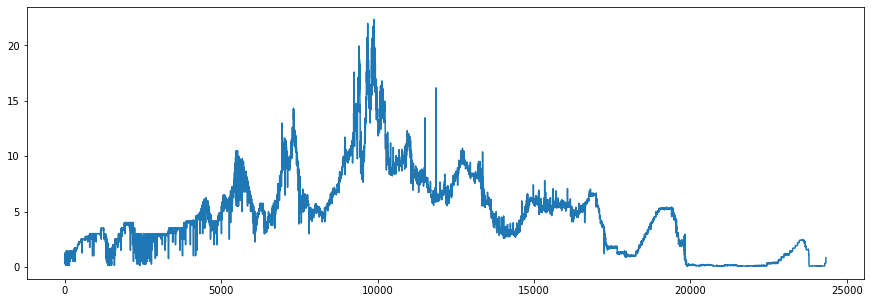

In [59]:
plt.figure(figsize=(15,5))
plt.plot(df_fed['value'])

In [44]:
df

,날짜,S&P500,미국채10년,GSCI,기준금리,last_gdp,last_unem,last_infl,CPI,달러인덱스,비율
0,2021-05-04,11.097391,48.192771,16.281368,-0.25,-3.4,6.7,1.4,2.029159,-0.287315,"(Decimal('0.3'), Decimal('0.1'), Decimal('0.5'..."
1,2021-05-03,12.571347,51.820728,17.105960,-0.25,-3.4,6.7,1.4,1.971019,0.324265,"(Decimal('0.1'), Decimal('0.1'), Decimal('0.5'..."
2,2021-04-30,11.197450,55.988593,17.876970,-0.25,-3.4,6.7,1.4,1.990275,0.026499,"(Decimal('0.1'), Decimal('0.1'), Decimal('0.5'..."
3,2021-04-29,11.528566,59.032577,16.264624,-0.25,-3.4,6.7,1.4,1.980892,0.183573,"(Decimal('0.1'), Decimal('0.1'), Decimal('0.5'..."
4,2021-04-28,8.756708,57.308809,15.444055,-0.25,-3.4,6.7,1.4,1.971506,0.278023,"(Decimal('0.3'), Decimal('0.1'), Decimal('0.5'..."
...,...,...,...,...,...,...,...,...,...,...,...
5292,2000-04-10,5.189039,-10.256410,11.199047,0.25,4.8,4.0,2.7,0.859437,5.067064,"(Decimal('0.1'), Decimal('0.3'), Decimal('0.5'..."
5293,2000-04-07,6.968294,-9.434251,11.267855,0.25,4.8,4.0,2.7,0.893860,4.666667,"(Decimal('0.1'), Decimal('0.3'), Decimal('0.5'..."
5294,2000-04-06,6.083732,-11.047128,11.846718,0.25,4.8,4.0,2.7,0.901405,4.694040,"(Decimal('0.1'), Decimal('0.3'), Decimal('0.5'..."
5295,2000-04-05,6.810061,-9.416833,9.839233,0.25,4.8,4.0,2.7,0.908952,4.797601,"(Decimal('0.1'), Decimal('0.3'), Decimal('0.5'..."


In [93]:
url = 'https://finance.yahoo.com/quote/%5EGSPC/history?period1=-1325635200&period2=1652400000&interval=1d&filter=history&frequency=1d&includeAdjustedClose=true'

In [94]:
driver = webdriver.Chrome('data_files/chromedriver.exe')

C:\Users\bitcamp\AppData\Local\Temp/ipykernel_14748/3555466094.py:1: DeprecationWarning: executable_path has been deprecated, please pass in a Service object
  driver = webdriver.Chrome('data_files/chromedriver.exe')


In [95]:
driver.get('https://finance.yahoo.com/quote/%5EGSPC/history?period1=-1325635200&period2=1652400000&interval=1d&filter=history&frequency=1d&includeAdjustedClose=true')

In [114]:
last_height = driver.execute_script("return document.documentElement.scrollHeight")
last_height

16044

In [111]:
driver.execute_script(f"window.scrollTo(0, {last_height});")

In [116]:
SCROLL_PAUSE_SEC = 1
# 스크롤 높이 가져옴
last_height = driver.execute_script("return document.documentElement.scrollHeight")
time.sleep(SCROLL_PAUSE_SEC)
while True:
    # 끝까지 스크롤 다운
    driver.execute_script(f"window.scrollTo(0, {last_height});")

    # 1초 대기
    time.sleep(SCROLL_PAUSE_SEC)

    # 스크롤 다운 후 스크롤 높이 다시 가져옴
    new_height = driver.execute_script("return document.documentElement.scrollHeight")
    if new_height == last_height:
        break
    last_height = new_height

In [117]:
html = driver.page_source

In [118]:
soup = BeautifulSoup(html, 'html.parser')

In [119]:
data = soup.select('table')

In [120]:
table = parser_functions.make2d(data[0])

In [123]:
df_sp = pd.DataFrame(data=table[1:], columns=table[0])

In [125]:
# df_sp[:-1].to_csv('data_files/S&P 500 1927이후 데이터.csv')

In [246]:
df_sp = pd.read_csv('data_files/S&P 500 1927이후 데이터.csv', index_col='Unnamed: 0')

In [247]:
df_doller = pd.read_csv('data_files/달러인덱스1970~.csv')

In [248]:
df_fed = pd.read_csv('data_files/fed-funds-rate-historical-chart.csv')

In [249]:
df_sp['Date'] = pd.to_datetime(df_sp['Date']).apply(lambda x: str(x)[:10])

In [250]:
df_doller = df_doller[['Date', 'Close']]
df_sp = df_sp[['Date', 'Close*']]

In [251]:
df_sp.columns = ['date', 'sp']
df_doller.columns = ['date', 'doller']
df_fed.columns = ['date', 'fed']

In [252]:
df_sp.isna().sum()

date    0
sp      0
dtype: int64

In [253]:
df_doller.dropna(inplace=True)

In [254]:
df_fed.dropna(inplace=True)

In [255]:
df_merge = pd.merge(df_sp, df_doller, how='inner', on='date')

In [256]:
df_merge = pd.merge(df_merge, df_fed, how='inner', on='date')

In [259]:
df_merge.isna().sum()

date      0
sp        0
doller    0
fed       0
dtype: int64

In [261]:
# df_merge.to_csv('data_files/sp_dol_fed 1971~.csv')

In [121]:
df = pd.read_csv('data_files/sp_dol_fed 1971~.csv', index_col="Unnamed: 0")

In [122]:
df

,date,sp,doller,fed
0,2022-05-10,"4,001.05",103.919998,0.83
1,2022-05-09,"3,991.24",103.650002,0.83
2,2022-05-06,"4,123.34",103.660004,0.83
3,2022-05-05,"4,146.87",103.750000,0.83
4,2022-05-04,"4,300.17",102.589996,0.33
...,...,...,...,...
12877,1971-01-08,92.19,120.529999,4.50
12878,1971-01-07,92.38,120.550003,4.50
12879,1971-01-06,92.35,120.489998,3.75
12880,1971-01-05,91.80,120.519997,5.50


In [133]:
df_base =  pd.read_csv('data_files/재전처리.csv', index_col='Unnamed: 0')
df_base.head()

,date,doller,fed,gdp,cpi,sp_close,sp_volume,mi_close,mi_volume,gsci_close,unem,infl,pmi,lead_idx,csi,cci,supply,permit,mi_rate
0,2021-08-30,92.650002,0.08,23202.344,273.092,4528.79,2.557300e+09,134.13,672060.0,2589.3459,5.2,5.3,59.7,100.8366,99.9748,70.3,20852.3,1772.0,1.280
1,2021-08-27,92.690002,0.08,23202.344,273.092,4509.37,2.862360e+09,133.89,2460000.0,2586.4009,5.2,5.3,59.7,100.8366,99.9748,70.3,20852.3,1772.0,1.310
2,2021-08-26,93.059998,0.09,23202.344,273.092,4470.00,2.704600e+09,133.59,3100000.0,2549.6780,5.2,5.3,59.7,100.8366,99.9748,70.3,20852.3,1772.0,1.354
3,2021-08-25,92.830002,0.09,23202.344,273.092,4496.19,2.554680e+09,133.63,3160000.0,2563.0581,5.2,5.3,59.7,100.8366,99.9748,70.3,20852.3,1772.0,1.349
4,2021-08-24,92.889999,0.09,23202.344,273.092,4486.23,3.037770e+09,133.98,1880000.0,2542.4231,5.2,5.3,59.7,100.8366,99.9748,70.3,20852.3,1772.0,1.297


In [134]:
df_base.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9665 entries, 0 to 9665
Data columns (total 19 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   date        9665 non-null   object 
 1   doller      9665 non-null   float64
 2   fed         9665 non-null   float64
 3   gdp         9665 non-null   float64
 4   cpi         9665 non-null   float64
 5   sp_close    9665 non-null   float64
 6   sp_volume   9665 non-null   float64
 7   mi_close    9665 non-null   float64
 8   mi_volume   9665 non-null   float64
 9   gsci_close  9665 non-null   float64
 10  unem        9665 non-null   float64
 11  infl        9665 non-null   float64
 12  pmi         9665 non-null   float64
 13  lead_idx    9665 non-null   float64
 14  csi         9665 non-null   float64
 15  cci         9665 non-null   float64
 16  supply      9665 non-null   float64
 17  permit      9665 non-null   float64
 18  mi_rate     9665 non-null   float64
dtypes: float64(18), object(1)
m

In [135]:
df_base.set_index('date', inplace=True)

In [136]:
df = df_base[['sp_close', 'mi_rate', 'gsci_close', 'fed']]

In [137]:
df365 = df.shift(249)[249:]

In [138]:
df = df[249:]

In [139]:
df365.loc['2002-03-05':]

,sp_close,mi_rate,gsci_close,fed
date,,,,
2002-03-05,834.81,3.675,4434.8018,1.33
2002-03-04,841.15,3.692,4556.6831,1.33
2002-03-01,837.28,3.739,4515.9722,1.31
2002-02-28,827.55,3.766,4540.5020,1.28
2002-02-27,838.57,3.820,4385.3579,1.28
...,...,...,...,...
1982-05-10,161.74,11.932,760.2000,9.63
1982-05-07,161.33,11.913,753.3300,9.64
1982-05-06,163.44,11.778,754.3300,9.63


In [148]:
df

,sp_close,mi_rate,gsci_close,fed
date,,,,
2020-08-31,3500.31,0.706,1792.0280,0.09
2020-08-28,3508.01,0.724,1800.7061,0.09
2020-08-27,3484.55,0.754,1795.1030,0.08
2020-08-26,3478.73,0.688,1800.3250,0.09
2020-08-25,3443.62,0.688,1801.1470,0.09
...,...,...,...,...
1982-05-10,118.38,13.542,668.6200,14.59
1982-05-07,119.47,13.519,668.2800,14.90
1982-05-06,118.68,13.564,666.9500,15.25


In [145]:
max_ratio_dic = {}
max_money_dic = {}

for date in df365.index:
    max_money = 0
    print(f"{date} 데이터 분석")
    for ratio in ratio_li:
#         print(f"주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")
        money = 10000000
    
        
        sp_split_money = math.floor(money * ratio[0])
        mi10_split_money = math.floor(money * ratio[1])
        gsci_split_money = math.floor(money * ratio[2])
        y_split_money = math.floor(money * ratio[3])
#         print(sp_split_money, mi10_split_money, gsci_split_money, y_split_money)

        ## S&P지수
        sp_buy_price = df.loc[date]['sp_close']
        sp_num = int(sp_split_money / sp_buy_price)
        sp_buy_total_price = sp_buy_price * sp_num
        rest_money = sp_split_money - sp_buy_total_price
        sp_sell_price = df365.loc[date]['sp_close']
        sp_result = sp_sell_price * sp_num
#         print(f"가격변화 {sp_buy_price} => {sp_sell_price} 이익율 {round((sp_sell_price - sp_buy_price) / sp_buy_price, 2)}, 결과 {round(sp_buy_total_price)} => {round(sp_result)}")

        ## 미국 10년채
        mi10_buy_rate = df.loc[date]['mi_rate'] 
        mi10_buy_price = 10000 / (1+mi10_buy_rate / 100)
        mi10_num = int(mi10_split_money / mi10_buy_price)

        # 구입당시 금리만큼 이자계산
        mi10_buy_total_price = mi10_buy_price * mi10_num
        rest_money += mi10_split_money - mi10_buy_total_price
        mi10_rate_price = mi10_buy_total_price * (mi10_buy_rate / 100)

        # 1년후 바뀐 가격으로 판매
        mi10_sell_rate = df365.loc[date]['mi_rate'] 
        mi10_sell_price = 10000 / (1+mi10_sell_rate / 100)
        mi10_sell_total_price = mi10_sell_price * mi10_num
        mi10_result = mi10_sell_total_price + mi10_rate_price
#         print(f"금리변화 {mi10_buy_rate} => {mi10_sell_rate}, 가격 변화 {round(mi10_buy_total_price)} => {round(mi10_sell_total_price)}, 이자 {round(mi10_rate_price)}, 결과 {round(mi10_buy_total_price)} => {round(mi10_result)}")


        ## GSCI지수(원자재)
        gsci_buy_price = df.loc[date]['gsci_close']
        gsci_num = int(gsci_split_money / gsci_buy_price)
        gsci_buy_total_price = gsci_buy_price * gsci_num
        rest_money += gsci_split_money - gsci_buy_total_price
        gsci_sell_price = df365.loc[date]['gsci_close']
        gsci_result = gsci_sell_price * gsci_num
#         print(f"가격변화 {gsci_buy_price} => {gsci_sell_price}, 이익율 {round((gsci_sell_price - gsci_buy_price) / gsci_buy_price, 2)}, 결과 {round(gsci_buy_total_price)} => {round(gsci_result)}")

        ## 예금
        y_rate = df.loc[date]['fed']
        y_price = (y_split_money + rest_money) * (y_rate/100)
        y_total_price = y_split_money + rest_money
        y_result = y_total_price + y_price
#         print(f"금리 {y_rate}, 이자 {round(y_price)}, 결과 {round(y_total_price)} => {round(y_result)}")

        result = sp_result + mi10_result + gsci_result + y_result
#         print('=' * 50)
#         print(f"{date} 투자결과")
#         print(f"투자액 {round(money)}, 1년후 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
#         print('=' * 50)
        
        if result > max_money:
            max_money = result
            max_ratio = ratio
            print(f"주식 {ratio[0]}, 채권 {ratio[1]}, 원자재 {ratio[2]}, 예금 {ratio[3]}")
            print(f"투자금액 {round(money)}, 1년후 결과 {round(result)}, 이익 {round(result-money)}, 이익율 {round(((result - money) / money) * 100, 2)}%")
            
        
        money = math.floor(result)
    max_ratio_dic[date] = max_ratio
    max_money_dic[date] = max_money

2020-08-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11633718, 이익 1633718, 이익율 16.34%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12077722, 이익 2077722, 이익율 20.78%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12521725, 이익 2521725, 이익율 25.22%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12522219, 이익 2522219, 이익율 25.22%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12522713, 이익 2522713, 이익율 25.23%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12814970, 이익 2814970, 이익율 28.15%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12815464, 이익 2815464, 이익율 28.15%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13108214, 이익 3108214, 이익율 31.08%
2020-08-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11600307, 이익 1600307, 이익율 16.0%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12035468, 이익 2035468, 이익율 20.35%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12470629, 이익 2470629, 이익율 24.71%
주식 0.1, 

2020-07-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11899528, 이익 1899528, 이익율 19.0%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12408323, 이익 2408323, 이익율 24.08%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12917118, 이익 2917118, 이익율 29.17%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13284037, 이익 3284037, 이익율 32.84%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13650955, 이익 3650955, 이익율 36.51%
2020-07-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11901915, 이익 1901915, 이익율 19.02%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12412254, 이익 2412254, 이익율 24.12%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12922593, 이익 2922593, 이익율 29.23%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13287105, 이익 3287105, 이익율 32.87%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13651617, 이익 3651617, 이익율 36.52%
2020-07-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11890851, 이익 1890851, 이

투자금액 10000000, 1년후 결과 12969526, 이익 2969526, 이익율 29.7%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13324459, 이익 3324459, 이익율 33.24%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13680506, 이익 3680506, 이익율 36.81%
2020-06-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11914443, 이익 1914443, 이익율 19.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12432308, 이익 2432308, 이익율 24.32%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12950174, 이익 2950174, 이익율 29.5%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13304698, 이익 3304698, 이익율 33.05%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13659222, 이익 3659222, 이익율 36.59%
2020-06-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11898378, 이익 1898378, 이익율 18.98%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12414492, 이익 2414492, 이익율 24.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12930606, 이익 2930606, 이익율 29.31%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 1000

투자금액 10000000, 1년후 결과 14280771, 이익 4280771, 이익율 42.81%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 14726401, 이익 4726401, 이익율 47.26%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 15173311, 이익 5173311, 이익율 51.73%
2020-05-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12727050, 이익 2727050, 이익율 27.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13492294, 이익 3492294, 이익율 34.92%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 14258622, 이익 4258622, 이익율 42.59%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 14687182, 이익 4687182, 이익율 46.87%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 15115743, 이익 5115743, 이익율 51.16%
2020-05-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12661771, 이익 2661771, 이익율 26.62%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13399899, 이익 3399899, 이익율 34.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 14139093, 이익 4139093, 이익율 41.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 100

투자금액 10000000, 1년후 결과 13996581, 이익 3996581, 이익율 39.97%
2020-04-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11777487, 이익 1777487, 이익율 17.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12193092, 이익 2193092, 이익율 21.93%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12608697, 이익 2608697, 이익율 26.09%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12721440, 이익 2721440, 이익율 27.21%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13137045, 이익 3137045, 이익율 31.37%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 13251197, 이익 3251197, 이익율 32.51%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13666802, 이익 3666802, 이익율 36.67%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 13779545, 이익 3779545, 이익율 37.8%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 13893697, 이익 3893697, 이익율 38.94%
2020-04-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11788050, 이익 1788050, 이익율 17.88%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 100

투자금액 10000000, 1년후 결과 13180433, 이익 3180433, 이익율 31.8%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13517877, 이익 3517877, 이익율 35.18%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 13757292, 이익 3757292, 이익율 37.57%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 13996708, 이익 3996708, 이익율 39.97%
2020-03-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11285901, 이익 1285901, 이익율 12.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11544667, 이익 1544667, 이익율 15.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11802958, 이익 1802958, 이익율 18.03%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11956223, 이익 1956223, 이익율 19.56%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12214514, 이익 2214514, 이익율 22.15%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12367778, 이익 2367778, 이익율 23.68%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12626069, 이익 2626069, 이익율 26.26%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 1277

투자금액 10000000, 1년후 결과 10782062, 이익 782062, 이익율 7.82%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10918828, 이익 918828, 이익율 9.19%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10946205, 이익 946205, 이익율 9.46%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10973581, 이익 973581, 이익율 9.74%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11000958, 이익 1000958, 이익율 10.01%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11028335, 이익 1028335, 이익율 10.28%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11165863, 이익 1165863, 이익율 11.66%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11193240, 이익 1193240, 이익율 11.93%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11220617, 이익 1220617, 이익율 12.21%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11247993, 이익 1247993, 이익율 12.48%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11412899, 이익 1412899, 이익율 14.13%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11440276, 이익 1440276, 이익율 14.

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10821621, 이익 821621, 이익율 8.22%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10823110, 이익 823110, 이익율 8.23%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10824584, 이익 824584, 이익율 8.25%
2020-02-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10123419, 이익 123419, 이익율 1.23%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10187024, 이익 187024, 이익율 1.87%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10250749, 이익 250749, 이익율 2.51%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10253364, 이익 253364, 이익율 2.53%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10255953, 이익 255953, 이익율 2.56%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10329354, 이익 329354, 이익율 3.29%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10393105, 이익 393105, 이익율 3.93%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10395694, 이익 395694, 이익율 3.96%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10178586, 이익 178586, 이익율 1.79%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10252452, 이익 252452, 이익율 2.52%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10256571, 이익 256571, 이익율 2.57%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10260650, 이익 260650, 이익율 2.61%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10326936, 이익 326936, 이익율 3.27%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10400843, 이익 400843, 이익율 4.01%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10404921, 이익 404921, 이익율 4.05%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10409041, 이익 409041, 이익율 4.09%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10413119, 이익 413119, 이익율 4.13%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10548686, 이익 548686, 이익율 5.49%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10552805, 이익 552805, 이익율 5.53%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10556884, 이익 556884, 이익율 5.57%
주식 0.3, 채권 0

투자금액 10000000, 1년후 결과 10422457, 이익 422457, 이익율 4.22%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10428356, 이익 428356, 이익율 4.28%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10434314, 이익 434314, 이익율 4.34%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10440213, 이익 440213, 이익율 4.4%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10546623, 이익 546623, 이익율 5.47%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10552580, 이익 552580, 이익율 5.53%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10558479, 이익 558479, 이익율 5.58%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10564437, 이익 564437, 이익율 5.64%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10677172, 이익 677172, 이익율 6.77%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10683130, 이익 683130, 이익율 6.83%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10689029, 이익 689029, 이익율 6.89%
2020-01-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9907883, 이익 -92117, 이익율 -0

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10327764, 이익 327764, 이익율 3.28%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10337832, 이익 337832, 이익율 3.38%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10347900, 이익 347900, 이익율 3.48%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10357968, 이익 357968, 이익율 3.58%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10433803, 이익 433803, 이익율 4.34%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10443870, 이익 443870, 이익율 4.44%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10453938, 이익 453938, 이익율 4.54%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10464006, 이익 464006, 이익율 4.64%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10549909, 이익 549909, 이익율 5.5%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10559977, 이익 559977, 이익율 5.6%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10570045, 이익 570045, 이익율 5.7%
2020-01-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 10369342, 이익 369342, 이익율 3.69%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10380860, 이익 380860, 이익율 3.81%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10392379, 이익 392379, 이익율 3.92%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10403897, 이익 403897, 이익율 4.04%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10494336, 이익 494336, 이익율 4.94%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10505855, 이익 505855, 이익율 5.06%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10517373, 이익 517373, 이익율 5.17%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10528892, 이익 528892, 이익율 5.29%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10631294, 이익 631294, 이익율 6.31%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10642812, 이익 642812, 이익율 6.43%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10654331, 이익 654331, 이익율 6.54%
2020-01-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9572400, 이익 -427600, 이익율 

투자금액 10000000, 1년후 결과 10198744, 이익 198744, 이익율 1.99%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10270489, 이익 270489, 이익율 2.7%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10283344, 이익 283344, 이익율 2.83%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10296198, 이익 296198, 이익율 2.96%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10309053, 이익 309053, 이익율 3.09%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10321907, 이익 321907, 이익율 3.22%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10394053, 이익 394053, 이익율 3.94%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10406907, 이익 406907, 이익율 4.07%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10419762, 이익 419762, 이익율 4.2%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10432616, 이익 432616, 이익율 4.33%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10517616, 이익 517616, 이익율 5.18%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10530471, 이익 530471, 이익율 5.3%
주식 0.5, 채권 0.3,

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10535254, 이익 535254, 이익율 5.35%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10548063, 이익 548063, 이익율 5.48%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10560872, 이익 560872, 이익율 5.61%
2019-12-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9504936, 이익 -495064, 이익율 -4.95%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9784764, 이익 -215236, 이익율 -2.15%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10063913, 이익 63913, 이익율 0.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10075871, 이익 75871, 이익율 0.76%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10087830, 이익 87830, 이익율 0.88%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10192747, 이익 192747, 이익율 1.93%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10204705, 이익 204705, 이익율 2.05%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10216663, 이익 216663, 이익율 2.17%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10445543, 이익 445543, 이익율 4.46%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10455046, 이익 455046, 이익율 4.55%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10586027, 이익 586027, 이익율 5.86%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10595531, 이익 595531, 이익율 5.96%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10605035, 이익 605035, 이익율 6.05%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10614445, 이익 614445, 이익율 6.14%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10754409, 이익 754409, 이익율 7.54%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10763913, 이익 763913, 이익율 7.64%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10773416, 이익 773416, 이익율 7.73%
2019-12-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9569986, 이익 -430014, 이익율 -4.3%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9830896, 이익 -169104, 이익율 -1.69%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10091806, 이익 91806, 이익율 

투자금액 10000000, 1년후 결과 10180429, 이익 180429, 이익율 1.8%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10191119, 이익 191119, 이익율 1.91%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10280851, 이익 280851, 이익율 2.81%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10291542, 이익 291542, 이익율 2.92%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10302232, 이익 302232, 이익율 3.02%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10312819, 이익 312819, 이익율 3.13%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10323509, 이익 323509, 이익율 3.24%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10412830, 이익 412830, 이익율 4.13%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10423520, 이익 423520, 이익율 4.24%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10434211, 이익 434211, 이익율 4.34%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10444797, 이익 444797, 이익율 4.45%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10545219, 이익 545219, 이익율 5.45%
주식 0.5, 채권 0.

주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9323536, 이익 -676464, 이익율 -6.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9652977, 이익 -347023, 이익율 -3.47%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9982418, 이익 -17582, 이익율 -0.18%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9995749, 이익 -4251, 이익율 -0.04%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10009081, 이익 9081, 이익율 0.09%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10072752, 이익 72752, 이익율 0.73%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10086083, 이익 86083, 이익율 0.86%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10099415, 이익 99415, 이익율 0.99%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10112746, 이익 112746, 이익율 1.13%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10163086, 이익 163086, 이익율 1.63%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10176417, 이익 176417, 이익율 1.76%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10189749, 이익 18

투자금액 10000000, 1년후 결과 10119662, 이익 119662, 이익율 1.2%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10178300, 이익 178300, 이익율 1.78%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10188803, 이익 188803, 이익율 1.89%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10199306, 이익 199306, 이익율 1.99%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10209809, 이익 209809, 이익율 2.1%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10220312, 이익 220312, 이익율 2.2%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10278951, 이익 278951, 이익율 2.79%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10289454, 이익 289454, 이익율 2.89%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10299957, 이익 299957, 이익율 3.0%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10310460, 이익 310460, 이익율 3.1%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10379601, 이익 379601, 이익율 3.8%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10390104, 이익 390104, 이익율 3.9%
주식 0.5, 채권 0.3, 원자재

투자금액 10000000, 1년후 결과 10524066, 이익 524066, 이익율 5.24%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10533141, 이익 533141, 이익율 5.33%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10542216, 이익 542216, 이익율 5.42%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10551291, 이익 551291, 이익율 5.51%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10677483, 이익 677483, 이익율 6.77%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10686558, 이익 686558, 이익율 6.87%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10695633, 이익 695633, 이익율 6.96%
2019-10-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9469058, 이익 -530942, 이익율 -5.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9768910, 이익 -231090, 이익율 -2.31%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10068762, 이익 68762, 이익율 0.69%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10077317, 이익 77317, 이익율 0.77%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10085955, 이익 85955, 이익율 0

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10243640, 이익 243640, 이익율 2.44%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10250920, 이익 250920, 이익율 2.51%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10258273, 이익 258273, 이익율 2.58%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10265626, 이익 265626, 이익율 2.66%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10351868, 이익 351868, 이익율 3.52%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10359220, 이익 359220, 이익율 3.59%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10366501, 이익 366501, 이익율 3.67%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10373854, 이익 373854, 이익율 3.74%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10467448, 이익 467448, 이익율 4.67%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10474801, 이익 474801, 이익율 4.75%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10482082, 이익 482082, 이익율 4.82%
2019-09-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10093881, 이익 93881, 이익율 0.94%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10103676, 이익 103676, 이익율 1.04%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10113472, 이익 113472, 이익율 1.13%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10123171, 이익 123171, 이익율 1.23%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10181392, 이익 181392, 이익율 1.81%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10191187, 이익 191187, 이익율 1.91%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10200982, 이익 200982, 이익율 2.01%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10210778, 이익 210778, 이익율 2.11%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10220477, 이익 220477, 이익율 2.2%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10278991, 이익 278991, 이익율 2.79%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10288786, 이익 288786, 이익율 2.89%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10298582, 이익 298582, 이익율 2.99%
주식 0.4, 채권 0.4

투자금액 10000000, 1년후 결과 10294861, 이익 294861, 이익율 2.95%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10371912, 이익 371912, 이익율 3.72%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10378617, 이익 378617, 이익율 3.79%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10385322, 이익 385322, 이익율 3.85%
2019-09-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9427646, 이익 -572354, 이익율 -5.72%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9738505, 이익 -261495, 이익율 -2.61%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10049320, 이익 49320, 이익율 0.49%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10053699, 이익 53699, 이익율 0.54%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10058078, 이익 58078, 이익율 0.58%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10174374, 이익 174374, 이익율 1.74%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10178710, 이익 178710, 이익율 1.79%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10183089, 이익 183089, 이익율 1

주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10501045, 이익 501045, 이익율 5.01%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10502399, 이익 502399, 이익율 5.02%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10676270, 이익 676270, 이익율 6.76%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10677610, 이익 677610, 이익율 6.78%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10678963, 이익 678963, 이익율 6.79%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10680303, 이익 680303, 이익율 6.8%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10855015, 이익 855015, 이익율 8.55%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10856355, 이익 856355, 이익율 8.56%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10857708, 이익 857708, 이익율 8.58%
2019-08-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9621964, 이익 -378036, 이익율 -3.78%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9879495, 이익 -120505, 이익율 -1.21%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000,

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10275667, 이익 275667, 이익율 2.76%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10277173, 이익 277173, 이익율 2.77%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10278695, 이익 278695, 이익율 2.79%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10280201, 이익 280201, 이익율 2.8%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10437422, 이익 437422, 이익율 4.37%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10438943, 이익 438943, 이익율 4.39%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10440450, 이익 440450, 이익율 4.4%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10441972, 이익 441972, 이익율 4.42%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10443478, 이익 443478, 이익율 4.43%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10600699, 이익 600699, 이익율 6.01%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10602220, 이익 602220, 이익율 6.02%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10603727, 이익 

주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10383831, 이익 383831, 이익율 3.84%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10391443, 이익 391443, 이익율 3.91%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10399130, 이익 399130, 이익율 3.99%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10500854, 이익 500854, 이익율 5.01%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10508541, 이익 508541, 이익율 5.09%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10516228, 이익 516228, 이익율 5.16%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10523840, 이익 523840, 이익율 5.24%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10633633, 이익 633633, 이익율 6.34%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10641320, 이익 641320, 이익율 6.41%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10649007, 이익 649007, 이익율 6.49%
2019-08-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9518890, 이익 -481110, 이익율 -4.81%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000,

투자금액 10000000, 1년후 결과 10119965, 이익 119965, 이익율 1.2%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10130980, 이익 130980, 이익율 1.31%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10141995, 이익 141995, 이익율 1.42%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10153009, 이익 153009, 이익율 1.53%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10168270, 이익 168270, 이익율 1.68%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10179285, 이익 179285, 이익율 1.79%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10190300, 이익 190300, 이익율 1.9%
2019-07-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9323951, 이익 -676049, 이익율 -6.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9657804, 이익 -342196, 이익율 -3.42%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9991658, 이익 -8342, 이익율 -0.08%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10003172, 이익 3172, 이익율 0.03%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10014687, 이익 14687, 이익율 0.15

투자금액 10000000, 1년후 결과 10120723, 이익 120723, 이익율 1.21%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10132389, 이익 132389, 이익율 1.32%
2019-07-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9207316, 이익 -792684, 이익율 -7.93%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9574771, 이익 -425229, 이익율 -4.25%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9942225, 이익 -57775, 이익율 -0.58%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9953745, 이익 -46255, 이익율 -0.46%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9965264, 이익 -34736, 이익율 -0.35%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9976512, 이익 -23488, 이익율 -0.23%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9988032, 이익 -11968, 이익율 -0.12%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9999280, 이익 -720, 이익율 -0.01%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10010799, 이익 10799, 이익율 0.11%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10022047, 이익 22047, 이익율 0.

투자금액 10000000, 1년후 결과 9536171, 이익 -463829, 이익율 -4.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9911427, 이익 -88573, 이익율 -0.89%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9921826, 이익 -78174, 이익율 -0.78%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9932225, 이익 -67775, 이익율 -0.68%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9938312, 이익 -61688, 이익율 -0.62%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9944417, 이익 -55583, 이익율 -0.56%
2019-06-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9114756, 이익 -885244, 이익율 -8.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9502962, 이익 -497038, 이익율 -4.97%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9890224, 이익 -109776, 이익율 -1.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9899877, 이익 -100123, 이익율 -1.0%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9909529, 이익 -90471, 이익율 -0.9%
2019-06-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 91349

주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10002328, 이익 2328, 이익율 0.02%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10011924, 이익 11924, 이익율 0.12%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10021519, 이익 21519, 이익율 0.22%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10023631, 이익 23631, 이익율 0.24%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10033227, 이익 33227, 이익율 0.33%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10042822, 이익 42822, 이익율 0.43%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10044843, 이익 44843, 이익율 0.45%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10054439, 이익 54439, 이익율 0.54%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10064034, 이익 64034, 이익율 0.64%
2019-06-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9257364, 이익 -742636, 이익율 -7.43%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9609889, 이익 -390111, 이익율 -3.9%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 99

주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9351481, 이익 -648519, 이익율 -6.49%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9687599, 이익 -312401, 이익율 -3.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10024499, 이익 24499, 이익율 0.24%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10033436, 이익 33436, 이익율 0.33%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10042373, 이익 42373, 이익율 0.42%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10103429, 이익 103429, 이익율 1.03%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10112366, 이익 112366, 이익율 1.12%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10121303, 이익 121303, 이익율 1.21%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10130240, 이익 130240, 이익율 1.3%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10182359, 이익 182359, 이익율 1.82%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10191296, 이익 191296, 이익율 1.91%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10200233, 이익 

주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10062671, 이익 62671, 이익율 0.63%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10077056, 이익 77056, 이익율 0.77%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10091301, 이익 91301, 이익율 0.91%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10101355, 이익 101355, 이익율 1.01%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10115600, 이익 115600, 이익율 1.16%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10129845, 이익 129845, 이익율 1.3%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10144230, 이익 144230, 이익율 1.44%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10168343, 이익 168343, 이익율 1.68%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10182588, 이익 182588, 이익율 1.83%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10196833, 이익 196833, 이익율 1.97%
2019-05-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9064237, 이익 -935763, 이익율 -9.36%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후

2019-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8659954, 이익 -1340046, 이익율 -13.4%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9207980, 이익 -792020, 이익율 -7.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9755820, 이익 -244180, 이익율 -2.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9775056, 이익 -224944, 이익율 -2.25%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9794105, 이익 -205895, 이익율 -2.06%
2019-04-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8589930, 이익 -1410070, 이익율 -14.1%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9150420, 이익 -849580, 이익율 -8.5%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9710721, 이익 -289279, 이익율 -2.89%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9730118, 이익 -269882, 이익율 -2.7%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9749328, 이익 -250672, 이익율 -2.51%
2019-04-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8603260, 이익 -1396740, 이익율 -13.97

2019-03-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8871131, 이익 -1128869, 이익율 -11.29%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9308853, 이익 -691147, 이익율 -6.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9746740, 이익 -253260, 이익율 -2.53%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9763636, 이익 -236364, 이익율 -2.36%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9780698, 이익 -219302, 이익율 -2.19%
2019-03-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8943908, 이익 -1056092, 이익율 -10.56%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9366721, 이익 -633279, 이익율 -6.33%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9789681, 이익 -210319, 이익율 -2.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9804734, 이익 -195266, 이익율 -1.95%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9819786, 이익 -180214, 이익율 -1.8%
2019-03-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8933379, 이익 -1066621, 이익율 -10.

투자금액 10000000, 1년후 결과 10277188, 이익 277188, 이익율 2.77%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10294485, 이익 294485, 이익율 2.94%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10311951, 이익 311951, 이익율 3.12%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10322940, 이익 322940, 이익율 3.23%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10340236, 이익 340236, 이익율 3.4%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10351225, 이익 351225, 이익율 3.51%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10368691, 이익 368691, 이익율 3.69%
2019-02-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9947549, 이익 -52451, 이익율 -0.52%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10097414, 이익 97414, 이익율 0.97%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10247280, 이익 247280, 이익율 2.47%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10263364, 이익 263364, 이익율 2.63%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10279605, 이익 279605, 이익율 2.

투자금액 10000000, 1년후 결과 10755787, 이익 755787, 이익율 7.56%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10769062, 이익 769062, 이익율 7.69%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10782208, 이익 782208, 이익율 7.82%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10795483, 이익 795483, 이익율 7.95%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10808759, 이익 808759, 이익율 8.09%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10949985, 이익 949985, 이익율 9.5%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10963260, 이익 963260, 이익율 9.63%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10976407, 이익 976407, 이익율 9.76%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10989682, 이익 989682, 이익율 9.9%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11143646, 이익 1143646, 이익율 11.44%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11156921, 이익 1156921, 이익율 11.57%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11170067, 이익 1170067, 이익율 11.7%
2019-02-1

투자금액 10000000, 1년후 결과 10989407, 이익 989407, 이익율 9.89%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11002655, 이익 1002655, 이익율 10.03%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11159383, 이익 1159383, 이익율 11.59%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11172761, 이익 1172761, 이익율 11.73%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11186140, 이익 1186140, 이익율 11.86%
2019-02-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10170224, 이익 170224, 이익율 1.7%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10272189, 이익 272189, 이익율 2.72%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10374155, 이익 374155, 이익율 3.74%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10387936, 이익 387936, 이익율 3.88%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10401852, 이익 401852, 이익율 4.02%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10438651, 이익 438651, 이익율 4.39%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10540616, 이익 54061

투자금액 10000000, 1년후 결과 10601771, 이익 601771, 이익율 6.02%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10757399, 이익 757399, 이익율 7.57%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10775034, 이익 775034, 이익율 7.75%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10792668, 이익 792668, 이익율 7.93%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10810302, 이익 810302, 이익율 8.1%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10823474, 이익 823474, 이익율 8.23%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10974639, 이익 974639, 이익율 9.75%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10992274, 이익 992274, 이익율 9.92%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11009908, 이익 1009908, 이익율 10.1%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11027542, 이익 1027542, 이익율 10.28%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11045177, 이익 1045177, 이익율 10.45%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11209513, 이익 1209513, 이익율 12.1%
주식 0.4,

2019-01-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10809632, 이익 809632, 이익율 8.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10917870, 이익 917870, 이익율 9.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11026108, 이익 1026108, 이익율 10.26%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11038467, 이익 1038467, 이익율 10.38%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11050826, 이익 1050826, 이익율 10.51%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11151052, 이익 1151052, 이익율 11.51%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11259290, 이익 1259290, 이익율 12.59%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11271649, 이익 1271649, 이익율 12.72%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11276597, 이익 1276597, 이익율 12.77%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11384835, 이익 1384835, 이익율 13.85%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11493073, 이익 1493073, 이익율 14.93%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11930548, 이익 1930548, 이익율 19.31%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12064013, 이익 2064013, 이익율 20.64%
2018-12-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11096751, 이익 1096751, 이익율 10.97%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11262685, 이익 1262685, 이익율 12.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11428978, 이익 1428978, 이익율 14.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11440314, 이익 1440314, 이익율 14.4%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11451650, 이익 1451650, 이익율 14.52%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11609690, 이익 1609690, 이익율 16.1%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11775983, 이익 1775983, 이익율 17.76%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11787319, 이익 1787319, 이익율 17.87%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11790762, 이익 1790762, 이익율 17.91%
주식 0.3, 채권 0.1, 원자재 0.4, 예금

2018-12-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10453558, 이익 453558, 이익율 4.54%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10471397, 이익 471397, 이익율 4.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10489235, 이익 489235, 이익율 4.89%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10489606, 이익 489606, 이익율 4.9%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10507444, 이익 507444, 이익율 5.07%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10507814, 이익 507814, 이익율 5.08%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10525653, 이익 525653, 이익율 5.26%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10526023, 이익 526023, 이익율 5.26%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10526393, 이익 526393, 이익율 5.26%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10598773, 이익 598773, 이익율 5.99%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10616611, 이익 616611, 이익율 6.17%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10667749, 이익 667749, 이익율 6.68%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10687795, 이익 687795, 이익율 6.88%
2018-11-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10334236, 이익 334236, 이익율 3.34%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10357353, 이익 357353, 이익율 3.57%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10380479, 이익 380479, 이익율 3.8%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10399911, 이익 399911, 이익율 4.0%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10419343, 이익 419343, 이익율 4.19%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10443979, 이익 443979, 이익율 4.44%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10467105, 이익 467105, 이익율 4.67%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10486536, 이익 486536, 이익율 4.87%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10505968, 이익 505968, 이익율 5.06%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10525400, 이익 525400, 이익율 5.

투자금액 10000000, 1년후 결과 10969601, 이익 969601, 이익율 9.7%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10990902, 이익 990902, 이익율 9.91%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11012204, 이익 1012204, 이익율 10.12%
2018-11-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10331842, 이익 331842, 이익율 3.32%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10374708, 이익 374708, 이익율 3.75%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10417574, 이익 417574, 이익율 4.18%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10439086, 이익 439086, 이익율 4.39%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10460597, 이익 460597, 이익율 4.61%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10507999, 이익 507999, 이익율 5.08%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10550864, 이익 550864, 이익율 5.51%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10572376, 이익 572376, 이익율 5.72%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10593888, 이익 593888, 이익율

주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10322939, 이익 322939, 이익율 3.23%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10346193, 이익 346193, 이익율 3.46%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10356802, 이익 356802, 이익율 3.57%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10379832, 이익 379832, 이익율 3.8%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10402861, 이익 402861, 이익율 4.03%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10426114, 이익 426114, 이익율 4.26%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10436724, 이익 436724, 이익율 4.37%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10459753, 이익 459753, 이익율 4.6%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10482783, 이익 482783, 이익율 4.83%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10506036, 이익 506036, 이익율 5.06%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10516870, 이익 516870, 이익율 5.17%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10539900, 이익 

투자금액 10000000, 1년후 결과 10417410, 이익 417410, 이익율 4.17%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10439779, 이익 439779, 이익율 4.4%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10464111, 이익 464111, 이익율 4.64%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10486481, 이익 486481, 이익율 4.86%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10508850, 이익 508850, 이익율 5.09%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10531220, 이익 531220, 이익율 5.31%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10553590, 이익 553590, 이익율 5.54%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10577921, 이익 577921, 이익율 5.78%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10600291, 이익 600291, 이익율 6.0%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10622661, 이익 622661, 이익율 6.23%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10645031, 이익 645031, 이익율 6.45%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10691427, 이익 691427, 이익율 6.91%
주식 0.5, 채권 0.2

투자금액 10000000, 1년후 결과 9798566, 이익 -201434, 이익율 -2.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9986505, 이익 -13495, 이익율 -0.13%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10174445, 이익 174445, 이익율 1.74%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10198885, 이익 198885, 이익율 1.99%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10223563, 이익 223563, 이익율 2.24%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10244175, 이익 244175, 이익율 2.44%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10268852, 이익 268852, 이익율 2.69%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10289464, 이익 289464, 이익율 2.89%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10314142, 이익 314142, 이익율 3.14%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10334754, 이익 334754, 이익율 3.35%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10355604, 이익 355604, 이익율 3.56%
2018-10-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9747188, 이익 -252812, 이익율

2018-09-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9844901, 이익 -155099, 이익율 -1.55%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9994129, 이익 -5871, 이익율 -0.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10143357, 이익 143357, 이익율 1.43%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10168004, 이익 168004, 이익율 1.68%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10192651, 이익 192651, 이익율 1.93%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10194649, 이익 194649, 이익율 1.95%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10196653, 이익 196653, 이익율 1.97%
2018-09-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9839902, 이익 -160098, 이익율 -1.6%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9990692, 이익 -9308, 이익율 -0.09%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10141481, 이익 141481, 이익율 1.41%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10166118, 이익 166118, 이익율 1.66%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.

2018-08-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9774927, 이익 -225073, 이익율 -2.25%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9942516, 이익 -57484, 이익율 -0.57%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10110105, 이익 110105, 이익율 1.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10131039, 이익 131039, 이익율 1.31%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10151974, 이익 151974, 이익율 1.52%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10154132, 이익 154132, 이익율 1.54%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10156296, 이익 156296, 이익율 1.56%
2018-08-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9826826, 이익 -173174, 이익율 -1.73%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9977878, 이익 -22122, 이익율 -0.22%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10129276, 이익 129276, 이익율 1.29%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10150843, 이익 150843, 이익율 1.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 

투자금액 10000000, 1년후 결과 10265094, 이익 265094, 이익율 2.65%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10284361, 이익 284361, 이익율 2.84%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10304251, 이익 304251, 이익율 3.04%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10323517, 이익 323517, 이익율 3.24%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10342784, 이익 342784, 이익율 3.43%
2018-07-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9923889, 이익 -76111, 이익율 -0.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10057764, 이익 57764, 이익율 0.58%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10191639, 이익 191639, 이익율 1.92%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10211259, 이익 211259, 이익율 2.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10230879, 이익 230879, 이익율 2.31%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10247706, 이익 247706, 이익율 2.48%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10267326, 이익 267326, 이익율 2

2018-07-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10041035, 이익 41035, 이익율 0.41%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10131515, 이익 131515, 이익율 1.32%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10221994, 이익 221994, 이익율 2.22%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10238823, 이익 238823, 이익율 2.39%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10255652, 이익 255652, 이익율 2.56%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10259486, 이익 259486, 이익율 2.59%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10276315, 이익 276315, 이익율 2.76%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10293144, 이익 293144, 이익율 2.93%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10309973, 이익 309973, 이익율 3.1%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10313959, 이익 313959, 이익율 3.14%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10330788, 이익 330788, 이익율 3.31%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 10225853, 이익 225853, 이익율 2.26%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10248294, 이익 248294, 이익율 2.48%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10265333, 이익 265333, 이익율 2.65%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10282372, 이익 282372, 이익율 2.82%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10299411, 이익 299411, 이익율 2.99%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10305016, 이익 305016, 이익율 3.05%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10322055, 이익 322055, 이익율 3.22%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10339094, 이익 339094, 이익율 3.39%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10356133, 이익 356133, 이익율 3.56%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10373172, 이익 373172, 이익율 3.73%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10378574, 이익 378574, 이익율 3.79%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10395613, 이익 395613, 이익율 3.96%
주식 0.4, 채권 0

주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10369763, 이익 369763, 이익율 3.7%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10388170, 이익 388170, 이익율 3.88%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10405873, 이익 405873, 이익율 4.06%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10424280, 이익 424280, 이익율 4.24%
2018-06-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9931745, 이익 -68255, 이익율 -0.68%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10059426, 이익 59426, 이익율 0.59%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10187405, 이익 187405, 이익율 1.87%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10205770, 이익 205770, 이익율 2.06%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10224135, 이익 224135, 이익율 2.24%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10237345, 이익 237345, 이익율 2.37%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10255710, 이익 255710, 이익율 2.56%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년

주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10163715, 이익 163715, 이익율 1.64%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10184018, 이익 184018, 이익율 1.84%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10185480, 이익 185480, 이익율 1.85%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10186942, 이익 186942, 이익율 1.87%
2018-06-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9754893, 이익 -245107, 이익율 -2.45%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9927160, 이익 -72840, 이익율 -0.73%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10099427, 이익 99427, 이익율 0.99%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10119871, 이익 119871, 이익율 1.2%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10140315, 이익 140315, 이익율 1.4%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10160486, 이익 160486, 이익율 1.6%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10180656, 이익 180656, 이익율 1.81%
2018-06-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5


투자금액 10000000, 1년후 결과 9888373, 이익 -111627, 이익율 -1.12%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10019361, 이익 19361, 이익율 0.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10150030, 이익 150030, 이익율 1.5%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10167468, 이익 167468, 이익율 1.67%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10184905, 이익 184905, 이익율 1.85%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10191148, 이익 191148, 이익율 1.91%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10208585, 이익 208585, 이익율 2.09%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10226023, 이익 226023, 이익율 2.26%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10232266, 이익 232266, 이익율 2.32%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10249703, 이익 249703, 이익율 2.5%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10267141, 이익 267141, 이익율 2.67%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10273384, 이익 273384, 이익율 2.73%
주식 0.4, 채권 0.4

투자금액 10000000, 1년후 결과 10282110, 이익 282110, 이익율 2.82%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10326583, 이익 326583, 이익율 3.27%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10343640, 이익 343640, 이익율 3.44%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10360698, 이익 360698, 이익율 3.61%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10377755, 이익 377755, 이익율 3.78%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10404917, 이익 404917, 이익율 4.05%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10421975, 이익 421975, 이익율 4.22%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10439032, 이익 439032, 이익율 4.39%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10456089, 이익 456089, 이익율 4.56%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10473147, 이익 473147, 이익율 4.73%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10500562, 이익 500562, 이익율 5.01%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10517619, 이익 517619, 이익율 5.18%
주식 0.4, 채권 0

주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10310381, 이익 310381, 이익율 3.1%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10324456, 이익 324456, 이익율 3.24%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10338531, 이익 338531, 이익율 3.39%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10350479, 이익 350479, 이익율 3.5%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10364555, 이익 364555, 이익율 3.65%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10378630, 이익 378630, 이익율 3.79%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10392705, 이익 392705, 이익율 3.93%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10406781, 이익 406781, 이익율 4.07%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10418546, 이익 418546, 이익율 4.19%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10432621, 이익 432621, 이익율 4.33%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10446697, 이익 446697, 이익율 4.47%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10460772, 이익 

투자금액 10000000, 1년후 결과 10270008, 이익 270008, 이익율 2.7%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10283945, 이익 283945, 이익율 2.84%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10297882, 이익 297882, 이익율 2.98%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10301440, 이익 301440, 이익율 3.01%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10325628, 이익 325628, 이익율 3.26%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10339565, 이익 339565, 이익율 3.4%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10353502, 이익 353502, 이익율 3.54%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10367439, 이익 367439, 이익율 3.67%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10381249, 이익 381249, 이익율 3.81%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10395186, 이익 395186, 이익율 3.95%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10409123, 이익 409123, 이익율 4.09%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10423060, 이익 423060, 이익율 4.23%
주식 0.3, 채권 0.5

투자금액 10000000, 1년후 결과 10419887, 이익 419887, 이익율 4.2%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10435229, 이익 435229, 이익율 4.35%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10453517, 이익 453517, 이익율 4.54%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10468859, 이익 468859, 이익율 4.69%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10484201, 이익 484201, 이익율 4.84%
2018-03-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10101127, 이익 101127, 이익율 1.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10157857, 이익 157857, 이익율 1.58%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10214586, 이익 214586, 이익율 2.15%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10229810, 이익 229810, 이익율 2.3%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10245034, 이익 245034, 이익율 2.45%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10257151, 이익 257151, 이익율 2.57%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10272375, 이익 272375, 이익율 2.

투자금액 10000000, 1년후 결과 10164399, 이익 164399, 이익율 1.64%
2018-03-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10032872, 이익 32872, 이익율 0.33%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10087101, 이익 87101, 이익율 0.87%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10141330, 이익 141330, 이익율 1.41%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10157935, 이익 157935, 이익율 1.58%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10174540, 이익 174540, 이익율 1.75%
2018-03-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10026615, 이익 26615, 이익율 0.27%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10085657, 이익 85657, 이익율 0.86%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10144699, 이익 144699, 이익율 1.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10161667, 이익 161667, 이익율 1.62%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10178635, 이익 178635, 이익율 1.79%
2018-03-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10242160, 이익 242160, 이익율 2.42%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10258157, 이익 258157, 이익율 2.58%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10261082, 이익 261082, 이익율 2.61%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10277079, 이익 277079, 이익율 2.77%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10280095, 이익 280095, 이익율 2.8%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10296091, 이익 296091, 이익율 2.96%
2018-02-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9921767, 이익 -78233, 이익율 -0.78%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10014747, 이익 14747, 이익율 0.15%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10107529, 이익 107529, 이익율 1.08%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10123419, 이익 123419, 이익율 1.23%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10139309, 이익 139309, 이익율 1.39%
2018-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9922579, 

주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10002894, 이익 2894, 이익율 0.03%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10012292, 이익 12292, 이익율 0.12%
2018-01-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9710335, 이익 -289665, 이익율 -2.9%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9838269, 이익 -161731, 이익율 -1.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9966108, 이익 -33892, 이익율 -0.34%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9975932, 이익 -24068, 이익율 -0.24%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9985660, 이익 -14340, 이익율 -0.14%
2018-01-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9756227, 이익 -243773, 이익율 -2.44%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9872293, 이익 -127707, 이익율 -1.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9988265, 이익 -11735, 이익율 -0.12%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9997900, 이익 -2100, 이익율 -0.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.

투자금액 10000000, 1년후 결과 10099701, 이익 99701, 이익율 1.0%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10107138, 이익 107138, 이익율 1.07%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10114576, 이익 114576, 이익율 1.15%
2017-12-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10126814, 이익 126814, 이익율 1.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10132389, 이익 132389, 이익율 1.32%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10137951, 이익 137951, 이익율 1.38%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10139561, 이익 139561, 이익율 1.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10145123, 이익 145123, 이익율 1.45%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10146804, 이익 146804, 이익율 1.47%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10152366, 이익 152366, 이익율 1.52%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10153976, 이익 153976, 이익율 1.54%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10155573, 이익 155573, 이익율 1.5

주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10119835, 이익 119835, 이익율 1.2%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10124412, 이익 124412, 이익율 1.24%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10124696, 이익 124696, 이익율 1.25%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10129229, 이익 129229, 이익율 1.29%
2017-11-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10001220, 이익 1220, 이익율 0.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10051012, 이익 51012, 이익율 0.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10100804, 이익 100804, 이익율 1.01%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10105481, 이익 105481, 이익율 1.05%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10110112, 이익 110112, 이익율 1.1%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10112245, 이익 112245, 이익율 1.12%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10116876, 이익 116876, 이익율 1.17%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결

주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10259335, 이익 259335, 이익율 2.59%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10276265, 이익 276265, 이익율 2.76%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10293195, 이익 293195, 이익율 2.93%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10297901, 이익 297901, 이익율 2.98%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10303333, 이익 303333, 이익율 3.03%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10320262, 이익 320262, 이익율 3.2%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10337192, 이익 337192, 이익율 3.37%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10347330, 이익 347330, 이익율 3.47%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10364260, 이익 364260, 이익율 3.64%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10374284, 이익 374284, 이익율 3.74%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10391214, 이익 391214, 이익율 3.91%
2017-11-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11144436, 이익 1144436, 이익율 11.44%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11148954, 이익 1148954, 이익율 11.49%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11207951, 이익 1207951, 이익율 12.08%
2017-10-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10793131, 이익 793131, 이익율 7.93%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10989748, 이익 989748, 이익율 9.9%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11185907, 이익 1185907, 이익율 11.86%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11188864, 이익 1188864, 이익율 11.89%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11191821, 이익 1191821, 이익율 11.92%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11270689, 이익 1270689, 이익율 12.71%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11273646, 이익 1273646, 이익율 12.74%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11355471, 이익 1355471, 이익율 13.55%
2017-10-18 데이터 분석
주식 0.1, 채권 0

2017-09-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10823005, 이익 823005, 이익율 8.23%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11007988, 이익 1007988, 이익율 10.08%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11192544, 이익 1192544, 이익율 11.93%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11195578, 이익 1195578, 이익율 11.96%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11198612, 이익 1198612, 이익율 11.99%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11343225, 이익 1343225, 이익율 13.43%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11346260, 이익 1346260, 이익율 13.46%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11493530, 이익 1493530, 이익율 14.94%
2017-09-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10798210, 이익 798210, 이익율 7.98%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10974574, 이익 974574, 이익율 9.75%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11150937, 이익 1150937, 이익율 11.51%
주식 0.1, 채권 0.

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11321352, 이익 1321352, 이익율 13.21%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11324648, 이익 1324648, 이익율 13.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11327943, 이익 1327943, 이익율 13.28%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11478638, 이익 1478638, 이익율 14.79%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11481934, 이익 1481934, 이익율 14.82%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11635542, 이익 1635542, 이익율 16.36%
2017-08-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10885532, 이익 885532, 이익율 8.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11096702, 이익 1096702, 이익율 10.97%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11308332, 이익 1308332, 이익율 13.08%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11312654, 이익 1312654, 이익율 13.13%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11316977, 이익 1316977, 이익율 13.17%
주식 0.2, 채권 0.1, 원자재 0.5, 예금

2017-07-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10808316, 이익 808316, 이익율 8.08%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10996131, 이익 996131, 이익율 9.96%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11183945, 이익 1183945, 이익율 11.84%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11189040, 이익 1189040, 이익율 11.89%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11194134, 이익 1194134, 이익율 11.94%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11308138, 이익 1308138, 이익율 13.08%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11313232, 이익 1313232, 이익율 13.13%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11432330, 이익 1432330, 이익율 14.32%
2017-07-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10787737, 이익 787737, 이익율 7.88%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10969730, 이익 969730, 이익율 9.7%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11152126, 이익 1152126, 이익율 11.52%
주식 0.1, 채권 0.2, 

투자금액 10000000, 1년후 결과 11753016, 이익 1753016, 이익율 17.53%
2017-06-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11117165, 이익 1117165, 이익율 11.17%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11407330, 이익 1407330, 이익율 14.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11698104, 이익 1698104, 이익율 16.98%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11701801, 이익 1701801, 이익율 17.02%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11705499, 이익 1705499, 이익율 17.05%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11825075, 이익 1825075, 이익율 18.25%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11828772, 이익 1828772, 이익율 18.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11952046, 이익 1952046, 이익율 19.52%
2017-06-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11060143, 이익 1060143, 이익율 10.6%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11335773, 이익 1335773, 이익율 13.36%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 100

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11466270, 이익 1466270, 이익율 14.66%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11472973, 이익 1472973, 이익율 14.73%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11479676, 이익 1479676, 이익율 14.8%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11586417, 이익 1586417, 이익율 15.86%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11593120, 이익 1593120, 이익율 15.93%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11706275, 이익 1706275, 이익율 17.06%
2017-05-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10992539, 이익 992539, 이익율 9.93%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11250799, 이익 1250799, 이익율 12.51%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11509059, 이익 1509059, 이익율 15.09%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11514560, 이익 1514560, 이익율 15.15%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11520061, 이익 1520061, 이익율 15.2%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0

2017-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10835387, 이익 835387, 이익율 8.35%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11045009, 이익 1045009, 이익율 10.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11254631, 이익 1254631, 이익율 12.55%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11262308, 이익 1262308, 이익율 12.62%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11269985, 이익 1269985, 이익율 12.7%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11362262, 이익 1362262, 이익율 13.62%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11369939, 이익 1369939, 이익율 13.7%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11469893, 이익 1469893, 이익율 14.7%
2017-04-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10798145, 이익 798145, 이익율 7.98%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11001196, 이익 1001196, 이익율 10.01%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11204246, 이익 1204246, 이익율 12.04%
주식 0.1, 채권 0.2

투자금액 10000000, 1년후 결과 10859233, 이익 859233, 이익율 8.59%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10870850, 이익 870850, 이익율 8.71%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10882582, 이익 882582, 이익율 8.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10953343, 이익 953343, 이익율 9.53%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10964961, 이익 964961, 이익율 9.65%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11047454, 이익 1047454, 이익율 10.47%
2017-03-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10638776, 이익 638776, 이익율 6.39%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10779317, 이익 779317, 이익율 7.79%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10919538, 이익 919538, 이익율 9.2%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10929611, 이익 929611, 이익율 9.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10939783, 이익 939783, 이익율 9.4%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11036534, 이익 1036534, 이익율 

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10843792, 이익 843792, 이익율 8.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10857007, 이익 857007, 이익율 8.57%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10867603, 이익 867603, 이익율 8.68%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10982596, 이익 982596, 이익율 9.83%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10995941, 이익 995941, 이익율 9.96%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11019752, 이익 1019752, 이익율 10.2%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11134745, 이익 1134745, 이익율 11.35%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11171901, 이익 1171901, 이익율 11.72%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11209057, 이익 1209057, 이익율 12.09%
2017-03-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10603965, 이익 603965, 이익율 6.04%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10725009, 이익 725009, 이익율 7.25%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 100

주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10724795, 이익 724795, 이익율 7.25%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10769100, 이익 769100, 이익율 7.69%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10842334, 이익 842334, 이익율 8.42%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10901392, 이익 901392, 이익율 9.01%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10960624, 이익 960624, 이익율 9.61%
2017-03-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10513893, 이익 513893, 이익율 5.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10610090, 이익 610090, 이익율 6.1%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10706286, 이익 706286, 이익율 7.06%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10720348, 이익 720348, 이익율 7.2%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10734548, 이익 734548, 이익율 7.35%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10755678, 이익 755678, 이익율 7.56%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10812216, 이익 812216, 이익율 8.12%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10825218, 이익 825218, 이익율 8.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10838347, 이익 838347, 이익율 8.38%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10903062, 이익 903062, 이익율 9.03%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11010123, 이익 1010123, 이익율 10.1%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11023125, 이익 1023125, 이익율 10.23%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11100969, 이익 1100969, 이익율 11.01%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11208030, 이익 1208030, 이익율 12.08%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11298876, 이익 1298876, 이익율 12.99%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11389722, 이익 1389722, 이익율 13.9%
2017-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10631613, 이익 631613, 이익율 6.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 

주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11212615, 이익 1212615, 이익율 12.13%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11288255, 이익 1288255, 이익율 12.88%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11362625, 이익 1362625, 이익율 13.63%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11438265, 이익 1438265, 이익율 14.38%
2017-01-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10567610, 이익 567610, 이익율 5.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10653763, 이익 653763, 이익율 6.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10739710, 이익 739710, 이익율 7.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10754888, 이익 754888, 이익율 7.55%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10770214, 이익 770214, 이익율 7.7%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10795995, 이익 795995, 이익율 7.96%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10882148, 이익 882148, 이익율 8.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 1000

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11226532, 이익 1226532, 이익율 12.27%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11296306, 이익 1296306, 이익율 12.96%
2017-01-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10534596, 이익 534596, 이익율 5.35%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10618112, 이익 618112, 이익율 6.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10701628, 이익 701628, 이익율 7.02%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10717792, 이익 717792, 이익율 7.18%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10734114, 이익 734114, 이익율 7.34%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10737136, 이익 737136, 이익율 7.37%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10820652, 이익 820652, 이익율 8.21%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10904168, 이익 904168, 이익율 9.04%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10920332, 이익 920332, 이익율 9.2%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 1000000

주식 0.4, 채권 0.2, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10898376, 이익 898376, 이익율 8.98%
주식 0.4, 채권 0.3, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10900047, 이익 900047, 이익율 9.0%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10901902, 이익 901902, 이익율 9.02%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11031730, 이익 1031730, 이익율 10.32%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11048749, 이익 1048749, 이익율 10.49%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11065767, 이익 1065767, 이익율 10.66%
주식 0.5, 채권 0.2, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11067621, 이익 1067621, 이익율 10.68%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11069293, 이익 1069293, 이익율 10.69%
2016-12-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10309284, 이익 309284, 이익율 3.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10325030, 이익 325030, 이익율 3.25%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10340815, 이익 340815, 이익율 3.41%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 1

투자금액 10000000, 1년후 결과 10519082, 이익 519082, 이익율 5.19%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10604512, 이익 604512, 이익율 6.05%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10626440, 이익 626440, 이익율 6.26%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10648155, 이익 648155, 이익율 6.48%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10670082, 이익 670082, 이익율 6.7%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10691797, 이익 691797, 이익율 6.92%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10777227, 이익 777227, 이익율 7.77%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10799155, 이익 799155, 이익율 7.99%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10820870, 이익 820870, 이익율 8.21%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10842798, 이익 842798, 이익율 8.43%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10949943, 이익 949943, 이익율 9.5%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10971870, 이익 971870, 이익율 9.72%
주식 0.5, 채권 0.3

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10912943, 이익 912943, 이익율 9.13%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10966966, 이익 966966, 이익율 9.67%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11006775, 이익 1006775, 이익율 10.07%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11046584, 이익 1046584, 이익율 10.47%
2016-12-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10377853, 이익 377853, 이익율 3.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10420043, 이익 420043, 이익율 4.2%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10462234, 이익 462234, 이익율 4.62%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10482260, 이익 482260, 이익율 4.82%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10502483, 이익 502483, 이익율 5.02%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10525919, 이익 525919, 이익율 5.26%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10568109, 이익 568109, 이익율 5.68%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 1000000

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10576128, 이익 576128, 이익율 5.76%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10595384, 이익 595384, 이익율 5.95%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10614829, 이익 614829, 이익율 6.15%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10673447, 이익 673447, 이익율 6.73%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10743373, 이익 743373, 이익율 7.43%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10762629, 이익 762629, 이익율 7.63%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10770556, 이익 770556, 이익율 7.71%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10840324, 이익 840324, 이익율 8.4%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10910250, 이익 910250, 이익율 9.1%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10937801, 이익 937801, 이익율 9.38%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11007568, 이익 1007568, 이익율 10.08%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11034910, 이

주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11074167, 이익 1074167, 이익율 10.74%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11182863, 이익 1182863, 이익율 11.83%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11291558, 이익 1291558, 이익율 12.92%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11307505, 이익 1307505, 이익율 13.08%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11416201, 이익 1416201, 이익율 14.16%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11431662, 이익 1431662, 이익율 14.32%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11540357, 이익 1540357, 이익율 15.4%
2016-11-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10571276, 이익 571276, 이익율 5.71%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10668471, 이익 668471, 이익율 6.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10765666, 이익 765666, 이익율 7.66%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10774192, 이익 774192, 이익율 7.74%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자

투자금액 10000000, 1년후 결과 10285650, 이익 285650, 이익율 2.86%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10443627, 이익 443627, 이익율 4.44%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10448532, 이익 448532, 이익율 4.49%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10453448, 이익 453448, 이익율 4.53%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10458353, 이익 458353, 이익율 4.58%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10460968, 이익 460968, 이익율 4.61%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10465873, 이익 465873, 이익율 4.66%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10468487, 이익 468487, 이익율 4.68%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10471090, 이익 471090, 이익율 4.71%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10473631, 이익 473631, 이익율 4.74%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10631184, 이익 631184, 이익율 6.31%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10636100, 이익 636100, 이익율 6.36%
주식 0.3, 채권 0

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11032717, 이익 1032717, 이익율 10.33%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11032995, 이익 1032995, 이익율 10.33%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11041081, 이익 1041081, 이익율 10.41%
주식 0.5, 채권 0.2, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11041359, 이익 1041359, 이익율 10.41%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11049723, 이익 1049723, 이익율 10.5%
2016-10-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10199017, 이익 199017, 이익율 1.99%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10222062, 이익 222062, 이익율 2.22%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10245106, 이익 245106, 이익율 2.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10254030, 이익 254030, 이익율 2.54%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10262954, 이익 262954, 이익율 2.63%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10405054, 이익 405054, 이익율 4.05%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 1

투자금액 10000000, 1년후 결과 10889299, 이익 889299, 이익율 8.89%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10896349, 이익 896349, 이익율 8.96%
2016-10-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10197228, 이익 197228, 이익율 1.97%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10211950, 이익 211950, 이익율 2.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10226673, 이익 226673, 이익율 2.27%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10233321, 이익 233321, 이익율 2.33%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10240036, 이익 240036, 이익율 2.4%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10379838, 이익 379838, 이익율 3.8%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10394560, 이익 394560, 이익율 3.95%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10401275, 이익 401275, 이익율 4.01%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10407923, 이익 407923, 이익율 4.08%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10414638, 이익 414638, 이익율 4.

투자금액 10000000, 1년후 결과 10461615, 이익 461615, 이익율 4.62%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10503293, 이익 503293, 이익율 5.03%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10527536, 이익 527536, 이익율 5.28%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10551833, 이익 551833, 이익율 5.52%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10576076, 이익 576076, 이익율 5.76%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10600319, 이익 600319, 이익율 6.0%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10648060, 이익 648060, 이익율 6.48%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10672303, 이익 672303, 이익율 6.72%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10696600, 이익 696600, 이익율 6.97%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10720843, 이익 720843, 이익율 7.21%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10792512, 이익 792512, 이익율 7.93%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10816755, 이익 816755, 이익율 8.17%
주식 0.5, 채권 0.

투자금액 10000000, 1년후 결과 10213376, 이익 213376, 이익율 2.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10219039, 이익 219039, 이익율 2.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10224703, 이익 224703, 이익율 2.25%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10227144, 이익 227144, 이익율 2.27%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10232807, 이익 232807, 이익율 2.33%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10235169, 이익 235169, 이익율 2.35%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10240832, 이익 240832, 이익율 2.41%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10243273, 이익 243273, 이익율 2.43%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10245714, 이익 245714, 이익율 2.46%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10356073, 이익 356073, 이익율 3.56%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10361737, 이익 361737, 이익율 3.62%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10367400, 이익 367400, 이익율 3.67%
주식 0.2, 채권 0

투자금액 10000000, 1년후 결과 10165426, 이익 165426, 이익율 1.65%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10176733, 이익 176733, 이익율 1.77%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10184080, 이익 184080, 이익율 1.84%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10191355, 이익 191355, 이익율 1.91%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10287217, 이익 287217, 이익율 2.87%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10298596, 이익 298596, 이익율 2.99%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10305871, 이익 305871, 이익율 3.06%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10313218, 이익 313218, 이익율 3.13%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10320493, 이익 320493, 이익율 3.2%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10420108, 이익 420108, 이익율 4.2%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10427455, 이익 427455, 이익율 4.27%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10434730, 이익 434730, 이익율 4.35%
주식 0.3, 채권 0.4

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10431447, 이익 431447, 이익율 4.31%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10436657, 이익 436657, 이익율 4.37%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10441815, 이익 441815, 이익율 4.42%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10447025, 이익 447025, 이익율 4.47%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10539993, 이익 539993, 이익율 5.4%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10545202, 이익 545202, 이익율 5.45%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10550361, 이익 550361, 이익율 5.5%
2016-08-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9992793, 이익 -7207, 이익율 -0.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10051793, 이익 51793, 이익율 0.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10110612, 이익 110612, 이익율 1.11%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10116398, 이익 116398, 이익율 1.16%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 

투자금액 10000000, 1년후 결과 10396292, 이익 396292, 이익율 3.96%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10400204, 이익 400204, 이익율 4.0%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10439522, 이익 439522, 이익율 4.4%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10482545, 이익 482545, 이익율 4.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10525662, 이익 525662, 이익율 5.26%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10529613, 이익 529613, 이익율 5.3%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10572553, 이익 572553, 이익율 5.73%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10615577, 이익 615577, 이익율 6.16%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10658693, 이익 658693, 이익율 6.59%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10662757, 이익 662757, 이익율 6.63%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10705873, 이익 705873, 이익율 7.06%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10748897, 이익 748897, 이익율 7.49%
주식 0.5, 채권 0.1,

주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10634491, 이익 634491, 이익율 6.34%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10679899, 이익 679899, 이익율 6.8%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10680541, 이익 680541, 이익율 6.81%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10725949, 이익 725949, 이익율 7.26%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10771261, 이익 771261, 이익율 7.71%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10771999, 이익 771999, 이익율 7.72%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10817311, 이익 817311, 이익율 8.17%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10862719, 이익 862719, 이익율 8.63%
2016-07-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10272240, 이익 272240, 이익율 2.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10302016, 이익 302016, 이익율 3.02%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10331857, 이익 331857, 이익율 3.32%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10275346, 이익 275346, 이익율 2.75%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10387714, 이익 387714, 이익율 3.88%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10392399, 이익 392399, 이익율 3.92%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10397038, 이익 397038, 이익율 3.97%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10401722, 이익 401722, 이익율 4.02%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10406361, 이익 406361, 이익율 4.06%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10518446, 이익 518446, 이익율 5.18%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10523130, 이익 523130, 이익율 5.23%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10527769, 이익 527769, 이익율 5.28%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10532454, 이익 532454, 이익율 5.32%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10649461, 이익 649461, 이익율 6.49%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10654145, 이익 654145, 이익율 6.54%
주식 0.5, 채권 0

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10570007, 이익 570007, 이익율 5.7%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10570254, 이익 570254, 이익율 5.7%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10570503, 이익 570503, 이익율 5.71%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10570749, 이익 570749, 이익율 5.71%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10714757, 이익 714757, 이익율 7.15%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10715003, 이익 715003, 이익율 7.15%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10715252, 이익 715252, 이익율 7.15%
2016-07-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9954715, 이익 -45285, 이익율 -0.45%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10035095, 이익 35095, 이익율 0.35%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10115665, 이익 115665, 이익율 1.16%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10116071, 이익 116071, 이익율 1.16%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 10308997, 이익 308997, 이익율 3.09%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10314887, 이익 314887, 이익율 3.15%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10320834, 이익 320834, 이익율 3.21%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10326724, 이익 326724, 이익율 3.27%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10495885, 이익 495885, 이익율 4.96%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10501833, 이익 501833, 이익율 5.02%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10507722, 이익 507722, 이익율 5.08%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10513670, 이익 513670, 이익율 5.14%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10519559, 이익 519559, 이익율 5.2%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10688720, 이익 688720, 이익율 6.89%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10694668, 이익 694668, 이익율 6.95%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10700558, 이익 700558, 이익율 7.01%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 10272152, 이익 272152, 이익율 2.72%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10278760, 이익 278760, 이익율 2.79%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10285432, 이익 285432, 이익율 2.85%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10292040, 이익 292040, 이익율 2.92%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10438758, 이익 438758, 이익율 4.39%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10445431, 이익 445431, 이익율 4.45%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10452039, 이익 452039, 이익율 4.52%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10458711, 이익 458711, 이익율 4.59%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10465319, 이익 465319, 이익율 4.65%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10611679, 이익 611679, 이익율 6.12%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10618351, 이익 618351, 이익율 6.18%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10624959, 이익 624959, 이익율 6.25%
주식 0.4, 채권 0

투자금액 10000000, 1년후 결과 10147953, 이익 147953, 이익율 1.48%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10179314, 이익 179314, 이익율 1.79%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10279537, 이익 279537, 이익율 2.8%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10288409, 이익 288409, 이익율 2.88%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10297195, 이익 297195, 이익율 2.97%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10306067, 이익 306067, 이익율 3.06%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10429111, 이익 429111, 이익율 4.29%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10437984, 이익 437984, 이익율 4.38%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10446856, 이익 446856, 이익율 4.47%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10455642, 이익 455642, 이익율 4.56%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10464514, 이익 464514, 이익율 4.65%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10587225, 이익 587225, 이익율 5.87%
주식 0.4, 채권 0.

주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10206519, 이익 206519, 이익율 2.07%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10217406, 이익 217406, 이익율 2.17%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10300247, 이익 300247, 이익율 3.0%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10336419, 이익 336419, 이익율 3.36%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10347307, 이익 347307, 이익율 3.47%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10358194, 이익 358194, 이익율 3.58%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10369082, 이익 369082, 이익율 3.69%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10477207, 이익 477207, 이익율 4.77%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10488094, 이익 488094, 이익율 4.88%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10498982, 이익 498982, 이익율 4.99%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10509869, 이익 509869, 이익율 5.1%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10520757, 이익 

투자금액 10000000, 1년후 결과 10511451, 이익 511451, 이익율 5.11%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10518694, 이익 518694, 이익율 5.19%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10654448, 이익 654448, 이익율 6.54%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10661691, 이익 661691, 이익율 6.62%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10668934, 이익 668934, 이익율 6.69%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10676106, 이익 676106, 이익율 6.76%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10819102, 이익 819102, 이익율 8.19%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10826345, 이익 826345, 이익율 8.26%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10833588, 이익 833588, 이익율 8.34%
2016-05-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10038869, 이익 38869, 이익율 0.39%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10100282, 이익 100282, 이익율 1.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10161694, 이익 161694, 이익율 1.

2016-05-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10146105, 이익 146105, 이익율 1.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10174011, 이익 174011, 이익율 1.74%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10201917, 이익 201917, 이익율 2.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10211396, 이익 211396, 이익율 2.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10220782, 이익 220782, 이익율 2.21%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10319813, 이익 319813, 이익율 3.2%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10347719, 이익 347719, 이익율 3.48%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10357198, 이익 357198, 이익율 3.57%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10366676, 이익 366676, 이익율 3.67%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10376062, 이익 376062, 이익율 3.76%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10493200, 이익 493200, 이익율 4.93%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1

주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10604755, 이익 604755, 이익율 6.05%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10616695, 이익 616695, 이익율 6.17%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10714342, 이익 714342, 이익율 7.14%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10726282, 이익 726282, 이익율 7.26%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10738222, 이익 738222, 이익율 7.38%
2016-04-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10153358, 이익 153358, 이익율 1.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10169934, 이익 169934, 이익율 1.7%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10186510, 이익 186510, 이익율 1.87%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10198261, 이익 198261, 이익율 1.98%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10210011, 이익 210011, 이익율 2.1%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10277383, 이익 277383, 이익율 2.77%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 10485366, 이익 485366, 이익율 4.85%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10494146, 이익 494146, 이익율 4.94%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10502926, 이익 502926, 이익율 5.03%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10549297, 이익 549297, 이익율 5.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10611921, 이익 611921, 이익율 6.12%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10620700, 이익 620700, 이익율 6.21%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10675851, 이익 675851, 이익율 6.76%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10738475, 이익 738475, 이익율 7.38%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10739782, 이익 739782, 이익율 7.4%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10802406, 이익 802406, 이익율 8.02%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10803977, 이익 803977, 이익율 8.04%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10866600, 이익 866600, 이익율 8.67%
2016-04-12 데이

투자금액 10000000, 1년후 결과 10969293, 이익 969293, 이익율 9.69%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11006188, 이익 1006188, 이익율 10.06%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11043371, 이익 1043371, 이익율 10.43%
2016-03-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10394937, 이익 394937, 이익율 3.95%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10467249, 이익 467249, 이익율 4.67%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10539714, 이익 539714, 이익율 5.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10548976, 이익 548976, 이익율 5.49%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10558239, 이익 558239, 이익율 5.58%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10610925, 이익 610925, 이익율 6.11%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10683390, 이익 683390, 이익율 6.83%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10692653, 이익 692653, 이익율 6.93%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10754898, 이익 754898, 이

투자금액 10000000, 1년후 결과 10263807, 이익 263807, 이익율 2.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10282031, 이익 282031, 이익율 2.82%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10300214, 이익 300214, 이익율 3.0%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10309271, 이익 309271, 이익율 3.09%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10318329, 이익 318329, 이익율 3.18%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10408911, 이익 408911, 이익율 4.09%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10427094, 이익 427094, 이익율 4.27%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10445318, 이익 445318, 이익율 4.45%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10463502, 이익 463502, 이익율 4.64%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10472559, 이익 472559, 이익율 4.73%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10554015, 이익 554015, 이익율 5.54%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10572198, 이익 572198, 이익율 5.72%
주식 0.3, 채권 0.

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10910602, 이익 910602, 이익율 9.11%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10920295, 이익 920295, 이익율 9.2%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10993559, 이익 993559, 이익율 9.94%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11093408, 이익 1093408, 이익율 10.93%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11176731, 이익 1176731, 이익율 11.77%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11259688, 이익 1259688, 이익율 12.6%
2016-03-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10619211, 이익 619211, 이익율 6.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10747814, 이익 747814, 이익율 7.48%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10876417, 이익 876417, 이익율 8.76%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10885675, 이익 885675, 이익율 8.86%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10894933, 이익 894933, 이익율 8.95%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 100000

투자금액 10000000, 1년후 결과 11850375, 이익 1850375, 이익율 18.5%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11853363, 이익 1853363, 이익율 18.53%
2016-02-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10832438, 이익 832438, 이익율 8.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11026872, 이익 1026872, 이익율 10.27%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11221306, 이익 1221306, 이익율 12.21%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11228581, 이익 1228581, 이익율 12.29%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11235855, 이익 1235855, 이익율 12.36%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11426016, 이익 1426016, 이익율 14.26%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11433290, 이익 1433290, 이익율 14.33%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11436291, 이익 1436291, 이익율 14.36%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11630725, 이익 1630725, 이익율 16.31%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 116410

투자금액 10000000, 1년후 결과 11324759, 이익 1324759, 이익율 13.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11333313, 이익 1333313, 이익율 13.33%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11534446, 이익 1534446, 이익율 15.34%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11542999, 이익 1542999, 이익율 15.43%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11752686, 이익 1752686, 이익율 17.53%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11760378, 이익 1760378, 이익율 17.6%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11768487, 이익 1768487, 이익율 17.68%
2016-02-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10817914, 이익 817914, 이익율 8.18%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11013144, 이익 1013144, 이익율 10.13%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11207982, 이익 1207982, 이익율 12.08%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11216526, 이익 1216526, 이익율 12.17%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 112250

투자금액 10000000, 1년후 결과 11640250, 이익 1640250, 이익율 16.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11652136, 이익 1652136, 이익율 16.52%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11664022, 이익 1664022, 이익율 16.64%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11858507, 이익 1858507, 이익율 18.59%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11870392, 이익 1870392, 이익율 18.7%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12076763, 이익 2076763, 이익율 20.77%
2016-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11046371, 이익 1046371, 이익율 10.46%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11311500, 이익 1311500, 이익율 13.12%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11576630, 이익 1576630, 이익율 15.77%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11590953, 이익 1590953, 이익율 15.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11605276, 이익 1605276, 이익율 16.05%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11778

투자금액 10000000, 1년후 결과 10678379, 이익 678379, 이익율 6.78%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10750265, 이익 750265, 이익율 7.5%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10769394, 이익 769394, 이익율 7.69%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10860635, 이익 860635, 이익율 8.61%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10871567, 이익 871567, 이익율 8.72%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10882499, 이익 882499, 이익율 8.82%
2015-12-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10465990, 이익 465990, 이익율 4.66%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10572190, 이익 572190, 이익율 5.72%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10678390, 이익 678390, 이익율 6.78%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10696641, 이익 696641, 이익율 6.97%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10714892, 이익 714892, 이익율 7.15%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10793224, 이익 793224, 이익율 7

투자금액 10000000, 1년후 결과 10210574, 이익 210574, 이익율 2.11%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10211525, 이익 211525, 이익율 2.12%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10229902, 이익 229902, 이익율 2.3%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10248280, 이익 248280, 이익율 2.48%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10266657, 이익 266657, 이익율 2.67%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10267608, 이익 267608, 이익율 2.68%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10285985, 이익 285985, 이익율 2.86%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10304363, 이익 304363, 이익율 3.04%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10305313, 이익 305313, 이익율 3.05%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10323691, 이익 323691, 이익율 3.24%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10342068, 이익 342068, 이익율 3.42%
2015-12-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9844221, 이익 -155779, 이익율 -

주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10190077, 이익 190077, 이익율 1.9%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10210808, 이익 210808, 이익율 2.11%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10219073, 이익 219073, 이익율 2.19%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10239804, 이익 239804, 이익율 2.4%
2015-11-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9829772, 이익 -170228, 이익율 -1.7%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9934485, 이익 -65515, 이익율 -0.66%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10039198, 이익 39198, 이익율 0.39%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10061463, 이익 61463, 이익율 0.61%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10083511, 이익 83511, 이익율 0.84%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10105075, 이익 105075, 이익율 1.05%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10127124, 이익 127124, 이익율 1.27%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결

2015-11-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9629338, 이익 -370662, 이익율 -3.71%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9790124, 이익 -209876, 이익율 -2.1%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9950910, 이익 -49090, 이익율 -0.49%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9976284, 이익 -23716, 이익율 -0.24%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10001907, 이익 1907, 이익율 0.02%
2015-11-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9641873, 이익 -358127, 이익율 -3.58%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9799711, 이익 -200289, 이익율 -2.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9957548, 이익 -42452, 이익율 -0.42%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9982491, 이익 -17509, 이익율 -0.18%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10007678, 이익 7678, 이익율 0.08%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10010956, 이익 10956, 이익율 0.11%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1


투자금액 10000000, 1년후 결과 9881031, 이익 -118969, 이익율 -1.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10027111, 이익 27111, 이익율 0.27%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10049749, 이익 49749, 이익율 0.5%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10072387, 이익 72387, 이익율 0.72%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10074254, 이익 74254, 이익율 0.74%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10096892, 이익 96892, 이익율 0.97%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10119530, 이익 119530, 이익율 1.2%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10142168, 이익 142168, 이익율 1.42%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10144035, 이익 144035, 이익율 1.44%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10166673, 이익 166673, 이익율 1.67%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10189311, 이익 189311, 이익율 1.89%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10211949, 이익 211949, 이익율 2.12%
주식 0.4, 채권 0.2, 원자

주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10381133, 이익 381133, 이익율 3.81%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10405215, 이익 405215, 이익율 4.05%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10429296, 이익 429296, 이익율 4.29%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10474134, 이익 474134, 이익율 4.74%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10498216, 이익 498216, 이익율 4.98%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10522297, 이익 522297, 이익율 5.22%
2015-09-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9724918, 이익 -275082, 이익율 -2.75%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9901706, 이익 -98294, 이익율 -0.98%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10078494, 이익 78494, 이익율 0.78%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10102110, 이익 102110, 이익율 1.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10125726, 이익 125726, 이익율 1.26%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10260983, 이익 260983, 이익율 2.61%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10285179, 이익 285179, 이익율 2.85%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10296907, 이익 296907, 이익율 2.97%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10321102, 이익 321102, 이익율 3.21%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10345297, 이익 345297, 이익율 3.45%
2015-09-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9592876, 이익 -407124, 이익율 -4.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9789347, 이익 -210653, 이익율 -2.11%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9985364, 이익 -14636, 이익율 -0.15%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10010388, 이익 10388, 이익율 0.1%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10035413, 이익 35413, 이익율 0.35%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10052649, 이익 52649, 이익율 0.53%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10077673, 이익 77673, 이익율 0.7

투자금액 10000000, 1년후 결과 10275244, 이익 275244, 이익율 2.75%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10301740, 이익 301740, 이익율 3.02%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10328236, 이익 328236, 이익율 3.28%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10349485, 이익 349485, 이익율 3.49%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10375981, 이익 375981, 이익율 3.76%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10402477, 이익 402477, 이익율 4.02%
2015-09-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9636323, 이익 -363677, 이익율 -3.64%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9838640, 이익 -161360, 이익율 -1.61%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10041430, 이익 41430, 이익율 0.41%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10066751, 이익 66751, 이익율 0.67%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10092073, 이익 92073, 이익율 0.92%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10144816, 이익 144816, 이익율 1

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10373708, 이익 373708, 이익율 3.74%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10400324, 이익 400324, 이익율 4.0%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10426941, 이익 426941, 이익율 4.27%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10453557, 이익 453557, 이익율 4.54%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10470629, 이익 470629, 이익율 4.71%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10497245, 이익 497245, 이익율 4.97%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10523861, 이익 523861, 이익율 5.24%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10550478, 이익 550478, 이익율 5.5%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10593927, 이익 593927, 이익율 5.94%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10620543, 이익 620543, 이익율 6.21%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10647159, 이익 647159, 이익율 6.47%
2015-08-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 9742811, 이익 -257189, 이익율 -2.57%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9951702, 이익 -48298, 이익율 -0.48%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9977118, 이익 -22882, 이익율 -0.23%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10002534, 이익 2534, 이익율 0.03%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10021048, 이익 21048, 이익율 0.21%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10046464, 이익 46464, 이익율 0.46%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10065069, 이익 65069, 이익율 0.65%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10090485, 이익 90485, 이익율 0.9%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10108998, 이익 108998, 이익율 1.09%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10127512, 이익 127512, 이익율 1.28%
2015-08-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9508935, 이익 -491065, 이익율 -4.91%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9726856, 이익 -273144, 이익율 -2.73

투자금액 10000000, 1년후 결과 9877674, 이익 -122326, 이익율 -1.22%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9908954, 이익 -91046, 이익율 -0.91%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9940234, 이익 -59766, 이익율 -0.6%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9953069, 이익 -46931, 이익율 -0.47%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9965877, 이익 -34123, 이익율 -0.34%
2015-07-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9303426, 이익 -696574, 이익율 -6.97%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9586551, 이익 -413449, 이익율 -4.13%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9869999, 이익 -130001, 이익율 -1.3%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9902792, 이익 -97208, 이익율 -0.97%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9935585, 이익 -64415, 이익율 -0.64%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9944216, 이익 -55784, 이익율 -0.56%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9952847, 이익 -47153, 이익율

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9906265, 이익 -93735, 이익율 -0.94%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9908072, 이익 -91928, 이익율 -0.92%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9909878, 이익 -90122, 이익율 -0.9%
2015-06-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9301310, 이익 -698690, 이익율 -6.99%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9573227, 이익 -426773, 이익율 -4.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9845143, 이익 -154857, 이익율 -1.55%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9871607, 이익 -128393, 이익율 -1.28%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9897815, 이익 -102185, 이익율 -1.02%
2015-06-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9261447, 이익 -738553, 이익율 -7.39%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9545734, 이익 -454266, 이익율 -4.54%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9830288, 이익 -169712, 이익율 -1.7%
주식 0.1, 채권 0.4, 원자재 0.1

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9397720, 이익 -602280, 이익율 -6.02%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9736722, 이익 -263278, 이익율 -2.63%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9760396, 이익 -239604, 이익율 -2.4%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9784069, 이익 -215931, 이익율 -2.16%
2015-05-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9091225, 이익 -908775, 이익율 -9.09%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9427057, 이익 -572943, 이익율 -5.73%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9761874, 이익 -238126, 이익율 -2.38%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9786065, 이익 -213935, 이익율 -2.14%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9810255, 이익 -189745, 이익율 -1.9%
2015-05-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9100038, 이익 -899962, 이익율 -9.0%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9437663, 이익 -562337, 이익율 -5.62%
주식 0.1, 채권 0.3, 원자재 0

투자금액 10000000, 1년후 결과 9770113, 이익 -229887, 이익율 -2.3%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9789228, 이익 -210772, 이익율 -2.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9808344, 이익 -191656, 이익율 -1.92%
2015-03-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9140761, 이익 -859239, 이익율 -8.59%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9447827, 이익 -552173, 이익율 -5.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9754892, 이익 -245108, 이익율 -2.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9773751, 이익 -226249, 이익율 -2.26%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9792610, 이익 -207390, 이익율 -2.07%
2015-03-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9161491, 이익 -838509, 이익율 -8.39%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9466492, 이익 -533508, 이익율 -5.34%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9771493, 이익 -228507, 이익율 -2.29%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 

2015-03-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8851341, 이익 -1148659, 이익율 -11.49%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9243937, 이익 -756063, 이익율 -7.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9636533, 이익 -363467, 이익율 -3.63%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9660042, 이익 -339958, 이익율 -3.4%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9683552, 이익 -316448, 이익율 -3.16%
2015-03-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8872808, 이익 -1127192, 이익율 -11.27%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9257212, 이익 -742788, 이익율 -7.43%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9641617, 이익 -358383, 이익율 -3.58%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9664973, 이익 -335027, 이익율 -3.35%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9688329, 이익 -311671, 이익율 -3.12%
2015-02-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8806792, 이익 -1193208, 이익율 -11

2015-01-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9023454, 이익 -976546, 이익율 -9.77%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9352221, 이익 -647779, 이익율 -6.48%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9680085, 이익 -319915, 이익율 -3.2%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9694157, 이익 -305843, 이익율 -3.06%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9708091, 이익 -291909, 이익율 -2.92%
2015-01-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8969912, 이익 -1030088, 이익율 -10.3%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9313963, 이익 -686037, 이익율 -6.86%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9658013, 이익 -341987, 이익율 -3.42%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9671097, 이익 -328903, 이익율 -3.29%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9684310, 이익 -315690, 이익율 -3.16%
2015-01-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8993853, 이익 -1006147, 이익율 -10.06

투자금액 10000000, 1년후 결과 9732077, 이익 -267923, 이익율 -2.68%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9752537, 이익 -247463, 이익율 -2.47%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9772996, 이익 -227004, 이익율 -2.27%
2014-12-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9021155, 이익 -978845, 이익율 -9.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9374991, 이익 -625009, 이익율 -6.25%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9728828, 이익 -271172, 이익율 -2.71%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9748892, 이익 -251108, 이익율 -2.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9768956, 이익 -231044, 이익율 -2.31%
2014-12-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9002092, 이익 -997908, 이익율 -9.98%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9361695, 이익 -638305, 이익율 -6.38%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9721297, 이익 -278703, 이익율 -2.79%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 9725843, 이익 -274157, 이익율 -2.74%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9746874, 이익 -253126, 이익율 -2.53%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9768111, 이익 -231889, 이익율 -2.32%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9784065, 이익 -215935, 이익율 -2.16%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9800020, 이익 -199980, 이익율 -2.0%
2014-11-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8981146, 이익 -1018854, 이익율 -10.19%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9353639, 이익 -646361, 이익율 -6.46%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9726132, 이익 -273868, 이익율 -2.74%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9746382, 이익 -253618, 이익율 -2.54%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9766632, 이익 -233368, 이익율 -2.33%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9776276, 이익 -223724, 이익율 -2.24%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9785900, 이익 -

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9795616, 이익 -204384, 이익율 -2.04%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9819797, 이익 -180203, 이익율 -1.8%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9830159, 이익 -169841, 이익율 -1.7%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9854340, 이익 -145660, 이익율 -1.46%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9864772, 이익 -135228, 이익율 -1.35%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9875134, 이익 -124866, 이익율 -1.25%
2014-10-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8920025, 이익 -1079975, 이익율 -10.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9327730, 이익 -672270, 이익율 -6.72%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9735678, 이익 -264322, 이익율 -2.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9760538, 이익 -239462, 이익율 -2.39%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9785398, 이익 -214602, 이익율 -2.15%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 

투자금액 10000000, 1년후 결과 9391106, 이익 -608894, 이익율 -6.09%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9782877, 이익 -217123, 이익율 -2.17%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9805636, 이익 -194364, 이익율 -1.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9828618, 이익 -171382, 이익율 -1.71%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9833141, 이익 -166859, 이익율 -1.67%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9855900, 이익 -144100, 이익율 -1.44%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9878659, 이익 -121341, 이익율 -1.21%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9901641, 이익 -98359, 이익율 -0.98%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9906300, 이익 -93700, 이익율 -0.94%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9929059, 이익 -70941, 이익율 -0.71%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9951818, 이익 -48182, 이익율 -0.48%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9974800, 이익 -25200, 이익율 -0.25%
주식 0.

2014-09-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8770489, 이익 -1229511, 이익율 -12.3%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9215841, 이익 -784159, 이익율 -7.84%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9660915, 이익 -339085, 이익율 -3.39%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9689600, 이익 -310400, 이익율 -3.1%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9718006, 이익 -281994, 이익율 -2.82%
2014-09-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8736889, 이익 -1263111, 이익율 -12.63%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9193670, 이익 -806330, 이익율 -8.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9648223, 이익 -351777, 이익율 -3.52%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9677575, 이익 -322425, 이익율 -3.22%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9706928, 이익 -293072, 이익율 -2.93%
2014-09-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8772081, 이익 -1227919, 이익율 -12.

주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9823315, 이익 -176685, 이익율 -1.77%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9848265, 이익 -151735, 이익율 -1.52%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9873215, 이익 -126785, 이익율 -1.27%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9879022, 이익 -120978, 이익율 -1.21%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9903972, 이익 -96028, 이익율 -0.96%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9909535, 이익 -90465, 이익율 -0.9%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9934729, 이익 -65271, 이익율 -0.65%
2014-08-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8802086, 이익 -1197914, 이익율 -11.98%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9260191, 이익 -739809, 이익율 -7.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9716488, 이익 -283512, 이익율 -2.84%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9740807, 이익 -259193, 이익율 -2.59%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10

투자금액 10000000, 1년후 결과 10020517, 이익 20517, 이익율 0.21%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10047596, 이익 47596, 이익율 0.48%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10074413, 이익 74413, 이익율 0.74%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10088289, 이익 88289, 이익율 0.88%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10115106, 이익 115106, 이익율 1.15%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10142185, 이익 142185, 이익율 1.42%
2014-08-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8868221, 이익 -1131779, 이익율 -11.32%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9312044, 이익 -687956, 이익율 -6.88%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9756122, 이익 -243878, 이익율 -2.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9782178, 이익 -217822, 이익율 -2.18%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9808489, 이익 -191511, 이익율 -1.92%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9816444, 이익 -183556, 이

투자금액 10000000, 1년후 결과 9783631, 이익 -216369, 이익율 -2.16%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9808683, 이익 -191317, 이익율 -1.91%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9830049, 이익 -169951, 이익율 -1.7%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9854859, 이익 -145141, 이익율 -1.45%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9879911, 이익 -120089, 이익율 -1.2%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9901277, 이익 -98723, 이익율 -0.99%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9926086, 이익 -73914, 이익율 -0.74%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9951139, 이익 -48861, 이익율 -0.49%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9972505, 이익 -27495, 이익율 -0.27%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9997314, 이익 -2686, 이익율 -0.03%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10018680, 이익 18680, 이익율 0.19%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10043732, 이익 43732, 이익율 0.44%
2014-07-21 데

2014-07-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8975799, 이익 -1024201, 이익율 -10.24%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9372997, 이익 -627003, 이익율 -6.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9769931, 이익 -230069, 이익율 -2.3%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9796998, 이익 -203002, 이익율 -2.03%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9824065, 이익 -175935, 이익율 -1.76%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9846481, 이익 -153519, 이익율 -1.54%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9873548, 이익 -126452, 이익율 -1.26%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9895866, 이익 -104134, 이익율 -1.04%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9922933, 이익 -77067, 이익율 -0.77%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9945349, 이익 -54651, 이익율 -0.55%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 9967765, 이익 -32235, 이익율 -0.32%
2014-07-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 

투자금액 10000000, 1년후 결과 9794838, 이익 -205162, 이익율 -2.05%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9823053, 이익 -176947, 이익율 -1.77%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9851269, 이익 -148731, 이익율 -1.49%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9874738, 이익 -125262, 이익율 -1.25%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9902954, 이익 -97046, 이익율 -0.97%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9931170, 이익 -68830, 이익율 -0.69%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9954482, 이익 -45518, 이익율 -0.46%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9982697, 이익 -17303, 이익율 -0.17%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10010913, 이익 10913, 이익율 0.11%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10034382, 이익 34382, 이익율 0.34%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10062598, 이익 62598, 이익율 0.63%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10086184, 이익 86184, 이익율 0.86%
주식 0.5, 채권 0

주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10059118, 이익 59118, 이익율 0.59%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10086701, 이익 86701, 이익율 0.87%
2014-06-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8990811, 이익 -1009189, 이익율 -10.09%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9392729, 이익 -607271, 이익율 -6.07%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9794373, 이익 -205627, 이익율 -2.06%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9822582, 이익 -177418, 이익율 -1.77%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9850792, 이익 -149208, 이익율 -1.49%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9867493, 이익 -132507, 이익율 -1.33%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9895703, 이익 -104297, 이익율 -1.04%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9923913, 이익 -76087, 이익율 -0.76%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9940757, 이익 -59243, 이익율 -0.59%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 100

투자금액 10000000, 1년후 결과 10143565, 이익 143565, 이익율 1.44%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10171134, 이익 171134, 이익율 1.71%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10198436, 이익 198436, 이익율 1.98%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10226006, 이익 226006, 이익율 2.26%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10257155, 이익 257155, 이익율 2.57%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10284724, 이익 284724, 이익율 2.85%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10312026, 이익 312026, 이익율 3.12%
2014-05-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9069752, 이익 -930248, 이익율 -9.3%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9459589, 이익 -540411, 이익율 -5.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9847329, 이익 -152671, 이익율 -1.53%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9874640, 이익 -125360, 이익율 -1.25%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9901687, 이익 -98313, 이익율

투자금액 10000000, 1년후 결과 10278516, 이익 278516, 이익율 2.79%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10305602, 이익 305602, 이익율 3.06%
2014-05-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9111859, 이익 -888141, 이익율 -8.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9488805, 이익 -511195, 이익율 -5.11%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9865460, 이익 -134540, 이익율 -1.35%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9895375, 이익 -104625, 이익율 -1.05%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9925290, 이익 -74710, 이익율 -0.75%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9950165, 이익 -49835, 이익율 -0.5%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9979789, 이익 -20211, 이익율 -0.2%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10009704, 이익 9704, 이익율 0.1%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10039618, 이익 39618, 이익율 0.4%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10064493, 이익 64493, 이익율 0.64

투자금액 10000000, 1년후 결과 10316613, 이익 316613, 이익율 3.17%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10346692, 이익 346692, 이익율 3.47%
2014-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9096977, 이익 -903023, 이익율 -9.03%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9483768, 이익 -516232, 이익율 -5.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9870255, 이익 -129745, 이익율 -1.3%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9901583, 이익 -98417, 이익율 -0.98%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9932911, 이익 -67089, 이익율 -0.67%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9961034, 이익 -38966, 이익율 -0.39%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9992058, 이익 -7942, 이익율 -0.08%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10023386, 이익 23386, 이익율 0.23%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10054714, 이익 54714, 이익율 0.55%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10082838, 이익 82838, 이익율 0.

2014-04-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8995587, 이익 -1004413, 이익율 -10.04%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9417756, 이익 -582244, 이익율 -5.82%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9841584, 이익 -158416, 이익율 -1.58%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9874363, 이익 -125637, 이익율 -1.26%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9907142, 이익 -92858, 이익율 -0.93%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9933629, 이익 -66371, 이익율 -0.66%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9966090, 이익 -33910, 이익율 -0.34%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9998869, 이익 -1131, 이익율 -0.01%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10031648, 이익 31648, 이익율 0.32%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10058134, 이익 58134, 이익율 0.58%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10090595, 이익 90595, 이익율 0.91%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000

투자금액 10000000, 1년후 결과 9415119, 이익 -584881, 이익율 -5.85%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9835132, 이익 -164868, 이익율 -1.65%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9870726, 이익 -129274, 이익율 -1.29%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9906319, 이익 -93681, 이익율 -0.94%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9937567, 이익 -62433, 이익율 -0.62%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9973160, 이익 -26840, 이익율 -0.27%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10008754, 이익 8754, 이익율 0.09%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10040001, 이익 40001, 이익율 0.4%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10075595, 이익 75595, 이익율 0.76%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10111188, 이익 111188, 이익율 1.11%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10142436, 이익 142436, 이익율 1.42%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10178029, 이익 178029, 이익율 1.78%
주식 0.5, 채권 0.2

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9860227, 이익 -139773, 이익율 -1.4%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9891712, 이익 -108288, 이익율 -1.08%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9922890, 이익 -77110, 이익율 -0.77%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 9954375, 이익 -45625, 이익율 -0.46%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9956162, 이익 -43838, 이익율 -0.44%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9987646, 이익 -12354, 이익율 -0.12%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10018825, 이익 18825, 이익율 0.19%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10050309, 이익 50309, 이익율 0.5%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10052096, 이익 52096, 이익율 0.52%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10083580, 이익 83580, 이익율 0.84%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10114759, 이익 114759, 이익율 1.15%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10116546, 이익 11

투자금액 10000000, 1년후 결과 9929064, 이익 -70936, 이익율 -0.71%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9961344, 이익 -38656, 이익율 -0.39%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9993779, 이익 -6221, 이익율 -0.06%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10025899, 이익 25899, 이익율 0.26%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10058335, 이익 58335, 이익율 0.58%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10090615, 이익 90615, 이익율 0.91%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10123050, 이익 123050, 이익율 1.23%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10155171, 이익 155171, 이익율 1.55%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10187606, 이익 187606, 이익율 1.88%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10219644, 이익 219644, 이익율 2.2%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10252079, 이익 252079, 이익율 2.52%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10284200, 이익 284200, 이익율 2.84%
주식 0.5, 채권 0.1, 원

투자금액 10000000, 1년후 결과 10249111, 이익 249111, 이익율 2.49%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10282155, 이익 282155, 이익율 2.82%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10315199, 이익 315199, 이익율 3.15%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10347922, 이익 347922, 이익율 3.48%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10391718, 이익 391718, 이익율 3.92%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10424762, 이익 424762, 이익율 4.25%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10457806, 이익 457806, 이익율 4.58%
2014-02-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9116320, 이익 -883680, 이익율 -8.84%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9505004, 이익 -494996, 이익율 -4.95%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9891918, 이익 -108082, 이익율 -1.08%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9924760, 이익 -75240, 이익율 -0.75%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9957283, 이익 -42717, 이익

투자금액 10000000, 1년후 결과 9909093, 이익 -90907, 이익율 -0.91%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9944651, 이익 -55349, 이익율 -0.55%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9973659, 이익 -26341, 이익율 -0.26%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10009217, 이익 9217, 이익율 0.09%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10044430, 이익 44430, 이익율 0.44%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10079988, 이익 79988, 이익율 0.8%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10109239, 이익 109239, 이익율 1.09%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10144797, 이익 144797, 이익율 1.45%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10180010, 이익 180010, 이익율 1.8%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10215569, 이익 215569, 이익율 2.16%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10244576, 이익 244576, 이익율 2.45%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10280134, 이익 280134, 이익율 2.8%
주식 0.4, 채권 0.4, 원자재

투자금액 10000000, 1년후 결과 9447047, 이익 -552953, 이익율 -5.53%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9872381, 이익 -127619, 이익율 -1.28%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9908749, 이익 -91251, 이익율 -0.91%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9944764, 이익 -55236, 이익율 -0.55%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9980013, 이익 -19987, 이익율 -0.2%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10016381, 이익 16381, 이익율 0.16%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10052749, 이익 52749, 이익율 0.53%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10088765, 이익 88765, 이익율 0.89%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10124013, 이익 124013, 이익율 1.24%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10160382, 이익 160382, 이익율 1.6%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10196750, 이익 196750, 이익율 1.97%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10232765, 이익 232765, 이익율 2.33%
주식 0.4, 채권 0.2,

투자금액 10000000, 1년후 결과 10136125, 이익 136125, 이익율 1.36%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10171723, 이익 171723, 이익율 1.72%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10207322, 이익 207322, 이익율 2.07%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10242921, 이익 242921, 이익율 2.43%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10268799, 이익 268799, 이익율 2.69%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10304398, 이익 304398, 이익율 3.04%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10339997, 이익 339997, 이익율 3.4%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10366117, 이익 366117, 이익율 3.66%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10401716, 이익 401716, 이익율 4.02%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10437315, 이익 437315, 이익율 4.37%
2014-01-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9116206, 이익 -883794, 이익율 -8.84%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9494329, 이익 -505671, 이익율 

투자금액 10000000, 1년후 결과 10388796, 이익 388796, 이익율 3.89%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10425182, 이익 425182, 이익율 4.25%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10461569, 이익 461569, 이익율 4.62%
2013-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9234061, 이익 -765939, 이익율 -7.66%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9584127, 이익 -415873, 이익율 -4.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9934193, 이익 -65807, 이익율 -0.66%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9971499, 이익 -28501, 이익율 -0.29%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10008806, 이익 8806, 이익율 0.09%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10024517, 이익 24517, 이익율 0.25%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10061823, 이익 61823, 이익율 0.62%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10099130, 이익 99130, 이익율 0.99%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10136436, 이익 136436, 이익율 1.3

투자금액 10000000, 1년후 결과 10467969, 이익 467969, 이익율 4.68%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10502850, 이익 502850, 이익율 5.03%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10537730, 이익 537730, 이익율 5.38%
2013-12-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9405268, 이익 -594732, 이익율 -5.95%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9699533, 이익 -300467, 이익율 -3.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9993798, 이익 -6202, 이익율 -0.06%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10028485, 이익 28485, 이익율 0.28%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10063173, 이익 63173, 이익율 0.63%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10099522, 이익 99522, 이익율 1.0%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10134210, 이익 134210, 이익율 1.34%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10168897, 이익 168897, 이익율 1.69%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10203585, 이익 203585, 이익율 2.04

투자금액 10000000, 1년후 결과 10199804, 이익 199804, 이익율 2.0%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10233336, 이익 233336, 이익율 2.33%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10266867, 이익 266867, 이익율 2.67%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10289493, 이익 289493, 이익율 2.89%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10323024, 이익 323024, 이익율 3.23%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10356556, 이익 356556, 이익율 3.57%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10390087, 이익 390087, 이익율 3.9%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10423619, 이익 423619, 이익율 4.24%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10446244, 이익 446244, 이익율 4.46%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10479776, 이익 479776, 이익율 4.8%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10513307, 이익 513307, 이익율 5.13%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10546839, 이익 546839, 이익율 5.47%
주식 0.5, 채권 0.1,

투자금액 10000000, 1년후 결과 10441291, 이익 441291, 이익율 4.41%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10471601, 이익 471601, 이익율 4.72%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10501910, 이익 501910, 이익율 5.02%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10531926, 이익 531926, 이익율 5.32%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10579041, 이익 579041, 이익율 5.79%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10609351, 이익 609351, 이익율 6.09%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10639661, 이익 639661, 이익율 6.4%
2013-11-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9692545, 이익 -307455, 이익율 -3.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9882943, 이익 -117057, 이익율 -1.17%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10074107, 이익 74107, 이익율 0.74%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10104199, 이익 104199, 이익율 1.04%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10134585, 이익 134585, 이익율 

투자금액 10000000, 1년후 결과 10493502, 이익 493502, 이익율 4.94%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10522765, 이익 522765, 이익율 5.23%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10551743, 이익 551743, 이익율 5.52%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10602563, 이익 602563, 이익율 6.03%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10631826, 이익 631826, 이익율 6.32%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10661089, 이익 661089, 이익율 6.61%
2013-11-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9811451, 이익 -188549, 이익율 -1.89%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9964419, 이익 -35581, 이익율 -0.36%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10117386, 이익 117386, 이익율 1.17%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10147016, 이익 147016, 이익율 1.47%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10176936, 이익 176936, 이익율 1.77%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10230428, 이익 230428, 이익율

투자금액 10000000, 1년후 결과 10303099, 이익 303099, 이익율 3.03%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10330501, 이익 330501, 이익율 3.31%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10357638, 이익 357638, 이익율 3.58%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10385040, 이익 385040, 이익율 3.85%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10412177, 이익 412177, 이익율 4.12%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10432648, 이익 432648, 이익율 4.33%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10460051, 이익 460051, 이익율 4.6%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10487187, 이익 487187, 이익율 4.87%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10514590, 이익 514590, 이익율 5.15%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10561971, 이익 561971, 이익율 5.62%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10589374, 이익 589374, 이익율 5.89%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10616510, 이익 616510, 이익율 6.17%
2013-10-30 데이

투자금액 10000000, 1년후 결과 10206860, 이익 206860, 이익율 2.07%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10234087, 이익 234087, 이익율 2.34%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10253858, 이익 253858, 이익율 2.54%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10281352, 이익 281352, 이익율 2.81%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10301123, 이익 301123, 이익율 3.01%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10328349, 이익 328349, 이익율 3.28%
2013-10-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9686293, 이익 -313707, 이익율 -3.14%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9855983, 이익 -144017, 이익율 -1.44%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10024706, 이익 24706, 이익율 0.25%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10054336, 이익 54336, 이익율 0.54%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10083966, 이익 83966, 이익율 0.84%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10091477, 이익 91477, 이익율 0.

투자금액 10000000, 1년후 결과 9867146, 이익 -132854, 이익율 -1.33%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10000885, 이익 885, 이익율 0.01%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10134624, 이익 134624, 이익율 1.35%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10163701, 이익 163701, 이익율 1.64%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10193063, 이익 193063, 이익율 1.93%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10247703, 이익 247703, 이익율 2.48%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10277065, 이익 277065, 이익율 2.77%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10306142, 이익 306142, 이익율 3.06%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10335504, 이익 335504, 이익율 3.36%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10360782, 이익 360782, 이익율 3.61%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10390144, 이익 390144, 이익율 3.9%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10419506, 이익 419506, 이익율 4.2%
주식 0.3, 채권 0.4, 

투자금액 10000000, 1년후 결과 10213418, 이익 213418, 이익율 2.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10240151, 이익 240151, 이익율 2.4%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10328854, 이익 328854, 이익율 3.29%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10355327, 이익 355327, 이익율 3.55%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10382060, 이익 382060, 이익율 3.82%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10408793, 이익 408793, 이익율 4.09%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10470763, 이익 470763, 이익율 4.71%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10497495, 이익 497495, 이익율 4.97%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10523969, 이익 523969, 이익율 5.24%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10550701, 이익 550701, 이익율 5.51%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10577434, 이익 577434, 이익율 5.77%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10639121, 이익 639121, 이익율 6.39%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 10851151, 이익 851151, 이익율 8.51%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10878893, 이익 878893, 이익율 8.79%
2013-09-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9999296, 이익 -704, 이익율 -0.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10093369, 이익 93369, 이익율 0.93%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10187442, 이익 187442, 이익율 1.87%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10215670, 이익 215670, 이익율 2.16%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10243623, 이익 243623, 이익율 2.44%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10319041, 이익 319041, 이익율 3.19%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10347269, 이익 347269, 이익율 3.47%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10375497, 이익 375497, 이익율 3.75%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10403451, 이익 403451, 이익율 4.03%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10450365, 이익 450365, 이익율 4.5

주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10311861, 이익 311861, 이익율 3.12%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10401824, 이익 401824, 이익율 4.02%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10435643, 이익 435643, 이익율 4.36%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10469463, 이익 469463, 이익율 4.69%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10503282, 이익 503282, 이익율 5.03%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10559494, 이익 559494, 이익율 5.59%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10593313, 이익 593313, 이익율 5.93%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10627133, 이익 627133, 이익율 6.27%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10660952, 이익 660952, 이익율 6.61%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10694772, 이익 694772, 이익율 6.95%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10750983, 이익 750983, 이익율 7.51%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10784803, 이

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10847242, 이익 847242, 이익율 8.47%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10877688, 이익 877688, 이익율 8.78%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10908133, 이익 908133, 이익율 9.08%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10938578, 이익 938578, 이익율 9.39%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11067532, 이익 1067532, 이익율 10.68%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11097977, 이익 1097977, 이익율 10.98%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11128422, 이익 1128422, 이익율 11.28%
2013-08-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10016242, 이익 16242, 이익율 0.16%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10127878, 이익 127878, 이익율 1.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10239513, 이익 239513, 이익율 2.4%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10270255, 이익 270255, 이익율 2.7%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 1000000

투자금액 10000000, 1년후 결과 10953621, 이익 953621, 이익율 9.54%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10986256, 이익 986256, 이익율 9.86%
2013-08-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10099142, 이익 99142, 이익율 0.99%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10168909, 이익 168909, 이익율 1.69%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10238867, 이익 238867, 이익율 2.39%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10270225, 이익 270225, 이익율 2.7%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10301582, 이익 301582, 이익율 3.02%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10312349, 이익 312349, 이익율 3.12%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10382307, 이익 382307, 이익율 3.82%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10413665, 이익 413665, 이익율 4.14%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10445022, 이익 445022, 이익율 4.45%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10476380, 이익 476380, 이익율 4.

주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10631203, 이익 631203, 이익율 6.31%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10637741, 이익 637741, 이익율 6.38%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10644278, 이익 644278, 이익율 6.44%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10650970, 이익 650970, 이익율 6.51%
주식 0.4, 채권 0.2, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10657508, 이익 657508, 이익율 6.58%
주식 0.4, 채권 0.2, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10664045, 이익 664045, 이익율 6.64%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10677020, 이익 677020, 이익율 6.77%
주식 0.4, 채권 0.3, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10683557, 이익 683557, 이익율 6.84%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10703325, 이익 703325, 이익율 7.03%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10770382, 이익 770382, 이익율 7.7%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10776919, 이익 776919, 이익율 7.77%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10783456, 이익

투자금액 10000000, 1년후 결과 10281427, 이익 281427, 이익율 2.81%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10299783, 이익 299783, 이익율 3.0%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10307204, 이익 307204, 이익율 3.07%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10325559, 이익 325559, 이익율 3.26%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10332730, 이익 332730, 이익율 3.33%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10351085, 이익 351085, 이익율 3.51%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10358506, 이익 358506, 이익율 3.59%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10365765, 이익 365765, 이익율 3.66%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10418464, 이익 418464, 이익율 4.18%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10436819, 이익 436819, 이익율 4.37%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10455085, 이익 455085, 이익율 4.55%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10473440, 이익 473440, 이익율 4.73%
주식 0.2, 채권 0.

투자금액 10000000, 1년후 결과 10230867, 이익 230867, 이익율 2.31%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10230930, 이익 230930, 이익율 2.31%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10230993, 이익 230993, 이익율 2.31%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10231056, 이익 231056, 이익율 2.31%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10254385, 이익 254385, 이익율 2.54%
주식 0.1, 채권 0.3, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10254448, 이익 254448, 이익율 2.54%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10254511, 이익 254511, 이익율 2.55%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10254574, 이익 254574, 이익율 2.55%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10254637, 이익 254637, 이익율 2.55%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10277736, 이익 277736, 이익율 2.78%
주식 0.1, 채권 0.4, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10277799, 이익 277799, 이익율 2.78%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10277862, 이익 277862, 이익율 2.78%
주식 0.1, 채권 0

투자금액 10000000, 1년후 결과 10955851, 이익 955851, 이익율 9.56%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11010776, 이익 1010776, 이익율 10.11%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11065701, 이익 1065701, 이익율 10.66%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11103431, 이익 1103431, 이익율 11.03%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11158356, 이익 1158356, 이익율 11.58%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11213280, 이익 1213280, 이익율 12.13%
2013-07-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10431686, 이익 431686, 이익율 4.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10493561, 이익 493561, 이익율 4.94%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10555734, 이익 555734, 이익율 5.56%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10583814, 이익 583814, 이익율 5.84%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10611893, 이익 611893, 이익율 6.12%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10639983, 이익 63

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11451875, 이익 1451875, 이익율 14.52%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11567744, 이익 1567744, 이익율 15.68%
2013-06-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10639620, 이익 639620, 이익율 6.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10760557, 이익 760557, 이익율 7.61%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10880937, 이익 880937, 이익율 8.81%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10904732, 이익 904732, 이익율 9.05%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10928296, 이익 928296, 이익율 9.28%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11005301, 이익 1005301, 이익율 10.05%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11125681, 이익 1125681, 이익율 11.26%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11149476, 이익 1149476, 이익율 11.49%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11250045, 이익 1250045, 이익율 12.5%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11205263, 이익 1205263, 이익율 12.05%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11272277, 이익 1272277, 이익율 12.72%
2013-06-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10408047, 이익 408047, 이익율 4.08%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10469524, 이익 469524, 이익율 4.7%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10531002, 이익 531002, 이익율 5.31%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10548003, 이익 548003, 이익율 5.48%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10565004, 이익 565004, 이익율 5.65%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10605983, 이익 605983, 이익율 6.06%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10667460, 이익 667460, 이익율 6.67%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10728937, 이익 728937, 이익율 7.29%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10745939, 이익 745939, 이익율 7.46%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 1000000

주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10809907, 이익 809907, 이익율 8.1%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10890058, 이익 890058, 이익율 8.9%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10964637, 이익 964637, 이익율 9.65%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11039098, 이익 1039098, 이익율 10.39%
2013-05-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10427129, 이익 427129, 이익율 4.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10510732, 이익 510732, 이익율 5.11%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10594334, 이익 594334, 이익율 5.94%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10610638, 이익 610638, 이익율 6.11%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10626943, 이익 626943, 이익율 6.27%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10662998, 이익 662998, 이익율 6.63%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10746601, 이익 746601, 이익율 7.47%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10470568, 이익 470568, 이익율 4.71%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10483321, 이익 483321, 이익율 4.83%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10496074, 이익 496074, 이익율 4.96%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10538898, 이익 538898, 이익율 5.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10602203, 이익 602203, 이익율 6.02%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10614956, 이익 614956, 이익율 6.15%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10670534, 이익 670534, 이익율 6.71%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10733839, 이익 733839, 이익율 7.34%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10738645, 이익 738645, 이익율 7.39%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10801950, 이익 801950, 이익율 8.02%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10806976, 이익 806976, 이익율 8.07%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10870281, 이익 870281, 이익율 8.7%
2013-05-16 데이

투자금액 10000000, 1년후 결과 10743729, 이익 743729, 이익율 7.44%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10820416, 이익 820416, 이익율 8.2%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10896745, 이익 896745, 이익율 8.97%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10908739, 이익 908739, 이익율 9.09%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10985426, 이익 985426, 이익율 9.85%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10997420, 이익 997420, 이익율 9.97%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11073748, 이익 1073748, 이익율 10.74%
2013-04-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10415309, 이익 415309, 이익율 4.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10488694, 이익 488694, 이익율 4.89%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10562080, 이익 562080, 이익율 5.62%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10567583, 이익 567583, 이익율 5.68%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10573086, 이익 573086, 이익율

투자금액 10000000, 1년후 결과 10735692, 이익 735692, 이익율 7.36%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10742129, 이익 742129, 이익율 7.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10748567, 이익 748567, 이익율 7.49%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10794703, 이익 794703, 이익율 7.95%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10904003, 이익 904003, 이익율 9.04%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10910440, 이익 910440, 이익율 9.1%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10963014, 이익 963014, 이익율 9.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11072314, 이익 1072314, 이익율 10.72%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11131586, 이익 1131586, 이익율 11.32%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11190596, 이익 1190596, 이익율 11.91%
2013-04-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10465540, 이익 465540, 이익율 4.66%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10559567, 이익 559567,

투자금액 10000000, 1년후 결과 10603928, 이익 603928, 이익율 6.04%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10611873, 이익 611873, 이익율 6.12%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10642883, 이익 642883, 이익율 6.43%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10681698, 이익 681698, 이익율 6.82%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10720327, 이익 720327, 이익율 7.2%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10759142, 이익 759142, 이익율 7.59%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10797957, 이익 797957, 이익율 7.98%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10837213, 이익 837213, 이익율 8.37%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10876028, 이익 876028, 이익율 8.76%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10914657, 이익 914657, 이익율 9.15%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10953472, 이익 953472, 이익율 9.53%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11031543, 이익 1031543, 이익율 10.32%
주식 0.5, 채권 

주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10533119, 이익 533119, 이익율 5.33%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10670133, 이익 670133, 이익율 6.7%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10685760, 이익 685760, 이익율 6.86%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10701387, 이익 701387, 이익율 7.01%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10716939, 이익 716939, 이익율 7.17%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10732566, 이익 732566, 이익율 7.33%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10879746, 이익 879746, 이익율 8.8%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10895373, 이익 895373, 이익율 8.95%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10911000, 이익 911000, 이익율 9.11%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10926552, 이익 926552, 이익율 9.27%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11089359, 이익 1089359, 이익율 10.89%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11104986, 이

투자금액 10000000, 1년후 결과 10487813, 이익 487813, 이익율 4.88%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10510465, 이익 510465, 이익율 5.1%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10533118, 이익 533118, 이익율 5.33%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10555770, 이익 555770, 이익율 5.56%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10566957, 이익 566957, 이익율 5.67%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10673322, 이익 673322, 이익율 6.73%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10695974, 이익 695974, 이익율 6.96%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10718626, 이익 718626, 이익율 7.19%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10741279, 이익 741279, 이익율 7.41%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10763931, 이익 763931, 이익율 7.64%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10881483, 이익 881483, 이익율 8.81%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10904135, 이익 904135, 이익율 9.04%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 10533540, 이익 533540, 이익율 5.34%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10542957, 이익 542957, 이익율 5.43%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10688704, 이익 688704, 이익율 6.89%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10704086, 이익 704086, 이익율 7.04%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10719467, 이익 719467, 이익율 7.19%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10734849, 이익 734849, 이익율 7.35%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10750230, 이익 750230, 이익율 7.5%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10905395, 이익 905395, 이익율 9.05%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10920776, 이익 920776, 이익율 9.21%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10936158, 이익 936158, 이익율 9.36%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10951540, 이익 951540, 이익율 9.52%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11122414, 이익 1122414, 이익율 11.22%
주식 0.5, 채권 

투자금액 10000000, 1년후 결과 10382563, 이익 382563, 이익율 3.83%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10393636, 이익 393636, 이익율 3.94%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10404709, 이익 404709, 이익율 4.05%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10415782, 이익 415782, 이익율 4.16%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10566941, 이익 566941, 이익율 5.67%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10578014, 이익 578014, 이익율 5.78%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10589087, 이익 589087, 이익율 5.89%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10600160, 이익 600160, 이익율 6.0%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10611234, 이익 611234, 이익율 6.11%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10762392, 이익 762392, 이익율 7.62%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10773465, 이익 773465, 이익율 7.73%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10784538, 이익 784538, 이익율 7.85%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 10844655, 이익 844655, 이익율 8.45%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10857179, 이익 857179, 이익율 8.57%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10869703, 이익 869703, 이익율 8.7%
2013-02-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10037372, 이익 37372, 이익율 0.37%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10110208, 이익 110208, 이익율 1.1%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10182731, 이익 182731, 이익율 1.83%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10193800, 이익 193800, 이익율 1.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10204869, 이익 204869, 이익율 2.05%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10297522, 이익 297522, 이익율 2.98%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10370044, 이익 370044, 이익율 3.7%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10381113, 이익 381113, 이익율 3.81%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10392182, 이익 392182, 이익율 3.92

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10429928, 이익 429928, 이익율 4.3%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10437429, 이익 437429, 이익율 4.37%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10444930, 이익 444930, 이익율 4.45%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10452431, 이익 452431, 이익율 4.52%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10654395, 이익 654395, 이익율 6.54%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10661896, 이익 661896, 이익율 6.62%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10669397, 이익 669397, 이익율 6.69%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10676897, 이익 676897, 이익율 6.77%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10684398, 이익 684398, 이익율 6.84%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10886363, 이익 886363, 이익율 8.86%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10893863, 이익 893863, 이익율 8.94%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10901364, 이익

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10468498, 이익 468498, 이익율 4.68%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10474700, 이익 474700, 이익율 4.75%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10698356, 이익 698356, 이익율 6.98%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10704559, 이익 704559, 이익율 7.05%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10710761, 이익 710761, 이익율 7.11%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10716964, 이익 716964, 이익율 7.17%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10723166, 이익 723166, 이익율 7.23%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10946822, 이익 946822, 이익율 9.47%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10953025, 이익 953025, 이익율 9.53%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10959227, 이익 959227, 이익율 9.59%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10965430, 이익 965430, 이익율 9.65%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11195288, 이

투자금액 10000000, 1년후 결과 11316675, 이익 1316675, 이익율 13.17%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11323787, 이익 1323787, 이익율 13.24%
2013-01-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10249545, 이익 249545, 이익율 2.5%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10264849, 이익 264849, 이익율 2.65%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10280153, 이익 280153, 이익율 2.8%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10285482, 이익 285482, 이익율 2.85%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10290811, 이익 290811, 이익율 2.91%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10517042, 이익 517042, 이익율 5.17%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10532346, 이익 532346, 이익율 5.32%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10537675, 이익 537675, 이익율 5.38%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10543004, 이익 543004, 이익율 5.43%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10548333, 이익 548333, 이익

투자금액 10000000, 1년후 결과 10233847, 이익 233847, 이익율 2.34%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10258521, 이익 258521, 이익율 2.59%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10264483, 이익 264483, 이익율 2.64%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10270444, 이익 270444, 이익율 2.7%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10470295, 이익 470295, 이익율 4.7%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10494969, 이익 494969, 이익율 4.95%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10500931, 이익 500931, 이익율 5.01%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10506892, 이익 506892, 이익율 5.07%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10512853, 이익 512853, 이익율 5.13%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10731766, 이익 731766, 이익율 7.32%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10737727, 이익 737727, 이익율 7.38%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10743688, 이익 743688, 이익율 7.44%
주식 0.3, 채권 0.4

투자금액 10000000, 1년후 결과 10285911, 이익 285911, 이익율 2.86%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10290109, 이익 290109, 이익율 2.9%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10292724, 이익 292724, 이익율 2.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10295314, 이익 295314, 이익율 2.95%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10551212, 이익 551212, 이익율 5.51%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10555436, 이익 555436, 이익율 5.55%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10558025, 이익 558025, 이익율 5.58%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10560640, 이익 560640, 이익율 5.61%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10563230, 이익 563230, 이익율 5.63%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10820737, 이익 820737, 이익율 8.21%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10823352, 이익 823352, 이익율 8.23%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10825941, 이익 825941, 이익율 8.26%
주식 0.3, 채권 0.

투자금액 10000000, 1년후 결과 11043796, 이익 1043796, 이익율 10.44%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11049221, 이익 1049221, 이익율 10.49%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11054593, 이익 1054593, 이익율 10.55%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11305661, 이익 1305661, 이익율 13.06%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11311086, 이익 1311086, 이익율 13.11%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11316512, 이익 1316512, 이익율 13.17%
2012-11-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10180530, 이익 180530, 이익율 1.81%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10228611, 이익 228611, 이익율 2.29%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10276486, 이익 276486, 이익율 2.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10282045, 이익 282045, 이익율 2.82%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10287658, 이익 287658, 이익율 2.88%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10509357, 이익 

주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11144290, 이익 1144290, 이익율 11.44%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11147402, 이익 1147402, 이익율 11.47%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11424448, 이익 1424448, 이익율 14.24%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11427560, 이익 1427560, 이익율 14.28%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11430641, 이익 1430641, 이익율 14.31%
2012-11-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10162930, 이익 162930, 이익율 1.63%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10208592, 이익 208592, 이익율 2.09%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10254206, 이익 254206, 이익율 2.54%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10259116, 이익 259116, 이익율 2.59%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10264025, 이익 264025, 이익율 2.64%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10468375, 이익 468375, 이익율 4.68%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 

투자금액 10000000, 1년후 결과 10946987, 이익 946987, 이익율 9.47%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10954727, 이익 954727, 이익율 9.55%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10962468, 이익 962468, 이익율 9.62%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10970132, 이익 970132, 이익율 9.7%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11180625, 이익 1180625, 이익율 11.81%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11188366, 이익 1188366, 이익율 11.88%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11196106, 이익 1196106, 이익율 11.96%
2012-10-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10251441, 이익 251441, 이익율 2.51%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10267607, 이익 267607, 이익율 2.68%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10283772, 이익 283772, 이익율 2.84%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10290970, 이익 290970, 이익율 2.91%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10298240, 이익 298240,

투자금액 10000000, 1년후 결과 10225124, 이익 225124, 이익율 2.25%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10349720, 이익 349720, 이익율 3.5%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10392131, 이익 392131, 이익율 3.92%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10401626, 이익 401626, 이익율 4.02%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10411121, 이익 411121, 이익율 4.11%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10420617, 이익 420617, 이익율 4.21%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10578128, 이익 578128, 이익율 5.78%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10587623, 이익 587623, 이익율 5.88%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10597119, 이익 597119, 이익율 5.97%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10606614, 이익 606614, 이익율 6.07%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10616109, 이익 616109, 이익율 6.16%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10773620, 이익 773620, 이익율 7.74%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 10284377, 이익 284377, 이익율 2.84%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10291388, 이익 291388, 이익율 2.91%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10395157, 이익 395157, 이익율 3.95%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10402168, 이익 402168, 이익율 4.02%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10409180, 이익 409180, 이익율 4.09%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10416122, 이익 416122, 이익율 4.16%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10423133, 이익 423133, 이익율 4.23%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10526710, 이익 526710, 이익율 5.27%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10533721, 이익 533721, 이익율 5.34%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10540732, 이익 540732, 이익율 5.41%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10547675, 이익 547675, 이익율 5.48%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10658455, 이익 658455, 이익율 6.58%
주식 0.5, 채권 0

투자금액 10000000, 1년후 결과 10727571, 이익 727571, 이익율 7.28%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10732250, 이익 732250, 이익율 7.32%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10897143, 이익 897143, 이익율 8.97%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10901822, 이익 901822, 이익율 9.02%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10906455, 이익 906455, 이익율 9.06%
2012-09-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10120687, 이익 120687, 이익율 1.21%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10151982, 이익 151982, 이익율 1.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10183277, 이익 183277, 이익율 1.83%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10188931, 이익 188931, 이익율 1.89%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10194642, 이익 194642, 이익율 1.95%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10323184, 이익 323184, 이익율 3.23%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10354479, 이익 354479, 이익율 

투자금액 10000000, 1년후 결과 10608789, 이익 608789, 이익율 6.09%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10613419, 이익 613419, 이익율 6.13%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10618050, 이익 618050, 이익율 6.18%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10622634, 이익 622634, 이익율 6.23%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10770052, 이익 770052, 이익율 7.7%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10774682, 이익 774682, 이익율 7.75%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10779312, 이익 779312, 이익율 7.79%
2012-09-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10069994, 이익 69994, 이익율 0.7%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10116336, 이익 116336, 이익율 1.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10162678, 이익 162678, 이익율 1.63%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10167768, 이익 167768, 이익율 1.68%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10172808, 이익 172808, 이익율 1.7

투자금액 10000000, 1년후 결과 10513179, 이익 513179, 이익율 5.13%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10514253, 이익 514253, 이익율 5.14%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10515317, 이익 515317, 이익율 5.15%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10685001, 이익 685001, 이익율 6.85%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10686076, 이익 686076, 이익율 6.86%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10687140, 이익 687140, 이익율 6.87%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10688215, 이익 688215, 이익율 6.88%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10858963, 이익 858963, 이익율 8.59%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10860037, 이익 860037, 이익율 8.6%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10861101, 이익 861101, 이익율 8.61%
2012-08-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10168939, 이익 168939, 이익율 1.69%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10177872, 이익 177872, 이익율 1

투자금액 10000000, 1년후 결과 10494433, 이익 494433, 이익율 4.94%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10500572, 이익 500572, 이익율 5.01%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10506710, 이익 506710, 이익율 5.07%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10512848, 이익 512848, 이익율 5.13%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10659598, 이익 659598, 이익율 6.6%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10665736, 이익 665736, 이익율 6.66%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10671874, 이익 671874, 이익율 6.72%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10678013, 이익 678013, 이익율 6.78%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10830900, 이익 830900, 이익율 8.31%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10837039, 이익 837039, 이익율 8.37%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10843177, 이익 843177, 이익율 8.43%
2012-08-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10065617, 이익 65617, 이익율 0.

투자금액 10000000, 1년후 결과 10617058, 이익 617058, 이익율 6.17%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10623695, 이익 623695, 이익율 6.24%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10800308, 이익 800308, 이익율 8.0%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10806945, 이익 806945, 이익율 8.07%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10813582, 이익 813582, 이익율 8.14%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10820153, 이익 820153, 이익율 8.2%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11003404, 이익 1003404, 이익율 10.03%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11010041, 이익 1010041, 이익율 10.1%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11016677, 이익 1016677, 이익율 10.17%
2012-08-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10122301, 이익 122301, 이익율 1.22%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10162380, 이익 162380, 이익율 1.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10202399, 이익 202399, 이

투자금액 10000000, 1년후 결과 10794024, 이익 794024, 이익율 7.94%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10811960, 이익 811960, 이익율 8.12%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10976560, 이익 976560, 이익율 9.77%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10994410, 이익 994410, 이익율 9.94%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11012347, 이익 1012347, 이익율 10.12%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11030197, 이익 1030197, 이익율 10.3%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11212734, 이익 1212734, 이익율 12.13%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11230584, 이익 1230584, 이익율 12.31%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11248521, 이익 1248521, 이익율 12.49%
2012-07-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10206029, 이익 206029, 이익율 2.06%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10217715, 이익 217715, 이익율 2.18%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10229474, 이익 229

투자금액 10000000, 1년후 결과 11160499, 이익 1160499, 이익율 11.6%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11164836, 이익 1164836, 이익율 11.65%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11169130, 이익 1169130, 이익율 11.69%
2012-07-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10302799, 이익 302799, 이익율 3.03%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10320219, 이익 320219, 이익율 3.2%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10337639, 이익 337639, 이익율 3.38%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10341320, 이익 341320, 이익율 3.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10345038, 이익 345038, 이익율 3.45%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10516238, 이익 516238, 이익율 5.16%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10533658, 이익 533658, 이익율 5.34%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10551078, 이익 551078, 이익율 5.51%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10568498, 이익 568498, 

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11104727, 이익 1104727, 이익율 11.05%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11163003, 이익 1163003, 이익율 11.63%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11216312, 이익 1216312, 이익율 12.16%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11269377, 이익 1269377, 이익율 12.69%
2012-07-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10288500, 이익 288500, 이익율 2.89%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10311803, 이익 311803, 이익율 3.12%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10334997, 이익 334997, 이익율 3.35%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10339180, 이익 339180, 이익율 3.39%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10343323, 이익 343323, 이익율 3.43%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10463082, 이익 463082, 이익율 4.63%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10486276, 이익 486276, 이익율 4.86%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10846047, 이익 846047, 이익율 8.46%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10851556, 이익 851556, 이익율 8.52%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10940387, 이익 940387, 이익율 9.4%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11031268, 이익 1031268, 이익율 10.31%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11034482, 이익 1034482, 이익율 10.34%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11125364, 이익 1125364, 이익율 11.25%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11129206, 이익 1129206, 이익율 11.29%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11219704, 이익 1219704, 이익율 12.2%
2012-06-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10373198, 이익 373198, 이익율 3.73%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10432670, 이익 432670, 이익율 4.33%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10492142, 이익 492142, 이익율 4.92%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10

투자금액 10000000, 1년후 결과 10579346, 이익 579346, 이익율 5.79%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10635478, 이익 635478, 이익율 6.35%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10692938, 이익 692938, 이익율 6.93%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10750654, 이익 750654, 이익율 7.51%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10808370, 이익 808370, 이익율 8.08%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10817676, 이익 817676, 이익율 8.18%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10825632, 이익 825632, 이익율 8.26%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10883348, 이익 883348, 이익율 8.83%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10940808, 이익 940808, 이익율 9.41%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10998524, 이익 998524, 이익율 9.99%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11056240, 이익 1056240, 이익율 10.56%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11073176, 이익 1073176, 이익율 10.73%
주식 0.4, 

투자금액 10000000, 1년후 결과 11236543, 이익 1236543, 이익율 12.37%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11240672, 이익 1240672, 이익율 12.41%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11244671, 이익 1244671, 이익율 12.45%
주식 0.5, 채권 0.2, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11248820, 이익 1248820, 이익율 12.49%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11256949, 이익 1256949, 이익율 12.57%
2012-05-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10279479, 이익 279479, 이익율 2.79%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10280553, 이익 280553, 이익율 2.81%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10281621, 이익 281621, 이익율 2.82%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10290749, 이익 290749, 이익율 2.91%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10291817, 이익 291817, 이익율 2.92%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10292891, 이익 292891, 이익율 2.93%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10293960, 이익 29

투자금액 10000000, 1년후 결과 10969584, 이익 969584, 이익율 9.7%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10984648, 이익 984648, 이익율 9.85%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10999712, 이익 999712, 이익율 10.0%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11014776, 이익 1014776, 이익율 10.15%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11208162, 이익 1208162, 이익율 12.08%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11223226, 이익 1223226, 이익율 12.23%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11238290, 이익 1238290, 이익율 12.38%
2012-05-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10206201, 이익 206201, 이익율 2.06%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10241333, 이익 241333, 이익율 2.41%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10276367, 이익 276367, 이익율 2.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10290812, 이익 290812, 이익율 2.91%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10305116, 이익 30511

주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10021344, 이익 21344, 이익율 0.21%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10098841, 이익 98841, 이익율 0.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10176337, 이익 176337, 이익율 1.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10195840, 이익 195840, 이익율 1.96%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10215344, 이익 215344, 이익율 2.15%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10240280, 이익 240280, 이익율 2.4%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10317776, 이익 317776, 이익율 3.18%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10337280, 이익 337280, 이익율 3.37%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10356783, 이익 356783, 이익율 3.57%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10376287, 이익 376287, 이익율 3.76%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10458992, 이익 458992, 이익율 4.59%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10478495, 이익 4

투자금액 10000000, 1년후 결과 10482779, 이익 482779, 이익율 4.83%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10503719, 이익 503719, 이익율 5.04%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10573971, 이익 573971, 이익율 5.74%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10594912, 이익 594912, 이익율 5.95%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10615853, 이익 615853, 이익율 6.16%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10636794, 이익 636794, 이익율 6.37%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10727986, 이익 727986, 이익율 7.28%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10748927, 이익 748927, 이익율 7.49%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10769868, 이익 769868, 이익율 7.7%
2012-04-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9911975, 이익 -88025, 이익율 -0.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10024337, 이익 24337, 이익율 0.24%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10136235, 이익 136235, 이익율 1.

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10507011, 이익 507011, 이익율 5.07%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10529677, 이익 529677, 이익율 5.3%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10552344, 이익 552344, 이익율 5.52%
2012-04-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9939366, 이익 -60634, 이익율 -0.61%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10047250, 이익 47250, 이익율 0.47%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10155133, 이익 155133, 이익율 1.55%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10177002, 이익 177002, 이익율 1.77%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10198871, 이익 198871, 이익율 1.99%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10292586, 이익 292586, 이익율 2.93%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10314455, 이익 314455, 이익율 3.14%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10336323, 이익 336323, 이익율 3.36%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 10258698, 이익 258698, 이익율 2.59%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10283024, 이익 283024, 이익율 2.83%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10307349, 이익 307349, 이익율 3.07%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10331674, 이익 331674, 이익율 3.32%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10332096, 이익 332096, 이익율 3.32%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10356422, 이익 356422, 이익율 3.56%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10380747, 이익 380747, 이익율 3.81%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10405072, 이익 405072, 이익율 4.05%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10429959, 이익 429959, 이익율 4.3%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10454284, 이익 454284, 이익율 4.54%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10478609, 이익 478609, 이익율 4.79%
2012-03-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9913658, 이익 -86342, 이익율 -0

투자금액 10000000, 1년후 결과 10332341, 이익 332341, 이익율 3.32%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10357594, 이익 357594, 이익율 3.58%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10382602, 이익 382602, 이익율 3.83%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10390627, 이익 390627, 이익율 3.91%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10415635, 이익 415635, 이익율 4.16%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10440643, 이익 440643, 이익율 4.41%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10465896, 이익 465896, 이익율 4.66%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10498929, 이익 498929, 이익율 4.99%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10523937, 이익 523937, 이익율 5.24%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10548944, 이익 548944, 이익율 5.49%
2012-03-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9889512, 이익 -110488, 이익율 -1.1%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9999477, 이익 -523, 이익율 -0.

투자금액 10000000, 1년후 결과 10441898, 이익 441898, 이익율 4.42%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10459866, 이익 459866, 이익율 4.6%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10477834, 이익 477834, 이익율 4.78%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10554333, 이익 554333, 이익율 5.54%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10572301, 이익 572301, 이익율 5.72%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10590269, 이익 590269, 이익율 5.9%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10608236, 이익 608236, 이익율 6.08%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10702903, 이익 702903, 이익율 7.03%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10720871, 이익 720871, 이익율 7.21%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10738838, 이익 738838, 이익율 7.39%
2012-03-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9891556, 이익 -108444, 이익율 -1.08%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10000563, 이익 563, 이익율 0.01

투자금액 10000000, 1년후 결과 10213314, 이익 213314, 이익율 2.13%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10232926, 이익 232926, 이익율 2.33%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10252538, 이익 252538, 이익율 2.53%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10272150, 이익 272150, 이익율 2.72%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10309146, 이익 309146, 이익율 3.09%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10328758, 이익 328758, 이익율 3.29%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10348370, 이익 348370, 이익율 3.48%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10367982, 이익 367982, 이익율 3.68%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10387594, 이익 387594, 이익율 3.88%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10424748, 이익 424748, 이익율 4.25%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10444360, 이익 444360, 이익율 4.44%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10463972, 이익 463972, 이익율 4.64%
주식 0.4, 채권 0

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10408505, 이익 408505, 이익율 4.09%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10428464, 이익 428464, 이익율 4.28%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10448423, 이익 448423, 이익율 4.48%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10468382, 이익 468382, 이익율 4.68%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10509426, 이익 509426, 이익율 5.09%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10529385, 이익 529385, 이익율 5.29%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10549344, 이익 549344, 이익율 5.49%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10569303, 이익 569303, 이익율 5.69%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10630470, 이익 630470, 이익율 6.3%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10650429, 이익 650429, 이익율 6.5%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10670388, 이익 670388, 이익율 6.7%
2012-02-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후

주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10388288, 이익 388288, 이익율 3.88%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10408840, 이익 408840, 이익율 4.09%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10423857, 이익 423857, 이익율 4.24%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10467345, 이익 467345, 이익율 4.67%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10487794, 이익 487794, 이익율 4.88%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10508243, 이익 508243, 이익율 5.08%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10528692, 이익 528692, 이익율 5.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10549243, 이익 549243, 이익율 5.49%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10607748, 이익 607748, 이익율 6.08%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10628197, 이익 628197, 이익율 6.28%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10648646, 이익 648646, 이익율 6.49%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10669095, 이

주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10273850, 이익 273850, 이익율 2.74%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10290796, 이익 290796, 이익율 2.91%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10294982, 이익 294982, 이익율 2.95%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10299169, 이익 299169, 이익율 2.99%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10331453, 이익 331453, 이익율 3.31%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10348398, 이익 348398, 이익율 3.48%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10365344, 이익 365344, 이익율 3.65%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10382289, 이익 382289, 이익율 3.82%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10386476, 이익 386476, 이익율 3.86%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10403421, 이익 403421, 이익율 4.03%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10407607, 이익 407607, 이익율 4.08%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10411794, 이

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10134270, 이익 134270, 이익율 1.34%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10179220, 이익 179220, 이익율 1.79%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10198685, 이익 198685, 이익율 1.99%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10218150, 이익 218150, 이익율 2.18%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10253355, 이익 253355, 이익율 2.53%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10298306, 이익 298306, 이익율 2.98%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10317771, 이익 317771, 이익율 3.18%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10337236, 이익 337236, 이익율 3.37%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10356701, 이익 356701, 이익율 3.57%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10417391, 이익 417391, 이익율 4.17%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10436857, 이익 436857, 이익율 4.37%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10456322, 이

주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10193006, 이익 193006, 이익율 1.93%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10212721, 이익 212721, 이익율 2.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10232436, 이익 232436, 이익율 2.32%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10280794, 이익 280794, 이익율 2.81%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10301822, 이익 301822, 이익율 3.02%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10321537, 이익 321537, 이익율 3.22%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10341251, 이익 341251, 이익율 3.41%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10360966, 이익 360966, 이익율 3.61%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10410637, 이익 410637, 이익율 4.11%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10430352, 이익 430352, 이익율 4.3%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10450067, 이익 450067, 이익율 4.5%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10469782, 이익 

투자금액 10000000, 1년후 결과 10938585, 이익 938585, 이익율 9.39%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11014846, 이익 1014846, 이익율 10.15%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11052953, 이익 1052953, 이익율 10.53%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11091059, 이익 1091059, 이익율 10.91%
2011-12-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10310485, 이익 310485, 이익율 3.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10343993, 이익 343993, 이익율 3.44%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10377502, 이익 377502, 이익율 3.78%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10395633, 이익 395633, 이익율 3.96%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10413764, 이익 413764, 이익율 4.14%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10462680, 이익 462680, 이익율 4.63%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10496032, 이익 496032, 이익율 4.96%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10529540, 이익 529540,

주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10510019, 이익 510019, 이익율 5.1%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10534980, 이익 534980, 이익율 5.35%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10559941, 이익 559941, 이익율 5.6%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10607857, 이익 607857, 이익율 6.08%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10632818, 이익 632818, 이익율 6.33%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10657778, 이익 657778, 이익율 6.58%
2011-12-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10079348, 이익 79348, 이익율 0.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10127422, 이익 127422, 이익율 1.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10175618, 이익 175618, 이익율 1.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10199491, 이익 199491, 이익율 1.99%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10223364, 이익 223364, 이익율 2.23%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 10491257, 이익 491257, 이익율 4.91%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10502051, 이익 502051, 이익율 5.02%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10511442, 이익 511442, 이익율 5.11%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10522237, 이익 522237, 이익율 5.22%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10531628, 이익 531628, 이익율 5.32%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10540967, 이익 540967, 이익율 5.41%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10550358, 이익 550358, 이익율 5.5%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10668382, 이익 668382, 이익율 6.68%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10679229, 이익 679229, 이익율 6.79%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10690024, 이익 690024, 이익율 6.9%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10700871, 이익 700871, 이익율 7.01%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10711665, 이익 711665, 이익율 7.12%
주식 0.3, 채권 0.2

주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10288080, 이익 288080, 이익율 2.88%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10312208, 이익 312208, 이익율 3.12%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10336336, 이익 336336, 이익율 3.36%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10346016, 이익 346016, 이익율 3.46%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10370144, 이익 370144, 이익율 3.7%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10394272, 이익 394272, 이익율 3.94%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10403952, 이익 403952, 이익율 4.04%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10428080, 이익 428080, 이익율 4.28%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10452208, 이익 452208, 이익율 4.52%
2011-11-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9964417, 이익 -35583, 이익율 -0.36%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10040266, 이익 40266, 이익율 0.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후

투자금액 10000000, 1년후 결과 10218990, 이익 218990, 이익율 2.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10240628, 이익 240628, 이익율 2.41%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10262266, 이익 262266, 이익율 2.62%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10322159, 이익 322159, 이익율 3.22%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10349821, 이익 349821, 이익율 3.5%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10371459, 이익 371459, 이익율 3.71%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10393097, 이익 393097, 이익율 3.93%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10414736, 이익 414736, 이익율 4.15%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10480652, 이익 480652, 이익율 4.81%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10502290, 이익 502290, 이익율 5.02%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10523928, 이익 523928, 이익율 5.24%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10545567, 이익 545567, 이익율 5.46%
주식 0.3, 채권 0.

투자금액 10000000, 1년후 결과 10437390, 이익 437390, 이익율 4.37%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10446587, 이익 446587, 이익율 4.47%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10456041, 이익 456041, 이익율 4.56%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10476050, 이익 476050, 이익율 4.76%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10493032, 이익 493032, 이익율 4.93%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10510014, 이익 510014, 이익율 5.1%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10526996, 이익 526996, 이익율 5.27%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10543978, 이익 543978, 이익율 5.44%
주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10553175, 이익 553175, 이익율 5.53%
주식 0.3, 채권 0.3, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10562372, 이익 562372, 이익율 5.62%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10571569, 이익 571569, 이익율 5.72%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10581022, 이익 581022, 이익율 5.81%
주식 0.4, 채권 0.

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10923589, 이익 923589, 이익율 9.24%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10944508, 이익 944508, 이익율 9.45%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10965427, 이익 965427, 이익율 9.65%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11058469, 이익 1058469, 이익율 10.58%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11185492, 이익 1185492, 이익율 11.85%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11206410, 이익 1206410, 이익율 12.06%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11320371, 이익 1320371, 이익율 13.2%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11447394, 이익 1447394, 이익율 14.47%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11455251, 이익 1455251, 이익율 14.55%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11582273, 이익 1582273, 이익율 15.82%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11590700, 이익 1590700, 이익율 15.91%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10640588, 이익 640588, 이익율 6.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10661567, 이익 661567, 이익율 6.62%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10679806, 이익 679806, 이익율 6.8%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10755767, 이익 755767, 이익율 7.56%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10831361, 이익 831361, 이익율 8.31%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10852340, 이익 852340, 이익율 8.52%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10891303, 이익 891303, 이익율 8.91%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10967264, 이익 967264, 이익율 9.67%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11042858, 이익 1042858, 이익율 10.43%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11103056, 이익 1103056, 이익율 11.03%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11179017, 이익 1179017, 이익율 11.79%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 112389

주식 0.2, 채권 0.4, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10481445, 이익 481445, 이익율 4.81%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10488342, 이익 488342, 이익율 4.88%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10497389, 이익 497389, 이익율 4.97%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10504287, 이익 504287, 이익율 5.04%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10589770, 이익 589770, 이익율 5.9%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10596667, 이익 596667, 이익율 5.97%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10603565, 이익 603565, 이익율 6.04%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10610498, 이익 610498, 이익율 6.1%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10617396, 이익 617396, 이익율 6.17%
주식 0.3, 채권 0.2, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10619510, 이익 619510, 이익율 6.2%
주식 0.3, 채권 0.2, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10626408, 이익 626408, 이익율 6.26%
주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10633341, 이익 6

투자금액 10000000, 1년후 결과 10735611, 이익 735611, 이익율 7.36%
주식 0.4, 채권 0.3, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10735750, 이익 735750, 이익율 7.36%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10761336, 이익 761336, 이익율 7.61%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10846885, 이익 846885, 이익율 8.47%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10847024, 이익 847024, 이익율 8.47%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10847162, 이익 847162, 이익율 8.47%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10872609, 이익 872609, 이익율 8.73%
주식 0.5, 채권 0.2, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10872748, 이익 872748, 이익율 8.73%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10898334, 이익 898334, 이익율 8.98%
2011-08-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10254068, 이익 254068, 이익율 2.54%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10274006, 이익 274006, 이익율 2.74%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10293944, 이익 293944, 이익율 

투자금액 10000000, 1년후 결과 10310288, 이익 310288, 이익율 3.1%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10380882, 이익 380882, 이익율 3.81%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10408584, 이익 408584, 이익율 4.09%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10434240, 이익 434240, 이익율 4.34%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10459896, 이익 459896, 이익율 4.6%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10485552, 이익 485552, 이익율 4.86%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10557983, 이익 557983, 이익율 5.58%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10583639, 이익 583639, 이익율 5.84%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10609295, 이익 609295, 이익율 6.09%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10634951, 이익 634951, 이익율 6.35%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10660607, 이익 660607, 이익율 6.61%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10733247, 이익 733247, 이익율 7.33%
주식 0.4, 채권 0.2

투자금액 10000000, 1년후 결과 10649038, 이익 649038, 이익율 6.49%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10683909, 이익 683909, 이익율 6.84%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10719123, 이익 719123, 이익율 7.19%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10759583, 이익 759583, 이익율 7.6%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10794796, 이익 794796, 이익율 7.95%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10829668, 이익 829668, 이익율 8.3%
2011-08-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10145144, 이익 145144, 이익율 1.45%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10192244, 이익 192244, 이익율 1.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10239734, 이익 239734, 이익율 2.4%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10272009, 이익 272009, 이익율 2.72%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10304601, 이익 304601, 이익율 3.05%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10308384, 이익 308384, 이익율 3.0

투자금액 10000000, 1년후 결과 10250884, 이익 250884, 이익율 2.51%
2011-07-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9803512, 이익 -196488, 이익율 -1.96%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9935594, 이익 -64406, 이익율 -0.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10067677, 이익 67677, 이익율 0.68%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10111215, 이익 111215, 이익율 1.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10154754, 이익 154754, 이익율 1.55%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10174780, 이익 174780, 이익율 1.75%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10194833, 이익 194833, 이익율 1.95%
2011-07-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9791947, 이익 -208053, 이익율 -2.08%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9927346, 이익 -72654, 이익율 -0.73%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10062745, 이익 62745, 이익율 0.63%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 1010711

2011-06-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9584167, 이익 -415833, 이익율 -4.16%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9787536, 이익 -212464, 이익율 -2.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9990103, 이익 -9897, 이익율 -0.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10035490, 이익 35490, 이익율 0.35%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10080878, 이익 80878, 이익율 0.81%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10085005, 이익 85005, 이익율 0.85%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10089132, 이익 89132, 이익율 0.89%
2011-06-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9641432, 이익 -358568, 이익율 -3.59%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9830143, 이익 -169857, 이익율 -1.7%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10019584, 이익 19584, 이익율 0.2%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10062466, 이익 62466, 이익율 0.62%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9736612, 이익 -263388, 이익율 -2.63%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9956788, 이익 -43212, 이익율 -0.43%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9999377, 이익 -623, 이익율 -0.01%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10041966, 이익 41966, 이익율 0.42%
2011-06-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9524588, 이익 -475412, 이익율 -4.75%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9743634, 이익 -256366, 이익율 -2.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9961760, 이익 -38240, 이익율 -0.38%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10006048, 이익 6048, 이익율 0.06%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10050337, 이익 50337, 이익율 0.5%
2011-06-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9628822, 이익 -371178, 이익율 -3.71%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9818862, 이익 -181138, 이익율 -1.81%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5

투자금액 10000000, 1년후 결과 10263193, 이익 263193, 이익율 2.63%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10266100, 이익 266100, 이익율 2.66%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10308627, 이익 308627, 이익율 3.09%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10311534, 이익 311534, 이익율 3.12%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10354061, 이익 354061, 이익율 3.54%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10356969, 이익 356969, 이익율 3.57%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10359876, 이익 359876, 이익율 3.6%
2011-05-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10087504, 이익 87504, 이익율 0.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10135231, 이익 135231, 이익율 1.35%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10182958, 이익 182958, 이익율 1.83%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10225356, 이익 225356, 이익율 2.25%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10267753, 이익 267753, 이익율 2.

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10194604, 이익 194604, 이익율 1.95%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10242566, 이익 242566, 이익율 2.43%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10247008, 이익 247008, 이익율 2.47%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10294971, 이익 294971, 이익율 2.95%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10299413, 이익 299413, 이익율 2.99%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10303390, 이익 303390, 이익율 3.03%
2011-04-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9889355, 이익 -110645, 이익율 -1.11%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10011515, 이익 11515, 이익율 0.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10133650, 이익 133650, 이익율 1.34%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10180622, 이익 180622, 이익율 1.81%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10227142, 이익 227142, 이익율 2.27%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10095557, 이익 95557, 이익율 0.96%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10174070, 이익 174070, 이익율 1.74%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10218322, 이익 218322, 이익율 2.18%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10263004, 이익 263004, 이익율 2.63%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10280039, 이익 280039, 이익율 2.8%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10324721, 이익 324721, 이익율 3.25%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10341756, 이익 341756, 이익율 3.42%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10386437, 이익 386437, 이익율 3.86%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10403472, 이익 403472, 이익율 4.03%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10421018, 이익 421018, 이익율 4.21%
2011-03-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10019433, 이익 19433, 이익율 0.19%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후

주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10283536, 이익 283536, 이익율 2.84%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10319385, 이익 319385, 이익율 3.19%
2011-03-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10002359, 이익 2359, 이익율 0.02%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10080163, 이익 80163, 이익율 0.8%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10158426, 이익 158426, 이익율 1.58%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10205833, 이익 205833, 이익율 2.06%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10253700, 이익 253700, 이익율 2.54%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10285886, 이익 285886, 이익율 2.86%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10318030, 이익 318030, 이익율 3.18%
2011-03-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10017288, 이익 17288, 이익율 0.17%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10093983, 이익 93983, 이익율 0.94%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금

투자금액 10000000, 1년후 결과 10182822, 이익 182822, 이익율 1.83%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10183455, 이익 183455, 이익율 1.83%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10184091, 이익 184091, 이익율 1.84%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10184724, 이익 184724, 이익율 1.85%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10228525, 이익 228525, 이익율 2.29%
주식 0.1, 채권 0.4, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10229157, 이익 229157, 이익율 2.29%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10229790, 이익 229790, 이익율 2.3%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10230426, 이익 230426, 이익율 2.3%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10275310, 이익 275310, 이익율 2.75%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10275943, 이익 275943, 이익율 2.76%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10276575, 이익 276575, 이익율 2.77%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10302446, 이익 302446, 이익율 3.02%
주식 0.2, 채권 0.5

2011-02-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10137313, 이익 137313, 이익율 1.37%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10157004, 이익 157004, 이익율 1.57%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10176694, 이익 176694, 이익율 1.77%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10187818, 이익 187818, 이익율 1.88%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10207509, 이익 207509, 이익율 2.08%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10227199, 이익 227199, 이익율 2.27%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10237838, 이익 237838, 이익율 2.38%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10257528, 이익 257528, 이익율 2.58%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10277218, 이익 277218, 이익율 2.77%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10288343, 이익 288343, 이익율 2.88%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10308033, 이익 308033, 이익율 3.08%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10258421, 이익 258421, 이익율 2.58%
2011-01-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10041329, 이익 41329, 이익율 0.41%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10102275, 이익 102275, 이익율 1.02%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10163667, 이익 163667, 이익율 1.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10209607, 이익 209607, 이익율 2.1%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10255548, 이익 255548, 이익율 2.56%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10278984, 이익 278984, 이익율 2.79%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10302390, 이익 302390, 이익율 3.02%
2011-01-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10098781, 이익 98781, 이익율 0.99%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10098812, 이익 98812, 이익율 0.99%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10098843, 이익 98843, 이익율 0.99%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10143208, 이익

투자금액 10000000, 1년후 결과 10204155, 이익 204155, 이익율 2.04%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10206712, 이익 206712, 이익율 2.07%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10244598, 이익 244598, 이익율 2.45%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10247155, 이익 247155, 이익율 2.47%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10249712, 이익 249712, 이익율 2.5%
2011-01-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10104155, 이익 104155, 이익율 1.04%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10117170, 이익 117170, 이익율 1.17%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10130120, 이익 130120, 이익율 1.3%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10135568, 이익 135568, 이익율 1.36%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10148519, 이익 148519, 이익율 1.49%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10161534, 이익 161534, 이익율 1.62%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10174484, 이익 174484, 이익율 1.

투자금액 10000000, 1년후 결과 10119134, 이익 119134, 이익율 1.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10164292, 이익 164292, 이익율 1.64%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10209449, 이익 209449, 이익율 2.09%
2010-12-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10061539, 이익 61539, 이익율 0.62%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10105743, 이익 105743, 이익율 1.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10149947, 이익 149947, 이익율 1.5%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10194439, 이익 194439, 이익율 1.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10238504, 이익 238504, 이익율 2.39%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10243397, 이익 243397, 이익율 2.43%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10248290, 이익 248290, 이익율 2.48%
2010-12-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10078937, 이익 78937, 이익율 0.79%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10082654, 

2010-12-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10194209, 이익 194209, 이익율 1.94%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10235261, 이익 235261, 이익율 2.35%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10276313, 이익 276313, 이익율 2.76%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10312234, 이익 312234, 이익율 3.12%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10348154, 이익 348154, 이익율 3.48%
2010-12-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10137474, 이익 137474, 이익율 1.37%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10173118, 이익 173118, 이익율 1.73%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10208762, 이익 208762, 이익율 2.09%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10211377, 이익 211377, 이익율 2.11%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10247021, 이익 247021, 이익율 2.47%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10249636, 이익 249636, 이익율 2.5%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10324870, 이익 324870, 이익율 3.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10355382, 이익 355382, 이익율 3.55%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10362517, 이익 362517, 이익율 3.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10369352, 이익 369352, 이익율 3.69%
2010-11-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10156931, 이익 156931, 이익율 1.57%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10190170, 이익 190170, 이익율 1.9%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10223409, 이익 223409, 이익율 2.23%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10252895, 이익 252895, 이익율 2.53%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10282094, 이익 282094, 이익율 2.82%
2010-11-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10144341, 이익 144341, 이익율 1.44%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10179562, 이익 179562, 이익율 1.8%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3

2010-10-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10064323, 이익 64323, 이익율 0.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10078105, 이익 78105, 이익율 0.78%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10091950, 이익 91950, 이익율 0.92%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10103954, 이익 103954, 이익율 1.04%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10117799, 이익 117799, 이익율 1.18%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10130057, 이익 130057, 이익율 1.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10143902, 이익 143902, 이익율 1.44%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10155907, 이익 155907, 이익율 1.56%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10168227, 이익 168227, 이익율 1.68%
2010-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10108664, 이익 108664, 이익율 1.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10131973, 이익 131973, 이익율 1.32%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투

투자금액 10000000, 1년후 결과 11082356, 이익 1082356, 이익율 10.82%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11089545, 이익 1089545, 이익율 10.9%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11096779, 이익 1096779, 이익율 10.97%
2010-09-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10621409, 이익 621409, 이익율 6.21%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10799751, 이익 799751, 이익율 8.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10978846, 이익 978846, 이익율 9.79%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11012467, 이익 1012467, 이익율 10.12%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11046088, 이익 1046088, 이익율 10.46%
2010-09-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10586574, 이익 586574, 이익율 5.87%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10755984, 이익 755984, 이익율 7.56%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10926115, 이익 926115, 이익율 9.26%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과

2010-08-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10783207, 이익 783207, 이익율 7.83%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10991646, 이익 991646, 이익율 9.92%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11200085, 이익 1200085, 이익율 12.0%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11228135, 이익 1228135, 이익율 12.28%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11255913, 이익 1255913, 이익율 12.56%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11311043, 이익 1311043, 이익율 13.11%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11339094, 이익 1339094, 이익율 13.39%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11422002, 이익 1422002, 이익율 14.22%
2010-08-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10772321, 이익 772321, 이익율 7.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10975665, 이익 975665, 이익율 9.76%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11178175, 이익 1178175, 이익율 11.78%
주식 0.1, 채권 0.2, 

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11656880, 이익 1656880, 이익율 16.57%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11807591, 이익 1807591, 이익율 18.08%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11835353, 이익 1835353, 이익율 18.35%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12013826, 이익 2013826, 이익율 20.14%
2010-07-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11157440, 이익 1157440, 이익율 11.57%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11451903, 이익 1451903, 이익율 14.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11746367, 이익 1746367, 이익율 17.46%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11774836, 이익 1774836, 이익율 17.75%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11803306, 이익 1803306, 이익율 18.03%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11974425, 이익 1974425, 이익율 19.74%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12002894, 이익 2002894, 이익율 20.03%
주식 0.3, 채권 0.1, 원자재 0.5, 

2010-06-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10915356, 이익 915356, 이익율 9.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11152305, 이익 1152305, 이익율 11.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11388275, 이익 1388275, 이익율 13.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11420396, 이익 1420396, 이익율 14.2%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11452516, 이익 1452516, 이익율 14.53%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11543812, 이익 1543812, 이익율 15.44%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11575933, 이익 1575933, 이익율 15.76%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11699349, 이익 1699349, 이익율 16.99%
2010-06-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10881300, 이익 881300, 이익율 8.81%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11113614, 이익 1113614, 이익율 11.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11345928, 이익 1345928, 이익율 13.46%
주식 0.1, 채권 0

투자금액 10000000, 1년후 결과 12098129, 이익 2098129, 이익율 20.98%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12128894, 이익 2128894, 이익율 21.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12336732, 이익 2336732, 이익율 23.37%
2010-05-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11171972, 이익 1171972, 이익율 11.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11479745, 이익 1479745, 이익율 14.8%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11787518, 이익 1787518, 이익율 17.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11821046, 이익 1821046, 이익율 18.21%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11854899, 이익 1854899, 이익율 18.55%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11985297, 이익 1985297, 이익율 19.85%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12018825, 이익 2018825, 이익율 20.19%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12183077, 이익 2183077, 이익율 21.83%
2010-05-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 100

투자금액 10000000, 1년후 결과 11594108, 이익 1594108, 이익율 15.94%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11633473, 이익 1633473, 이익율 16.33%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11714763, 이익 1714763, 이익율 17.15%
2010-04-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10951648, 이익 951648, 이익율 9.52%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11209515, 이익 1209515, 이익율 12.1%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11466221, 이익 1466221, 이익율 14.66%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11504018, 이익 1504018, 이익율 15.04%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11541816, 이익 1541816, 이익율 15.42%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11588139, 이익 1588139, 이익율 15.88%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11625937, 이익 1625937, 이익율 16.26%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11710058, 이익 1710058, 이익율 17.1%
2010-04-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 100000

투자금액 10000000, 1년후 결과 10909098, 이익 909098, 이익율 9.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11157216, 이익 1157216, 이익율 11.57%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11405334, 이익 1405334, 이익율 14.05%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11447266, 이익 1447266, 이익율 14.47%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11489197, 이익 1489197, 이익율 14.89%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11512628, 이익 1512628, 이익율 15.13%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11554559, 이익 1554559, 이익율 15.55%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11619921, 이익 1619921, 이익율 16.2%
2010-03-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10861584, 이익 861584, 이익율 8.62%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11091763, 이익 1091763, 이익율 10.92%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11321943, 이익 1321943, 이익율 13.22%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11364414

투자금액 10000000, 1년후 결과 11123013, 이익 1123013, 이익율 11.23%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11159839, 이익 1159839, 이익율 11.6%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11196312, 이익 1196312, 이익율 11.96%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11301287, 이익 1301287, 이익율 13.01%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11338114, 이익 1338114, 이익율 13.38%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11479561, 이익 1479561, 이익율 14.8%
2010-03-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10755208, 이익 755208, 이익율 7.55%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10934519, 이익 934519, 이익율 9.35%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11113831, 이익 1113831, 이익율 11.14%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11150175, 이익 1150175, 이익율 11.5%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11186170, 이익 1186170, 이익율 11.86%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11280316, 

투자금액 10000000, 1년후 결과 11366833, 이익 1366833, 이익율 13.67%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11437185, 이익 1437185, 이익율 14.37%
2010-02-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10702858, 이익 702858, 이익율 7.03%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10853879, 이익 853879, 이익율 8.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11004900, 이익 1004900, 이익율 10.05%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11041461, 이익 1041461, 이익율 10.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11078022, 이익 1078022, 이익율 10.78%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11205826, 이익 1205826, 이익율 12.06%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11242387, 이익 1242387, 이익율 12.42%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11255952, 이익 1255952, 이익율 12.56%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11406973, 이익 1406973, 이익율 14.07%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 1145687

투자금액 10000000, 1년후 결과 10678996, 이익 678996, 이익율 6.79%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10804369, 이익 804369, 이익율 8.04%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10843156, 이익 843156, 이익율 8.43%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10881569, 이익 881569, 이익율 8.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10931157, 이익 931157, 이익율 9.31%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10969943, 이익 969943, 이익율 9.7%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11057944, 이익 1057944, 이익율 10.58%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11059214, 이익 1059214, 이익율 10.59%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11060628, 이익 1060628, 이익율 10.61%
2010-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10505459, 이익 505459, 이익율 5.05%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10618193, 이익 618193, 이익율 6.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10730420, 이익 730420,

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10459036, 이익 459036, 이익율 4.59%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10483927, 이익 483927, 이익율 4.84%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10524280, 이익 524280, 이익율 5.24%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10545305, 이익 545305, 이익율 5.45%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10589523, 이익 589523, 이익율 5.9%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10606682, 이익 606682, 이익율 6.07%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10650901, 이익 650901, 이익율 6.51%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10668060, 이익 668060, 이익율 6.68%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10712279, 이익 712279, 이익율 7.12%
2010-01-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10337403, 이익 337403, 이익율 3.37%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10395252, 이익 395252, 이익율 3.95%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10481921, 이익 481921, 이익율 4.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10494081, 이익 494081, 이익율 4.94%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10532456, 이익 532456, 이익율 5.32%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10583363, 이익 583363, 이익율 5.83%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10619709, 이익 619709, 이익율 6.2%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10655822, 이익 655822, 이익율 6.56%
2009-12-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10158788, 이익 158788, 이익율 1.59%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10170716, 이익 170716, 이익율 1.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10182697, 이익 182697, 이익율 1.83%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10184872, 이익 184872, 이익율 1.85%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10196800, 이익 196800, 이익율 1.97%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10208728, 이익 208728, 이익율 2

주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10240974, 이익 240974, 이익율 2.41%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10276256, 이익 276256, 이익율 2.76%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10276694, 이익 276694, 이익율 2.77%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10277134, 이익 277134, 이익율 2.77%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10283629, 이익 283629, 이익율 2.84%
주식 0.2, 채권 0.3, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10284067, 이익 284067, 이익율 2.84%
주식 0.2, 채권 0.3, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10284506, 이익 284506, 이익율 2.85%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10284944, 이익 284944, 이익율 2.85%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10320226, 이익 320226, 이익율 3.2%
주식 0.2, 채권 0.4, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10320664, 이익 320664, 이익율 3.21%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10321103, 이익 321103, 이익율 3.21%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10356823, 이익

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10632821, 이익 632821, 이익율 6.33%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10664808, 이익 664808, 이익율 6.65%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10705310, 이익 705310, 이익율 7.05%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10778069, 이익 778069, 이익율 7.78%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10814050, 이익 814050, 이익율 8.14%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10850247, 이익 850247, 이익율 8.5%
2009-11-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10381199, 이익 381199, 이익율 3.81%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10452356, 이익 452356, 이익율 4.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10523513, 이익 523513, 이익율 5.24%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10564185, 이익 564185, 이익율 5.64%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10605252, 이익 605252, 이익율 6.05%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10343888, 이익 343888, 이익율 3.44%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10386295, 이익 386295, 이익율 3.86%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10429114, 이익 429114, 이익율 4.29%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10471521, 이익 471521, 이익율 4.72%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10474264, 이익 474264, 이익율 4.74%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10516671, 이익 516671, 이익율 5.17%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10559490, 이익 559490, 이익율 5.59%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10601897, 이익 601897, 이익율 6.02%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10604777, 이익 604777, 이익율 6.05%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10647184, 이익 647184, 이익율 6.47%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10690003, 이익 690003, 이익율 6.9%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10692335, 이익

투자금액 10000000, 1년후 결과 10377035, 이익 377035, 이익율 3.77%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10379756, 이익 379756, 이익율 3.8%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10423272, 이익 423272, 이익율 4.23%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10467211, 이익 467211, 이익율 4.67%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10470030, 이익 470030, 이익율 4.7%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10513546, 이익 513546, 이익율 5.14%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10516267, 이익 516267, 이익율 5.16%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10560206, 이익 560206, 이익율 5.6%
2009-10-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9932655, 이익 -67345, 이익율 -0.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10036981, 이익 36981, 이익율 0.37%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10141427, 이익 141427, 이익율 1.41%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10183537, 이익 183537, 이익율 1.84

투자금액 10000000, 1년후 결과 10345398, 이익 345398, 이익율 3.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10398111, 이익 398111, 이익율 3.98%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10440194, 이익 440194, 이익율 4.4%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10482685, 이익 482685, 이익율 4.83%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10521546, 이익 521546, 이익율 5.22%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10560815, 이익 560815, 이익율 5.61%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10589542, 이익 589542, 이익율 5.9%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10618403, 이익 618403, 이익율 6.18%
2009-10-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10272209, 이익 272209, 이익율 2.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10316581, 이익 316581, 이익율 3.17%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10361141, 이익 361141, 이익율 3.61%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10399881, 이익 399881, 이익율 4.

투자금액 10000000, 1년후 결과 10639976, 이익 639976, 이익율 6.4%
2009-09-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10245526, 이익 245526, 이익율 2.46%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10291315, 이익 291315, 이익율 2.91%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10337104, 이익 337104, 이익율 3.37%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10375607, 이익 375607, 이익율 3.76%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10414111, 이익 414111, 이익율 4.14%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10432508, 이익 432508, 이익율 4.33%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10450905, 이익 450905, 이익율 4.51%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10462016, 이익 462016, 이익율 4.62%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10473068, 이익 473068, 이익율 4.73%
2009-09-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10289501, 이익 289501, 이익율 2.9%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10340399,

투자금액 10000000, 1년후 결과 10258724, 이익 258724, 이익율 2.59%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10266413, 이익 266413, 이익율 2.66%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10306762, 이익 306762, 이익율 3.07%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10314400, 이익 314400, 이익율 3.14%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10354749, 이익 354749, 이익율 3.55%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10362439, 이익 362439, 이익율 3.62%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10370516, 이익 370516, 이익율 3.71%
2009-09-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10124681, 이익 124681, 이익율 1.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10130135, 이익 130135, 이익율 1.3%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10135590, 이익 135590, 이익율 1.36%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10158170, 이익 158170, 이익율 1.58%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10163625, 이익 163625, 이익율 1

투자금액 10000000, 1년후 결과 10344978, 이익 344978, 이익율 3.45%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10348973, 이익 348973, 이익율 3.49%
2009-09-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10129405, 이익 129405, 이익율 1.29%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10136622, 이익 136622, 이익율 1.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10143839, 이익 143839, 이익율 1.44%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10161188, 이익 161188, 이익율 1.61%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10168376, 이익 168376, 이익율 1.68%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10175593, 이익 175593, 이익율 1.76%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10182810, 이익 182810, 이익율 1.83%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10192942, 이익 192942, 이익율 1.93%
주식 0.1, 채권 0.3, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10200159, 이익 200159, 이익율 2.0%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10207347, 이익 207347, 이익율 2

투자금액 10000000, 1년후 결과 10262836, 이익 262836, 이익율 2.63%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10304953, 이익 304953, 이익율 3.05%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10310044, 이익 310044, 이익율 3.1%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10315540, 이익 315540, 이익율 3.16%
2009-08-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9987126, 이익 -12874, 이익율 -0.13%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10075953, 이익 75953, 이익율 0.76%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10164363, 이익 164363, 이익율 1.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10207703, 이익 207703, 이익율 2.08%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10250627, 이익 250627, 이익율 2.51%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10272432, 이익 272432, 이익율 2.72%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10315355, 이익 315355, 이익율 3.15%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10337094, 이익 337094, 이익율 3.

투자금액 10000000, 1년후 결과 10354356, 이익 354356, 이익율 3.54%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10385910, 이익 385910, 이익율 3.86%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10429794, 이익 429794, 이익율 4.3%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10474105, 이익 474105, 이익율 4.74%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10505658, 이익 505658, 이익율 5.06%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10549543, 이익 549543, 이익율 5.5%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10593853, 이익 593853, 이익율 5.94%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10625407, 이익 625407, 이익율 6.25%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10669291, 이익 669291, 이익율 6.69%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10700965, 이익 700965, 이익율 7.01%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10745276, 이익 745276, 이익율 7.45%
2009-08-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10196285, 이익 196285, 이익율 1.

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10289863, 이익 289863, 이익율 2.9%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10294661, 이익 294661, 이익율 2.95%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10332647, 이익 332647, 이익율 3.33%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10370268, 이익 370268, 이익율 3.7%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10408255, 이익 408255, 이익율 4.08%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10413053, 이익 413053, 이익율 4.13%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10451039, 이익 451039, 이익율 4.51%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10488660, 이익 488660, 이익율 4.89%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10526647, 이익 526647, 이익율 5.27%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10531328, 이익 531328, 이익율 5.31%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10569314, 이익 569314, 이익율 5.69%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10606935, 이익 

투자금액 10000000, 1년후 결과 10336839, 이익 336839, 이익율 3.37%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10337245, 이익 337245, 이익율 3.37%
주식 0.2, 채권 0.2, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10338315, 이익 338315, 이익율 3.38%
주식 0.2, 채권 0.2, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10339380, 이익 339380, 이익율 3.39%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10340449, 이익 340449, 이익율 3.4%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10341514, 이익 341514, 이익율 3.42%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10376739, 이익 376739, 이익율 3.77%
주식 0.2, 채권 0.3, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10377808, 이익 377808, 이익율 3.78%
주식 0.2, 채권 0.3, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10378873, 이익 378873, 이익율 3.79%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10379943, 이익 379943, 이익율 3.8%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10416616, 이익 416616, 이익율 4.17%
주식 0.2, 채권 0.4, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10417686, 이익 417686, 이익율 4.18%
주식 0.2, 채권 0.4

투자금액 10000000, 1년후 결과 10552737, 이익 552737, 이익율 5.53%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10588078, 이익 588078, 이익율 5.88%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10623761, 이익 623761, 이익율 6.24%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10675494, 이익 675494, 이익율 6.75%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10739249, 이익 739249, 이익율 7.39%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10774590, 이익 774590, 이익율 7.75%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10798491, 이익 798491, 이익율 7.98%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10862005, 이익 862005, 이익율 8.62%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10925761, 이익 925761, 이익율 9.26%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10985003, 이익 985003, 이익율 9.85%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11048517, 이익 1048517, 이익율 10.49%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11107759, 이익 1107759, 이익율 11.08%
주식 0.5, 

투자금액 10000000, 1년후 결과 10677236, 이익 677236, 이익율 6.77%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10715981, 이익 715981, 이익율 7.16%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10754352, 이익 754352, 이익율 7.54%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10793097, 이익 793097, 이익율 7.93%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10839029, 이익 839029, 이익율 8.39%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10877774, 이익 877774, 이익율 8.78%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10916145, 이익 916145, 이익율 9.16%
2009-06-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10154079, 이익 154079, 이익율 1.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10216251, 이익 216251, 이익율 2.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10278063, 이익 278063, 이익율 2.78%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10315541, 이익 315541, 이익율 3.16%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10352659, 이익 352659, 이익율 

투자금액 10000000, 1년후 결과 10854051, 이익 854051, 이익율 8.54%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10894298, 이익 894298, 이익율 8.94%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10934545, 이익 934545, 이익율 9.35%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10974792, 이익 974792, 이익율 9.75%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11061370, 이익 1061370, 이익율 10.61%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11101617, 이익 1101617, 이익율 11.02%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11141864, 이익 1141864, 이익율 11.42%
2009-06-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10082267, 이익 82267, 이익율 0.82%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10188195, 이익 188195, 이익율 1.88%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10294122, 이익 294122, 이익율 2.94%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10335061, 이익 335061, 이익율 3.35%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10376000, 이익 376000,

투자금액 10000000, 1년후 결과 10595727, 이익 595727, 이익율 5.96%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10637747, 이익 637747, 이익율 6.38%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10679766, 이익 679766, 이익율 6.8%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10683918, 이익 683918, 이익율 6.84%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10725937, 이익 725937, 이익율 7.26%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10767957, 이익 767957, 이익율 7.68%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10809976, 이익 809976, 이익율 8.1%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10856147, 이익 856147, 이익율 8.56%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10898167, 이익 898167, 이익율 8.98%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10940186, 이익 940186, 이익율 9.4%
2009-06-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9962720, 이익 -37280, 이익율 -0.37%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10092504, 이익 92504, 이익율 0.93

투자금액 10000000, 1년후 결과 10897954, 이익 897954, 이익율 8.98%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10936530, 이익 936530, 이익율 9.37%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10974735, 이익 974735, 이익율 9.75%
2009-05-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10126564, 이익 126564, 이익율 1.27%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10216203, 이익 216203, 이익율 2.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10305842, 이익 305842, 이익율 3.06%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10346097, 이익 346097, 이익율 3.46%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10386742, 이익 386742, 이익율 3.87%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10391843, 이익 391843, 이익율 3.92%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10481482, 이익 481482, 이익율 4.81%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10522128, 이익 522128, 이익율 5.22%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10562382, 이익 562382, 이익율 

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10507234, 이익 507234, 이익율 5.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10568038, 이익 568038, 이익율 5.68%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10595830, 이익 595830, 이익율 5.96%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10623622, 이익 623622, 이익율 6.24%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10668055, 이익 668055, 이익율 6.68%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10728619, 이익 728619, 이익율 7.29%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10789424, 이익 789424, 이익율 7.89%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10817216, 이익 817216, 이익율 8.17%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10828876, 이익 828876, 이익율 8.29%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10889440, 이익 889440, 이익율 8.89%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10950004, 이익 950004, 이익율 9.5%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11010809, 이익

투자금액 10000000, 1년후 결과 11839533, 이익 1839533, 이익율 18.4%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11913941, 이익 1913941, 이익율 19.14%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12187464, 이익 2187464, 이익율 21.87%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12208711, 이익 2208711, 이익율 22.09%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12304705, 이익 2304705, 이익율 23.05%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12578229, 이익 2578229, 이익율 25.78%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12695131, 이익 2695131, 이익율 26.95%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12811395, 이익 2811395, 이익율 28.11%
2009-04-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11347834, 이익 1347834, 이익율 13.48%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11646062, 이익 1646062, 이익율 16.46%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11945333, 이익 1945333, 이익율 19.45%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 1196

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12571302, 이익 2571302, 이익율 25.71%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12696060, 이익 2696060, 이익율 26.96%
2009-04-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11135052, 이익 1135052, 이익율 11.35%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11375898, 이익 1375898, 이익율 13.76%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11617638, 이익 1617638, 이익율 16.18%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11636529, 이익 1636529, 이익율 16.37%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11655420, 이익 1655420, 이익율 16.55%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11754812, 이익 1754812, 이익율 17.55%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11996552, 이익 1996552, 이익율 19.97%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12015443, 이익 2015443, 이익율 20.15%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12134051, 이익 2134051, 이익율 21.34%
주식 0.3, 채권 0.1, 원자재 0.5, 

2009-03-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11250173, 이익 1250173, 이익율 12.5%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11497324, 이익 1497324, 이익율 14.97%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11744476, 이익 1744476, 이익율 17.44%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11758998, 이익 1758998, 이익율 17.59%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11773519, 이익 1773519, 이익율 17.74%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11976038, 이익 1976038, 이익율 19.76%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12223190, 이익 2223190, 이익율 22.23%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12237711, 이익 2237711, 이익율 22.38%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12454752, 이익 2454752, 이익율 24.55%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12701903, 이익 2701903, 이익율 27.02%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12933465, 이익 2933465, 이익율 29.33%
주식 0.5, 채권 0.1, 원자재 0.3, 예

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12081130, 이익 2081130, 이익율 20.81%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12100579, 이익 2100579, 이익율 21.01%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12120028, 이익 2120028, 이익율 21.2%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12294218, 이익 2294218, 이익율 22.94%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12600088, 이익 2600088, 이익율 26.0%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12619537, 이익 2619537, 이익율 26.2%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12813176, 이익 2813176, 이익율 28.13%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13119046, 이익 3119046, 이익율 31.19%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 13332134, 이익 3332134, 이익율 33.32%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 13544830, 이익 3544830, 이익율 35.45%
2009-03-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11463876, 이익 1463876, 이익율 14.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 

투자금액 10000000, 1년후 결과 11892873, 이익 1892873, 이익율 18.93%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11914982, 이익 1914982, 이익율 19.15%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12102761, 이익 2102761, 이익율 21.03%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12368840, 이익 2368840, 이익율 23.69%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12390949, 이익 2390949, 이익율 23.91%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12601204, 이익 2601204, 이익율 26.01%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12867283, 이익 2867283, 이익율 28.67%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 13099281, 이익 3099281, 이익율 30.99%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 13332187, 이익 3332187, 이익율 33.32%
2009-02-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11350156, 이익 1350156, 이익율 13.5%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11631543, 이익 1631543, 이익율 16.32%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 1191

주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12323450, 이익 2323450, 이익율 23.23%
2009-02-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11000875, 이익 1000875, 이익율 10.01%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11229334, 이익 1229334, 이익율 12.29%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11457792, 이익 1457792, 이익율 14.58%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11474708, 이익 1474708, 이익율 14.75%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11491624, 이익 1491624, 이익율 14.92%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11505863, 이익 1505863, 이익율 15.06%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11734322, 이익 1734322, 이익율 17.34%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11751238, 이익 1751238, 이익율 17.51%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11782393, 이익 1782393, 이익율 17.82%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12010852, 이익 2010852, 이익율 20.11%
주식 0.4, 채권 0.1, 원자재 0.4, 

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11125822, 이익 1125822, 이익율 11.26%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11144427, 이익 1144427, 이익율 11.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11163031, 이익 1163031, 이익율 11.63%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11281888, 이익 1281888, 이익율 12.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11436747, 이익 1436747, 이익율 14.37%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11455351, 이익 1455351, 이익율 14.55%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11592813, 이익 1592813, 이익율 15.93%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11747671, 이익 1747671, 이익율 17.48%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11748879, 이익 1748879, 이익율 17.49%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11903738, 이익 1903738, 이익율 19.04%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11904946, 이익 1904946, 이익율 19.05%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 100000

투자금액 10000000, 1년후 결과 11651623, 이익 1651623, 이익율 16.52%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11872285, 이익 1872285, 이익율 18.72%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11884389, 이익 1884389, 이익율 18.84%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12018212, 이익 2018212, 이익율 20.18%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12238874, 이익 2238874, 이익율 22.39%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12384800, 이익 2384800, 이익율 23.85%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12529915, 이익 2529915, 이익율 25.3%
2009-01-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11178183, 이익 1178183, 이익율 11.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11424670, 이익 1424670, 이익율 14.25%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11671156, 이익 1671156, 이익율 16.71%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11680460, 이익 1680460, 이익율 16.8%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11689

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11657189, 이익 1657189, 이익율 16.57%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11753700, 이익 1753700, 이익율 17.54%
2009-01-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10459362, 이익 459362, 이익율 4.59%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10535462, 이익 535462, 이익율 5.35%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10611892, 이익 611892, 이익율 6.12%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10622222, 이익 622222, 이익율 6.22%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10632653, 이익 632653, 이익율 6.33%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10670632, 이익 670632, 이익율 6.71%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10746732, 이익 746732, 이익율 7.47%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10823162, 이익 823162, 이익율 8.23%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10833492, 이익 833492, 이익율 8.33%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 100000

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11192470, 이익 1192470, 이익율 11.92%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11218337, 이익 1218337, 이익율 12.18%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11317934, 이익 1317934, 이익율 13.18%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11344005, 이익 1344005, 이익율 13.44%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11443602, 이익 1443602, 이익율 14.44%
2008-12-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10419975, 이익 419975, 이익율 4.2%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10481254, 이익 481254, 이익율 4.81%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10542286, 이익 542286, 이익율 5.42%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10550367, 이익 550367, 이익율 5.5%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10558447, 이익 558447, 이익율 5.58%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10570494, 이익 570494, 이익율 5.7%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 100

투자금액 10000000, 1년후 결과 11200533, 이익 1200533, 이익율 12.01%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11218868, 이익 1218868, 이익율 12.19%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11237203, 이익 1237203, 이익율 12.37%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11279811, 이익 1279811, 이익율 12.8%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11461661, 이익 1461661, 이익율 14.62%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11479996, 이익 1479996, 이익율 14.8%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11541168, 이익 1541168, 이익율 15.41%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11723017, 이익 1723017, 이익율 17.23%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11802296, 이익 1802296, 이익율 18.02%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11881803, 이익 1881803, 이익율 18.82%
2008-12-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10721292, 이익 721292, 이익율 7.21%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 1085047

투자금액 10000000, 1년후 결과 10987540, 이익 987540, 이익율 9.88%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11010856, 이익 1010856, 이익율 10.11%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11201406, 이익 1201406, 이익율 12.01%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11224723, 이익 1224723, 이익율 12.25%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11248039, 이익 1248039, 이익율 12.48%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11271356, 이익 1271356, 이익율 12.71%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11484979, 이익 1484979, 이익율 14.85%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11508295, 이익 1508295, 이익율 15.08%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11531612, 이익 1531612, 이익율 15.32%
2008-11-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10250832, 이익 250832, 이익율 2.51%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10321001, 이익 321001, 이익율 3.21%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10391171,

투자금액 10000000, 1년후 결과 10881586, 이익 881586, 이익율 8.82%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10982725, 이익 982725, 이익율 9.83%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11019708, 이익 1019708, 이익율 10.2%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11056692, 이익 1056692, 이익율 10.57%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11093320, 이익 1093320, 이익율 10.93%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11231443, 이익 1231443, 이익율 12.31%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11268426, 이익 1268426, 이익율 12.68%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11305410, 이익 1305410, 이익율 13.05%
2008-11-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9990973, 이익 -9027, 이익율 -0.09%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10120679, 이익 120679, 이익율 1.21%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10250824, 이익 250824, 이익율 2.51%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10289921, 이익 28

주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10372373, 이익 372373, 이익율 3.72%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10410815, 이익 410815, 이익율 4.11%
2008-10-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9620223, 이익 -379777, 이익율 -3.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9836146, 이익 -163854, 이익율 -1.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10052070, 이익 52070, 이익율 0.52%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10094861, 이익 94861, 이익율 0.95%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10137653, 이익 137653, 이익율 1.38%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10169164, 이익 169164, 이익율 1.69%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10211956, 이익 211956, 이익율 2.12%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10243467, 이익 243467, 이익율 2.43%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10286258, 이익 286258, 이익율 2.86%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10457987, 이익 457987, 이익율 4.58%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10496719, 이익 496719, 이익율 4.97%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10535452, 이익 535452, 이익율 5.35%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10541796, 이익 541796, 이익율 5.42%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10580529, 이익 580529, 이익율 5.81%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10619262, 이익 619262, 이익율 6.19%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10657994, 이익 657994, 이익율 6.58%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10703223, 이익 703223, 이익율 7.03%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10741956, 이익 741956, 이익율 7.42%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10780688, 이익 780688, 이익율 7.81%
2008-10-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9668589, 이익 -331411, 이익율 -3.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9902980, 이익 -97020, 이익율 

투자금액 10000000, 1년후 결과 9839274, 이익 -160726, 이익율 -1.61%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9856184, 이익 -143816, 이익율 -1.44%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9873259, 이익 -126741, 이익율 -1.27%
2008-10-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8796689, 이익 -1203311, 이익율 -12.03%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9253385, 이익 -746615, 이익율 -7.47%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9706790, 이익 -293210, 이익율 -2.93%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9735651, 이익 -264349, 이익율 -2.64%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9764511, 이익 -235489, 이익율 -2.35%
2008-10-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8731699, 이익 -1268301, 이익율 -12.68%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9193801, 이익 -806199, 이익율 -8.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9655579, 이익 -344421, 이익율 -3.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000,

2008-09-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8514490, 이익 -1485510, 이익율 -14.86%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9033538, 이익 -966462, 이익율 -9.66%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9552587, 이익 -447413, 이익율 -4.47%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9572330, 이익 -427670, 이익율 -4.28%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9592264, 이익 -407736, 이익율 -4.08%
2008-09-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8525777, 이익 -1474223, 이익율 -14.74%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9044033, 이익 -955967, 이익율 -9.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9562289, 이익 -437711, 이익율 -4.38%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9581555, 이익 -418445, 이익율 -4.18%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9601008, 이익 -398992, 이익율 -3.99%
2008-09-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8452174, 이익 -1547826, 이익율 -1

2008-08-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8437885, 이익 -1562115, 이익율 -15.62%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8973668, 이익 -1026332, 이익율 -10.26%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9509451, 이익 -490549, 이익율 -4.91%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9532298, 이익 -467702, 이익율 -4.68%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9555146, 이익 -444854, 이익율 -4.45%
2008-08-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8418088, 이익 -1581912, 이익율 -15.82%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8955605, 이익 -1044395, 이익율 -10.44%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9497567, 이익 -502433, 이익율 -5.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9519368, 이익 -480632, 이익율 -4.81%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9541168, 이익 -458832, 이익율 -4.59%
2008-08-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8406762, 이익 -1593238, 이익

2008-07-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8004891, 이익 -1995109, 이익율 -19.95%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8676398, 이익 -1323602, 이익율 -13.24%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9354906, 이익 -645094, 이익율 -6.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9375366, 이익 -624634, 이익율 -6.25%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9395826, 이익 -604174, 이익율 -6.04%
2008-07-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 7945744, 이익 -2054256, 이익율 -20.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8633027, 이익 -1366973, 이익율 -13.67%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9320311, 이익 -679689, 이익율 -6.8%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9345170, 이익 -654830, 이익율 -6.55%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9370028, 이익 -629972, 이익율 -6.3%
2008-07-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 7940117, 이익 -2059883, 이익율 

2008-05-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8019922, 이익 -1980078, 이익율 -19.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8649015, 이익 -1350985, 이익율 -13.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9278108, 이익 -721892, 이익율 -7.22%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9297816, 이익 -702184, 이익율 -7.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9317524, 이익 -682476, 이익율 -6.82%
2008-05-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8023323, 이익 -1976677, 이익율 -19.77%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8657801, 이익 -1342199, 이익율 -13.42%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9292280, 이익 -707720, 이익율 -7.08%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9314658, 이익 -685342, 이익율 -6.85%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9337036, 이익 -662964, 이익율 -6.63%
2008-05-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 7986851, 이익 -2013149, 이익율

2008-04-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8034266, 이익 -1965734, 이익율 -19.66%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8669104, 이익 -1330896, 이익율 -13.31%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9303746, 이익 -696254, 이익율 -6.96%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9324132, 이익 -675868, 이익율 -6.76%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9344517, 이익 -655483, 이익율 -6.55%
2008-04-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8040096, 이익 -1959904, 이익율 -19.6%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8670990, 이익 -1329010, 이익율 -13.29%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9301700, 이익 -698300, 이익율 -6.98%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9320930, 이익 -679070, 이익율 -6.79%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9339975, 이익 -660025, 이익율 -6.6%
2008-04-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8050118, 이익 -1949882, 이익율 

2008-03-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 7990045, 이익 -2009955, 이익율 -20.1%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8611151, 이익 -1388849, 이익율 -13.89%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9232127, 이익 -767873, 이익율 -7.68%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9245807, 이익 -754193, 이익율 -7.54%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9259487, 이익 -740513, 이익율 -7.41%
2008-03-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 7890402, 이익 -2109598, 이익율 -21.1%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8545957, 이익 -1454043, 이익율 -14.54%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9196035, 이익 -803965, 이익율 -8.04%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9207116, 이익 -792884, 이익율 -7.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9218089, 이익 -781911, 이익율 -7.82%
2008-02-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 7875042, 이익 -2124958, 이익율 

2008-02-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8248214, 이익 -1751786, 이익율 -17.52%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8808831, 이익 -1191169, 이익율 -11.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9369320, 이익 -630680, 이익율 -6.31%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9382689, 이익 -617311, 이익율 -6.17%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9395930, 이익 -604070, 이익율 -6.04%
2008-01-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8269425, 이익 -1730575, 이익율 -17.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8825402, 이익 -1174598, 이익율 -11.75%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9381273, 이익 -618727, 이익율 -6.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9392339, 이익 -607661, 이익율 -6.08%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9403299, 이익 -596701, 이익율 -5.97%
2008-01-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8290062, 이익 -1709938, 이익

주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9491419, 이익 -508581, 이익율 -5.09%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9512335, 이익 -487665, 이익율 -4.88%
2007-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8275567, 이익 -1724433, 이익율 -17.24%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8867272, 이익 -1132728, 이익율 -11.33%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9458976, 이익 -541024, 이익율 -5.41%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9479889, 이익 -520111, 이익율 -5.2%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9500604, 이익 -499396, 이익율 -4.99%
2007-12-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8341222, 이익 -1658778, 이익율 -16.59%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 8903760, 이익 -1096240, 이익율 -10.96%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9466298, 이익 -533702, 이익율 -5.34%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9488268, 이익 -511732, 이익율 -5.12%
주식 0.1, 채권 

투자금액 10000000, 1년후 결과 9620574, 이익 -379426, 이익율 -3.79%
2007-11-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8912142, 이익 -1087858, 이익율 -10.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9284389, 이익 -715611, 이익율 -7.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9659342, 이익 -340658, 이익율 -3.41%
2007-11-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 8817317, 이익 -1182683, 이익율 -11.83%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9212472, 이익 -787528, 이익율 -7.88%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9607628, 이익 -392372, 이익율 -3.92%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9609954, 이익 -390046, 이익율 -3.9%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9612257, 이익 -387743, 이익율 -3.88%
2007-11-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9065849, 이익 -934151, 이익율 -9.34%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9391125, 이익 -608875, 이익율 -6.09%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0

2007-10-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9818317, 이익 -181683, 이익율 -1.82%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9892882, 이익 -107118, 이익율 -1.07%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9967379, 이익 -32621, 이익율 -0.33%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9974620, 이익 -25380, 이익율 -0.25%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 9981861, 이익 -18139, 이익율 -0.18%
2007-10-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9934151, 이익 -65849, 이익율 -0.66%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9983262, 이익 -16738, 이익율 -0.17%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10032267, 이익 32267, 이익율 0.32%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10043369, 이익 43369, 이익율 0.43%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10054471, 이익 54471, 이익율 0.54%
2007-10-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10023105, 이익 23105, 이익율 0.23%
주식 0.1, 채권 0.

2007-09-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10749014, 이익 749014, 이익율 7.49%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10897844, 이익 897844, 이익율 8.98%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11045714, 이익 1045714, 이익율 10.46%
2007-09-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10827356, 이익 827356, 이익율 8.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11006940, 이익 1006940, 이익율 10.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11187668, 이익 1187668, 이익율 11.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11188529, 이익 1188529, 이익율 11.89%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11189398, 이익 1189398, 이익율 11.89%
2007-09-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10997901, 이익 997901, 이익율 9.98%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11221536, 이익 1221536, 이익율 12.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11445171, 이익 1445171, 이익율 14.4

2007-08-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11576111, 이익 1576111, 이익율 15.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11988338, 이익 1988338, 이익율 19.88%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12403048, 이익 2403048, 이익율 24.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12407092, 이익 2407092, 이익율 24.07%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12411135, 이익 2411135, 이익율 24.11%
2007-08-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11600627, 이익 1600627, 이익율 16.01%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12019660, 이익 2019660, 이익율 20.2%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12438693, 이익 2438693, 이익율 24.39%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12441224, 이익 2441224, 이익율 24.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12443755, 이익 2443755, 이익율 24.44%
2007-08-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11664044, 이익 1664044, 이

2007-07-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12261827, 이익 2261827, 이익율 22.62%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12918860, 이익 2918860, 이익율 29.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13571837, 이익 3571837, 이익율 35.72%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13583336, 이익 3583336, 이익율 35.83%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13594835, 이익 3594835, 이익율 35.95%
2007-07-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12116945, 이익 2116945, 이익율 21.17%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12723158, 이익 2723158, 이익율 27.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13329370, 이익 3329370, 이익율 33.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13340123, 이익 3340123, 이익율 33.4%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13350876, 이익 3350876, 이익율 33.51%
2007-07-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12125758, 이익 2125758, 이

2007-06-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12433444, 이익 2433444, 이익율 24.33%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13124304, 이익 3124304, 이익율 31.24%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13815164, 이익 3815164, 이익율 38.15%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13825393, 이익 3825393, 이익율 38.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13835622, 이익 3835622, 이익율 38.36%
2007-06-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12356825, 이익 2356825, 이익율 23.57%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13011993, 이익 3011993, 이익율 30.12%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13667162, 이익 3667162, 이익율 36.67%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13678871, 이익 3678871, 이익율 36.79%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13690579, 이익 3690579, 이익율 36.91%
2007-06-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12385492, 이익 2385492, 

2007-05-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11811065, 이익 1811065, 이익율 18.11%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12282852, 이익 2282852, 이익율 22.83%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12754639, 이익 2754639, 이익율 27.55%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12757880, 이익 2757880, 이익율 27.58%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12761090, 이익 2761090, 이익율 27.61%
2007-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11842838, 이익 1842838, 이익율 18.43%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12321965, 이익 2321965, 이익율 23.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12801092, 이익 2801092, 이익율 28.01%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12802787, 이익 2802787, 이익율 28.03%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12804466, 이익 2804466, 이익율 28.04%
2007-04-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11931109, 이익 1931109, 

2007-03-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11668464, 이익 1668464, 이익율 16.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12085960, 이익 2085960, 이익율 20.86%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12503455, 이익 2503455, 이익율 25.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12508051, 이익 2508051, 이익율 25.08%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12512602, 이익 2512602, 이익율 25.13%
2007-03-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11558566, 이익 1558566, 이익율 15.59%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11937252, 이익 1937252, 이익율 19.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12318114, 이익 2318114, 이익율 23.18%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12321967, 이익 2321967, 이익율 23.22%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12325784, 이익 2325784, 이익율 23.26%
2007-03-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11551788, 이익 1551788, 

2007-02-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11603630, 이익 1603630, 이익율 16.04%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11981918, 이익 1981918, 이익율 19.82%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12360205, 이익 2360205, 이익율 23.6%
2007-02-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11616010, 이익 1616010, 이익율 16.16%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12001205, 이익 2001205, 이익율 20.01%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12386399, 이익 2386399, 이익율 23.86%
2007-02-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11493118, 이익 1493118, 이익율 14.93%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11848847, 이익 1848847, 이익율 18.49%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12206633, 이익 2206633, 이익율 22.07%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12206882, 이익 2206882, 이익율 22.07%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12207129, 이익 2207129, 이

투자금액 10000000, 1년후 결과 11923512, 이익 1923512, 이익율 19.24%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11932517, 이익 1932517, 이익율 19.33%
2007-01-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11494431, 이익 1494431, 이익율 14.94%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11858103, 이익 1858103, 이익율 18.58%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12219899, 이익 2219899, 이익율 22.2%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12225969, 이익 2225969, 이익율 22.26%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12232038, 이익 2232038, 이익율 22.32%
2007-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11477260, 이익 1477260, 이익율 14.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11834544, 이익 1834544, 이익율 18.35%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12189986, 이익 2189986, 이익율 21.9%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12196455, 이익 2196455, 이익율 21.96%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 1000

2006-12-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11081988, 이익 1081988, 이익율 10.82%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11281341, 이익 1281341, 이익율 12.81%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11479542, 이익 1479542, 이익율 14.8%
2006-12-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11066397, 이익 1066397, 이익율 10.66%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11258162, 이익 1258162, 이익율 12.58%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11449926, 이익 1449926, 이익율 14.5%
2006-12-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11022018, 이익 1022018, 이익율 10.22%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11200631, 이익 1200631, 이익율 12.01%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11380296, 이익 1380296, 이익율 13.8%
2006-12-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11061029, 이익 1061029, 이익율 10.61%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 1124794

투자금액 10000000, 1년후 결과 11713175, 이익 1713175, 이익율 17.13%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11760347, 이익 1760347, 이익율 17.6%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11807520, 이익 1807520, 이익율 18.08%
2006-11-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11138275, 이익 1138275, 이익율 11.38%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11331982, 이익 1331982, 이익율 13.32%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11525688, 이익 1525688, 이익율 15.26%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11562003, 이익 1562003, 이익율 15.62%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11598318, 이익 1598318, 이익율 15.98%
2006-11-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11240409, 이익 1240409, 이익율 12.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11461350, 이익 1461350, 이익율 14.61%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11682290, 이익 1682290, 이익율 16.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 1000

주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11237799, 이익 1237799, 이익율 12.38%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11338606, 이익 1338606, 이익율 13.39%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11342760, 이익 1342760, 이익율 13.43%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11347348, 이익 1347348, 이익율 13.47%
2006-10-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10866887, 이익 866887, 이익율 8.67%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10946589, 이익 946589, 이익율 9.47%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11026290, 이익 1026290, 이익율 10.26%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11050248, 이익 1050248, 이익율 10.5%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11129949, 이익 1129949, 이익율 11.3%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11153907, 이익 1153907, 이익율 11.54%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11233608, 이익 1233608, 이익율 12.34%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1

주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10719727, 이익 719727, 이익율 7.2%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10788370, 이익 788370, 이익율 7.88%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10857013, 이익 857013, 이익율 8.57%
2006-09-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10483434, 이익 483434, 이익율 4.83%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10518950, 이익 518950, 이익율 5.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10554466, 이익 554466, 이익율 5.54%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10554746, 이익 554746, 이익율 5.55%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10555027, 이익 555027, 이익율 5.55%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10583399, 이익 583399, 이익율 5.83%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10618915, 이익 618915, 이익율 6.19%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10619195, 이익 619195, 이익율 6.19%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10224034, 이익 224034, 이익율 2.24%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10406495, 이익 406495, 이익율 4.06%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10485441, 이익 485441, 이익율 4.85%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10564289, 이익 564289, 이익율 5.64%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10640252, 이익 640252, 이익율 6.4%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10716116, 이익 716116, 이익율 7.16%
2006-08-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10040136, 이익 40136, 이익율 0.4%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10224401, 이익 224401, 이익율 2.24%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10409929, 이익 409929, 이익율 4.1%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10492352, 이익 492352, 이익율 4.92%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10574878, 이익 574878, 이익율 5.75%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10654650, 이익 654650, 이익율 6.55

2006-08-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10129558, 이익 129558, 이익율 1.3%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10292870, 이익 292870, 이익율 2.93%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10455021, 이익 455021, 이익율 4.55%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10547915, 이익 547915, 이익율 5.48%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10640809, 이익 640809, 이익율 6.41%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10733182, 이익 733182, 이익율 7.33%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10825554, 이익 825554, 이익율 8.26%
2006-07-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10110915, 이익 110915, 이익율 1.11%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10282322, 이익 282322, 이익율 2.82%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10454963, 이익 454963, 이익율 4.55%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10557833, 이익 557833, 이익율 5.58%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.

투자금액 10000000, 1년후 결과 10975701, 이익 975701, 이익율 9.76%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10979049, 이익 979049, 이익율 9.79%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10982397, 이익 982397, 이익율 9.82%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11129809, 이익 1129809, 이익율 11.3%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11133157, 이익 1133157, 이익율 11.33%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11136505, 이익 1136505, 이익율 11.37%
2006-06-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10187325, 이익 187325, 이익율 1.87%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10351710, 이익 351710, 이익율 3.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10516095, 이익 516095, 이익율 5.16%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10518696, 이익 518696, 이익율 5.19%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10521321, 이익 521321, 이익율 5.21%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10521400, 이익 521400,

투자금액 10000000, 1년후 결과 11064100, 이익 1064100, 이익율 10.64%
2006-06-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10117474, 이익 117474, 이익율 1.17%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10289274, 이익 289274, 이익율 2.89%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10459903, 이익 459903, 이익율 4.6%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10596309, 이익 596309, 이익율 5.96%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10732716, 이익 732716, 이익율 7.33%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10867581, 이익 867581, 이익율 8.68%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11002446, 이익 1002446, 이익율 10.02%
2006-06-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10107580, 이익 107580, 이익율 1.08%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10291899, 이익 291899, 이익율 2.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10476218, 이익 476218, 이익율 4.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 1047

주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10018401, 이익 18401, 이익율 0.18%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10228266, 이익 228266, 이익율 2.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10438131, 이익 438131, 이익율 4.38%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10440993, 이익 440993, 이익율 4.41%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10443854, 이익 443854, 이익율 4.44%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10569565, 이익 569565, 이익율 5.7%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10572426, 이익 572426, 이익율 5.72%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10575288, 이익 575288, 이익율 5.75%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10578149, 이익 578149, 이익율 5.78%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10700828, 이익 700828, 이익율 7.01%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10703689, 이익 703689, 이익율 7.04%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10706550, 이익 

투자금액 10000000, 1년후 결과 10758570, 이익 758570, 이익율 7.59%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10763568, 이익 763568, 이익율 7.64%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10860623, 이익 860623, 이익율 8.61%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10865620, 이익 865620, 이익율 8.66%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10870618, 이익 870618, 이익율 8.71%
2006-05-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9988893, 이익 -11107, 이익율 -0.11%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10204471, 이익 204471, 이익율 2.04%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10420048, 이익 420048, 이익율 4.2%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10425952, 이익 425952, 이익율 4.26%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10431856, 이익 431856, 이익율 4.32%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10525155, 이익 525155, 이익율 5.25%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10531059, 이익 531059, 이익율 5

투자금액 10000000, 1년후 결과 10772357, 이익 772357, 이익율 7.72%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10780231, 이익 780231, 이익율 7.8%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10788104, 이익 788104, 이익율 7.88%
2006-05-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9936325, 이익 -63675, 이익율 -0.64%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10160522, 이익 160522, 이익율 1.61%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10384720, 이익 384720, 이익율 3.85%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10392847, 이익 392847, 이익율 3.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10400974, 이익 400974, 이익율 4.01%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10472000, 이익 472000, 이익율 4.72%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10480128, 이익 480128, 이익율 4.8%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10488255, 이익 488255, 이익율 4.88%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10496382, 이익 496382, 이익율 4.

투자금액 10000000, 1년후 결과 10077150, 이익 77150, 이익율 0.77%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10330784, 이익 330784, 이익율 3.31%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10336810, 이익 336810, 이익율 3.37%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10342836, 이익 342836, 이익율 3.43%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10409386, 이익 409386, 이익율 4.09%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10415412, 이익 415412, 이익율 4.15%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10421438, 이익 421438, 이익율 4.21%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10427465, 이익 427465, 이익율 4.27%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10487877, 이익 487877, 이익율 4.88%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10493903, 이익 493903, 이익율 4.94%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10499930, 이익 499930, 이익율 5.0%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10505956, 이익 505956, 이익율 5.06%
주식 0.3, 채권 0.5

주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10657894, 이익 657894, 이익율 6.58%
2006-04-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10016288, 이익 16288, 이익율 0.16%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10199361, 이익 199361, 이익율 1.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10381231, 이익 381231, 이익율 3.81%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10385208, 이익 385208, 이익율 3.85%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10389186, 이익 389186, 이익율 3.89%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10446483, 이익 446483, 이익율 4.46%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10450460, 이익 450460, 이익율 4.5%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10454437, 이익 454437, 이익율 4.54%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10458415, 이익 458415, 이익율 4.58%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10511735, 이익 511735, 이익율 5.12%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 10560182, 이익 560182, 이익율 5.6%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10563289, 이익 563289, 이익율 5.63%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10566396, 이익 566396, 이익율 5.66%
2006-03-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10041116, 이익 41116, 이익율 0.41%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10201271, 이익 201271, 이익율 2.01%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10361425, 이익 361425, 이익율 3.61%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10364369, 이익 364369, 이익율 3.64%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10367313, 이익 367313, 이익율 3.67%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10399365, 이익 399365, 이익율 3.99%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10402309, 이익 402309, 이익율 4.02%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10405253, 이익 405253, 이익율 4.05%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10408197, 이익 408197, 이익율 4.

투자금액 10000000, 1년후 결과 10450522, 이익 450522, 이익율 4.51%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10452518, 이익 452518, 이익율 4.53%
2006-03-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9954048, 이익 -45952, 이익율 -0.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10129947, 이익 129947, 이익율 1.3%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10306954, 이익 306954, 이익율 3.07%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10308916, 이익 308916, 이익율 3.09%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10310897, 이익 310897, 이익율 3.11%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10319942, 이익 319942, 이익율 3.2%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10321923, 이익 321923, 이익율 3.22%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10323885, 이익 323885, 이익율 3.24%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10325865, 이익 325865, 이익율 3.26%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10332929, 이익 332929, 이익율 3.

투자금액 10000000, 1년후 결과 10410290, 이익 410290, 이익율 4.1%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10440444, 이익 440444, 이익율 4.4%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10444963, 이익 444963, 이익율 4.45%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10449438, 이익 449438, 이익율 4.49%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10453957, 이익 453957, 이익율 4.54%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10479593, 이익 479593, 이익율 4.8%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10484112, 이익 484112, 이익율 4.84%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10488630, 이익 488630, 이익율 4.89%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10493106, 이익 493106, 이익율 4.93%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10497625, 이익 497625, 이익율 4.98%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10523261, 이익 523261, 이익율 5.23%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10527779, 이익 527779, 이익율 5.28%
주식 0.4, 채권 0.3,

투자금액 10000000, 1년후 결과 10283213, 이익 283213, 이익율 2.83%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10406783, 이익 406783, 이익율 4.07%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10493749, 이익 493749, 이익율 4.94%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10580611, 이익 580611, 이익율 5.81%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10666878, 이익 666878, 이익율 6.67%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10753034, 이익 753034, 이익율 7.53%
2006-02-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10107321, 이익 107321, 이익율 1.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10247127, 이익 247127, 이익율 2.47%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10386944, 이익 386944, 이익율 3.87%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10470918, 이익 470918, 이익율 4.71%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10554797, 이익 554797, 이익율 5.55%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10637553, 이익 637553, 이익율 

주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10373889, 이익 373889, 이익율 3.74%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10471012, 이익 471012, 이익율 4.71%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10566057, 이익 566057, 이익율 5.66%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10661223, 이익 661223, 이익율 6.61%
2006-01-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9733335, 이익 -266665, 이익율 -2.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9989837, 이익 -10163, 이익율 -0.1%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10246312, 이익 246312, 이익율 2.46%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10333508, 이익 333508, 이익율 3.34%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10420784, 이익 420784, 이익율 4.21%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10505135, 이익 505135, 이익율 5.05%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10589486, 이익 589486, 이익율 5.89%
2006-01-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0

투자금액 10000000, 1년후 결과 10410880, 이익 410880, 이익율 4.11%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10486688, 이익 486688, 이익율 4.87%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10486693, 이익 486693, 이익율 4.87%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10486699, 이익 486699, 이익율 4.87%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10486704, 이익 486704, 이익율 4.87%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10486709, 이익 486709, 이익율 4.87%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10562517, 이익 562517, 이익율 5.63%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10562522, 이익 562522, 이익율 5.63%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10562528, 이익 562528, 이익율 5.63%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10562533, 이익 562533, 이익율 5.63%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10638442, 이익 638442, 이익율 6.38%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10638447, 이익 638447, 이익율 6.38%
주식 0.5, 채권 0

투자금액 10000000, 1년후 결과 10576326, 이익 576326, 이익율 5.76%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10579289, 이익 579289, 이익율 5.79%
2005-12-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9902689, 이익 -97311, 이익율 -0.97%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10106046, 이익 106046, 이익율 1.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10309373, 이익 309373, 이익율 3.09%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10312546, 이익 312546, 이익율 3.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10315687, 이익 315687, 이익율 3.16%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10382334, 이익 382334, 이익율 3.82%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10385476, 이익 385476, 이익율 3.85%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10388648, 이익 388648, 이익율 3.89%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10391790, 이익 391790, 이익율 3.92%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10455360, 이익 455360, 이익율 

투자금액 10000000, 1년후 결과 10558112, 이익 558112, 이익율 5.58%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10562548, 이익 562548, 이익율 5.63%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10567026, 이익 567026, 이익율 5.67%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10571462, 이익 571462, 이익율 5.71%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10627621, 이익 627621, 이익율 6.28%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10632057, 이익 632057, 이익율 6.32%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10636535, 이익 636535, 이익율 6.37%
2005-11-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10115623, 이익 115623, 이익율 1.16%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10235643, 이익 235643, 이익율 2.36%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10355705, 이익 355705, 이익율 3.56%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10360107, 이익 360107, 이익율 3.6%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10364551, 이익 364551, 이익율 3

투자금액 10000000, 1년후 결과 10685008, 이익 685008, 이익율 6.85%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10688346, 이익 688346, 이익율 6.88%
2005-11-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10006614, 이익 6614, 이익율 0.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10172442, 이익 172442, 이익율 1.72%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10339374, 이익 339374, 이익율 3.39%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10343673, 이익 343673, 이익율 3.44%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10348014, 이익 348014, 이익율 3.48%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10426995, 이익 426995, 이익율 4.27%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10431336, 이익 431336, 이익율 4.31%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10435636, 이익 435636, 이익율 4.36%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10439977, 이익 439977, 이익율 4.4%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10514658, 이익 514658, 이익율 5.1

투자금액 10000000, 1년후 결과 10688213, 이익 688213, 이익율 6.88%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10693954, 이익 693954, 이익율 6.94%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10699641, 이익 699641, 이익율 7.0%
2005-11-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9970511, 이익 -29489, 이익율 -0.29%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10147406, 이익 147406, 이익율 1.47%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10325390, 이익 325390, 이익율 3.25%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10331467, 이익 331467, 이익율 3.31%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10337543, 이익 337543, 이익율 3.38%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10397562, 이익 397562, 이익율 3.98%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10403581, 이익 403581, 이익율 4.04%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10409658, 이익 409658, 이익율 4.1%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10415734, 이익 415734, 이익율 4.

투자금액 10000000, 1년후 결과 10631488, 이익 631488, 이익율 6.31%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10634672, 이익 634672, 이익율 6.35%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10637887, 이익 637887, 이익율 6.38%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10641071, 이익 641071, 이익율 6.41%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10741896, 이익 741896, 이익율 7.42%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10745081, 이익 745081, 이익율 7.45%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10748296, 이익 748296, 이익율 7.48%
2005-10-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9929111, 이익 -70889, 이익율 -0.71%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10122676, 이익 122676, 이익율 1.23%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10316266, 이익 316266, 이익율 3.16%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10318759, 이익 318759, 이익율 3.19%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10321253, 이익 321253, 이익율 

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10246958, 이익 246958, 이익율 2.47%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10336670, 이익 336670, 이익율 3.37%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10344345, 이익 344345, 이익율 3.44%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10351946, 이익 351946, 이익율 3.52%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10359620, 이익 359620, 이익율 3.6%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10441731, 이익 441731, 이익율 4.42%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10449333, 이익 449333, 이익율 4.49%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10457007, 이익 457007, 이익율 4.57%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10464608, 이익 464608, 이익율 4.65%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10472283, 이익 472283, 이익율 4.72%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10554394, 이익 554394, 이익율 5.54%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10561995, 이익

주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10290674, 이익 290674, 이익율 2.91%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10291825, 이익 291825, 이익율 2.92%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10292965, 이익 292965, 이익율 2.93%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10336216, 이익 336216, 이익율 3.36%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10337355, 이익 337355, 이익율 3.37%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10338495, 이익 338495, 이익율 3.38%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10339646, 이익 339646, 이익율 3.4%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10383978, 이익 383978, 이익율 3.84%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10385117, 이익 385117, 이익율 3.85%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10386257, 이익 386257, 이익율 3.86%
2005-09-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9659235, 이익 -340765, 이익율 -3.41%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10184950, 이익 184950, 이익율 1.85%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10224065, 이익 224065, 이익율 2.24%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10225076, 이익 225076, 이익율 2.25%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10226088, 이익 226088, 이익율 2.26%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10227109, 이익 227109, 이익율 2.27%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10265213, 이익 265213, 이익율 2.65%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10266224, 이익 266224, 이익율 2.66%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10267236, 이익 267236, 이익율 2.67%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10268248, 이익 268248, 이익율 2.68%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10269269, 이익 269269, 이익율 2.69%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10307372, 이익 307372, 이익율 3.07%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10308384, 이익 308384, 이익율 3.08%
주식 0.4, 채권 0

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10257568, 이익 257568, 이익율 2.58%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10257973, 이익 257973, 이익율 2.58%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10258378, 이익 258378, 이익율 2.58%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10258782, 이익 258782, 이익율 2.59%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10272887, 이익 272887, 이익율 2.73%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10273292, 이익 273292, 이익율 2.73%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10273697, 이익 273697, 이익율 2.74%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10274102, 이익 274102, 이익율 2.74%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10288611, 이익 288611, 이익율 2.89%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10289016, 이익 289016, 이익율 2.89%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10289421, 이익 289421, 이익율 2.89%
2005-09-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 

2005-08-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10213285, 이익 213285, 이익율 2.13%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10258878, 이익 258878, 이익율 2.59%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10304150, 이익 304150, 이익율 3.04%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10304244, 이익 304244, 이익율 3.04%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10304338, 이익 304338, 이익율 3.04%
2005-08-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10239849, 이익 239849, 이익율 2.4%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10277657, 이익 277657, 이익율 2.78%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10315217, 이익 315217, 이익율 3.15%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10317590, 이익 317590, 이익율 3.18%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10319940, 이익 319940, 이익율 3.2%
2005-08-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10368618, 이익 368618, 이익율 3.69%
주식 0.1, 채권 0.

2005-07-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10500728, 이익 500728, 이익율 5.01%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10571196, 이익 571196, 이익율 5.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10642110, 이익 642110, 이익율 6.42%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10643612, 이익 643612, 이익율 6.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10645114, 이익 645114, 이익율 6.45%
2005-07-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10563790, 이익 563790, 이익율 5.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10651588, 이익 651588, 이익율 6.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10739385, 이익 739385, 이익율 7.39%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10741717, 이익 741717, 이익율 7.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10744049, 이익 744049, 이익율 7.44%
2005-07-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10611903, 이익 611903, 이익율 6.12%
주식 0.1, 채권 

투자금액 10000000, 1년후 결과 10341054, 이익 341054, 이익율 3.41%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10341368, 이익 341368, 이익율 3.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10341683, 이익 341683, 이익율 3.42%
2005-06-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10291194, 이익 291194, 이익율 2.91%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10292815, 이익 292815, 이익율 2.93%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10294436, 이익 294436, 이익율 2.94%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10295784, 이익 295784, 이익율 2.96%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10297132, 이익 297132, 이익율 2.97%
2005-06-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10371307, 이익 371307, 이익율 3.71%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10395798, 이익 395798, 이익율 3.96%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10420133, 이익 420133, 이익율 4.2%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10420920

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11232546, 이익 1232546, 이익율 12.33%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11234795, 이익 1234795, 이익율 12.35%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11265579, 이익 1265579, 이익율 12.66%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11267828, 이익 1267828, 이익율 12.68%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11300861, 이익 1300861, 이익율 13.01%
2005-05-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10916560, 이익 916560, 이익율 9.17%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11111387, 이익 1111387, 이익율 11.11%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11306215, 이익 1306215, 이익율 13.06%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11308217, 이익 1308217, 이익율 13.08%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11310220, 이익 1310220, 이익율 13.1%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11335413, 이익 1335413, 이익율 13.35%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11241902, 이익 1241902, 이익율 12.42%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11328907, 이익 1328907, 이익율 13.29%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11332016, 이익 1332016, 이익율 13.32%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11422238, 이익 1422238, 이익율 14.22%
2005-04-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10874717, 이익 874717, 이익율 8.75%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11030911, 이익 1030911, 이익율 10.31%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11188024, 이익 1188024, 이익율 11.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11192158, 이익 1192158, 이익율 11.92%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11196293, 이익 1196293, 이익율 11.96%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11291187, 이익 1291187, 이익율 12.91%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11295321, 이익 1295321, 이익율 12.95%
주식 0.3, 채권 0.1, 원자재 0.5, 예금

투자금액 10000000, 1년후 결과 10960727, 이익 960727, 이익율 9.61%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10971431, 이익 971431, 이익율 9.71%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11029214, 이익 1029214, 이익율 10.29%
2005-04-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10580613, 이익 580613, 이익율 5.81%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10657300, 이익 657300, 이익율 6.57%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10733988, 이익 733988, 이익율 7.34%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10744126, 이익 744126, 이익율 7.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10754361, 이익 754361, 이익율 7.54%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10797945, 이익 797945, 이익율 7.98%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10808083, 이익 808083, 이익율 8.08%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10861903, 이익 861903, 이익율 8.62%
2005-04-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10469

투자금액 10000000, 1년후 결과 10527699, 이익 527699, 이익율 5.28%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10539986, 이익 539986, 이익율 5.4%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10552155, 이익 552155, 이익율 5.52%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10564442, 이익 564442, 이익율 5.64%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10589519, 이익 589519, 이익율 5.9%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10601688, 이익 601688, 이익율 6.02%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10613975, 이익 613975, 이익율 6.14%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10626145, 이익 626145, 이익율 6.26%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10663508, 이익 663508, 이익율 6.64%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10675678, 이익 675678, 이익율 6.76%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10687964, 이익 687964, 이익율 6.88%
2005-03-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10375507, 이익 375507, 이익율 3.

투자금액 10000000, 1년후 결과 10438180, 이익 438180, 이익율 4.38%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10446067, 이익 446067, 이익율 4.46%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10463024, 이익 463024, 이익율 4.63%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10479819, 이익 479819, 이익율 4.8%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10496775, 이익 496775, 이익율 4.97%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10513570, 이익 513570, 이익율 5.14%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10521458, 이익 521458, 이익율 5.21%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10538414, 이익 538414, 이익율 5.38%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10555209, 이익 555209, 이익율 5.55%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10572166, 이익 572166, 이익율 5.72%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10596759, 이익 596759, 이익율 5.97%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10613716, 이익 613716, 이익율 6.14%
주식 0.5, 채권 0.

2005-03-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10276493, 이익 276493, 이익율 2.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10292434, 이익 292434, 이익율 2.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10308375, 이익 308375, 이익율 3.08%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10322306, 이익 322306, 이익율 3.22%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10336104, 이익 336104, 이익율 3.36%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10340417, 이익 340417, 이익율 3.4%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10354215, 이익 354215, 이익율 3.54%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10358527, 이익 358527, 이익율 3.59%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10372326, 이익 372326, 이익율 3.72%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10376638, 이익 376638, 이익율 3.77%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10380819, 이익 380819, 이익율 3.81%
2005-03-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.

투자금액 10000000, 1년후 결과 10551759, 이익 551759, 이익율 5.52%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10567374, 이익 567374, 이익율 5.67%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10597101, 이익 597101, 이익율 5.97%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10597911, 이익 597911, 이익율 5.98%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10627638, 이익 627638, 이익율 6.28%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10628377, 이익 628377, 이익율 6.28%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10658103, 이익 658103, 이익율 6.58%
2005-02-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10500412, 이익 500412, 이익율 5.0%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10557688, 이익 557688, 이익율 5.58%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10614629, 이익 614629, 이익율 6.15%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10629121, 이익 629121, 이익율 6.29%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10643613, 이익 643613, 이익율 6

투자금액 10000000, 1년후 결과 11117158, 이익 1117158, 이익율 11.17%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11133138, 이익 1133138, 이익율 11.33%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11171050, 이익 1171050, 이익율 11.71%
2005-01-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10789919, 이익 789919, 이익율 7.9%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10951032, 이익 951032, 이익율 9.51%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11112145, 이익 1112145, 이익율 11.12%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11129354, 이익 1129354, 이익율 11.29%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11146562, 이익 1146562, 이익율 11.47%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11173515, 이익 1173515, 이익율 11.74%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11190723, 이익 1190723, 이익율 11.91%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11234884, 이익 1234884, 이익율 12.35%
2005-01-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 1000000

2004-12-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10953531, 이익 953531, 이익율 9.54%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11181659, 이익 1181659, 이익율 11.82%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11410982, 이익 1410982, 이익율 14.11%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11430719, 이익 1430719, 이익율 14.31%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11450456, 이익 1450456, 이익율 14.5%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11453739, 이익 1453739, 이익율 14.54%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11457021, 이익 1457021, 이익율 14.57%
2004-12-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11008648, 이익 1008648, 이익율 10.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11254185, 이익 1254185, 이익율 12.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11498451, 이익 1498451, 이익율 14.98%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11517741, 이익 1517741, 이익율 15.18%
주식 0.1, 채권

2004-11-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10464466, 이익 464466, 이익율 4.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10527619, 이익 527619, 이익율 5.28%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10590403, 이익 590403, 이익율 5.9%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10613149, 이익 613149, 이익율 6.13%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10636113, 이익 636113, 이익율 6.36%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10641462, 이익 641462, 이익율 6.41%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10664208, 이익 664208, 이익율 6.64%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10692522, 이익 692522, 이익율 6.93%
2004-11-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10475107, 이익 475107, 이익율 4.75%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10539965, 이익 539965, 이익율 5.4%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10605210, 이익 605210, 이익율 6.05%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2

투자금액 10000000, 1년후 결과 10817719, 이익 817719, 이익율 8.18%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10836038, 이익 836038, 이익율 8.36%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10867911, 이익 867911, 이익율 8.68%
2004-11-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10621044, 이익 621044, 이익율 6.21%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10747262, 이익 747262, 이익율 7.47%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10873480, 이익 873480, 이익율 8.73%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10891135, 이익 891135, 이익율 8.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10908790, 이익 908790, 이익율 9.09%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10915262, 이익 915262, 이익율 9.15%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10932917, 이익 932917, 이익율 9.33%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10956997, 이익 956997, 이익율 9.57%
2004-10-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 1054089

2004-10-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10902611, 이익 902611, 이익율 9.03%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11116186, 이익 1116186, 이익율 11.16%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11331056, 이익 1331056, 이익율 13.31%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11353398, 이익 1353398, 이익율 13.53%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11375741, 이익 1375741, 이익율 13.76%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11395010, 이익 1395010, 이익율 13.95%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11417353, 이익 1417353, 이익율 14.17%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11459038, 이익 1459038, 이익율 14.59%
2004-10-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11003590, 이익 1003590, 이익율 10.04%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11250102, 이익 1250102, 이익율 12.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11498072, 이익 1498072, 이익율 14.98%
주식 0.1, 채권

주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11851733, 이익 1851733, 이익율 18.52%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11887198, 이익 1887198, 이익율 18.87%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11914754, 이익 1914754, 이익율 19.15%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11977775, 이익 1977775, 이익율 19.78%
2004-09-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11395095, 이익 1395095, 이익율 13.95%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11770188, 이익 1770188, 이익율 17.7%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12145282, 이익 2145282, 이익율 21.45%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12172385, 이익 2172385, 이익율 21.72%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12199487, 이익 2199487, 이익율 21.99%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12235119, 이익 2235119, 이익율 22.35%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12262222, 이익 2262222, 이익율 22.62%
주식 0.3, 채권 0.1, 원자재 0.5, 예

2004-08-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10967619, 이익 967619, 이익율 9.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11188898, 이익 1188898, 이익율 11.89%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11408974, 이익 1408974, 이익율 14.09%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11435610, 이익 1435610, 이익율 14.36%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11462246, 이익 1462246, 이익율 14.62%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11538665, 이익 1538665, 이익율 15.39%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11565301, 이익 1565301, 이익율 15.65%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11668217, 이익 1668217, 이익율 16.68%
2004-08-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10982818, 이익 982818, 이익율 9.83%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11213964, 이익 1213964, 이익율 12.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11445110, 이익 1445110, 이익율 14.45%
주식 0.1, 채권 

투자금액 10000000, 1년후 결과 11417960, 이익 1417960, 이익율 14.18%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11452730, 이익 1452730, 이익율 14.53%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11510258, 이익 1510258, 이익율 15.1%
2004-07-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10885919, 이익 885919, 이익율 8.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11098991, 이익 1098991, 이익율 10.99%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11312063, 이익 1312063, 이익율 13.12%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11347602, 이익 1347602, 이익율 13.48%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11383483, 이익 1383483, 이익율 13.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11399325, 이익 1399325, 이익율 13.99%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11434864, 이익 1434864, 이익율 14.35%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11486587, 이익 1486587, 이익율 14.87%
2004-07-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000

투자금액 10000000, 1년후 결과 11074893, 이익 1074893, 이익율 10.75%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11121261, 이익 1121261, 이익율 11.21%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11167630, 이익 1167630, 이익율 11.68%
2004-06-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10675181, 이익 675181, 이익율 6.75%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10839384, 이익 839384, 이익율 8.39%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11002732, 이익 1002732, 이익율 10.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11048328, 이익 1048328, 이익율 10.48%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11093924, 이익 1093924, 이익율 10.94%
2004-06-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10698695, 이익 698695, 이익율 6.99%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10865036, 이익 865036, 이익율 8.65%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11031377, 이익 1031377, 이익율 10.31%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10564969, 이익 564969, 이익율 5.65%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10572275, 이익 572275, 이익율 5.72%
주식 0.5, 채권 0.2, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10580248, 이익 580248, 이익율 5.8%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10588220, 이익 588220, 이익율 5.88%
2004-05-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10308637, 이익 308637, 이익율 3.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10348908, 이익 348908, 이익율 3.49%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10388963, 이익 388963, 이익율 3.89%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10392776, 이익 392776, 이익율 3.93%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10432831, 이익 432831, 이익율 4.33%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10436644, 이익 436644, 이익율 4.37%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10476698, 이익 476698, 이익율 4.77%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10480511, 이익 480511, 이익율 4

투자금액 10000000, 1년후 결과 10989589, 이익 989589, 이익율 9.9%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11024394, 이익 1024394, 이익율 10.24%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11059534, 이익 1059534, 이익율 10.6%
2004-04-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10657190, 이익 657190, 이익율 6.57%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10833338, 이익 833338, 이익율 8.33%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11009485, 이익 1009485, 이익율 10.09%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11043842, 이익 1043842, 이익율 10.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11078529, 이익 1078529, 이익율 10.79%
2004-04-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10710070, 이익 710070, 이익율 7.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10895528, 이익 895528, 이익율 8.96%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11080054, 이익 1080054, 이익율 10.8%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과

투자금액 10000000, 1년후 결과 11686046, 이익 1686046, 이익율 16.86%
2004-03-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10907959, 이익 907959, 이익율 9.08%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11150275, 이익 1150275, 이익율 11.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11392590, 이익 1392590, 이익율 13.93%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11411506, 이익 1411506, 이익율 14.12%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11430422, 이익 1430422, 이익율 14.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11457073, 이익 1457073, 이익율 14.57%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11475989, 이익 1475989, 이익율 14.76%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11521555, 이익 1521555, 이익율 15.22%
2004-03-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10959247, 이익 959247, 이익율 9.59%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11219667, 이익 1219667, 이익율 12.2%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000,

2004-03-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10988210, 이익 988210, 이익율 9.88%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11258788, 이익 1258788, 이익율 12.59%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11528071, 이익 1528071, 이익율 15.28%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11550606, 이익 1550606, 이익율 15.51%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11573141, 이익 1573141, 이익율 15.73%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11586180, 이익 1586180, 이익율 15.86%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11608714, 이익 1608714, 이익율 16.09%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11644288, 이익 1644288, 이익율 16.44%
2004-03-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10913851, 이익 913851, 이익율 9.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11162094, 이익 1162094, 이익율 11.62%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11409127, 이익 1409127, 이익율 14.09%
주식 0.1, 채권 

투자금액 10000000, 1년후 결과 11082618, 이익 1082618, 이익율 10.83%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11113139, 이익 1113139, 이익율 11.13%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11143660, 이익 1143660, 이익율 11.44%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11157338, 이익 1157338, 이익율 11.57%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11171067, 이익 1171067, 이익율 11.71%
2004-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10806264, 이익 806264, 이익율 8.06%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11017451, 이익 1017451, 이익율 10.17%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11228637, 이익 1228637, 이익율 12.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11259504, 이익 1259504, 이익율 12.6%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11290371, 이익 1290371, 이익율 12.9%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11302341, 이익 1302341, 이익율 13.02%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1131431

투자금액 10000000, 1년후 결과 11090535, 이익 1090535, 이익율 10.91%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11125507, 이익 1125507, 이익율 11.26%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11173739, 이익 1173739, 이익율 11.74%
2003-12-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10700712, 이익 700712, 이익율 7.01%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10864629, 이익 864629, 이익율 8.65%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11028546, 이익 1028546, 이익율 10.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11061538, 이익 1061538, 이익율 10.62%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11094531, 이익 1094531, 이익율 10.95%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11110515, 이익 1110515, 이익율 11.11%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11143507, 이익 1143507, 이익율 11.44%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11192575, 이익 1192575, 이익율 11.93%
2003-12-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 100000

투자금액 10000000, 1년후 결과 11090712, 이익 1090712, 이익율 10.91%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11123256, 이익 1123256, 이익율 11.23%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11155799, 이익 1155799, 이익율 11.56%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11189780, 이익 1189780, 이익율 11.9%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11222323, 이익 1222323, 이익율 12.22%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11288847, 이익 1288847, 이익율 12.89%
2003-12-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10803355, 이익 803355, 이익율 8.03%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10992532, 이익 992532, 이익율 9.93%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11180869, 이익 1180869, 이익율 11.81%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11215849, 이익 1215849, 이익율 12.16%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11251165, 이익 1251165, 이익율 12.51%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11283662

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12281960, 이익 2281960, 이익율 22.82%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12317761, 이익 2317761, 이익율 23.18%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12372926, 이익 2372926, 이익율 23.73%
2003-11-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11414403, 이익 1414403, 이익율 14.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11808481, 이익 1808481, 이익율 18.08%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12202559, 이익 2202559, 이익율 22.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12237878, 이익 2237878, 이익율 22.38%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12273537, 이익 2273537, 이익율 22.74%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12301513, 이익 2301513, 이익율 23.02%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12336832, 이익 2336832, 이익율 23.37%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12400467, 이익 2400467, 이익율 24.0%
2003-11-04 데이터 분석
주식 0.1, 

투자금액 10000000, 1년후 결과 12706251, 이익 2706251, 이익율 27.06%
2003-10-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11610121, 이익 1610121, 이익율 16.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12071391, 이익 2071391, 이익율 20.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12534575, 이익 2534575, 이익율 25.35%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12565826, 이익 2565826, 이익율 25.66%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12597076, 이익 2597076, 이익율 25.97%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12628819, 이익 2628819, 이익율 26.29%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12660069, 이익 2660069, 이익율 26.6%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12723063, 이익 2723063, 이익율 27.23%
2003-10-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11575673, 이익 1575673, 이익율 15.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12026566, 이익 2026566, 이익율 20.27%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 1000

투자금액 10000000, 1년후 결과 11491418, 이익 1491418, 이익율 14.91%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11528058, 이익 1528058, 이익율 15.28%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11576778, 이익 1576778, 이익율 15.77%
2003-08-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10960822, 이익 960822, 이익율 9.61%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11206408, 이익 1206408, 이익율 12.06%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11450963, 이익 1450963, 이익율 14.51%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11486433, 이익 1486433, 이익율 14.86%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11522245, 이익 1522245, 이익율 15.22%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11536586, 이익 1536586, 이익율 15.37%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11572056, 이익 1572056, 이익율 15.72%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11622209, 이익 1622209, 이익율 16.22%
2003-08-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 1000

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11703354, 이익 1703354, 이익율 17.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11736756, 이익 1736756, 이익율 17.37%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11770478, 이익 1770478, 이익율 17.7%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11815288, 이익 1815288, 이익율 18.15%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11848689, 이익 1848689, 이익율 18.49%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11927221, 이익 1927221, 이익율 19.27%
2003-07-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11242664, 이익 1242664, 이익율 12.43%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11575961, 이익 1575961, 이익율 15.76%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11909258, 이익 1909258, 이익율 19.09%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11942416, 이익 1942416, 이익율 19.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11975892, 이익 1975892, 이익율 19.76%
주식 0.2, 채권 0.1, 원자재 0.5, 예

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11610869, 이익 1610869, 이익율 16.11%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11630721, 이익 1630721, 이익율 16.31%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11650573, 이익 1650573, 이익율 16.51%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11711646, 이익 1711646, 이익율 17.12%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11731498, 이익 1731498, 이익율 17.31%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11812423, 이익 1812423, 이익율 18.12%
2003-07-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11130844, 이익 1130844, 이익율 11.31%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11439988, 이익 1439988, 이익율 14.4%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11749132, 이익 1749132, 이익율 17.49%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11769832, 이익 1769832, 이익율 17.7%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11790533, 이익 1790533, 이익율 17.91%
주식 0.2, 채권 0.1, 원자재 0.5, 예금

투자금액 10000000, 1년후 결과 11639629, 이익 1639629, 이익율 16.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11648040, 이익 1648040, 이익율 16.48%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11656532, 이익 1656532, 이익율 16.57%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11766608, 이익 1766608, 이익율 17.67%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11775019, 이익 1775019, 이익율 17.75%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11893587, 이익 1893587, 이익율 18.94%
2003-06-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11109466, 이익 1109466, 이익율 11.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11394482, 이익 1394482, 이익율 13.94%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11679499, 이익 1679499, 이익율 16.79%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11687833, 이익 1687833, 이익율 16.88%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11696248, 이익 1696248, 이익율 16.96%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 1180

투자금액 10000000, 1년후 결과 12057991, 이익 2057991, 이익율 20.58%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12066428, 이익 2066428, 이익율 20.66%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12074947, 이익 2074947, 이익율 20.75%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12214601, 이익 2214601, 이익율 22.15%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12223038, 이익 2223038, 이익율 22.23%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12371211, 이익 2371211, 이익율 23.71%
2003-05-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11379354, 이익 1379354, 이익율 13.79%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11741830, 이익 1741830, 이익율 17.42%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12105755, 이익 2105755, 이익율 21.06%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12113622, 이익 2113622, 이익율 21.14%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12121565, 이익 2121565, 이익율 21.22%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 122

투자금액 10000000, 1년후 결과 12319127, 이익 2319127, 이익율 23.19%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12328318, 이익 2328318, 이익율 23.28%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12337599, 이익 2337599, 이익율 23.38%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12500376, 이익 2500376, 이익율 25.0%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12509568, 이익 2509568, 이익율 25.1%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12681459, 이익 2681459, 이익율 26.81%
2003-05-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11564724, 이익 1564724, 이익율 15.65%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11977325, 이익 1977325, 이익율 19.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12389927, 이익 2389927, 이익율 23.9%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12405120, 이익 2405120, 이익율 24.05%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12420314, 이익 2420314, 이익율 24.2%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 1257550

투자금액 10000000, 1년후 결과 12238268, 이익 2238268, 이익율 22.38%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12262218, 이익 2262218, 이익율 22.62%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12286169, 이익 2286169, 이익율 22.86%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12539413, 이익 2539413, 이익율 25.39%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12563364, 이익 2563364, 이익율 25.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12840822, 이익 2840822, 이익율 28.41%
2003-04-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11428307, 이익 1428307, 이익율 14.28%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11753807, 이익 1753807, 이익율 17.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12080540, 이익 2080540, 이익율 20.81%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12104312, 이익 2104312, 이익율 21.04%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12128084, 이익 2128084, 이익율 21.28%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 123

투자금액 10000000, 1년후 결과 12106127, 이익 2106127, 이익율 21.06%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12362106, 이익 2362106, 이익율 23.62%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12375299, 이익 2375299, 이익율 23.75%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12388493, 이익 2388493, 이익율 23.88%
2003-03-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11014529, 이익 1014529, 이익율 10.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11208763, 이익 1208763, 이익율 12.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11403793, 이익 1403793, 이익율 14.04%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11430649, 이익 1430649, 이익율 14.31%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11457504, 이익 1457504, 이익율 14.58%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11482991, 이익 1482991, 이익율 14.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11678021, 이익 1678021, 이익율 16.78%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 117

2003-03-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10692626, 이익 692626, 이익율 6.93%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10747557, 이익 747557, 이익율 7.48%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10802243, 이익 802243, 이익율 8.02%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10822891, 이익 822891, 이익율 8.23%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10843341, 이익 843341, 이익율 8.43%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11026377, 이익 1026377, 이익율 10.26%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11081063, 이익 1081063, 이익율 10.81%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11135994, 이익 1135994, 이익율 11.36%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11190680, 이익 1190680, 이익율 11.91%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11211329, 이익 1211329, 이익율 12.11%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11359809, 이익 1359809, 이익율 13.6%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10715874, 이익 715874, 이익율 7.16%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10775007, 이익 775007, 이익율 7.75%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10800460, 이익 800460, 이익율 8.0%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10825913, 이익 825913, 이익율 8.26%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10930743, 이익 930743, 이익율 9.31%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10989876, 이익 989876, 이익율 9.9%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11049009, 이익 1049009, 이익율 10.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11108142, 이익 1108142, 이익율 11.08%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11133595, 이익 1133595, 이익율 11.34%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11204746, 이익 1204746, 이익율 12.05%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11263878, 이익 1263878, 이익율 12.64%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 113

주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12077283, 이익 2077283, 이익율 20.77%
2003-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10678313, 이익 678313, 이익율 6.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10738089, 이익 738089, 이익율 7.38%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10797618, 이익 797618, 이익율 7.98%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10823494, 이익 823494, 이익율 8.23%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10849370, 이익 849370, 이익율 8.49%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10969886, 이익 969886, 이익율 9.7%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11029414, 이익 1029414, 이익율 10.29%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11089190, 이익 1089190, 이익율 10.89%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11148718, 이익 1148718, 이익율 11.49%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11174595, 이익 1174595, 이익율 11.75%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 1

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11251770, 이익 1251770, 이익율 12.52%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11277173, 이익 1277173, 이익율 12.77%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11302577, 이익 1302577, 이익율 13.03%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11425505, 이익 1425505, 이익율 14.26%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11580968, 이익 1580968, 이익율 15.81%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11606372, 이익 1606372, 이익율 16.06%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11754703, 이익 1754703, 이익율 17.55%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11910167, 이익 1910167, 이익율 19.1%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11928438, 이익 1928438, 이익율 19.28%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12083901, 이익 2083901, 이익율 20.84%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12102173, 이익 2102173, 이익율 21.02%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 1000000

투자금액 10000000, 1년후 결과 11667687, 이익 1667687, 이익율 16.68%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11838893, 이익 1838893, 이익율 18.39%
2003-01-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10926813, 이익 926813, 이익율 9.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11115063, 이익 1115063, 이익율 11.15%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11304051, 이익 1304051, 이익율 13.04%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11329578, 이익 1329578, 이익율 13.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11355105, 이익 1355105, 이익율 13.55%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11528053, 이익 1528053, 이익율 15.28%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11553580, 이익 1553580, 이익율 15.54%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11562865, 이익 1562865, 이익율 15.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11751853, 이익 1751853, 이익율 17.52%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 117868

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11803441, 이익 1803441, 이익율 18.03%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11828270, 이익 1828270, 이익율 18.28%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12022416, 이익 2022416, 이익율 20.22%
2002-12-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11024481, 이익 1024481, 이익율 10.24%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11250326, 이익 1250326, 이익율 12.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11477021, 이익 1477021, 이익율 14.77%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11503490, 이익 1503490, 이익율 15.03%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11529959, 이익 1529959, 이익율 15.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11672497, 이익 1672497, 이익율 16.72%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11698966, 이익 1698966, 이익율 16.99%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11867973, 이익 1867973, 이익율 18.68%
2002-12-17 데이터 분석
주식 0.1, 채

투자금액 10000000, 1년후 결과 11596127, 이익 1596127, 이익율 15.96%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11622695, 이익 1622695, 이익율 16.23%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11649262, 이익 1649262, 이익율 16.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11724176, 이익 1724176, 이익율 17.24%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11750743, 이익 1750743, 이익율 17.51%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11852224, 이익 1852224, 이익율 18.52%
2002-11-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11195864, 이익 1195864, 이익율 11.96%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11499081, 이익 1499081, 이익율 14.99%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11802298, 이익 1802298, 이익율 18.02%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11828567, 이익 1828567, 이익율 18.29%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11854836, 이익 1854836, 이익율 18.55%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 119

투자금액 10000000, 1년후 결과 11413011, 이익 1413011, 이익율 14.13%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11437253, 이익 1437253, 이익율 14.37%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11569583, 이익 1569583, 이익율 15.7%
2002-10-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10883666, 이익 883666, 이익율 8.84%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11066874, 이익 1066874, 이익율 10.67%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11250083, 이익 1250083, 이익율 12.5%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11273963, 이익 1273963, 이익율 12.74%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11297842, 이익 1297842, 이익율 12.98%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11387886, 이익 1387886, 이익율 13.88%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11411765, 이익 1411765, 이익율 14.12%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11525813, 이익 1525813, 이익율 15.26%
2002-10-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 100000

투자금액 10000000, 1년후 결과 10686591, 이익 686591, 이익율 6.87%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10768430, 이익 768430, 이익율 7.68%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10784691, 이익 784691, 이익율 7.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10800952, 이익 800952, 이익율 8.01%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10849269, 이익 849269, 이익율 8.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10931108, 이익 931108, 이익율 9.31%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10947369, 이익 947369, 이익율 9.47%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11011808, 이익 1011808, 이익율 10.12%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11093647, 이익 1093647, 이익율 10.94%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11174485, 이익 1174485, 이익율 11.74%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11255029, 이익 1255029, 이익율 12.55%
2002-09-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10567717, 이익 5677

주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11106847, 이익 1106847, 이익율 11.07%
2002-09-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10635668, 이익 635668, 이익율 6.36%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10742634, 이익 742634, 이익율 7.43%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10849600, 이익 849600, 이익율 8.5%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10867547, 이익 867547, 이익율 8.68%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10885493, 이익 885493, 이익율 8.85%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10974707, 이익 974707, 이익율 9.75%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10992654, 이익 992654, 이익율 9.93%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10992848, 이익 992848, 이익율 9.93%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11099815, 이익 1099815, 이익율 11.0%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11117956, 이익 1117956, 이익율 11.18%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 100000

2002-08-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10779215, 이익 779215, 이익율 7.79%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10961031, 이익 961031, 이익율 9.61%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11142846, 이익 1142846, 이익율 11.43%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11166011, 이익 1166011, 이익율 11.66%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11189177, 이익 1189177, 이익율 11.89%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11204615, 이익 1204615, 이익율 12.05%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11220091, 이익 1220091, 이익율 12.2%
2002-08-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10840584, 이익 840584, 이익율 8.41%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11041143, 이익 1041143, 이익율 10.41%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11241019, 이익 1241019, 이익율 12.41%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11262540, 이익 1262540, 이익율 12.63%
주식 0.1, 채권 0.3

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11354159, 이익 1354159, 이익율 13.54%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11385969, 이익 1385969, 이익율 13.86%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11417476, 이익 1417476, 이익율 14.17%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11440918, 이익 1440918, 이익율 14.41%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11472728, 이익 1472728, 이익율 14.73%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11527677, 이익 1527677, 이익율 15.28%
2002-07-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11004985, 이익 1004985, 이익율 10.05%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11239706, 이익 1239706, 이익율 12.4%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11474427, 이익 1474427, 이익율 14.74%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11506405, 이익 1506405, 이익율 15.06%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11538079, 이익 1538079, 이익율 15.38%
주식 0.2, 채권 0.1, 원자재 0.5, 예

2002-06-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10880632, 이익 880632, 이익율 8.81%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11110775, 이익 1110775, 이익율 11.11%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11340917, 이익 1340917, 이익율 13.41%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11384834, 이익 1384834, 이익율 13.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11428751, 이익 1428751, 이익율 14.29%
2002-06-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10831081, 이익 831081, 이익율 8.31%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11036705, 이익 1036705, 이익율 10.37%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11242993, 이익 1242993, 이익율 12.43%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11287230, 이익 1287230, 이익율 12.87%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11331466, 이익 1331466, 이익율 13.31%
2002-06-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10875400, 이익 875400, 이익율 8

2002-05-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10668749, 이익 668749, 이익율 6.69%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10870206, 이익 870206, 이익율 8.7%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11071663, 이익 1071663, 이익율 10.72%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11121611, 이익 1121611, 이익율 11.22%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11171559, 이익 1171559, 이익율 11.72%
2002-05-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10622246, 이익 622246, 이익율 6.22%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10803298, 이익 803298, 이익율 8.03%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10984350, 이익 984350, 이익율 9.84%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11034103, 이익 1034103, 이익율 10.34%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11083856, 이익 1083856, 이익율 10.84%
2002-05-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10432136, 이익 432136, 이익율 4.32%
주식

투자금액 10000000, 1년후 결과 11013271, 이익 1013271, 이익율 10.13%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11059399, 이익 1059399, 이익율 10.59%
2002-04-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10487041, 이익 487041, 이익율 4.87%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10656468, 이익 656468, 이익율 6.56%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10825896, 이익 825896, 이익율 8.26%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10873218, 이익 873218, 이익율 8.73%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10920540, 이익 920540, 이익율 9.21%
2002-04-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10510093, 이익 510093, 이익율 5.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10682404, 이익 682404, 이익율 6.82%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10854714, 이익 854714, 이익율 8.55%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10901142, 이익 901142, 이익율 9.01%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1094

2002-03-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11225840, 이익 1225840, 이익율 12.26%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11662788, 이익 1662788, 이익율 16.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12098371, 이익 2098371, 이익율 20.98%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12150103, 이익 2150103, 이익율 21.5%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12201835, 이익 2201835, 이익율 22.02%
2002-03-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11223663, 이익 1223663, 이익율 12.24%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11662178, 이익 1662178, 이익율 16.62%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12099347, 이익 2099347, 이익율 20.99%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12151656, 이익 2151656, 이익율 21.52%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12203966, 이익 2203966, 이익율 22.04%
2002-03-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11238141, 이익 1238141, 이

2002-02-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11378111, 이익 1378111, 이익율 13.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11851713, 이익 1851713, 이익율 18.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12325314, 이익 2325314, 이익율 23.25%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12366266, 이익 2366266, 이익율 23.66%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12407217, 이익 2407217, 이익율 24.07%
2002-02-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11436266, 이익 1436266, 이익율 14.36%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11921850, 이익 1921850, 이익율 19.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12407433, 이익 2407433, 이익율 24.07%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12448225, 이익 2448225, 이익율 24.48%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12489018, 이익 2489018, 이익율 24.89%
2002-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11389984, 이익 1389984, 

2002-01-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11039423, 이익 1039423, 이익율 10.39%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11386275, 이익 1386275, 이익율 13.86%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11732151, 이익 1732151, 이익율 17.32%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11770518, 이익 1770518, 이익율 17.71%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11808885, 이익 1808885, 이익율 18.09%
2002-01-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10872762, 이익 872762, 이익율 8.73%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11166644, 이익 1166644, 이익율 11.67%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11461365, 이익 1461365, 이익율 14.61%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11502196, 이익 1502196, 이익율 15.02%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11543027, 이익 1543027, 이익율 15.43%
2002-01-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10916235, 이익 916235, 이익율

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11035851, 이익 1035851, 이익율 10.36%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11067504, 이익 1067504, 이익율 10.68%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11099158, 이익 1099158, 이익율 10.99%
2001-12-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10549912, 이익 549912, 이익율 5.5%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10718555, 이익 718555, 이익율 7.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10887197, 이익 887197, 이익율 8.87%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10918305, 이익 918305, 이익율 9.18%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10949412, 이익 949412, 이익율 9.49%
2001-11-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10585671, 이익 585671, 이익율 5.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10767060, 이익 767060, 이익율 7.67%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10948968, 이익 948968, 이익율 9.49%
주식 0.1, 채권 0.2, 원자재 0.5,

투자금액 10000000, 1년후 결과 10687569, 이익 687569, 이익율 6.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10712557, 이익 712557, 이익율 7.13%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10737308, 이익 737308, 이익율 7.37%
2001-10-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10527810, 이익 527810, 이익율 5.28%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10679418, 이익 679418, 이익율 6.79%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10831490, 이익 831490, 이익율 8.31%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10857994, 이익 857994, 이익율 8.58%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10884246, 이익 884246, 이익율 8.84%
2001-10-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10613133, 이익 613133, 이익율 6.13%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10793819, 이익 793819, 이익율 7.94%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10973964, 이익 973964, 이익율 9.74%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 1099843

2001-09-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10248156, 이익 248156, 이익율 2.48%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10270957, 이익 270957, 이익율 2.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10293758, 이익 293758, 이익율 2.94%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10295579, 이익 295579, 이익율 2.96%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10318380, 이익 318380, 이익율 3.18%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10320200, 이익 320200, 이익율 3.2%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10343001, 이익 343001, 이익율 3.43%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10344588, 이익 344588, 이익율 3.45%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10346408, 이익 346408, 이익율 3.46%
2001-09-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10141756, 이익 141756, 이익율 1.42%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10158761, 이익 158761, 이익율 1.59%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10159878, 이익 159878, 이익율 1.6%
2001-08-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9896516, 이익 -103484, 이익율 -1.03%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10007315, 이익 7315, 이익율 0.07%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10118113, 이익 118113, 이익율 1.18%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10137549, 이익 137549, 이익율 1.38%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10156985, 이익 156985, 이익율 1.57%
2001-08-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9845960, 이익 -154040, 이익율 -1.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9966883, 이익 -33117, 이익율 -0.33%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10087805, 이익 87805, 이익율 0.88%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10107813, 이익 107813, 이익율 1.08%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10127821, 이익 127821, 이익율 1.28%
2001-08-13 데이터 분석
주식 0.1, 채권 0.

2001-07-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9715348, 이익 -284652, 이익율 -2.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9873317, 이익 -126683, 이익율 -1.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10031287, 이익 31287, 이익율 0.31%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10054803, 이익 54803, 이익율 0.55%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10078097, 이익 78097, 이익율 0.78%
2001-07-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9709597, 이익 -290403, 이익율 -2.9%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9872550, 이익 -127450, 이익율 -1.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10035742, 이익 35742, 이익율 0.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10060811, 이익 60811, 이익율 0.61%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10085880, 이익 85880, 이익율 0.86%
2001-07-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9741907, 이익 -258093, 이익율 -2.58%
주식 0.1, 채권 0.

투자금액 10000000, 1년후 결과 10009488, 이익 9488, 이익율 0.09%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10028641, 이익 28641, 이익율 0.29%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10047613, 이익 47613, 이익율 0.48%
2001-06-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9573756, 이익 -426244, 이익율 -4.26%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9787633, 이익 -212367, 이익율 -2.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10001509, 이익 1509, 이익율 0.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10018599, 이익 18599, 이익율 0.19%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10035528, 이익 35528, 이익율 0.36%
2001-06-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9475228, 이익 -524772, 이익율 -5.25%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9721838, 이익 -278162, 이익율 -2.78%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9968447, 이익 -31553, 이익율 -0.32%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9985002, 이익

2001-04-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9555508, 이익 -444492, 이익율 -4.44%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9799743, 이익 -200257, 이익율 -2.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10043979, 이익 43979, 이익율 0.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10054633, 이익 54633, 이익율 0.55%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10065186, 이익 65186, 이익율 0.65%
2001-04-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9598568, 이익 -401432, 이익율 -4.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9835831, 이익 -164169, 이익율 -1.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10073094, 이익 73094, 이익율 0.73%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10080478, 이익 80478, 이익율 0.8%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10087862, 이익 87862, 이익율 0.88%
2001-04-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9636686, 이익 -363314, 이익율 -3.63%
주식 0.1, 채권 0.2

2001-03-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9836807, 이익 -163193, 이익율 -1.63%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10032160, 이익 32160, 이익율 0.32%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10228300, 이익 228300, 이익율 2.28%
2001-03-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9865881, 이익 -134119, 이익율 -1.34%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10056058, 이익 56058, 이익율 0.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10246235, 이익 246235, 이익율 2.46%
2001-03-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9733974, 이익 -266026, 이익율 -2.66%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9961468, 이익 -38532, 이익율 -0.39%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10188962, 이익 188962, 이익율 1.89%
2001-03-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9758703, 이익 -241297, 이익율 -2.41%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9988995, 이익 -11005, 이익

2001-01-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9205708, 이익 -794292, 이익율 -7.94%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9588304, 이익 -411696, 이익율 -4.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9970900, 이익 -29100, 이익율 -0.29%
2001-01-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9146603, 이익 -853397, 이익율 -8.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9544634, 이익 -455366, 이익율 -4.55%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9942666, 이익 -57334, 이익율 -0.57%
2001-01-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9147370, 이익 -852630, 이익율 -8.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9544313, 이익 -455687, 이익율 -4.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9942931, 이익 -57069, 이익율 -0.57%
2001-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9178068, 이익 -821932, 이익율 -8.22%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9568383, 이익 -4316

2000-12-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9253137, 이익 -746863, 이익율 -7.47%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9627930, 이익 -372070, 이익율 -3.72%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10002722, 이익 2722, 이익율 0.03%
2000-12-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9163217, 이익 -836783, 이익율 -8.37%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9566622, 이익 -433378, 이익율 -4.33%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9971760, 이익 -28240, 이익율 -0.28%
2000-12-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9232961, 이익 -767039, 이익율 -7.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9617451, 이익 -382549, 이익율 -3.83%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10001875, 이익 1875, 이익율 0.02%
2000-12-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9215467, 이익 -784533, 이익율 -7.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9620127, 이익 -379873, 

2000-10-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9523258, 이익 -476742, 이익율 -4.77%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9811827, 이익 -188173, 이익율 -1.88%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10100380, 이익 100380, 이익율 1.0%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10102154, 이익 102154, 이익율 1.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10103927, 이익 103927, 이익율 1.04%
2000-10-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9519735, 이익 -480265, 이익율 -4.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9815163, 이익 -184837, 이익율 -1.85%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10110590, 이익 110590, 이익율 1.11%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10112714, 이익 112714, 이익율 1.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10114857, 이익 114857, 이익율 1.15%
2000-10-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9462639, 이익 -537361, 이익율 -5.37%
주식 0.1, 

2000-09-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9430572, 이익 -569428, 이익율 -5.69%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9724673, 이익 -275327, 이익율 -2.75%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10018773, 이익 18773, 이익율 0.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10024328, 이익 24328, 이익율 0.24%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10029883, 이익 29883, 이익율 0.3%
2000-09-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9371737, 이익 -628263, 이익율 -6.28%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9683193, 이익 -316807, 이익율 -3.17%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 9993393, 이익 -6607, 이익율 -0.07%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 9999586, 이익 -414, 이익율 -0.0%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10005779, 이익 5779, 이익율 0.06%
2000-09-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9333986, 이익 -666014, 이익율 -6.66%
주식 0.1, 채권 0.2, 

2000-08-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10042977, 이익 42977, 이익율 0.43%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10148490, 이익 148490, 이익율 1.48%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10254003, 이익 254003, 이익율 2.54%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10256266, 이익 256266, 이익율 2.56%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10258507, 이익 258507, 이익율 2.59%
2000-08-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9978641, 이익 -21359, 이익율 -0.21%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10109113, 이익 109113, 이익율 1.09%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10240075, 이익 240075, 이익율 2.4%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10241517, 이익 241517, 이익율 2.42%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10242946, 이익 242946, 이익율 2.43%
2000-08-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10009962, 이익 9962, 이익율 0.1%
주식 0.1, 채권 0.2, 

2000-07-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10281458, 이익 281458, 이익율 2.81%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10330755, 이익 330755, 이익율 3.31%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10380052, 이익 380052, 이익율 3.8%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10381581, 이익 381581, 이익율 3.82%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10383109, 이익 383109, 이익율 3.83%
2000-07-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10226993, 이익 226993, 이익율 2.27%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10298657, 이익 298657, 이익율 2.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10370322, 이익 370322, 이익율 3.7%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10370693, 이익 370693, 이익율 3.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10371065, 이익 371065, 이익율 3.71%
2000-07-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10120974, 이익 120974, 이익율 1.21%
주식 0.1, 채권 0.

2000-05-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10674538, 이익 674538, 이익율 6.75%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10722272, 이익 722272, 이익율 7.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10770005, 이익 770005, 이익율 7.7%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10777891, 이익 777891, 이익율 7.78%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10785852, 이익 785852, 이익율 7.86%
2000-05-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10727499, 이익 727499, 이익율 7.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10793542, 이익 793542, 이익율 7.94%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10859586, 이익 859586, 이익율 8.6%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10869709, 이익 869709, 이익율 8.7%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10879929, 이익 879929, 이익율 8.8%
2000-05-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10849471, 이익 849471, 이익율 8.49%
주식 0.1, 채권 0.1,

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11758507, 이익 1758507, 이익율 17.59%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11764592, 이익 1764592, 이익율 17.65%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11770677, 이익 1770677, 이익율 17.71%
2000-04-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11213847, 이익 1213847, 이익율 12.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11477417, 이익 1477417, 이익율 14.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11740986, 이익 1740986, 이익율 17.41%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11745286, 이익 1745286, 이익율 17.45%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11749585, 이익 1749585, 이익율 17.5%
2000-04-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11092166, 이익 1092166, 이익율 10.92%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11337994, 이익 1337994, 이익율 13.38%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11583823, 이익 1583823, 이익율 15.84%
주식 0.1, 

투자금액 10000000, 1년후 결과 10789142, 이익 789142, 이익율 7.89%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10941968, 이익 941968, 이익율 9.42%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11094794, 이익 1094794, 이익율 10.95%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11112075, 이익 1112075, 이익율 11.12%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11129356, 이익 1129356, 이익율 11.29%
2000-03-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10679947, 이익 679947, 이익율 6.8%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10793959, 이익 793959, 이익율 7.94%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10907971, 이익 907971, 이익율 9.08%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10925812, 이익 925812, 이익율 9.26%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10943654, 이익 943654, 이익율 9.44%
2000-03-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10682647, 이익 682647, 이익율 6.83%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10

2000-02-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11221322, 이익 1221322, 이익율 12.21%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11460550, 이익 1460550, 이익율 14.61%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11700514, 이익 1700514, 이익율 17.01%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11717896, 이익 1717896, 이익율 17.18%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11735442, 이익 1735442, 이익율 17.35%
2000-02-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11240395, 이익 1240395, 이익율 12.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11481166, 이익 1481166, 이익율 14.81%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11721938, 이익 1721938, 이익율 17.22%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11742141, 이익 1742141, 이익율 17.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11762535, 이익 1762535, 이익율 17.63%
2000-02-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11239113, 이익 1239113, 이

2000-01-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11726991, 이익 1726991, 이익율 17.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12157839, 이익 2157839, 이익율 21.58%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12588687, 이익 2588687, 이익율 25.89%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12613870, 이익 2613870, 이익율 26.14%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12638818, 이익 2638818, 이익율 26.39%
2000-01-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11718673, 이익 1718673, 이익율 17.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12144988, 이익 2144988, 이익율 21.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12572500, 이익 2572500, 이익율 25.72%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12599925, 이익 2599925, 이익율 26.0%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12627350, 이익 2627350, 이익율 26.27%
2000-01-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11746675, 이익 1746675, 이

투자금액 10000000, 1년후 결과 12828356, 이익 2828356, 이익율 28.28%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12841235, 이익 2841235, 이익율 28.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12854113, 이익 2854113, 이익율 28.54%
1999-12-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11942625, 이익 1942625, 이익율 19.43%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12445193, 이익 2445193, 이익율 24.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12947760, 이익 2947760, 이익율 29.48%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12961245, 이익 2961245, 이익율 29.61%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12974730, 이익 2974730, 이익율 29.75%
1999-12-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11929707, 이익 1929707, 이익율 19.3%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12419002, 이익 2419002, 이익율 24.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12906964, 이익 2906964, 이익율 29.07%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 100

투자금액 10000000, 1년후 결과 12754697, 이익 2754697, 이익율 27.55%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12762772, 이익 2762772, 이익율 27.63%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12770848, 이익 2770848, 이익율 27.71%
1999-11-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11832264, 이익 1832264, 이익율 18.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12270747, 이익 2270747, 이익율 22.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12710378, 이익 2710378, 이익율 27.1%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12719985, 이익 2719985, 이익율 27.2%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12729591, 이익 2729591, 이익율 27.3%
1999-11-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11857492, 이익 1857492, 이익율 18.57%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12302070, 이익 2302070, 이익율 23.02%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12746648, 이익 2746648, 이익율 27.47%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000

1999-10-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12000573, 이익 2000573, 이익율 20.01%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12481115, 이익 2481115, 이익율 24.81%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12961657, 이익 2961657, 이익율 29.62%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12973703, 이익 2973703, 이익율 29.74%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12985749, 이익 2985749, 이익율 29.86%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12988592, 이익 2988592, 이익율 29.89%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13000638, 이익 3000638, 이익율 30.01%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13015528, 이익 3015528, 이익율 30.16%
1999-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11870345, 이익 1870345, 이익율 18.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12307546, 이익 2307546, 이익율 23.08%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12744748, 이익 2744748, 이익율 27.45%
주식 0.1, 

1999-09-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11960471, 이익 1960471, 이익율 19.6%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12410733, 이익 2410733, 이익율 24.11%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12860994, 이익 2860994, 이익율 28.61%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12865707, 이익 2865707, 이익율 28.66%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12870419, 이익 2870419, 이익율 28.7%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12943118, 이익 2943118, 이익율 29.43%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12947831, 이익 2947831, 이익율 29.48%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13025242, 이익 3025242, 이익율 30.25%
1999-09-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12035382, 이익 2035382, 이익율 20.35%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12510613, 이익 2510613, 이익율 25.11%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12984564, 이익 2984564, 이익율 29.85%
주식 0.1, 채

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13015137, 이익 3015137, 이익율 30.15%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13024985, 이익 3024985, 이익율 30.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13034833, 이익 3034833, 이익율 30.35%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13084654, 이익 3084654, 이익율 30.85%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13094502, 이익 3094502, 이익율 30.95%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13154172, 이익 3154172, 이익율 31.54%
1999-09-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11987971, 이익 1987971, 이익율 19.88%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12445039, 이익 2445039, 이익율 24.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12903299, 이익 2903299, 이익율 29.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12911992, 이익 2911992, 이익율 29.12%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12920684, 이익 2920684, 이익율 29.21%
주식 0.2, 채권 0.1, 원자재 0.5, 

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12695296, 이익 2695296, 이익율 26.95%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12704971, 이익 2704971, 이익율 27.05%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12765083, 이익 2765083, 이익율 27.65%
1999-08-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11768257, 이익 1768257, 이익율 17.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12165329, 이익 2165329, 이익율 21.65%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12563413, 이익 2563413, 이익율 25.63%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12573212, 이익 2573212, 이익율 25.73%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12583010, 이익 2583010, 이익율 25.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12631814, 이익 2631814, 이익율 26.32%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12641613, 이익 2641613, 이익율 26.42%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12700125, 이익 2700125, 이익율 27.0%
1999-08-18 데이터 분석
주식 0.1, 

투자금액 10000000, 1년후 결과 12941837, 이익 2941837, 이익율 29.42%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12946181, 이익 2946181, 이익율 29.46%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12950526, 이익 2950526, 이익율 29.51%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12951297, 이익 2951297, 이익율 29.51%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12952068, 이익 2952068, 이익율 29.52%
1999-07-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11914177, 이익 1914177, 이익율 19.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12378591, 이익 2378591, 이익율 23.79%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12841924, 이익 2841924, 이익율 28.42%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12844435, 이익 2844435, 이익율 28.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12846946, 이익 2846946, 이익율 28.47%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12849614, 이익 2849614, 이익율 28.5%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1285

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12681486, 이익 2681486, 이익율 26.81%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13221470, 이익 3221470, 이익율 32.21%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13232151, 이익 3232151, 이익율 32.32%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13242832, 이익 3242832, 이익율 32.43%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13259644, 이익 3259644, 이익율 32.6%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13270326, 이익 3270326, 이익율 32.7%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13297819, 이익 3297819, 이익율 32.98%
1999-06-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12183742, 이익 2183742, 이익율 21.84%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12733349, 이익 2733349, 이익율 27.33%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13284196, 이익 3284196, 이익율 32.84%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13293479, 이익 3293479, 이익율 32.93%
주식 0.1, 채권 0.3, 원자재 0.5, 예금

투자금액 10000000, 1년후 결과 13025977, 이익 3025977, 이익율 30.26%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13030834, 이익 3030834, 이익율 30.31%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13035697, 이익 3035697, 이익율 30.36%
1999-05-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12063524, 이익 2063524, 이익율 20.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12577641, 이익 2577641, 이익율 25.78%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13091758, 이익 3091758, 이익율 30.92%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13134345, 이익 3134345, 이익율 31.34%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13176877, 이익 3176877, 이익율 31.77%
1999-05-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12143699, 이익 2143699, 이익율 21.44%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12691867, 이익 2691867, 이익율 26.92%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13238849, 이익 3238849, 이익율 32.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10

투자금액 10000000, 1년후 결과 11979308, 이익 1979308, 이익율 19.79%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12001399, 이익 2001399, 이익율 20.01%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12023489, 이익 2023489, 이익율 20.23%
1999-04-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11414790, 이익 1414790, 이익율 14.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11704796, 이익 1704796, 이익율 17.05%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11995468, 이익 1995468, 이익율 19.95%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12042341, 이익 2042341, 이익율 20.42%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12089213, 이익 2089213, 이익율 20.89%
1999-04-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11367369, 이익 1367369, 이익율 13.67%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11648626, 이익 1648626, 이익율 16.49%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11929883, 이익 1929883, 이익율 19.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 100

1999-03-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11771629, 이익 1771629, 이익율 17.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12156034, 이익 2156034, 이익율 21.56%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12541276, 이익 2541276, 이익율 25.41%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12684198, 이익 2684198, 이익율 26.84%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12826935, 이익 2826935, 이익율 28.27%
1999-03-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11840341, 이익 1840341, 이익율 18.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12252281, 이익 2252281, 이익율 22.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12664221, 이익 2664221, 이익율 26.64%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12777788, 이익 2777788, 이익율 27.78%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12891355, 이익 2891355, 이익율 28.91%
1999-03-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11941117, 이익 1941117, 이

1999-02-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12189369, 이익 2189369, 이익율 21.89%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12749927, 이익 2749927, 이익율 27.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13309415, 이익 3309415, 이익율 33.09%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13339414, 이익 3339414, 이익율 33.39%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13369414, 이익 3369414, 이익율 33.69%
1999-02-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12124911, 이익 2124911, 이익율 21.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12674748, 이익 2674748, 이익율 26.75%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13224586, 이익 3224586, 이익율 32.25%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13236220, 이익 3236220, 이익율 32.36%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13247855, 이익 3247855, 이익율 32.48%
1999-02-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12248084, 이익 2248084, 이

1999-01-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12013572, 이익 2013572, 이익율 20.14%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12507175, 이익 2507175, 이익율 25.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13000778, 이익 3000778, 이익율 30.01%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13071576, 이익 3071576, 이익율 30.72%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13142285, 이익 3142285, 이익율 31.42%
1999-01-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12060491, 이익 2060491, 이익율 20.6%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12549132, 이익 2549132, 이익율 25.49%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13038725, 이익 3038725, 이익율 30.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13157027, 이익 3157027, 이익율 31.57%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13275474, 이익 3275474, 이익율 32.75%
1999-01-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11990029, 이익 1990029, 이

1998-12-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11777853, 이익 1777853, 이익율 17.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12183055, 이익 2183055, 이익율 21.83%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12587482, 이익 2587482, 이익율 25.87%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12733944, 이익 2733944, 이익율 27.34%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12880586, 이익 2880586, 이익율 28.81%
1998-12-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11745975, 이익 1745975, 이익율 17.46%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12136072, 이익 2136072, 이익율 21.36%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12526919, 이익 2526919, 이익율 25.27%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12649296, 이익 2649296, 이익율 26.49%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12771672, 이익 2771672, 이익율 27.72%
1998-12-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11852692, 이익 1852692, 

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12030802, 이익 2030802, 이익율 20.31%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12171714, 이익 2171714, 이익율 21.72%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12312625, 이익 2312625, 이익율 23.13%
1998-11-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11467064, 이익 1467064, 이익율 14.67%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11756726, 이익 1756726, 이익율 17.57%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12045784, 이익 2045784, 이익율 20.46%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12195921, 이익 2195921, 이익율 21.96%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12345880, 이익 2345880, 이익율 23.46%
1998-11-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11343834, 이익 1343834, 이익율 13.44%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11588655, 이익 1588655, 이익율 15.89%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11833475, 이익 1833475, 이익율 18.33%
주식 0.2,

투자금액 10000000, 1년후 결과 11421596, 이익 1421596, 이익율 14.22%
1998-10-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10931947, 이익 931947, 이익율 9.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11023152, 이익 1023152, 이익율 10.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11114357, 이익 1114357, 이익율 11.14%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11159156, 이익 1159156, 이익율 11.59%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11250361, 이익 1250361, 이익율 12.5%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11295018, 이익 1295018, 이익율 12.95%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11386223, 이익 1386223, 이익율 13.86%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11431022, 이익 1431022, 이익율 14.31%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11475821, 이익 1475821, 이익율 14.76%
1998-10-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10973695, 이익 973695, 이익율 9.74%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 1000000

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11645999, 이익 1645999, 이익율 16.46%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11648148, 이익 1648148, 이익율 16.48%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11714084, 이익 1714084, 이익율 17.14%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11779863, 이익 1779863, 이익율 17.8%
1998-09-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10938871, 이익 938871, 이익율 9.39%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11026242, 이익 1026242, 이익율 10.26%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11113404, 이익 1113404, 이익율 11.13%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11180898, 이익 1180898, 이익율 11.81%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11268060, 이익 1268060, 이익율 12.68%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11335554, 이익 1335554, 이익율 13.36%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11422716, 이익 1422716, 이익율 14.23%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 

1998-09-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11166021, 이익 1166021, 이익율 11.66%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11268041, 이익 1268041, 이익율 12.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11370061, 이익 1370061, 이익율 13.7%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11387411, 이익 1387411, 이익율 13.87%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11489431, 이익 1489431, 이익율 14.89%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11591452, 이익 1591452, 이익율 15.91%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11693472, 이익 1693472, 이익율 16.93%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11710822, 이익 1710822, 이익율 17.11%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11812842, 이익 1812842, 이익율 18.13%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11914863, 이익 1914863, 이익율 19.15%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12016883, 이익 2016883, 이익율 20.17%
주식 0.4, 채권 0.1, 원자재 0.2, 예

주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11545007, 이익 1545007, 이익율 15.45%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11641561, 이익 1641561, 이익율 16.42%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11737906, 이익 1737906, 이익율 17.38%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11782662, 이익 1782662, 이익율 17.83%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11879217, 이익 1879217, 이익율 18.79%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11923973, 이익 1923973, 이익율 19.24%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12020318, 이익 2020318, 이익율 20.2%
1998-08-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10968182, 이익 968182, 이익율 9.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11043580, 이익 1043580, 이익율 10.44%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11118979, 이익 1118979, 이익율 11.19%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11169452, 이익 1169452, 이익율 11.69%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 

투자금액 10000000, 1년후 결과 11069697, 이익 1069697, 이익율 10.7%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11096794, 이익 1096794, 이익율 10.97%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11126163, 이익 1126163, 이익율 11.26%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11153260, 이익 1153260, 이익율 11.53%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11180420, 이익 1180420, 이익율 11.8%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11207517, 이익 1207517, 이익율 12.08%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11264134, 이익 1264134, 이익율 12.64%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11291231, 이익 1291231, 이익율 12.91%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11318390, 이익 1318390, 이익율 13.18%
1998-08-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10775397, 이익 775397, 이익율 7.75%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10798029, 이익 798029, 이익율 7.98%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10820660,

주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10611451, 이익 611451, 이익율 6.11%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10689783, 이익 689783, 이익율 6.9%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10799498, 이익 799498, 이익율 7.99%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10906052, 이익 906052, 이익율 9.06%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11012479, 이익 1012479, 이익율 10.12%
1998-07-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10425694, 이익 425694, 이익율 4.26%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10507718, 이익 507718, 이익율 5.08%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10589748, 이익 589748, 이익율 5.9%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10640283, 이익 640283, 이익율 6.4%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10722307, 이익 722307, 이익율 7.22%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10854715, 이익 854715, 이익율 8.55%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10527801, 이익 527801, 이익율 5.28%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10685857, 이익 685857, 이익율 6.86%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10846570, 이익 846570, 이익율 8.47%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11003195, 이익 1003195, 이익율 10.03%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11159994, 이익 1159994, 이익율 11.6%
1998-06-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10297783, 이익 297783, 이익율 2.98%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10432293, 이익 432293, 이익율 4.32%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10567179, 이익 567179, 이익율 5.67%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10600255, 이익 600255, 이익율 6.0%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10735103, 이익 735103, 이익율 7.35%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10903066, 이익 903066, 이익율 9.03%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11066994, 이익 1066994, 이

투자금액 10000000, 1년후 결과 10263827, 이익 263827, 이익율 2.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10490197, 이익 490197, 이익율 4.9%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10635735, 이익 635735, 이익율 6.36%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10781274, 이익 781274, 이익율 7.81%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10926649, 이익 926649, 이익율 9.27%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11072025, 이익 1072025, 이익율 10.72%
1998-05-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10046171, 이익 46171, 이익율 0.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10267747, 이익 267747, 이익율 2.68%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10489322, 이익 489322, 이익율 4.89%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10490032, 이익 490032, 이익율 4.9%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10490749, 이익 490749, 이익율 4.91%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10630800, 이익 630800, 이익율 6

투자금액 10000000, 1년후 결과 11064494, 이익 1064494, 이익율 10.64%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11071394, 이익 1071394, 이익율 10.71%
1998-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10030452, 이익 30452, 이익율 0.3%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10252990, 이익 252990, 이익율 2.53%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10475487, 이익 475487, 이익율 4.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10479960, 이익 479960, 이익율 4.8%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10484432, 이익 484432, 이익율 4.84%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10604672, 이익 604672, 이익율 6.05%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10609102, 이익 609102, 이익율 6.09%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10613575, 이익 613575, 이익율 6.14%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10618048, 이익 618048, 이익율 6.18%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10733815, 이익 733815, 이익율

투자금액 10000000, 1년후 결과 10774146, 이익 774146, 이익율 7.74%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10889617, 이익 889617, 이익율 8.9%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10897608, 이익 897608, 이익율 8.98%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10905598, 이익 905598, 이익율 9.06%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10913513, 이익 913513, 이익율 9.14%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11036807, 이익 1036807, 이익율 10.37%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11044797, 이익 1044797, 이익율 10.45%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11052788, 이익 1052788, 이익율 10.53%
1998-04-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9945475, 이익 -54525, 이익율 -0.55%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10203104, 이익 203104, 이익율 2.03%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10460734, 이익 460734, 이익율 4.61%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10467786, 이익 467786,

투자금액 10000000, 1년후 결과 10718310, 이익 718310, 이익율 7.18%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10724529, 이익 724529, 이익율 7.25%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10730689, 이익 730689, 이익율 7.31%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10736908, 이익 736908, 이익율 7.37%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10743126, 이익 743126, 이익율 7.43%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10860214, 이익 860214, 이익율 8.6%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10866432, 이익 866432, 이익율 8.66%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10872592, 이익 872592, 이익율 8.73%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10878811, 이익 878811, 이익율 8.79%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11002117, 이익 1002117, 이익율 10.02%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11008335, 이익 1008335, 이익율 10.08%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11014495, 이익 1014495, 이익율 10.14%
1998-04

1998-04-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9919079, 이익 -80921, 이익율 -0.81%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10184970, 이익 184970, 이익율 1.85%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10450838, 이익 450838, 이익율 4.51%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10453301, 이익 453301, 이익율 4.53%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10455741, 이익 455741, 이익율 4.56%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10583323, 이익 583323, 이익율 5.83%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10585763, 이익 585763, 이익율 5.86%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10588226, 이익 588226, 이익율 5.88%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10590665, 이익 590665, 이익율 5.91%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10715934, 이익 715934, 이익율 7.16%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10718397, 이익 718397, 이익율 7.18%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10489910, 이익 489910, 이익율 4.9%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10495632, 이익 495632, 이익율 4.96%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10501300, 이익 501300, 이익율 5.01%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10582748, 이익 582748, 이익율 5.83%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10588470, 이익 588470, 이익율 5.88%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10594139, 이익 594139, 이익율 5.94%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10599861, 이익 599861, 이익율 6.0%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10605529, 이익 605529, 이익율 6.06%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10687091, 이익 687091, 이익율 6.87%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10692813, 이익 692813, 이익율 6.93%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10698481, 이익 698481, 이익율 6.98%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10704203, 이익 704203, 이익율 7.04%
주식 0.5, 채권 0.1

투자금액 10000000, 1년후 결과 11059654, 이익 1059654, 이익율 10.6%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11066619, 이익 1066619, 이익율 10.67%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11073518, 이익 1073518, 이익율 10.74%
1998-03-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9827646, 이익 -172354, 이익율 -1.72%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10136007, 이익 136007, 이익율 1.36%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10444312, 이익 444312, 이익율 4.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10450274, 이익 450274, 이익율 4.5%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10456236, 이익 456236, 이익율 4.56%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10616525, 이익 616525, 이익율 6.17%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10622431, 이익 622431, 이익율 6.22%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10628393, 이익 628393, 이익율 6.28%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10634355, 이익 634355,

투자금액 10000000, 1년후 결과 10575863, 이익 575863, 이익율 5.76%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10577253, 이익 577253, 이익율 5.77%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10578643, 이익 578643, 이익율 5.79%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10701523, 이익 701523, 이익율 7.02%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10702914, 이익 702914, 이익율 7.03%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10704291, 이익 704291, 이익율 7.04%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10705681, 이익 705681, 이익율 7.06%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10829951, 이익 829951, 이익율 8.3%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10831342, 이익 831342, 이익율 8.31%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10832719, 이익 832719, 이익율 8.33%
1998-02-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9567093, 이익 -432907, 이익율 -4.33%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9951148, 이익 -48852, 이익율 -

투자금액 10000000, 1년후 결과 10792799, 이익 792799, 이익율 7.93%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10797184, 이익 797184, 이익율 7.97%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10942352, 이익 942352, 이익율 9.42%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10946737, 이익 946737, 이익율 9.47%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10951163, 이익 951163, 이익율 9.51%
1998-02-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9465781, 이익 -534219, 이익율 -5.34%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9881339, 이익 -118661, 이익율 -1.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10296849, 이익 296849, 이익율 2.97%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10301995, 이익 301995, 이익율 3.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10307093, 이익 307093, 이익율 3.07%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10431667, 이익 431667, 이익율 4.32%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10436765, 이익 436765, 이익

투자금액 10000000, 1년후 결과 10863005, 이익 863005, 이익율 8.63%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10869657, 이익 869657, 이익율 8.7%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10876246, 이익 876246, 이익율 8.76%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10882897, 이익 882897, 이익율 8.83%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11040307, 이익 1040307, 이익율 10.4%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11046959, 이익 1046959, 이익율 10.47%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11053547, 이익 1053547, 이익율 10.54%
1998-02-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9534588, 이익 -465412, 이익율 -4.65%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9951086, 이익 -48914, 이익율 -0.49%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10366299, 이익 366299, 이익율 3.66%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10371547, 이익 371547, 이익율 3.72%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10376746, 이익 376746,

투자금액 10000000, 1년후 결과 10916709, 이익 916709, 이익율 9.17%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10928298, 이익 928298, 이익율 9.28%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10939777, 이익 939777, 이익율 9.4%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10951366, 이익 951366, 이익율 9.51%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11148414, 이익 1148414, 이익율 11.48%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11160003, 이익 1160003, 이익율 11.6%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11171591, 이익 1171591, 이익율 11.72%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11183071, 이익 1183071, 이익율 11.83%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11391475, 이익 1391475, 이익율 13.91%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11403063, 이익 1403063, 이익율 14.03%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11414652, 이익 1414652, 이익율 14.15%
1998-01-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9621705, 이익 -

투자금액 10000000, 1년후 결과 9700373, 이익 -299627, 이익율 -3.0%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10083336, 이익 83336, 이익율 0.83%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10466357, 이익 466357, 이익율 4.66%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10472503, 이익 472503, 이익율 4.73%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10478708, 이익 478708, 이익율 4.79%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10735983, 이익 735983, 이익율 7.36%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10742188, 이익 742188, 이익율 7.42%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10748334, 이익 748334, 이익율 7.48%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10754538, 이익 754538, 이익율 7.55%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11005667, 이익 1005667, 이익율 10.06%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11011814, 이익 1011814, 이익율 10.12%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11018018, 이익 1018018, 이익율 10.18%
주식 0.3,

투자금액 10000000, 1년후 결과 9983603, 이익 -16397, 이익율 -0.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10412572, 이익 412572, 이익율 4.13%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10425049, 이익 425049, 이익율 4.25%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10437408, 이익 437408, 이익율 4.37%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10633789, 이익 633789, 이익율 6.34%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10646266, 이익 646266, 이익율 6.46%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10658743, 이익 658743, 이익율 6.59%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10671103, 이익 671103, 이익율 6.71%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10855006, 이익 855006, 이익율 8.55%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10867484, 이익 867484, 이익율 8.67%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10879961, 이익 879961, 이익율 8.8%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10892438, 이익 892438, 이익율 8.92%
주식 0.3, 채권 0.

투자금액 10000000, 1년후 결과 10731355, 이익 731355, 이익율 7.31%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10742571, 이익 742571, 이익율 7.43%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10753787, 이익 753787, 이익율 7.54%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10764898, 이익 764898, 이익율 7.65%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10776114, 이익 776114, 이익율 7.76%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10934982, 이익 934982, 이익율 9.35%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10946198, 이익 946198, 이익율 9.46%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10957415, 이익 957415, 이익율 9.57%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10968525, 이익 968525, 이익율 9.69%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11138415, 이익 1138415, 이익율 11.38%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11149631, 이익 1149631, 이익율 11.5%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11160848, 이익 1160848, 이익율 11.61%
1997-12

주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10554977, 이익 554977, 이익율 5.55%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10573065, 이익 573065, 이익율 5.73%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10591153, 이익 591153, 이익율 5.91%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10609240, 이익 609240, 이익율 6.09%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10627328, 이익 627328, 이익율 6.27%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10703997, 이익 703997, 이익율 7.04%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10722085, 이익 722085, 이익율 7.22%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10740173, 이익 740173, 이익율 7.4%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10758261, 이익 758261, 이익율 7.58%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10853164, 이익 853164, 이익율 8.53%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10871252, 이익 871252, 이익율 8.71%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10889340, 이익

투자금액 10000000, 1년후 결과 10968823, 이익 968823, 이익율 9.69%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10982459, 이익 982459, 이익율 9.82%
1997-11-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9451261, 이익 -548739, 이익율 -5.49%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9903001, 이익 -96999, 이익율 -0.97%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10356214, 이익 356214, 이익율 3.56%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10369400, 이익 369400, 이익율 3.69%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10382586, 이익 382586, 이익율 3.83%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10547362, 이익 547362, 이익율 5.47%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10560548, 이익 560548, 이익율 5.61%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10573734, 이익 573734, 이익율 5.74%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10586920, 이익 586920, 이익율 5.87%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10738704, 이익 738704, 이익율

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10368466, 이익 368466, 이익율 3.68%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10528590, 이익 528590, 이익율 5.29%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10541385, 이익 541385, 이익율 5.41%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10554181, 이익 554181, 이익율 5.54%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10566977, 이익 566977, 이익율 5.67%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10714305, 이익 714305, 이익율 7.14%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10727100, 이익 727100, 이익율 7.27%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10739896, 이익 739896, 이익율 7.4%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10752692, 이익 752692, 이익율 7.53%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10765487, 이익 765487, 이익율 7.65%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10912815, 이익 912815, 이익율 9.13%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10925611, 이익

주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10699682, 이익 699682, 이익율 7.0%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10712835, 이익 712835, 이익율 7.13%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10834129, 이익 834129, 이익율 8.34%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10847282, 이익 847282, 이익율 8.47%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10860435, 이익 860435, 이익율 8.6%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10873587, 이익 873587, 이익율 8.74%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11007877, 이익 1007877, 이익율 10.08%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11021030, 이익 1021030, 이익율 10.21%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11034183, 이익 1034183, 이익율 10.34%
1997-10-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9449424, 이익 -550576, 이익율 -5.51%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9885874, 이익 -114126, 이익율 -1.14%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 1000

주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10430013, 이익 430013, 이익율 4.3%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10452075, 이익 452075, 이익율 4.52%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10458033, 이익 458033, 이익율 4.58%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10480095, 이익 480095, 이익율 4.8%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10502157, 이익 502157, 이익율 5.02%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10508115, 이익 508115, 이익율 5.08%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10530177, 이익 530177, 이익율 5.3%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10552239, 이익 552239, 이익율 5.52%
1997-10-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9346048, 이익 -653952, 이익율 -6.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9794654, 이익 -205346, 이익율 -2.05%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10244797, 이익 244797, 이익율 2.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10421202, 이익 421202, 이익율 4.21%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10441578, 이익 441578, 이익율 4.42%
1997-09-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9513086, 이익 -486914, 이익율 -4.87%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9904273, 이익 -95727, 이익율 -0.96%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10295459, 이익 295459, 이익율 2.95%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10314199, 이익 314199, 이익율 3.14%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10332939, 이익 332939, 이익율 3.33%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10337461, 이익 337461, 이익율 3.37%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10356201, 이익 356201, 이익율 3.56%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10374942, 이익 374942, 이익율 3.75%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10393682, 이익 393682, 이익율 3.94%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10398146, 이익 398146, 이익율

투자금액 10000000, 1년후 결과 10404609, 이익 404609, 이익율 4.05%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10427621, 이익 427621, 이익율 4.28%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10431230, 이익 431230, 이익율 4.31%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10454460, 이익 454460, 이익율 4.54%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10477472, 이익 477472, 이익율 4.77%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10500485, 이익 500485, 이익율 5.0%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10504094, 이익 504094, 이익율 5.04%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10527323, 이익 527323, 이익율 5.27%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10550336, 이익 550336, 이익율 5.5%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10553878, 이익 553878, 이익율 5.54%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10576891, 이익 576891, 이익율 5.77%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10600120, 이익 600120, 이익율 6.0%
1997-09-10 데이터 

투자금액 10000000, 1년후 결과 10376229, 이익 376229, 이익율 3.76%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10480318, 이익 480318, 이익율 4.8%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10495068, 이익 495068, 이익율 4.95%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10509819, 이익 509819, 이익율 5.1%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10524709, 이익 524709, 이익율 5.25%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10614047, 이익 614047, 이익율 6.14%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10628798, 이익 628798, 이익율 6.29%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10643548, 이익 643548, 이익율 6.44%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10658299, 이익 658299, 이익율 6.58%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10673189, 이익 673189, 이익율 6.73%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10762527, 이익 762527, 이익율 7.63%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10777277, 이익 777277, 이익율 7.77%
주식 0.4, 채권 0.3

투자금액 10000000, 1년후 결과 10550333, 이익 550333, 이익율 5.5%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10587366, 이익 587366, 이익율 5.87%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10602987, 이익 602987, 이익율 6.03%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10618608, 이익 618608, 이익율 6.19%
1997-08-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9486512, 이익 -513488, 이익율 -5.13%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 9887250, 이익 -112750, 이익율 -1.13%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10286664, 이익 286664, 이익율 2.87%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10301948, 이익 301948, 이익율 3.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10317376, 이익 317376, 이익율 3.17%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10351321, 이익 351321, 이익율 3.51%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10366605, 이익 366605, 이익율 3.67%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10381889, 이익 381889, 이익율

투자금액 10000000, 1년후 결과 10536516, 이익 536516, 이익율 5.37%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10547723, 이익 547723, 이익율 5.48%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10648585, 이익 648585, 이익율 6.49%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10659792, 이익 659792, 이익율 6.6%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10670998, 이익 670998, 이익율 6.71%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10682205, 이익 682205, 이익율 6.82%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10693411, 이익 693411, 이익율 6.93%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10794274, 이익 794274, 이익율 7.94%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10805480, 이익 805480, 이익율 8.05%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10816687, 이익 816687, 이익율 8.17%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10827893, 이익 827893, 이익율 8.28%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10939962, 이익 939962, 이익율 9.4%
주식 0.5, 채권 0.2

주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10910141, 이익 910141, 이익율 9.1%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10923982, 이익 923982, 이익율 9.24%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10937823, 이익 937823, 이익율 9.38%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11098501, 이익 1098501, 이익율 10.99%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11112342, 이익 1112342, 이익율 11.12%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11126183, 이익 1126183, 이익율 11.26%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11140024, 이익 1140024, 이익율 11.4%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11314745, 이익 1314745, 이익율 13.15%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11328586, 이익 1328586, 이익율 13.29%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11342427, 이익 1342427, 이익율 13.42%
1997-07-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9857829, 이익 -142171, 이익율 -1.42%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자

1997-07-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9954937, 이익 -45063, 이익율 -0.45%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10250962, 이익 250962, 이익율 2.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10546095, 이익 546095, 이익율 5.46%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10560438, 이익 560438, 이익율 5.6%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10574646, 이익 574646, 이익율 5.75%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10754281, 이익 754281, 이익율 7.54%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10768489, 이익 768489, 이익율 7.68%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10782832, 이익 782832, 이익율 7.83%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10797040, 이익 797040, 이익율 7.97%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10962466, 이익 962466, 이익율 9.62%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10976675, 이익 976675, 이익율 9.77%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1

주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11184484, 이익 1184484, 이익율 11.84%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11203803, 이익 1203803, 이익율 12.04%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11222942, 이익 1222942, 이익율 12.23%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11385476, 이익 1385476, 이익율 13.85%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11404614, 이익 1404614, 이익율 14.05%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11423933, 이익 1423933, 이익율 14.24%
1997-06-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9941742, 이익 -58258, 이익율 -0.58%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10235063, 이익 235063, 이익율 2.35%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10528563, 이익 528563, 이익율 5.29%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10547554, 이익 547554, 이익율 5.48%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10566724, 이익 566724, 이익율 5.67%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금

투자금액 10000000, 1년후 결과 10946666, 이익 946666, 이익율 9.47%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10957487, 이익 957487, 이익율 9.57%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10968206, 이익 968206, 이익율 9.68%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11090468, 이익 1090468, 이익율 10.9%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11101188, 이익 1101188, 이익율 11.01%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11112009, 이익 1112009, 이익율 11.12%
1997-06-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9787592, 이익 -212408, 이익율 -2.12%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10118803, 이익 118803, 이익율 1.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10450190, 이익 450190, 이익율 4.5%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10468989, 이익 468989, 이익율 4.69%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10487965, 이익 487965, 이익율 4.88%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10581243, 이익 581243,

투자금액 10000000, 1년후 결과 11054899, 이익 1054899, 이익율 10.55%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11075724, 이익 1075724, 이익율 10.76%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11228085, 이익 1228085, 이익율 12.28%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11248910, 이익 1248910, 이익율 12.49%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11269540, 이익 1269540, 이익율 12.7%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11290365, 이익 1290365, 이익율 12.9%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11463352, 이익 1463352, 이익율 14.63%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11484177, 이익 1484177, 이익율 14.84%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11504807, 이익 1504807, 이익율 15.05%
1997-05-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9899360, 이익 -100640, 이익율 -1.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10224348, 이익 224348, 이익율 2.24%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10549134

주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11081882, 이익 1081882, 이익율 10.82%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11103802, 이익 1103802, 이익율 11.04%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11125722, 이익 1125722, 이익율 11.26%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11147438, 이익 1147438, 이익율 11.47%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11169358, 이익 1169358, 이익율 11.69%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11354171, 이익 1354171, 이익율 13.54%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11376091, 이익 1376091, 이익율 13.76%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11398011, 이익 1398011, 이익율 13.98%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11419727, 이익 1419727, 이익율 14.2%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11626460, 이익 1626460, 이익율 16.26%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11648380, 이익 1648380, 이익율 16.48%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 1000000

투자금액 10000000, 1년후 결과 11480306, 이익 1480306, 이익율 14.8%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11500805, 이익 1500805, 이익율 15.01%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11521305, 이익 1521305, 이익율 15.21%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11541613, 이익 1541613, 이익율 15.42%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11766000, 이익 1766000, 이익율 17.66%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11786500, 이익 1786500, 이익율 17.86%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11807000, 이익 1807000, 이익율 18.07%
1997-05-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10118497, 이익 118497, 이익율 1.18%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10383994, 이익 383994, 이익율 3.84%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10649291, 이익 649291, 이익율 6.49%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10670634, 이익 670634, 이익율 6.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10691977, 이익

투자금액 10000000, 1년후 결과 11752707, 이익 1752707, 이익율 17.53%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11775089, 이익 1775089, 이익율 17.75%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11797471, 이익 1797471, 이익율 17.97%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11819852, 이익 1819852, 이익율 18.2%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12099417, 이익 2099417, 이익율 20.99%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12121799, 이익 2121799, 이익율 21.22%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12144181, 이익 2144181, 이익율 21.44%
1997-04-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10215508, 이익 215508, 이익율 2.16%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10482733, 이익 482733, 이익율 4.83%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10749958, 이익 749958, 이익율 7.5%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10775019, 이익 775019, 이익율 7.75%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10800080, 이익 

투자금액 10000000, 1년후 결과 10391032, 이익 391032, 이익율 3.91%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10612192, 이익 612192, 이익율 6.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10833352, 이익 833352, 이익율 8.33%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10858990, 이익 858990, 이익율 8.59%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10884628, 이익 884628, 이익율 8.85%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10982420, 이익 982420, 이익율 9.82%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11203581, 이익 1203581, 이익율 12.04%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11229218, 이익 1229218, 이익율 12.29%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11254856, 이익 1254856, 이익율 12.55%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11280494, 이익 1280494, 이익율 12.8%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11573809, 이익 1573809, 이익율 15.74%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11599446, 이익 1599446, 이익율 15.99%
주

투자금액 10000000, 1년후 결과 11698768, 이익 1698768, 이익율 16.99%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11725792, 이익 1725792, 이익율 17.26%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12034735, 이익 2034735, 이익율 20.35%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12061759, 이익 2061759, 이익율 20.62%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12088784, 이익 2088784, 이익율 20.89%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12115808, 이익 2115808, 이익율 21.16%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12451775, 이익 2451775, 이익율 24.52%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12478800, 이익 2478800, 이익율 24.79%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12505824, 이익 2505824, 이익율 25.06%
1997-04-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10437315, 이익 437315, 이익율 4.37%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10650947, 이익 650947, 이익율 6.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 1086398

투자금액 10000000, 1년후 결과 10777072, 이익 777072, 이익율 7.77%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10800160, 이익 800160, 이익율 8.0%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10845495, 이익 845495, 이익율 8.45%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11074286, 이익 1074286, 이익율 10.74%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11097374, 이익 1097374, 이익율 10.97%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11120246, 이익 1120246, 이익율 11.2%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11143334, 이익 1143334, 이익율 11.43%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11394643, 이익 1394643, 이익율 13.95%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11417731, 이익 1417731, 이익율 14.18%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11440820, 이익 1440820, 이익율 14.41%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11463692, 이익 1463692, 이익율 14.64%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11486780, 이익 1486780, 이익율 14.

주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11854454, 이익 1854454, 이익율 18.54%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11880274, 이익 1880274, 이익율 18.8%
1997-03-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10105875, 이익 105875, 이익율 1.06%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10364289, 이익 364289, 이익율 3.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10622466, 이익 622466, 이익율 6.22%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10647779, 이익 647779, 이익율 6.48%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10673091, 이익 673091, 이익율 6.73%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10875719, 이익 875719, 이익율 8.76%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10900795, 이익 900795, 이익율 9.01%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10926107, 이익 926107, 이익율 9.26%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10951420, 이익 951420, 이익율 9.51%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 1000000

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11682315, 이익 1682315, 이익율 16.82%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11702297, 이익 1702297, 이익율 17.02%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11722093, 이익 1722093, 이익율 17.22%
1997-02-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10258750, 이익 258750, 이익율 2.59%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10472322, 이익 472322, 이익율 4.72%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10685713, 이익 685713, 이익율 6.86%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10705178, 이익 705178, 이익율 7.05%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10724460, 이익 724460, 이익율 7.24%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10724864, 이익 724864, 이익율 7.25%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10938437, 이익 938437, 이익율 9.38%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10957720, 이익 957720, 이익율 9.58%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 1000

투자금액 10000000, 1년후 결과 10178278, 이익 178278, 이익율 1.78%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10389730, 이익 389730, 이익율 3.9%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10601832, 이익 601832, 이익율 6.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10621026, 이익 621026, 이익율 6.21%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10640040, 이익 640040, 이익율 6.4%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10801225, 이익 801225, 이익율 8.01%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10820239, 이익 820239, 이익율 8.2%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10839432, 이익 839432, 이익율 8.39%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10858446, 이익 858446, 이익율 8.58%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11000617, 이익 1000617, 이익율 10.01%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11019631, 이익 1019631, 이익율 10.2%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11038645, 이익 1038645, 이익율 10.39%
주식 0.3, 채권

투자금액 10000000, 1년후 결과 11288992, 이익 1288992, 이익율 12.89%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11309470, 이익 1309470, 이익율 13.09%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11330142, 이익 1330142, 이익율 13.3%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11350621, 이익 1350621, 이익율 13.51%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11520404, 이익 1520404, 이익율 15.2%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11540883, 이익 1540883, 이익율 15.41%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11561555, 이익 1561555, 이익율 15.62%
1997-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10207732, 이익 207732, 이익율 2.08%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10417214, 이익 417214, 이익율 4.17%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10627538, 이익 627538, 이익율 6.28%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10647747, 이익 647747, 이익율 6.48%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10668146, 이익 

투자금액 10000000, 1년후 결과 11401495, 이익 1401495, 이익율 14.01%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11426014, 이익 1426014, 이익율 14.26%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11450304, 이익 1450304, 이익율 14.5%
1997-01-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10133518, 이익 133518, 이익율 1.34%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10366464, 이익 366464, 이익율 3.66%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10599197, 이익 599197, 이익율 5.99%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10622107, 이익 622107, 이익율 6.22%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10645016, 이익 645016, 이익율 6.45%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10790436, 이익 790436, 이익율 7.9%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10813131, 이익 813131, 이익율 8.13%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10836041, 이익 836041, 이익율 8.36%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10858950, 이익 858950, 

투자금액 10000000, 1년후 결과 10566877, 이익 566877, 이익율 5.67%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10681854, 이익 681854, 이익율 6.82%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10705789, 이익 705789, 이익율 7.06%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10729949, 이익 729949, 이익율 7.3%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10753884, 이익 753884, 이익율 7.54%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10844557, 이익 844557, 이익율 8.45%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10868717, 이익 868717, 이익율 8.69%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10892652, 이익 892652, 이익율 8.93%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10916812, 이익 916812, 이익율 9.17%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10940747, 이익 940747, 이익율 9.41%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11031563, 이익 1031563, 이익율 10.32%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11055724, 이익 1055724, 이익율 10.56%
주식 0.4, 채

투자금액 10000000, 1년후 결과 11370031, 이익 1370031, 이익율 13.7%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11391564, 이익 1391564, 이익율 13.92%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11578974, 이익 1578974, 이익율 15.79%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11600506, 이익 1600506, 이익율 16.01%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11621838, 이익 1621838, 이익율 16.22%
1997-01-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10234320, 이익 234320, 이익율 2.34%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10455381, 이익 455381, 이익율 4.55%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10675566, 이익 675566, 이익율 6.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10690193, 이익 690193, 이익율 6.9%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10704683, 이익 704683, 이익율 7.05%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10919920, 이익 919920, 이익율 9.2%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10934410, 이익 93441

투자금액 10000000, 1년후 결과 11452910, 이익 1452910, 이익율 14.53%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11469750, 이익 1469750, 이익율 14.7%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11486749, 이익 1486749, 이익율 14.87%
1996-12-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10107200, 이익 107200, 이익율 1.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10338013, 이익 338013, 이익율 3.38%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10568994, 이익 568994, 이익율 5.69%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10586973, 이익 586973, 이익율 5.87%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10604951, 이익 604951, 이익율 6.05%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10763570, 이익 763570, 이익율 7.64%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10781718, 이익 781718, 이익율 7.82%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10799696, 이익 799696, 이익율 8.0%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10817675, 이익 817675, 

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11429608, 이익 1429608, 이익율 14.3%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11446249, 이익 1446249, 이익율 14.46%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11463046, 이익 1463046, 이익율 14.63%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11479686, 이익 1479686, 이익율 14.8%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11686940, 이익 1686940, 이익율 16.87%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11703580, 이익 1703580, 이익율 17.04%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11720378, 이익 1720378, 이익율 17.2%
1996-12-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10404338, 이익 404338, 이익율 4.04%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10544154, 이익 544154, 이익율 5.44%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10683970, 이익 683970, 이익율 6.84%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10697295, 이익 697295, 이익율 6.97%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액

투자금액 10000000, 1년후 결과 11609202, 이익 1609202, 이익율 16.09%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11615035, 이익 1615035, 이익율 16.15%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11620868, 이익 1620868, 이익율 16.21%
1996-11-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10387659, 이익 387659, 이익율 3.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10519012, 이익 519012, 이익율 5.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10650802, 이익 650802, 이익율 6.51%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10658465, 이익 658465, 이익율 6.58%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10666128, 이익 666128, 이익율 6.66%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10719007, 이익 719007, 이익율 7.19%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10850797, 이익 850797, 이익율 8.51%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10858460, 이익 858460, 이익율 8.58%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10866123, 이익 866123

주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11584226, 이익 1584226, 이익율 15.84%
1996-11-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10575449, 이익 575449, 이익율 5.75%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10646046, 이익 646046, 이익율 6.46%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10716642, 이익 716642, 이익율 7.17%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10728396, 이익 728396, 이익율 7.28%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10740150, 이익 740150, 이익율 7.4%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10845514, 이익 845514, 이익율 8.46%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10916111, 이익 916111, 이익율 9.16%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10927865, 이익 927865, 이익율 9.28%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10939618, 이익 939618, 이익율 9.4%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10951372, 이익 951372, 이익율 9.51%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 

투자금액 10000000, 1년후 결과 11255418, 이익 1255418, 이익율 12.55%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11267910, 이익 1267910, 이익율 12.68%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11297662, 이익 1297662, 이익율 12.98%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11346169, 이익 1346169, 이익율 13.46%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11394677, 이익 1394677, 이익율 13.95%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11443184, 이익 1443184, 이익율 14.43%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11491691, 이익 1491691, 이익율 14.92%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11534107, 이익 1534107, 이익율 15.34%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11582615, 이익 1582615, 이익율 15.83%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11631122, 이익 1631122, 이익율 16.31%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11679629, 이익 1679629, 이익율 16.8%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11770381, 이익 1770381, 

1996-10-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10896880, 이익 896880, 이익율 8.97%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10944709, 이익 944709, 이익율 9.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10992538, 이익 992538, 이익율 9.93%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11012437, 이익 1012437, 이익율 10.12%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11032149, 이익 1032149, 이익율 10.32%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11053890, 이익 1053890, 이익율 10.54%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11101719, 이익 1101719, 이익율 11.02%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11149549, 이익 1149549, 이익율 11.5%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11197378, 이익 1197378, 이익율 11.97%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11217277, 이익 1217277, 이익율 12.17%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11258730, 이익 1258730, 이익율 12.59%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3


주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11237146, 이익 1237146, 이익율 12.37%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11262862, 이익 1262862, 이익율 12.63%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11279907, 이익 1279907, 이익율 12.8%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11459282, 이익 1459282, 이익율 14.59%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11484997, 이익 1484997, 이익율 14.85%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11510713, 이익 1510713, 이익율 15.11%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11536514, 이익 1536514, 이익율 15.37%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11562229, 이익 1562229, 이익율 15.62%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11758438, 이익 1758438, 이익율 17.58%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11784153, 이익 1784153, 이익율 17.84%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11809869, 이익 1809869, 이익율 18.1%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000

투자금액 10000000, 1년후 결과 11260982, 이익 1260982, 이익율 12.61%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11269472, 이익 1269472, 이익율 12.69%
주식 0.2, 채권 0.4, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11271550, 이익 1271550, 이익율 12.72%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11280068, 이익 1280068, 이익율 12.8%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11281967, 이익 1281967, 이익율 12.82%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11290457, 이익 1290457, 이익율 12.9%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11537388, 이익 1537388, 이익율 15.37%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11545878, 이익 1545878, 이익율 15.46%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11554397, 이익 1554397, 이익율 15.54%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11562887, 이익 1562887, 이익율 15.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11571405, 이익 1571405, 이익율 15.71%
주식 0.3, 채권 0.2, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11573483, 이익 1573483, 이

투자금액 10000000, 1년후 결과 11996180, 이익 1996180, 이익율 19.96%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12252952, 이익 2252952, 이익율 22.53%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12279199, 이익 2279199, 이익율 22.79%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12305447, 이익 2305447, 이익율 23.05%
1996-09-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11008868, 이익 1008868, 이익율 10.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11047623, 이익 1047623, 이익율 10.48%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11086502, 이익 1086502, 이익율 10.87%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11108647, 이익 1108647, 이익율 11.09%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11130792, 이익 1130792, 이익율 11.31%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11308639, 이익 1308639, 이익율 13.09%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11347517, 이익 1347517, 이익율 13.48%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 113

주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10945938, 이익 945938, 이익율 9.46%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10954833, 이익 954833, 이익율 9.55%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11175870, 이익 1175870, 이익율 11.76%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11185481, 이익 1185481, 이익율 11.85%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11195123, 이익 1195123, 이익율 11.95%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11204735, 이익 1204735, 이익율 12.05%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11213661, 이익 1213661, 이익율 12.14%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11223272, 이익 1223272, 이익율 12.23%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11232199, 이익 1232199, 이익율 12.32%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11240921, 이익 1240921, 이익율 12.41%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11249848, 이익 1249848, 이익율 12.5%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 11787895, 이익 1787895, 이익율 17.88%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11813116, 이익 1813116, 이익율 18.13%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12093724, 이익 2093724, 이익율 20.94%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 12118946, 이익 2118946, 이익율 21.19%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 12144168, 이익 2144168, 이익율 21.44%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12169390, 이익 2169390, 이익율 21.69%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12474972, 이익 2474972, 이익율 24.75%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12500194, 이익 2500194, 이익율 25.0%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12525415, 이익 2525415, 이익율 25.25%
1996-09-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11068314, 이익 1068314, 이익율 10.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11118410, 이익 1118410, 이익율 11.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 1116

투자금액 10000000, 1년후 결과 11963132, 이익 1963132, 이익율 19.63%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12225740, 이익 2225740, 이익율 22.26%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12248975, 이익 2248975, 이익율 22.49%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12272211, 이익 2272211, 이익율 22.72%
1996-08-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10900818, 이익 900818, 이익율 9.01%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10913753, 이익 913753, 이익율 9.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10926728, 이익 926728, 이익율 9.27%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10931325, 이익 931325, 이익율 9.31%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10944301, 이익 944301, 이익율 9.44%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10948734, 이익 948734, 이익율 9.49%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10961709, 이익 961709, 이익율 9.62%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10966307, 이익 9663

투자금액 10000000, 1년후 결과 10992937, 이익 992937, 이익율 9.93%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11011612, 이익 1011612, 이익율 10.12%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11030113, 이익 1030113, 이익율 10.3%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11268846, 이익 1268846, 이익율 12.69%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11295097, 이익 1295097, 이익율 12.95%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11321266, 이익 1321266, 이익율 13.21%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11347517, 이익 1347517, 이익율 13.48%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11366192, 이익 1366192, 이익율 13.66%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11597175, 이익 1597175, 이익율 15.97%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11623426, 이익 1623426, 이익율 16.23%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11649678, 이익 1649678, 이익율 16.5%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11675846, 이익 1675846, 이익율

투자금액 10000000, 1년후 결과 11799217, 이익 1799217, 이익율 17.99%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11829698, 이익 1829698, 이익율 18.3%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12083926, 이익 2083926, 이익율 20.84%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 12114407, 이익 2114407, 이익율 21.14%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 12144888, 이익 2144888, 이익율 21.45%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12175370, 이익 2175370, 이익율 21.75%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12460328, 이익 2460328, 이익율 24.6%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12490810, 이익 2490810, 이익율 24.91%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12521291, 이익 2521291, 이익율 25.21%
1996-08-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11097057, 이익 1097057, 이익율 10.97%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11114862, 이익 1114862, 이익율 11.15%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11132

투자금액 10000000, 1년후 결과 12789949, 이익 2789949, 이익율 27.9%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12808682, 이익 2808682, 이익율 28.09%
1996-07-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10927898, 이익 927898, 이익율 9.28%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10968682, 이익 968682, 이익율 9.69%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11009465, 이익 1009465, 이익율 10.09%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11031492, 이익 1031492, 이익율 10.31%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11053518, 이익 1053518, 이익율 10.54%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11384003, 이익 1384003, 이익율 13.84%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11424786, 이익 1424786, 이익율 14.25%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11446813, 이익 1446813, 이익율 14.47%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11468840, 이익 1468840, 이익율 14.69%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11490866

투자금액 10000000, 1년후 결과 10870871, 이익 870871, 이익율 8.71%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10893527, 이익 893527, 이익율 8.94%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10916182, 이익 916182, 이익율 9.16%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11107912, 이익 1107912, 이익율 11.08%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11211411, 이익 1211411, 이익율 12.11%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11234066, 이익 1234066, 이익율 12.34%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11256722, 이익 1256722, 이익율 12.57%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11279377, 이익 1279377, 이익율 12.79%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11551951, 이익 1551951, 이익율 15.52%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11574606, 이익 1574606, 이익율 15.75%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11597261, 이익 1597261, 이익율 15.97%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11619917, 이익 1619917, 이익율 1

투자금액 10000000, 1년후 결과 10720569, 이익 720569, 이익율 7.21%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10786050, 이익 786050, 이익율 7.86%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10805530, 이익 805530, 이익율 8.06%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10825194, 이익 825194, 이익율 8.25%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10973964, 이익 973964, 이익율 9.74%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11039446, 이익 1039446, 이익율 10.39%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11059110, 이익 1059110, 이익율 10.59%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11078590, 이익 1078590, 이익율 10.79%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11098254, 이익 1098254, 이익율 10.98%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11292841, 이익 1292841, 이익율 12.93%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11312505, 이익 1312505, 이익율 13.13%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11332169, 이익 1332169, 이익율 13.32

투자금액 10000000, 1년후 결과 10940080, 이익 940080, 이익율 9.4%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11145026, 이익 1145026, 이익율 11.45%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11183903, 이익 1183903, 이익율 11.84%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11196174, 이익 1196174, 이익율 11.96%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11208444, 이익 1208444, 이익율 12.08%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11220715, 이익 1220715, 이익율 12.21%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11452081, 이익 1452081, 이익율 14.52%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11464351, 이익 1464351, 이익율 14.64%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11476622, 이익 1476622, 이익율 14.77%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11488893, 이익 1488893, 이익율 14.89%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11501163, 이익 1501163, 이익율 15.01%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11732715, 이익 1732715, 이익

투자금액 10000000, 1년후 결과 10793265, 이익 793265, 이익율 7.93%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10797686, 이익 797686, 이익율 7.98%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10802107, 이익 802107, 이익율 8.02%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10806528, 이익 806528, 이익율 8.07%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10809567, 이익 809567, 이익율 8.1%
주식 0.1, 채권 0.3, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10813988, 이익 813988, 이익율 8.14%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10818408, 이익 818408, 이익율 8.18%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10822829, 이익 822829, 이익율 8.23%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10827250, 이익 827250, 이익율 8.27%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10830289, 이익 830289, 이익율 8.3%
주식 0.1, 채권 0.4, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10834710, 이익 834710, 이익율 8.35%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10839131, 이익 839131, 이익율 8.39%
주식 0.1, 채권 0.4

투자금액 10000000, 1년후 결과 10922484, 이익 922484, 이익율 9.22%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10936856, 이익 936856, 이익율 9.37%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10951095, 이익 951095, 이익율 9.51%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11001019, 이익 1001019, 이익율 10.01%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11040546, 이익 1040546, 이익율 10.41%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11079948, 이익 1079948, 이익율 10.8%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11119476, 이익 1119476, 이익율 11.19%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11133849, 이익 1133849, 이익율 11.34%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11158483, 이익 1158483, 이익율 11.58%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11198011, 이익 1198011, 이익율 11.98%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11237538, 이익 1237538, 이익율 12.38%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11276940, 이익 1276940, 이익율 12

주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11667493, 이익 1667493, 이익율 16.67%
1996-05-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10838614, 이익 838614, 이익율 8.39%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10872518, 이익 872518, 이익율 8.73%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10906314, 이익 906314, 이익율 9.06%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10919519, 이익 919519, 이익율 9.2%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10932600, 이익 932600, 이익율 9.33%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11003962, 이익 1003962, 이익율 10.04%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11037758, 이익 1037758, 이익율 10.38%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11071662, 이익 1071662, 이익율 10.72%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11105458, 이익 1105458, 이익율 11.05%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11118663, 이익 1118663, 이익율 11.19%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액

투자금액 10000000, 1년후 결과 11542126, 이익 1542126, 이익율 15.42%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11568382, 이익 1568382, 이익율 15.68%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11594637, 이익 1594637, 이익율 15.95%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11620893, 이익 1620893, 이익율 16.21%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11785132, 이익 1785132, 이익율 17.85%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11811388, 이익 1811388, 이익율 18.11%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11837644, 이익 1837644, 이익율 18.38%
1996-05-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10836519, 이익 836519, 이익율 8.37%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10865603, 이익 865603, 이익율 8.66%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10894688, 이익 894688, 이익율 8.95%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10914574, 이익 914574, 이익율 9.15%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10934459, 이

투자금액 10000000, 1년후 결과 10710568, 이익 710568, 이익율 7.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10717955, 이익 717955, 이익율 7.18%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10812115, 이익 812115, 이익율 8.12%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10829924, 이익 829924, 이익율 8.3%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10837311, 이익 837311, 이익율 8.37%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10844767, 이익 844767, 이익율 8.45%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10852154, 이익 852154, 이익율 8.52%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10956666, 이익 956666, 이익율 9.57%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10964123, 이익 964123, 이익율 9.64%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10971510, 이익 971510, 이익율 9.72%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10978966, 이익 978966, 이익율 9.79%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10986353, 이익 986353, 이익율 9.86%
주식 0.4, 채권 0.

투자금액 10000000, 1년후 결과 10848015, 이익 848015, 이익율 8.48%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10856481, 이익 856481, 이익율 8.56%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10864867, 이익 864867, 이익율 8.65%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10937525, 이익 937525, 이익율 9.38%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10945991, 이익 945991, 이익율 9.46%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10954377, 이익 954377, 이익율 9.54%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10962843, 이익 962843, 이익율 9.63%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11043820, 이익 1043820, 이익율 10.44%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11052286, 이익 1052286, 이익율 10.52%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11060672, 이익 1060672, 이익율 10.61%
1996-04-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10611277, 이익 611277, 이익율 6.11%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10649369, 이익 649369

주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11226638, 이익 1226638, 이익율 12.27%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11291611, 이익 1291611, 이익율 12.92%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11356777, 이익 1356777, 이익율 13.57%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11391929, 이익 1391929, 이익율 13.92%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11456903, 이익 1456903, 이익율 14.57%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11492055, 이익 1492055, 이익율 14.92%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11557221, 이익 1557221, 이익율 15.57%
1996-03-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10905470, 이익 905470, 이익율 9.05%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10979278, 이익 979278, 이익율 9.79%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11053085, 이익 1053085, 이익율 10.53%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11058266, 이익 1058266, 이익율 10.58%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0

투자금액 10000000, 1년후 결과 11429076, 이익 1429076, 이익율 14.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11437017, 이익 1437017, 이익율 14.37%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11445032, 이익 1445032, 이익율 14.45%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11472006, 이익 1472006, 이익율 14.72%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11611439, 이익 1611439, 이익율 16.11%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11619380, 이익 1619380, 이익율 16.19%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11654369, 이익 1654369, 이익율 16.54%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11793802, 이익 1793802, 이익율 17.94%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11836733, 이익 1836733, 이익율 18.37%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11879663, 이익 1879663, 이익율 18.8%
1996-03-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11129314, 이익 1129314, 이익율 11.29%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 1125

투자금액 10000000, 1년후 결과 12055287, 이익 2055287, 이익율 20.55%
1996-02-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11285165, 이익 1285165, 이익율 12.85%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11464695, 이익 1464695, 이익율 14.65%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11643738, 이익 1643738, 이익율 16.44%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11649258, 이익 1649258, 이익율 16.49%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11654778, 이익 1654778, 이익율 16.55%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11686866, 이익 1686866, 이익율 16.87%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11865909, 이익 1865909, 이익율 18.66%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11871429, 이익 1871429, 이익율 18.71%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11909037, 이익 1909037, 이익율 19.09%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12088080, 이익 2088080, 이익율 20.88%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 121

1996-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11949004, 이익 1949004, 이익율 19.49%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12354119, 이익 2354119, 이익율 23.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12759235, 이익 2759235, 이익율 27.59%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12963290, 이익 2963290, 이익율 29.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13167471, 이익 3167471, 이익율 31.67%
1996-01-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12039714, 이익 2039714, 이익율 20.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12470626, 이익 2470626, 이익율 24.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12901537, 이익 2901537, 이익율 29.02%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13107770, 이익 3107770, 이익율 31.08%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13314003, 이익 3314003, 이익율 33.14%
1996-01-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11989930, 이익 1989930, 이

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12284293, 이익 2284293, 이익율 22.84%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12408260, 이익 2408260, 이익율 24.08%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12532226, 이익 2532226, 이익율 25.32%
1995-12-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11628767, 이익 1628767, 이익율 16.29%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11938960, 이익 1938960, 이익율 19.39%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12249152, 이익 2249152, 이익율 22.49%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12383671, 이익 2383671, 이익율 23.84%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12518105, 이익 2518105, 이익율 25.18%
1995-12-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11736454, 이익 1736454, 이익율 17.36%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12076374, 이익 2076374, 이익율 20.76%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12417147, 이익 2417147, 이익율 24.17%
주식 0.2,

1995-11-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11847974, 이익 1847974, 이익율 18.48%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12212554, 이익 2212554, 이익율 22.13%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12577133, 이익 2577133, 이익율 25.77%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12750652, 이익 2750652, 이익율 27.51%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12924171, 이익 2924171, 이익율 29.24%
1995-11-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11832150, 이익 1832150, 이익율 18.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12188215, 이익 2188215, 이익율 21.88%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12544280, 이익 2544280, 이익율 25.44%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12715860, 이익 2715860, 이익율 27.16%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12887339, 이익 2887339, 이익율 28.87%
1995-11-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11759358, 이익 1759358, 

투자금액 10000000, 1년후 결과 12829614, 이익 2829614, 이익율 28.3%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12982854, 이익 2982854, 이익율 29.83%
1995-10-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11892801, 이익 1892801, 이익율 18.93%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12280091, 이익 2280091, 이익율 22.8%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12667381, 이익 2667381, 이익율 26.67%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12824912, 이익 2824912, 이익율 28.25%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12982444, 이익 2982444, 이익율 29.82%
1995-10-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11864662, 이익 1864662, 이익율 18.65%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12247410, 이익 2247410, 이익율 22.47%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12630158, 이익 2630158, 이익율 26.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12776607, 이익 2776607, 이익율 27.77%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000

투자금액 10000000, 1년후 결과 12447682, 이익 2447682, 이익율 24.48%
1995-09-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11639767, 이익 1639767, 이익율 16.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11963162, 이익 1963162, 이익율 19.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12287319, 이익 2287319, 이익율 22.87%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12379816, 이익 2379816, 이익율 23.8%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12472313, 이익 2472313, 이익율 24.72%
1995-09-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11630692, 이익 1630692, 이익율 16.31%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11952409, 이익 1952409, 이익율 19.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12274126, 이익 2274126, 이익율 22.74%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12358669, 이익 2358669, 이익율 23.59%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12443262, 이익 2443262, 이익율 24.43%
1995-09-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3

투자금액 10000000, 1년후 결과 12330062, 이익 2330062, 이익율 23.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12337843, 이익 2337843, 이익율 23.38%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12456842, 이익 2456842, 이익율 24.57%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12464696, 이익 2464696, 이익율 24.65%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12591476, 이익 2591476, 이익율 25.91%
1995-08-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11653517, 이익 1653517, 이익율 16.54%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11971432, 이익 1971432, 이익율 19.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12289346, 이익 2289346, 이익율 22.89%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12296859, 이익 2296859, 이익율 22.97%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12304443, 이익 2304443, 이익율 23.04%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12416106, 이익 2416106, 이익율 24.16%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1242

1995-07-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11941867, 이익 1941867, 이익율 19.42%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12367953, 이익 2367953, 이익율 23.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12794040, 이익 2794040, 이익율 27.94%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12884769, 이익 2884769, 이익율 28.85%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12975498, 이익 2975498, 이익율 29.75%
1995-07-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11933599, 이익 1933599, 이익율 19.34%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12357340, 이익 2357340, 이익율 23.57%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12781081, 이익 2781081, 이익율 27.81%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12877486, 이익 2877486, 이익율 28.77%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12973891, 이익 2973891, 이익율 29.74%
1995-07-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11954651, 이익 1954651, 

1995-06-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11681429, 이익 1681429, 이익율 16.81%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11969292, 이익 1969292, 이익율 19.69%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12257806, 이익 2257806, 이익율 22.58%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12258390, 이익 2258390, 이익율 22.58%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12258980, 이익 2258980, 이익율 22.59%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12472411, 이익 2472411, 이익율 24.72%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12472996, 이익 2472996, 이익율 24.73%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12687017, 이익 2687017, 이익율 26.87%
1995-06-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11649818, 이익 1649818, 이익율 16.5%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11927375, 이익 1927375, 이익율 19.27%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12204931, 이익 2204931, 이익율 22.05%
주식 0.2, 

투자금액 10000000, 1년후 결과 12539245, 이익 2539245, 이익율 25.39%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12553537, 이익 2553537, 이익율 25.54%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12567830, 이익 2567830, 이익율 25.68%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12744851, 이익 2744851, 이익율 27.45%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12759144, 이익 2759144, 이익율 27.59%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12950457, 이익 2950457, 이익율 29.5%
1995-04-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11917401, 이익 1917401, 이익율 19.17%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12275453, 이익 2275453, 이익율 22.75%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12633505, 이익 2633505, 이익율 26.34%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12645942, 이익 2645942, 이익율 26.46%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12658379, 이익 2658379, 이익율 26.58%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 1284

투자금액 10000000, 1년후 결과 12017921, 이익 2017921, 이익율 20.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12306658, 이익 2306658, 이익율 23.07%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12325564, 이익 2325564, 이익율 23.26%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12344470, 이익 2344470, 이익율 23.44%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12543847, 이익 2543847, 이익율 25.44%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12562753, 이익 2562753, 이익율 25.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12780917, 이익 2780917, 이익율 27.81%
1995-03-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11741559, 이익 1741559, 이익율 17.42%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12036356, 이익 2036356, 이익율 20.36%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12331153, 이익 2331153, 이익율 23.31%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12350009, 이익 2350009, 이익율 23.5%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1236

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11765539, 이익 1765539, 이익율 17.66%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11979226, 이익 1979226, 이익율 19.79%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12003996, 이익 2003996, 이익율 20.04%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12028767, 이익 2028767, 이익율 20.29%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12059245, 이익 2059245, 이익율 20.59%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12272932, 이익 2272932, 이익율 22.73%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12297702, 이익 2297702, 이익율 22.98%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12352951, 이익 2352951, 이익율 23.53%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12566638, 이익 2566638, 이익율 25.67%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12646515, 이익 2646515, 이익율 26.47%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12726076, 이익 2726076, 이익율 27.26%
1995-03-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 

주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12451815, 이익 2451815, 이익율 24.52%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12529726, 이익 2529726, 이익율 25.3%
1995-02-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11465426, 이익 1465426, 이익율 14.65%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11653530, 이익 1653530, 이익율 16.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11841230, 이익 1841230, 이익율 18.41%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11871034, 이익 1871034, 이익율 18.71%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11901118, 이익 1901118, 이익율 19.01%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11929376, 이익 1929376, 이익율 19.29%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12117076, 이익 2117076, 이익율 21.17%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12146880, 이익 2146880, 이익율 21.47%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12205222, 이익 2205222, 이익율 22.05%
주식 0.3, 채권 0.1, 원자재 0.5, 예

투자금액 10000000, 1년후 결과 12454019, 이익 2454019, 이익율 24.54%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12592348, 이익 2592348, 이익율 25.92%
1995-01-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11435266, 이익 1435266, 이익율 14.35%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11608592, 이익 1608592, 이익율 16.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11781918, 이익 1781918, 이익율 17.82%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11818222, 이익 1818222, 이익율 18.18%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11854189, 이익 1854189, 이익율 18.54%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11902051, 이익 1902051, 이익율 19.02%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12075377, 이익 2075377, 이익율 20.75%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12111681, 이익 2111681, 이익율 21.12%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12195510, 이익 2195510, 이익율 21.96%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 123

주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11640766, 이익 1640766, 이익율 16.41%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11653492, 이익 1653492, 이익율 16.53%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11753006, 이익 1753006, 이익율 17.53%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11852520, 이익 1852520, 이익율 18.53%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11909413, 이익 1909413, 이익율 19.09%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12008928, 이익 2008928, 이익율 20.09%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12065702, 이익 2065702, 이익율 20.66%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12165216, 이익 2165216, 이익율 21.65%
1995-01-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11106210, 이익 1106210, 이익율 11.06%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11209392, 이익 1209392, 이익율 12.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11312347, 이익 1312347, 이익율 13.12%
주식 0.1, 채권 0.2, 원자재 0.5, 

투자금액 10000000, 1년후 결과 11952939, 이익 1952939, 이익율 19.53%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11956336, 이익 1956336, 이익율 19.56%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12151197, 이익 2151197, 이익율 21.51%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12193290, 이익 2193290, 이익율 21.93%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12238780, 이익 2238780, 이익율 22.39%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12433641, 이익 2433641, 이익율 24.34%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12521353, 이익 2521353, 이익율 25.21%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12609361, 이익 2609361, 이익율 26.09%
1995-01-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11521521, 이익 1521521, 이익율 15.22%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11706832, 이익 1706832, 이익율 17.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11892143, 이익 1892143, 이익율 18.92%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 119

주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12081471, 이익 2081471, 이익율 20.81%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12127610, 이익 2127610, 이익율 21.28%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12309690, 이익 2309690, 이익율 23.1%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12398841, 이익 2398841, 이익율 23.99%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12488116, 이익 2488116, 이익율 24.88%
1994-12-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11385635, 이익 1385635, 이익율 13.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11562611, 이익 1562611, 이익율 15.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11739587, 이익 1739587, 이익율 17.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11784537, 이익 1784537, 이익율 17.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11829486, 이익 1829486, 이익율 18.29%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11846287, 이익 1846287, 이익율 18.46%
주식 0.2, 채권 0.1, 원자재 0.5, 예금

투자금액 10000000, 1년후 결과 11656976, 이익 1656976, 이익율 16.57%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11741201, 이익 1741201, 이익율 17.41%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11876180, 이익 1876180, 이익율 18.76%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11920866, 이익 1920866, 이익율 19.21%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12049778, 이익 2049778, 이익율 20.5%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12184757, 이익 2184757, 이익율 21.85%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 12223376, 이익 2223376, 이익율 22.23%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12358355, 이익 2358355, 이익율 23.58%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12396974, 이익 2396974, 이익율 23.97%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12531953, 이익 2531953, 이익율 25.32%
1994-12-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11254940, 이익 1254940, 이익율 12.55%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 1137

투자금액 10000000, 1년후 결과 11751547, 이익 1751547, 이익율 17.52%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11816768, 이익 1816768, 이익율 18.17%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11881848, 이익 1881848, 이익율 18.82%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11947068, 이익 1947068, 이익율 19.47%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12026663, 이익 2026663, 이익율 20.27%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12091883, 이익 2091883, 이익율 20.92%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12156963, 이익 2156963, 이익율 21.57%
1994-11-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11047468, 이익 1047468, 이익율 10.47%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11113816, 이익 1113816, 이익율 11.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11180165, 이익 1180165, 이익율 11.8%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11224890, 이익 1224890, 이익율 12.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1126

투자금액 10000000, 1년후 결과 11420081, 이익 1420081, 이익율 14.2%
주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11433613, 이익 1433613, 이익율 14.34%
주식 0.3, 채권 0.3, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11447223, 이익 1447223, 이익율 14.47%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11460754, 이익 1460754, 이익율 14.61%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11474364, 이익 1474364, 이익율 14.74%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11508209, 이익 1508209, 이익율 15.08%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11543932, 이익 1543932, 이익율 15.44%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11579734, 이익 1579734, 이익율 15.8%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11615458, 이익 1615458, 이익율 16.15%
주식 0.4, 채권 0.2, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11629068, 이익 1629068, 이익율 16.29%
주식 0.4, 채권 0.3, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11642600, 이익 1642600, 이익율 16.43%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11656209, 이익 1656209, 이

주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10938515, 이익 938515, 이익율 9.39%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10953631, 이익 953631, 이익율 9.54%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10960608, 이익 960608, 이익율 9.61%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10975724, 이익 975724, 이익율 9.76%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10990840, 이익 990840, 이익율 9.91%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10998993, 이익 998993, 이익율 9.99%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11014109, 이익 1014109, 이익율 10.14%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11029225, 이익 1029225, 이익율 10.29%
주식 0.2, 채권 0.2, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11036202, 이익 1036202, 이익율 10.36%
주식 0.2, 채권 0.2, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11051318, 이익 1051318, 이익율 10.51%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11066434, 이익 1066434, 이익율 10.66%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1

투자금액 10000000, 1년후 결과 10982404, 이익 982404, 이익율 9.82%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10994322, 이익 994322, 이익율 9.94%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11006214, 이익 1006214, 이익율 10.06%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11008060, 이익 1008060, 이익율 10.08%
주식 0.2, 채권 0.2, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11019978, 이익 1019978, 이익율 10.2%
주식 0.2, 채권 0.2, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11031896, 이익 1031896, 이익율 10.32%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11043814, 이익 1043814, 이익율 10.44%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11055706, 이익 1055706, 이익율 10.56%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11057553, 이익 1057553, 이익율 10.58%
주식 0.2, 채권 0.3, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11069471, 이익 1069471, 이익율 10.69%
주식 0.2, 채권 0.3, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11081388, 이익 1081388, 이익율 10.81%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11093306, 이익 1093306, 이익율 

투자금액 10000000, 1년후 결과 11038212, 이익 1038212, 이익율 10.38%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11071114, 이익 1071114, 이익율 10.71%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11082879, 이익 1082879, 이익율 10.83%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11115781, 이익 1115781, 이익율 11.16%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11127133, 이익 1127133, 이익율 11.27%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11138898, 이익 1138898, 이익율 11.39%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11150734, 이익 1150734, 이익율 11.51%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11168273, 이익 1168273, 이익율 11.68%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11201104, 이익 1201104, 이익율 12.01%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11234005, 이익 1234005, 이익율 12.34%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11266907, 이익 1266907, 이익율 12.67%
주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11278672, 이익 1278672,

투자금액 10000000, 1년후 결과 10807061, 이익 807061, 이익율 8.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10818937, 이익 818937, 이익율 8.19%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10829727, 이익 829727, 이익율 8.3%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10840517, 이익 840517, 이익율 8.41%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10851331, 이익 851331, 이익율 8.51%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10852418, 이익 852418, 이익율 8.52%
주식 0.1, 채권 0.3, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 10863208, 이익 863208, 이익율 8.63%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10873998, 이익 873998, 이익율 8.74%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10884788, 이익 884788, 이익율 8.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10895602, 이익 895602, 이익율 8.96%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10896279, 이익 896279, 이익율 8.96%
주식 0.1, 채권 0.4, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 10907069, 이익 907069, 이익율 9.07%
주식 0.1, 채권 0.

투자금액 10000000, 1년후 결과 11292522, 이익 1292522, 이익율 12.93%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11305315, 이익 1305315, 이익율 13.05%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11332357, 이익 1332357, 이익율 13.32%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11386153, 이익 1386153, 이익율 13.86%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11398946, 이익 1398946, 이익율 13.99%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11411739, 이익 1411739, 이익율 14.12%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11424560, 이익 1424560, 이익율 14.25%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11426361, 이익 1426361, 이익율 14.26%
주식 0.4, 채권 0.2, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11439154, 이익 1439154, 이익율 14.39%
주식 0.4, 채권 0.2, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11451947, 이익 1451947, 이익율 14.52%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11466196, 이익 1466196, 이익율 14.66%
주식 0.4, 채권 0.3, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11478989, 이익 1478989,

투자금액 10000000, 1년후 결과 11569253, 이익 1569253, 이익율 15.69%
주식 0.5, 채권 0.2, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11573323, 이익 1573323, 이익율 15.73%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11577013, 이익 1577013, 이익율 15.77%
1994-09-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10811253, 이익 811253, 이익율 8.11%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10849517, 이익 849517, 이익율 8.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10887781, 이익 887781, 이익율 8.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10924555, 이익 924555, 이익율 9.25%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10961674, 이익 961674, 이익율 9.62%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10991941, 이익 991941, 이익율 9.92%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11030205, 이익 1030205, 이익율 10.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11068468, 이익 1068468, 이익율 10.68%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11105243, 이익 1105

투자금액 10000000, 1년후 결과 11151246, 이익 1151246, 이익율 11.51%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11185757, 이익 1185757, 이익율 11.86%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11220268, 이익 1220268, 이익율 12.2%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11255102, 이익 1255102, 이익율 12.55%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11311471, 이익 1311471, 이익율 13.11%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11345982, 이익 1345982, 이익율 13.46%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11380493, 이익 1380493, 이익율 13.8%
1994-09-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10709204, 이익 709204, 이익율 7.09%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10723090, 이익 723090, 이익율 7.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10736976, 이익 736976, 이익율 7.37%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10743508, 이익 743508, 이익율 7.44%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10757394, 이익 

투자금액 10000000, 1년후 결과 11167617, 이익 1167617, 이익율 11.68%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11201814, 이익 1201814, 이익율 12.02%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11248921, 이익 1248921, 이익율 12.49%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11282801, 이익 1282801, 이익율 12.83%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11316681, 이익 1316681, 이익율 13.17%
1994-08-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10616001, 이익 616001, 이익율 6.16%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10656039, 이익 656039, 이익율 6.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10696077, 이익 696077, 이익율 6.96%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10728568, 이익 728568, 이익율 7.29%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10761363, 이익 761363, 이익율 7.61%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10765682, 이익 765682, 이익율 7.66%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10805720, 이익 80

투자금액 10000000, 1년후 결과 10487922, 이익 487922, 이익율 4.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10577348, 이익 577348, 이익율 5.77%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10666650, 이익 666650, 이익율 6.67%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10701956, 이익 701956, 이익율 7.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10736935, 이익 736935, 이익율 7.37%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10797706, 이익 797706, 이익율 7.98%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10832686, 이익 832686, 이익율 8.33%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10867992, 이익 867992, 이익율 8.68%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10902971, 이익 902971, 이익율 9.03%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10928763, 이익 928763, 이익율 9.29%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10963742, 이익 963742, 이익율 9.64%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10998721, 이익 998721, 이익율 9.99%
주식 0.3, 채권 0

투자금액 10000000, 1년후 결과 10753785, 이익 753785, 이익율 7.54%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10787891, 이익 787891, 이익율 7.88%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10821998, 이익 821998, 이익율 8.22%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10856104, 이익 856104, 이익율 8.56%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10896166, 이익 896166, 이익율 8.96%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10930272, 이익 930272, 이익율 9.3%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10964379, 이익 964379, 이익율 9.64%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10998485, 이익 998485, 이익율 9.98%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11032592, 이익 1032592, 이익율 10.33%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11072734, 이익 1072734, 이익율 10.73%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11106841, 이익 1106841, 이익율 11.07%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11140947, 이익 1140947, 이익율 11.41%
주식 0.

투자금액 10000000, 1년후 결과 10354510, 이익 354510, 이익율 3.55%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10490901, 이익 490901, 이익율 4.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10627291, 이익 627291, 이익율 6.27%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10665562, 이익 665562, 이익율 6.66%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10703479, 이익 703479, 이익율 7.03%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10775242, 이익 775242, 이익율 7.75%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10813159, 이익 813159, 이익율 8.13%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10851430, 이익 851430, 이익율 8.51%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10889347, 이익 889347, 이익율 8.89%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10923194, 이익 923194, 이익율 9.23%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10961110, 이익 961110, 이익율 9.61%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10999027, 이익 999027, 이익율 9.99%
주식 0.3, 채권 0

투자금액 10000000, 1년후 결과 11347521, 이익 1347521, 이익율 13.48%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11391592, 이익 1391592, 이익율 13.92%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11436074, 이익 1436074, 이익율 14.36%
1994-07-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10417420, 이익 417420, 이익율 4.17%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10546148, 이익 546148, 이익율 5.46%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10675287, 이익 675287, 이익율 6.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10719138, 이익 719138, 이익율 7.19%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10763399, 이익 763399, 이익율 7.63%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10827226, 이익 827226, 이익율 8.27%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10871487, 이익 871487, 이익율 8.71%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10915338, 이익 915338, 이익율 9.15%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10959599, 이익 959599

투자금액 10000000, 1년후 결과 11105553, 이익 1105553, 이익율 11.06%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11145529, 이익 1145529, 이익율 11.46%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11185504, 이익 1185504, 이익율 11.86%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11239077, 이익 1239077, 이익율 12.39%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11279053, 이익 1279053, 이익율 12.79%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11319029, 이익 1319029, 이익율 13.19%
1994-06-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10379077, 이익 379077, 이익율 3.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10507564, 이익 507564, 이익율 5.08%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10635845, 이익 635845, 이익율 6.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10676874, 이익 676874, 이익율 6.77%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10718287, 이익 718287, 이익율 7.18%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10773909, 이익 

1994-06-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10329059, 이익 329059, 이익율 3.29%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10452314, 이익 452314, 이익율 4.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10575569, 이익 575569, 이익율 5.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10611999, 이익 611999, 이익율 6.12%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10648430, 이익 648430, 이익율 6.48%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10662243, 이익 662243, 이익율 6.62%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10698673, 이익 698673, 이익율 6.99%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10735103, 이익 735103, 이익율 7.35%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10771533, 이익 771533, 이익율 7.72%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10785347, 이익 785347, 이익율 7.85%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10821777, 이익 821777, 이익율 8.22%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 

투자금액 10000000, 1년후 결과 11077044, 이익 1077044, 이익율 10.77%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11112279, 이익 1112279, 이익율 11.12%
1994-06-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10482688, 이익 482688, 이익율 4.83%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10550419, 이익 550419, 이익율 5.5%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10618151, 이익 618151, 이익율 6.18%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10655089, 이익 655089, 이익율 6.55%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10692028, 이익 692028, 이익율 6.92%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10703614, 이익 703614, 이익율 7.04%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10740553, 이익 740553, 이익율 7.41%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10777491, 이익 777491, 이익율 7.77%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10814430, 이익 814430, 이익율 8.14%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10826016, 이익 826016, 이

투자금액 10000000, 1년후 결과 11058825, 이익 1058825, 이익율 10.59%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11094350, 이익 1094350, 이익율 10.94%
1994-05-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10496270, 이익 496270, 이익율 4.96%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10559643, 이익 559643, 이익율 5.6%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10623016, 이익 623016, 이익율 6.23%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10659767, 이익 659767, 이익율 6.6%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10696517, 이익 696517, 이익율 6.97%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10706646, 이익 706646, 이익율 7.07%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10743397, 이익 743397, 이익율 7.43%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10780147, 이익 780147, 이익율 7.8%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10816898, 이익 816898, 이익율 8.17%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10827027, 이익 827027, 이익율

투자금액 10000000, 1년후 결과 10850219, 이익 850219, 이익율 8.5%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10878038, 이익 878038, 이익율 8.78%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10918570, 이익 918570, 이익율 9.19%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10959480, 이익 959480, 이익율 9.59%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11000012, 이익 1000012, 이익율 10.0%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11027898, 이익 1027898, 이익율 10.28%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11068429, 이익 1068429, 이익율 10.68%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11109340, 이익 1109340, 이익율 11.09%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11137159, 이익 1137159, 이익율 11.37%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11177691, 이익 1177691, 이익율 11.78%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11218222, 이익 1218222, 이익율 12.18%
1994-05-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10430101, 이익 

투자금액 10000000, 1년후 결과 10679966, 이익 679966, 이익율 6.8%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10714728, 이익 714728, 이익율 7.15%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10749490, 이익 749490, 이익율 7.49%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10756022, 이익 756022, 이익율 7.56%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10790784, 이익 790784, 이익율 7.91%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10825546, 이익 825546, 이익율 8.26%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10860309, 이익 860309, 이익율 8.6%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10866791, 이익 866791, 이익율 8.67%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10901553, 이익 901553, 이익율 9.02%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10936315, 이익 936315, 이익율 9.36%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10942797, 이익 942797, 이익율 9.43%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10977559, 이익 977559, 이익율 9.78%
주식 0.5, 채권 0.3

투자금액 10000000, 1년후 결과 10516076, 이익 516076, 이익율 5.16%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10549775, 이익 549775, 이익율 5.5%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10583474, 이익 583474, 이익율 5.83%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10613625, 이익 613625, 이익율 6.14%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10647324, 이익 647324, 이익율 6.47%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10681023, 이익 681023, 이익율 6.81%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10711173, 이익 711173, 이익율 7.11%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10744873, 이익 744873, 이익율 7.45%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10778572, 이익 778572, 이익율 7.79%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10808722, 이익 808722, 이익율 8.09%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10842421, 이익 842421, 이익율 8.42%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10872615, 이익 872615, 이익율 8.73%
주식 0.5, 채권 0.

투자금액 10000000, 1년후 결과 10822982, 이익 822982, 이익율 8.23%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10850901, 이익 850901, 이익율 8.51%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10882835, 이익 882835, 이익율 8.83%
1994-04-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10370186, 이익 370186, 이익율 3.7%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10452911, 이익 452911, 이익율 4.53%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10535635, 이익 535635, 이익율 5.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10571005, 이익 571005, 이익율 5.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10606374, 이익 606374, 이익율 6.06%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10615148, 이익 615148, 이익율 6.15%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10650517, 이익 650517, 이익율 6.51%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10685887, 이익 685887, 이익율 6.86%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10721256, 이익 721256, 이익율 7

투자금액 10000000, 1년후 결과 10489095, 이익 489095, 이익율 4.89%
1994-03-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10277554, 이익 277554, 이익율 2.78%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10339890, 이익 339890, 이익율 3.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10402062, 이익 402062, 이익율 4.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10428209, 이익 428209, 이익율 4.28%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10454111, 이익 454111, 이익율 4.54%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10478411, 이익 478411, 이익율 4.78%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10502711, 이익 502711, 이익율 5.03%
1994-03-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10217662, 이익 217662, 이익율 2.18%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10294029, 이익 294029, 이익율 2.94%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10370148, 이익 370148, 이익율 3.7%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10396710,

투자금액 10000000, 1년후 결과 10186918, 이익 186918, 이익율 1.87%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10257147, 이익 257147, 이익율 2.57%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10327377, 이익 327377, 이익율 3.27%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10345038, 이익 345038, 이익율 3.45%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10362700, 이익 362700, 이익율 3.63%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10364660, 이익 364660, 이익율 3.65%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10366620, 이익 366620, 이익율 3.67%
1994-02-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10178576, 이익 178576, 이익율 1.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10248793, 이익 248793, 이익율 2.49%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10319011, 이익 319011, 이익율 3.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10334145, 이익 334145, 이익율 3.34%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10349279, 이익 349279, 이익율 

1994-01-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10168336, 이익 168336, 이익율 1.68%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10202678, 이익 202678, 이익율 2.03%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10236947, 이익 236947, 이익율 2.37%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10244547, 이익 244547, 이익율 2.45%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10252147, 이익 252147, 이익율 2.52%
1994-01-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10180269, 이익 180269, 이익율 1.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10213877, 이익 213877, 이익율 2.14%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10247468, 이익 247468, 이익율 2.47%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10255173, 이익 255173, 이익율 2.55%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10262878, 이익 262878, 이익율 2.63%
1994-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10204665, 이익 204665, 이익율 2.05%
주식 0.1, 채권 0

1993-12-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10202049, 이익 202049, 이익율 2.02%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10231264, 이익 231264, 이익율 2.31%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10260480, 이익 260480, 이익율 2.6%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10270497, 이익 270497, 이익율 2.7%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10280515, 이익 280515, 이익율 2.81%
1993-12-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10179825, 이익 179825, 이익율 1.8%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10217438, 이익 217438, 이익율 2.17%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10255051, 이익 255051, 이익율 2.55%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10264306, 이익 264306, 이익율 2.64%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10273561, 이익 273561, 이익율 2.74%
1993-12-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10190374, 이익 190374, 이익율 1.9%
주식 0.1, 채권 0.2,

1993-11-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10044519, 이익 44519, 이익율 0.45%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10128462, 이익 128462, 이익율 1.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10212574, 이익 212574, 이익율 2.13%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10221181, 이익 221181, 이익율 2.21%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10229788, 이익 229788, 이익율 2.3%
1993-11-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10036388, 이익 36388, 이익율 0.36%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10121624, 이익 121624, 이익율 1.22%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10206859, 이익 206859, 이익율 2.07%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10212590, 이익 212590, 이익율 2.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10218376, 이익 218376, 이익율 2.18%
1993-11-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10012104, 이익 12104, 이익율 0.12%
주식 0.1, 채권 0.2,

투자금액 10000000, 1년후 결과 9950070, 이익 -49930, 이익율 -0.5%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10056758, 이익 56758, 이익율 0.57%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10163692, 이익 163692, 이익율 1.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10164356, 이익 164356, 이익율 1.64%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10165027, 이익 165027, 이익율 1.65%
1993-10-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9961272, 이익 -38728, 이익율 -0.39%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10065823, 이익 65823, 이익율 0.66%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10170616, 이익 170616, 이익율 1.71%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10170961, 이익 170961, 이익율 1.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10171303, 이익 171303, 이익율 1.71%
1993-10-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9933926, 이익 -66074, 이익율 -0.66%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10043543, 

1993-09-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10189834, 이익 189834, 이익율 1.9%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10229276, 이익 229276, 이익율 2.29%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10268719, 이익 268719, 이익율 2.69%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10273450, 이익 273450, 이익율 2.73%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10278137, 이익 278137, 이익율 2.78%
1993-09-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10192635, 이익 192635, 이익율 1.93%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10234147, 이익 234147, 이익율 2.34%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10275659, 이익 275659, 이익율 2.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10280328, 이익 280328, 이익율 2.8%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10284953, 이익 284953, 이익율 2.85%
1993-09-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10175295, 이익 175295, 이익율 1.75%
주식 0.1, 채권 0.

1993-08-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10137127, 이익 137127, 이익율 1.37%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10205236, 이익 205236, 이익율 2.05%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10273345, 이익 273345, 이익율 2.73%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10284409, 이익 284409, 이익율 2.84%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10295578, 이익 295578, 이익율 2.96%
1993-08-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10162493, 이익 162493, 이익율 1.62%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10226669, 이익 226669, 이익율 2.27%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10290974, 이익 290974, 이익율 2.91%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10299268, 이익 299268, 이익율 2.99%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10307642, 이익 307642, 이익율 3.08%
1993-08-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10165013, 이익 165013, 이익율 1.65%
주식 0.1, 채권 

1993-07-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10271474, 이익 271474, 이익율 2.71%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10299210, 이익 299210, 이익율 2.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10326946, 이익 326946, 이익율 3.27%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10341455, 이익 341455, 이익율 3.41%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10355963, 이익 355963, 이익율 3.56%
1993-07-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10292039, 이익 292039, 이익율 2.92%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10316598, 이익 316598, 이익율 3.17%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10341128, 이익 341128, 이익율 3.41%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10353236, 이익 353236, 이익율 3.53%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10365344, 이익 365344, 이익율 3.65%
1993-07-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10279629, 이익 279629, 이익율 2.8%
주식 0.1, 채권 0

1993-06-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10190850, 이익 190850, 이익율 1.91%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10239773, 이익 239773, 이익율 2.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10288621, 이익 288621, 이익율 2.89%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10305294, 이익 305294, 이익율 3.05%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10321966, 이익 321966, 이익율 3.22%
1993-06-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10201937, 이익 201937, 이익율 2.02%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10252122, 이익 252122, 이익율 2.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10302307, 이익 302307, 이익율 3.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10318897, 이익 318897, 이익율 3.19%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10335488, 이익 335488, 이익율 3.35%
1993-06-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10250470, 이익 250470, 이익율 2.5%
주식 0.1, 채권 0.

1993-05-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10019167, 이익 19167, 이익율 0.19%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10135698, 이익 135698, 이익율 1.36%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10252228, 이익 252228, 이익율 2.52%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10270251, 이익 270251, 이익율 2.7%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10288275, 이익 288275, 이익율 2.88%
1993-05-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10054568, 이익 54568, 이익율 0.55%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10161987, 이익 161987, 이익율 1.62%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10269405, 이익 269405, 이익율 2.69%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10288961, 이익 288961, 이익율 2.89%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10308517, 이익 308517, 이익율 3.09%
1993-05-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10055421, 이익 55421, 이익율 0.55%
주식 0.1, 채권 0.2,

1993-04-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9934786, 이익 -65214, 이익율 -0.65%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10070820, 이익 70820, 이익율 0.71%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10206853, 이익 206853, 이익율 2.07%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10223964, 이익 223964, 이익율 2.24%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10241075, 이익 241075, 이익율 2.41%
1993-04-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9945859, 이익 -54141, 이익율 -0.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10073980, 이익 73980, 이익율 0.74%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10202374, 이익 202374, 이익율 2.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10219321, 이익 219321, 이익율 2.19%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10236269, 이익 236269, 이익율 2.36%
1993-04-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9956325, 이익 -43675, 이익율 -0.44%
주식 0.1, 채권 0.

투자금액 10000000, 1년후 결과 10071698, 이익 71698, 이익율 0.72%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10236127, 이익 236127, 이익율 2.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10262042, 이익 262042, 이익율 2.62%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10287956, 이익 287956, 이익율 2.88%
1993-03-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9882779, 이익 -117221, 이익율 -1.17%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10054079, 이익 54079, 이익율 0.54%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10225379, 이익 225379, 이익율 2.25%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10252126, 이익 252126, 이익율 2.52%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10278873, 이익 278873, 이익율 2.79%
1993-03-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9905593, 이익 -94407, 이익율 -0.94%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10066949, 이익 66949, 이익율 0.67%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10228305,

주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10452593, 이익 452593, 이익율 4.53%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10478558, 이익 478558, 이익율 4.79%
1993-02-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10140801, 이익 140801, 이익율 1.41%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10259022, 이익 259022, 이익율 2.59%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10377614, 이익 377614, 이익율 3.78%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10416944, 이익 416944, 이익율 4.17%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10456274, 이익 456274, 이익율 4.56%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10460919, 이익 460919, 이익율 4.61%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10500248, 이익 500248, 이익율 5.0%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10504894, 이익 504894, 이익율 5.05%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10544223, 이익 544223, 이익율 5.44%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10510415, 이익 510415, 이익율 5.1%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10528711, 이익 528711, 이익율 5.29%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10566942, 이익 566942, 이익율 5.67%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10585261, 이익 585261, 이익율 5.85%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10623492, 이익 623492, 이익율 6.23%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10641788, 이익 641788, 이익율 6.42%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10659747, 이익 659747, 이익율 6.6%
1993-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10123121, 이익 123121, 이익율 1.23%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10266861, 이익 266861, 이익율 2.67%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10410222, 이익 410222, 이익율 4.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10450673, 이익 450673, 이익율 4.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10490745, 이익 490745, 이익율 4.9

투자금액 10000000, 1년후 결과 10529720, 이익 529720, 이익율 5.3%
1992-12-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9890437, 이익 -109563, 이익율 -1.1%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10095911, 이익 95911, 이익율 0.96%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10300547, 이익 300547, 이익율 3.01%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10350626, 이익 350626, 이익율 3.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10400706, 이익 400706, 이익율 4.01%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10446994, 이익 446994, 이익율 4.47%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10493282, 이익 493282, 이익율 4.93%
1992-12-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 9909597, 이익 -90403, 이익율 -0.9%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10108369, 이익 108369, 이익율 1.08%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10306691, 이익 306691, 이익율 3.07%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10354851, 

투자금액 10000000, 1년후 결과 10530902, 이익 530902, 이익율 5.31%
1992-12-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10047927, 이익 47927, 이익율 0.48%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10211808, 이익 211808, 이익율 2.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10375688, 이익 375688, 이익율 3.76%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10419175, 이익 419175, 이익율 4.19%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10463072, 이익 463072, 이익율 4.63%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10497184, 이익 497184, 이익율 4.97%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10531311, 이익 531311, 이익율 5.31%
1992-12-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10005111, 이익 5111, 이익율 0.05%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10170595, 이익 170595, 이익율 1.71%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10336079, 이익 336079, 이익율 3.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10383865, 

주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10625241, 이익 625241, 이익율 6.25%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10634431, 이익 634431, 이익율 6.34%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10643595, 이익 643595, 이익율 6.44%
1992-11-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10145971, 이익 145971, 이익율 1.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10283723, 이익 283723, 이익율 2.84%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10421475, 이익 421475, 이익율 4.21%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10472215, 이익 472215, 이익율 4.72%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10522955, 이익 522955, 이익율 5.23%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10535773, 이익 535773, 이익율 5.36%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10586513, 이익 586513, 이익율 5.87%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10599331, 이익 599331, 이익율 5.99%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10490919, 이익 490919, 이익율 4.91%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10540668, 이익 540668, 이익율 5.41%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10572505, 이익 572505, 이익율 5.73%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10622254, 이익 622254, 이익율 6.22%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10654091, 이익 654091, 이익율 6.54%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10703840, 이익 703840, 이익율 7.04%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10735677, 이익 735677, 이익율 7.36%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10767946, 이익 767946, 이익율 7.68%
1992-10-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10164652, 이익 164652, 이익율 1.65%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10303702, 이익 303702, 이익율 3.04%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10442301, 이익 442301, 이익율 4.42%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10490608, 이익 490608, 이익율 

1992-10-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10176645, 이익 176645, 이익율 1.77%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10308359, 이익 308359, 이익율 3.08%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10440072, 이익 440072, 이익율 4.4%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10478347, 이익 478347, 이익율 4.78%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10516982, 이익 516982, 이익율 5.17%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10536800, 이익 536800, 이익율 5.37%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10575074, 이익 575074, 이익율 5.75%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10613710, 이익 613710, 이익율 6.14%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10633488, 이익 633488, 이익율 6.33%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10671762, 이익 671762, 이익율 6.72%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10710398, 이익 710398, 이익율 7.1%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10478785, 이익 478785, 이익율 4.79%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10522588, 이익 522588, 이익율 5.23%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10537051, 이익 537051, 이익율 5.37%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10580855, 이익 580855, 이익율 5.81%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10595293, 이익 595293, 이익율 5.95%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10609732, 이익 609732, 이익율 6.1%
1992-09-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10056925, 이익 56925, 이익율 0.57%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10217134, 이익 217134, 이익율 2.17%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10377342, 이익 377342, 이익율 3.77%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10420249, 이익 420249, 이익율 4.2%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10462754, 이익 462754, 이익율 4.63%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10485758, 이익 485758, 이익율 4.86%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10524539, 이익 524539, 이익율 5.25%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10526383, 이익 526383, 이익율 5.26%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10565165, 이익 565165, 이익율 5.65%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10567009, 이익 567009, 이익율 5.67%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10569232, 이익 569232, 이익율 5.69%
1992-08-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10191890, 이익 191890, 이익율 1.92%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10303819, 이익 303819, 이익율 3.04%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10415387, 이익 415387, 이익율 4.15%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10454041, 이익 454041, 이익율 4.54%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10492334, 이익 492334, 이익율 4.92%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 

투자금액 10000000, 1년후 결과 10256189, 이익 256189, 이익율 2.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10401846, 이익 401846, 이익율 4.02%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10449650, 이익 449650, 이익율 4.5%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10497454, 이익 497454, 이익율 4.97%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10542188, 이익 542188, 이익율 5.42%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10586922, 이익 586922, 이익율 5.87%
1992-07-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10100367, 이익 100367, 이익율 1.0%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10251685, 이익 251685, 이익율 2.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10403003, 이익 403003, 이익율 4.03%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10449170, 이익 449170, 이익율 4.49%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10495337, 이익 495337, 이익율 4.95%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10533436, 이익 533436, 이익율 5.

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10593992, 이익 593992, 이익율 5.94%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10641031, 이익 641031, 이익율 6.41%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10662633, 이익 662633, 이익율 6.63%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10709672, 이익 709672, 이익율 7.1%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10731274, 이익 731274, 이익율 7.31%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10753312, 이익 753312, 이익율 7.53%
1992-06-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10132237, 이익 132237, 이익율 1.32%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10295127, 이익 295127, 이익율 2.95%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10458017, 이익 458017, 이익율 4.58%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10506420, 이익 506420, 이익율 5.06%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10555276, 이익 555276, 이익율 5.55%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 10676347, 이익 676347, 이익율 6.76%
1992-06-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10137414, 이익 137414, 이익율 1.37%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10290509, 이익 290509, 이익율 2.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10443604, 이익 443604, 이익율 4.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10492723, 이익 492723, 이익율 4.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10541387, 이익 541387, 이익율 5.41%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10582429, 이익 582429, 이익율 5.82%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10623487, 이익 623487, 이익율 6.23%
1992-06-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10175675, 이익 175675, 이익율 1.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10320101, 이익 320101, 이익율 3.2%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10464526, 이익 464526, 이익율 4.65%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10512489

주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10666941, 이익 666941, 이익율 6.67%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10710003, 이익 710003, 이익율 7.1%
1992-05-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10376703, 이익 376703, 이익율 3.77%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10447920, 이익 447920, 이익율 4.48%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10519205, 이익 519205, 이익율 5.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10562322, 이익 562322, 이익율 5.62%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10605439, 이익 605439, 이익율 6.05%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10643410, 이익 643410, 이익율 6.43%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10681380, 이익 681380, 이익율 6.81%
1992-05-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10365291, 이익 365291, 이익율 3.65%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10445075, 이익 445075, 이익율 4.45%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10647020, 이익 647020, 이익율 6.47%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10666471, 이익 666471, 이익율 6.66%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10685922, 이익 685922, 이익율 6.86%
1992-04-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10399510, 이익 399510, 이익율 4.0%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10463648, 이익 463648, 이익율 4.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10528257, 이익 528257, 이익율 5.28%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10578568, 이익 578568, 이익율 5.79%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10628879, 이익 628879, 이익율 6.29%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10641533, 이익 641533, 이익율 6.42%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10654181, 이익 654181, 이익율 6.54%
1992-04-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10440350, 이익 440350, 이익율 4.4%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5

주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10883126, 이익 883126, 이익율 8.83%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10898326, 이익 898326, 이익율 8.98%
1992-03-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10577579, 이익 577579, 이익율 5.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10599574, 이익 599574, 이익율 6.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10621517, 이익 621517, 이익율 6.22%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10628958, 이익 628958, 이익율 6.29%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10650953, 이익 650953, 이익율 6.51%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10672896, 이익 672896, 이익율 6.73%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10679862, 이익 679862, 이익율 6.8%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10701856, 이익 701856, 이익율 7.02%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10723800, 이익 723800, 이익율 7.24%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 10634561, 이익 634561, 이익율 6.35%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10647548, 이익 647548, 이익율 6.48%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10665260, 이익 665260, 이익율 6.65%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10682971, 이익 682971, 이익율 6.83%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10695510, 이익 695510, 이익율 6.96%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10713222, 이익 713222, 이익율 7.13%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10726208, 이익 726208, 이익율 7.26%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10743920, 이익 743920, 이익율 7.44%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10758615, 이익 758615, 이익율 7.59%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10771602, 이익 771602, 이익율 7.72%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10789313, 이익 789313, 이익율 7.89%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10804008, 이익 804008, 이익율 8.04%
주식 0.3, 채권 0

투자금액 10000000, 1년후 결과 10570481, 이익 570481, 이익율 5.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10593658, 이익 593658, 이익율 5.94%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10616782, 이익 616782, 이익율 6.17%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 10619637, 이익 619637, 이익율 6.2%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10642814, 이익 642814, 이익율 6.43%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10665938, 이익 665938, 이익율 6.66%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10669252, 이익 669252, 이익율 6.69%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10692429, 이익 692429, 이익율 6.92%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10715553, 이익 715553, 이익율 7.16%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10718408, 이익 718408, 이익율 7.18%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10741585, 이익 741585, 이익율 7.42%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10744846, 이익 744846, 이익율 7.45%
주식 0.1, 채권 0.5

투자금액 10000000, 1년후 결과 10324646, 이익 324646, 이익율 3.25%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10405729, 이익 405729, 이익율 4.06%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10486811, 이익 486811, 이익율 4.87%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10529827, 이익 529827, 이익율 5.3%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10573244, 이익 573244, 이익율 5.73%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10577986, 이익 577986, 이익율 5.78%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10582728, 이익 582728, 이익율 5.83%
1992-02-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10252680, 이익 252680, 이익율 2.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10357167, 이익 357167, 이익율 3.57%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10461654, 이익 461654, 이익율 4.62%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10502515, 이익 502515, 이익율 5.03%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10543377, 이익 543377, 이익율 5

1992-01-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10396666, 이익 396666, 이익율 3.97%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10441413, 이익 441413, 이익율 4.41%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10486161, 이익 486161, 이익율 4.86%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10521058, 이익 521058, 이익율 5.21%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10555956, 이익 555956, 이익율 5.56%
1992-01-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10368798, 이익 368798, 이익율 3.69%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10423586, 이익 423586, 이익율 4.24%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10478373, 이익 478373, 이익율 4.78%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10510693, 이익 510693, 이익율 5.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10543014, 이익 543014, 이익율 5.43%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10549141, 이익 549141, 이익율 5.49%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0

투자금액 10000000, 1년후 결과 10940036, 이익 940036, 이익율 9.4%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10971112, 이익 971112, 이익율 9.71%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10980278, 이익 980278, 이익율 9.8%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11011354, 이익 1011354, 이익율 10.11%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11042430, 이익 1042430, 이익율 10.42%
1991-12-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10545721, 이익 545721, 이익율 5.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10591739, 이익 591739, 이익율 5.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10637757, 이익 637757, 이익율 6.38%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10668110, 이익 668110, 이익율 6.68%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10698463, 이익 698463, 이익율 6.98%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10704766, 이익 704766, 이익율 7.05%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10735119, 이익 735119, 이익

투자금액 10000000, 1년후 결과 10930775, 이익 930775, 이익율 9.31%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10959551, 이익 959551, 이익율 9.6%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10988327, 이익 988327, 이익율 9.88%
1991-12-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10375716, 이익 375716, 이익율 3.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10475326, 이익 475326, 이익율 4.75%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10574937, 이익 574937, 이익율 5.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10602845, 이익 602845, 이익율 6.03%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10630754, 이익 630754, 이익율 6.31%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10638768, 이익 638768, 이익율 6.39%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10666676, 이익 666676, 이익율 6.67%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10694585, 이익 694585, 이익율 6.95%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10722494, 이익 722494, 이익율 7

주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10916048, 이익 916048, 이익율 9.16%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10948364, 이익 948364, 이익율 9.48%
1991-11-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10277708, 이익 277708, 이익율 2.78%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10412011, 이익 412011, 이익율 4.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10546860, 이익 546860, 이익율 5.47%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10577653, 이익 577653, 이익율 5.78%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10608445, 이익 608445, 이익율 6.08%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10630566, 이익 630566, 이익율 6.31%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10661358, 이익 661358, 이익율 6.61%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10692151, 이익 692151, 이익율 6.92%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10714271, 이익 714271, 이익율 7.14%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 

주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10630416, 이익 630416, 이익율 6.3%
1991-11-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10270372, 이익 270372, 이익율 2.7%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10391007, 이익 391007, 이익율 3.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10511947, 이익 511947, 이익율 5.12%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10544598, 이익 544598, 이익율 5.45%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10577554, 이익 577554, 이익율 5.78%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10608016, 이익 608016, 이익율 6.08%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10638478, 이익 638478, 이익율 6.38%
1991-11-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10204663, 이익 204663, 이익율 2.05%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10346641, 이익 346641, 이익율 3.47%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10488924, 이익 488924, 이익율 4.89%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4

투자금액 10000000, 1년후 결과 10606303, 이익 606303, 이익율 6.06%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10610605, 이익 610605, 이익율 6.11%
1991-10-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10297265, 이익 297265, 이익율 2.97%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10420996, 이익 420996, 이익율 4.21%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10544953, 이익 544953, 이익율 5.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10569159, 이익 569159, 이익율 5.69%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10593592, 이익 593592, 이익율 5.94%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10607225, 이익 607225, 이익율 6.07%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10620863, 이익 620863, 이익율 6.21%
1991-10-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10275985, 이익 275985, 이익율 2.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10399037, 이익 399037, 이익율 3.99%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 1052237

1991-09-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10421955, 이익 421955, 이익율 4.22%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10498267, 이익 498267, 이익율 4.98%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10574834, 이익 574834, 이익율 5.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10602017, 이익 602017, 이익율 6.02%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10629454, 이익 629454, 이익율 6.29%
1991-09-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10377687, 이익 377687, 이익율 3.78%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10471414, 이익 471414, 이익율 4.71%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10565293, 이익 565293, 이익율 5.65%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10597878, 이익 597878, 이익율 5.98%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10630768, 이익 630768, 이익율 6.31%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10634988, 이익 634988, 이익율 6.35%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0

주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10754208, 이익 754208, 이익율 7.54%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10780466, 이익 780466, 이익율 7.8%
1991-08-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10422439, 이익 422439, 이익율 4.22%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10516357, 이익 516357, 이익율 5.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10610134, 이익 610134, 이익율 6.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10647180, 이익 647180, 이익율 6.47%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10684226, 이익 684226, 이익율 6.84%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10690299, 이익 690299, 이익율 6.9%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10696372, 이익 696372, 이익율 6.96%
1991-08-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10448447, 이익 448447, 이익율 4.48%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10531510, 이익 531510, 이익율 5.32%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5


투자금액 10000000, 1년후 결과 10732184, 이익 732184, 이익율 7.32%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10755676, 이익 755676, 이익율 7.56%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10779168, 이익 779168, 이익율 7.79%
1991-07-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10424294, 이익 424294, 이익율 4.24%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10536888, 이익 536888, 이익율 5.37%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10649663, 이익 649663, 이익율 6.5%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10688226, 이익 688226, 이익율 6.88%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10726789, 이익 726789, 이익율 7.27%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10749801, 이익 749801, 이익율 7.5%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10772805, 이익 772805, 이익율 7.73%
1991-07-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10486000, 이익 486000, 이익율 4.86%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10577502,

투자금액 10000000, 1년후 결과 10692310, 이익 692310, 이익율 6.92%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10729114, 이익 729114, 이익율 7.29%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10765580, 이익 765580, 이익율 7.66%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10790928, 이익 790928, 이익율 7.91%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10816275, 이익 816275, 이익율 8.16%
1991-07-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10581563, 이익 581563, 이익율 5.82%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10641386, 이익 641386, 이익율 6.41%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10701151, 이익 701151, 이익율 7.01%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10737107, 이익 737107, 이익율 7.37%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10772734, 이익 772734, 이익율 7.73%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10795143, 이익 795143, 이익율 7.95%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10817553, 이익 817553, 이익율 

투자금액 10000000, 1년후 결과 10848791, 이익 848791, 이익율 8.49%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10865586, 이익 865586, 이익율 8.66%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10881784, 이익 881784, 이익율 8.82%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10885812, 이익 885812, 이익율 8.86%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10902606, 이익 902606, 이익율 9.03%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10918804, 이익 918804, 이익율 9.19%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10939626, 이익 939626, 이익율 9.4%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10955824, 이익 955824, 이익율 9.56%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10972023, 이익 972023, 이익율 9.72%
1991-06-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10711870, 이익 711870, 이익율 7.12%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10726637, 이익 726637, 이익율 7.27%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10741438, 이익 741438, 이익율 7

투자금액 10000000, 1년후 결과 10830227, 이익 830227, 이익율 8.3%
1991-06-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10684467, 이익 684467, 이익율 6.84%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10708696, 이익 708696, 이익율 7.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10732981, 이익 732981, 이익율 7.33%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10743657, 이익 743657, 이익율 7.44%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10767942, 이익 767942, 이익율 7.68%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10778617, 이익 778617, 이익율 7.79%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10802903, 이익 802903, 이익율 8.03%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10813902, 이익 813902, 이익율 8.14%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10824634, 이익 824634, 이익율 8.25%
1991-06-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10711518, 이익 711518, 이익율 7.12%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10736171

투자금액 10000000, 1년후 결과 10724003, 이익 724003, 이익율 7.24%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10752625, 이익 752625, 이익율 7.53%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10770909, 이익 770909, 이익율 7.71%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10799531, 이익 799531, 이익율 8.0%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10817815, 이익 817815, 이익율 8.18%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10846437, 이익 846437, 이익율 8.46%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10864722, 이익 864722, 이익율 8.65%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10883006, 이익 883006, 이익율 8.83%
1991-05-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10519938, 이익 519938, 이익율 5.2%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10597484, 이익 597484, 이익율 5.97%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10675031, 이익 675031, 이익율 6.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10704954, 이익 704954, 이익율 7.

투자금액 10000000, 1년후 결과 10610157, 이익 610157, 이익율 6.1%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10667215, 이익 667215, 이익율 6.67%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10693134, 이익 693134, 이익율 6.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10719054, 이익 719054, 이익율 7.19%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10727907, 이익 727907, 이익율 7.28%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10753826, 이익 753826, 이익율 7.54%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10762679, 이익 762679, 이익율 7.63%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10788599, 이익 788599, 이익율 7.89%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10797452, 이익 797452, 이익율 7.97%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10806304, 이익 806304, 이익율 8.06%
1991-05-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10542951, 이익 542951, 이익율 5.43%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10604573, 이익 604573, 이익율 6

1991-04-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10403366, 이익 403366, 이익율 4.03%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10499770, 이익 499770, 이익율 5.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10596174, 이익 596174, 이익율 5.96%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10618934, 이익 618934, 이익율 6.19%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10641695, 이익 641695, 이익율 6.42%
1991-04-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10445873, 이익 445873, 이익율 4.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10534610, 이익 534610, 이익율 5.35%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10623347, 이익 623347, 이익율 6.23%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10646417, 이익 646417, 이익율 6.46%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10669487, 이익 669487, 이익율 6.69%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10685346, 이익 685346, 이익율 6.85%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.

투자금액 10000000, 1년후 결과 10655822, 이익 655822, 이익율 6.56%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10682255, 이익 682255, 이익율 6.82%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10708687, 이익 708687, 이익율 7.09%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10719770, 이익 719770, 이익율 7.2%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10746202, 이익 746202, 이익율 7.46%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10757286, 이익 757286, 이익율 7.57%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10783718, 이익 783718, 이익율 7.84%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10794802, 이익 794802, 이익율 7.95%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10805899, 이익 805899, 이익율 8.06%
1991-03-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10484114, 이익 484114, 이익율 4.84%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10580461, 이익 580461, 이익율 5.8%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10676809, 이익 676809, 이익율 6.

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10935154, 이익 935154, 이익율 9.35%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10956604, 이익 956604, 이익율 9.57%
1991-02-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10759063, 이익 759063, 이익율 7.59%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10769789, 이익 769789, 이익율 7.7%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10780537, 이익 780537, 이익율 7.81%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10786685, 이익 786685, 이익율 7.87%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10797433, 이익 797433, 이익율 7.97%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10803581, 이익 803581, 이익율 8.04%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10814329, 이익 814329, 이익율 8.14%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10820477, 이익 820477, 이익율 8.2%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10826648, 이익 826648, 이익율 8.27%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 10713150, 이익 713150, 이익율 7.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10730050, 이익 730050, 이익율 7.3%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10733869, 이익 733869, 이익율 7.34%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10750926, 이익 750926, 이익율 7.51%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10767984, 이익 767984, 이익율 7.68%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10784883, 이익 784883, 이익율 7.85%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10788702, 이익 788702, 이익율 7.89%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10805760, 이익 805760, 이익율 8.06%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10822818, 이익 822818, 이익율 8.23%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 10839717, 이익 839717, 이익율 8.4%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10843536, 이익 843536, 이익율 8.44%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 10860594, 이익 860594, 이익율 8.61%
주식 0.4, 채권 0.4

투자금액 10000000, 1년후 결과 11095035, 이익 1095035, 이익율 10.95%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11100417, 이익 1100417, 이익율 11.0%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11105799, 이익 1105799, 이익율 11.06%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11215280, 이익 1215280, 이익율 12.15%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11220662, 이익 1220662, 이익율 12.21%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11226043, 이익 1226043, 이익율 12.26%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11231425, 이익 1231425, 이익율 12.31%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11236807, 이익 1236807, 이익율 12.37%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11346333, 이익 1346333, 이익율 13.46%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11351715, 이익 1351715, 이익율 13.52%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11357097, 이익 1357097, 이익율 13.57%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11362479, 이익 1362479, 

투자금액 10000000, 1년후 결과 11281384, 이익 1281384, 이익율 12.81%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11304832, 이익 1304832, 이익율 13.05%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11328498, 이익 1328498, 이익율 13.28%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11464243, 이익 1464243, 이익율 14.64%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11487692, 이익 1487692, 이익율 14.88%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11511140, 이익 1511140, 이익율 15.11%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11534589, 이익 1534589, 이익율 15.35%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11693999, 이익 1693999, 이익율 16.94%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11717448, 이익 1717448, 이익율 17.17%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11740897, 이익 1740897, 이익율 17.41%
1991-01-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10571440, 이익 571440, 이익율 5.71%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10726

투자금액 10000000, 1년후 결과 11208717, 이익 1208717, 이익율 12.09%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11243680, 이익 1243680, 이익율 12.44%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11309431, 이익 1309431, 이익율 13.09%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11344395, 이익 1344395, 이익율 13.44%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11379358, 이익 1379358, 이익율 13.79%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11414322, 이익 1414322, 이익율 14.14%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11514968, 이익 1514968, 이익율 15.15%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11549932, 이익 1549932, 이익율 15.5%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11584895, 이익 1584895, 이익율 15.85%
1990-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10732996, 이익 732996, 이익율 7.33%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10846421, 이익 846421, 이익율 8.46%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10959845

투자금액 10000000, 1년후 결과 11459723, 이익 1459723, 이익율 14.6%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11479395, 이익 1479395, 이익율 14.79%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11499066, 이익 1499066, 이익율 14.99%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11518738, 이익 1518738, 이익율 15.19%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11664568, 이익 1664568, 이익율 16.65%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11684240, 이익 1684240, 이익율 16.84%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11703912, 이익 1703912, 이익율 17.04%
1990-12-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10630564, 이익 630564, 이익율 6.31%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10752664, 이익 752664, 이익율 7.53%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10874525, 이익 874525, 이익율 8.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10893169, 이익 893169, 이익율 8.93%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10911813, 이익

투자금액 10000000, 1년후 결과 11322399, 이익 1322399, 이익율 13.22%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11341102, 이익 1341102, 이익율 13.41%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11359805, 이익 1359805, 이익율 13.6%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11378509, 이익 1378509, 이익율 13.79%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11495049, 이익 1495049, 이익율 14.95%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11513752, 이익 1513752, 이익율 15.14%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11532456, 이익 1532456, 이익율 15.32%
1990-11-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10483984, 이익 483984, 이익율 4.84%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10656396, 이익 656396, 이익율 6.56%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10829190, 이익 829190, 이익율 8.29%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10848724, 이익 848724, 이익율 8.49%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10868079, 이익

투자금액 10000000, 1년후 결과 10940299, 이익 940299, 이익율 9.4%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10993372, 이익 993372, 이익율 9.93%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11008208, 이익 1008208, 이익율 10.08%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11023044, 이익 1023044, 이익율 10.23%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11038017, 이익 1038017, 이익율 10.38%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11052853, 이익 1052853, 이익율 10.53%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11105891, 이익 1105891, 이익율 11.06%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11120726, 이익 1120726, 이익율 11.21%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11135562, 이익 1135562, 이익율 11.36%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11150535, 이익 1150535, 이익율 11.51%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11218409, 이익 1218409, 이익율 12.18%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11233245, 이익 1233245, 이익율 

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11171142, 이익 1171142, 이익율 11.71%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11187827, 이익 1187827, 이익율 11.88%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11204359, 이익 1204359, 이익율 12.04%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11221044, 이익 1221044, 이익율 12.21%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11294161, 이익 1294161, 이익율 12.94%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11310846, 이익 1310846, 이익율 13.11%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11327378, 이익 1327378, 이익율 13.27%
1990-11-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10488180, 이익 488180, 이익율 4.88%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10663592, 이익 663592, 이익율 6.64%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10838859, 이익 838859, 이익율 8.39%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10854534, 이익 854534, 이익율 8.55%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11303279, 이익 1303279, 이익율 13.03%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11324365, 이익 1324365, 이익율 13.24%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11345452, 이익 1345452, 이익율 13.45%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11366539, 이익 1366539, 이익율 13.67%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11438971, 이익 1438971, 이익율 14.39%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11460057, 이익 1460057, 이익율 14.6%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11481144, 이익 1481144, 이익율 14.81%
1990-10-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10674586, 이익 674586, 이익율 6.75%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10807867, 이익 807867, 이익율 8.08%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10940855, 이익 940855, 이익율 9.41%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10961401, 이익 961401, 이익율 9.61%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자

투자금액 10000000, 1년후 결과 11839194, 이익 1839194, 이익율 18.39%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11861648, 이익 1861648, 이익율 18.62%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11884103, 이익 1884103, 이익율 18.84%
1990-10-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10603791, 이익 603791, 이익율 6.04%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10774383, 이익 774383, 이익율 7.74%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10944561, 이익 944561, 이익율 9.45%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10966008, 이익 966008, 이익율 9.66%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10987456, 이익 987456, 이익율 9.87%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11141257, 이익 1141257, 이익율 11.41%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11162705, 이익 1162705, 이익율 11.63%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11184152, 이익 1184152, 이익율 11.84%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11205600, 이익 

주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10888780, 이익 888780, 이익율 8.89%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10907539, 이익 907539, 이익율 9.08%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11029132, 이익 1029132, 이익율 10.29%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11047891, 이익 1047891, 이익율 10.48%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11066649, 이익 1066649, 이익율 10.67%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11085408, 이익 1085408, 이익율 10.85%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11188297, 이익 1188297, 이익율 11.88%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11207056, 이익 1207056, 이익율 12.07%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11225814, 이익 1225814, 이익율 12.26%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11244573, 이익 1244573, 이익율 12.45%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11263331, 이익 1263331, 이익율 12.63%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 

투자금액 10000000, 1년후 결과 11060835, 이익 1060835, 이익율 10.61%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11085108, 이익 1085108, 이익율 10.85%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11109380, 이익 1109380, 이익율 11.09%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11133652, 이익 1133652, 이익율 11.34%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11185151, 이익 1185151, 이익율 11.85%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11209424, 이익 1209424, 이익율 12.09%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11233696, 이익 1233696, 이익율 12.34%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11257968, 이익 1257968, 이익율 12.58%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11282241, 이익 1282241, 이익율 12.82%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11333692, 이익 1333692, 이익율 13.34%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11357964, 이익 1357964, 이익율 13.58%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11382237, 이익 1382237,

투자금액 10000000, 1년후 결과 11098202, 이익 1098202, 이익율 10.98%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11106386, 이익 1106386, 이익율 11.06%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11114570, 이익 1114570, 이익율 11.15%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11185637, 이익 1185637, 이익율 11.86%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11193821, 이익 1193821, 이익율 11.94%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11202004, 이익 1202004, 이익율 12.02%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11210188, 이익 1210188, 이익율 12.1%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11218372, 이익 1218372, 이익율 12.18%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11289406, 이익 1289406, 이익율 12.89%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11297589, 이익 1297589, 이익율 12.98%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11305773, 이익 1305773, 이익율 13.06%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11313957, 이익 1313957, 

주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11265271, 이익 1265271, 이익율 12.65%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11287758, 이익 1287758, 이익율 12.88%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11310245, 이익 1310245, 이익율 13.1%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11332732, 이익 1332732, 이익율 13.33%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11418270, 이익 1418270, 이익율 14.18%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11440757, 이익 1440757, 이익율 14.41%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11463244, 이익 1463244, 이익율 14.63%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11485731, 이익 1485731, 이익율 14.86%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11593809, 이익 1593809, 이익율 15.94%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11616296, 이익 1616296, 이익율 16.16%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11638783, 이익 1638783, 이익율 16.39%
1990-08-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예

투자금액 10000000, 1년후 결과 11080694, 이익 1080694, 이익율 10.81%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11097381, 이익 1097381, 이익율 10.97%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11114067, 이익 1114067, 이익율 11.14%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11130754, 이익 1130754, 이익율 11.31%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11148703, 이익 1148703, 이익율 11.49%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11165390, 이익 1165390, 이익율 11.65%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11182077, 이익 1182077, 이익율 11.82%
1990-08-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10873877, 이익 873877, 이익율 8.74%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10898436, 이익 898436, 이익율 8.98%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10922996, 이익 922996, 이익율 9.23%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10938402, 이익 938402, 이익율 9.38%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10953950, 이

투자금액 10000000, 1년후 결과 11779260, 이익 1779260, 이익율 17.79%
1990-07-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11392004, 이익 1392004, 이익율 13.92%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11576329, 이익 1576329, 이익율 15.76%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11760293, 이익 1760293, 이익율 17.6%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11771379, 이익 1771379, 이익율 17.71%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11782364, 이익 1782364, 이익율 17.82%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11787069, 이익 1787069, 이익율 17.87%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11798156, 이익 1798156, 이익율 17.98%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11813836, 이익 1813836, 이익율 18.14%
1990-07-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11404165, 이익 1404165, 이익율 14.04%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11592006, 이익 1592006, 이익율 15.92%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 100

1990-06-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11519157, 이익 1519157, 이익율 15.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11752293, 이익 1752293, 이익율 17.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11985857, 이익 1985857, 이익율 19.86%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11991455, 이익 1991455, 이익율 19.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11997002, 이익 1997002, 이익율 19.97%
1990-06-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11534152, 이익 1534152, 이익율 15.34%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11777142, 이익 1777142, 이익율 17.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12020133, 이익 2020133, 이익율 20.2%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12026025, 이익 2026025, 이익율 20.26%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12031862, 이익 2031862, 이익율 20.32%
1990-06-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11543609, 이익 1543609, 이

투자금액 10000000, 1년후 결과 11564045, 이익 1564045, 이익율 15.64%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11571167, 이익 1571167, 이익율 15.71%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11578224, 이익 1578224, 이익율 15.78%
1990-05-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11201668, 이익 1201668, 이익율 12.02%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11338157, 이익 1338157, 이익율 13.38%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11474907, 이익 1474907, 이익율 14.75%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11482811, 이익 1482811, 이익율 14.83%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11490715, 이익 1490715, 이익율 14.91%
1990-05-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11169624, 이익 1169624, 이익율 11.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11296909, 이익 1296909, 이익율 12.97%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11423951, 이익 1423951, 이익율 14.24%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 100

1990-04-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11480964, 이익 1480964, 이익율 14.81%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11662561, 이익 1662561, 이익율 16.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11844159, 이익 1844159, 이익율 18.44%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11860100, 이익 1860100, 이익율 18.6%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11876041, 이익 1876041, 이익율 18.76%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11939225, 이익 1939225, 이익율 19.39%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11955166, 이익 1955166, 이익율 19.55%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12034291, 이익 2034291, 이익율 20.34%
1990-04-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11515316, 이익 1515316, 이익율 15.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11717204, 이익 1717204, 이익율 17.17%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11919092, 이익 1919092, 이익율 19.19%
주식 0.1, 

1990-03-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11473666, 이익 1473666, 이익율 14.74%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11677035, 이익 1677035, 이익율 16.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11880404, 이익 1880404, 이익율 18.8%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11891348, 이익 1891348, 이익율 18.91%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11902191, 이익 1902191, 이익율 19.02%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11911131, 이익 1911131, 이익율 19.11%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11922075, 이익 1922075, 이익율 19.22%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11941858, 이익 1941858, 이익율 19.42%
1990-03-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11472858, 이익 1472858, 이익율 14.73%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11670660, 이익 1670660, 이익율 16.71%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11868092, 이익 1868092, 이익율 18.68%
주식 0.1, 

투자금액 10000000, 1년후 결과 11731586, 이익 1731586, 이익율 17.32%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11741799, 이익 1741799, 이익율 17.42%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11793368, 이익 1793368, 이익율 17.93%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11803675, 이익 1803675, 이익율 18.04%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11865457, 이익 1865457, 이익율 18.65%
1990-02-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11325386, 이익 1325386, 이익율 13.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11476906, 이익 1476906, 이익율 14.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11628139, 이익 1628139, 이익율 16.28%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11634578, 이익 1634578, 이익율 16.35%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11641076, 이익 1641076, 이익율 16.41%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11674402, 이익 1674402, 이익율 16.74%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 116

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11789040, 이익 1789040, 이익율 17.89%
1990-01-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11357445, 이익 1357445, 이익율 13.57%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11517979, 이익 1517979, 이익율 15.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11678513, 이익 1678513, 이익율 16.79%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11682592, 이익 1682592, 이익율 16.83%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11686708, 이익 1686708, 이익율 16.87%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11730994, 이익 1730994, 이익율 17.31%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11735073, 이익 1735073, 이익율 17.35%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11783459, 이익 1783459, 이익율 17.83%
1990-01-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11372406, 이익 1372406, 이익율 13.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11536621, 이익 1536621, 이익율 15.37%
주식 0.1,

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11365836, 이익 1365836, 이익율 13.66%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11519417, 이익 1519417, 이익율 15.19%
1989-12-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11201549, 이익 1201549, 이익율 12.02%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11359359, 이익 1359359, 이익율 13.59%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11517169, 이익 1517169, 이익율 15.17%
1989-12-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11231304, 이익 1231304, 이익율 12.31%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11395449, 이익 1395449, 이익율 13.95%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11559593, 이익 1559593, 이익율 15.6%
1989-12-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11216159, 이익 1216159, 이익율 12.16%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11377955, 이익 1377955, 이익율 13.78%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11540037, 이익 1540037, 이

1989-10-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11981265, 이익 1981265, 이익율 19.81%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12399744, 이익 2399744, 이익율 24.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12818222, 이익 2818222, 이익율 28.18%
1989-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11976999, 이익 1976999, 이익율 19.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12409442, 이익 2409442, 이익율 24.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12842634, 이익 2842634, 이익율 28.43%
1989-10-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12006248, 이익 2006248, 이익율 20.06%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12448550, 이익 2448550, 이익율 24.49%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12890851, 이익 2890851, 이익율 28.91%
1989-10-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12019448, 이익 2019448, 이익율 20.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12468

1989-08-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12519407, 이익 2519407, 이익율 25.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13121969, 이익 3121969, 이익율 31.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13725504, 이익 3725504, 이익율 37.26%
1989-08-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12576727, 이익 2576727, 이익율 25.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13200380, 이익 3200380, 이익율 32.0%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13824034, 이익 3824034, 이익율 38.24%
1989-08-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12323333, 이익 2323333, 이익율 23.23%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12864065, 이익 2864065, 이익율 28.64%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 13403936, 이익 3403936, 이익율 34.04%
1989-08-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12576667, 이익 2576667, 이익율 25.77%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 13200

1989-06-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11866451, 이익 1866451, 이익율 18.66%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12189678, 이익 2189678, 이익율 21.9%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12512385, 이익 2512385, 이익율 25.12%
1989-06-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11839816, 이익 1839816, 이익율 18.4%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12154016, 이익 2154016, 이익율 21.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12468217, 이익 2468217, 이익율 24.68%
1989-06-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11552378, 이익 1552378, 이익율 15.52%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11767124, 이익 1767124, 이익율 17.67%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11981870, 이익 1981870, 이익율 19.82%
1989-06-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11419292, 이익 1419292, 이익율 14.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 115880

1989-05-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11278018, 이익 1278018, 이익율 12.78%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11376863, 이익 1376863, 이익율 13.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11475861, 이익 1475861, 이익율 14.76%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11485858, 이익 1485858, 이익율 14.86%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11495856, 이익 1495856, 이익율 14.96%
1989-05-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11278674, 이익 1278674, 이익율 12.79%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11370344, 이익 1370344, 이익율 13.7%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11462013, 이익 1462013, 이익율 14.62%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11482350, 이익 1482350, 이익율 14.82%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11502686, 이익 1502686, 이익율 15.03%
1989-05-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11216589, 이익 1216589, 이

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11452230, 이익 1452230, 이익율 14.52%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11511150, 이익 1511150, 이익율 15.11%
1989-04-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11288405, 이익 1288405, 이익율 12.88%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11363870, 이익 1363870, 이익율 13.64%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11439335, 이익 1439335, 이익율 14.39%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11513858, 이익 1513858, 이익율 15.14%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11588381, 이익 1588381, 이익율 15.88%
1989-04-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11400619, 이익 1400619, 이익율 14.01%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11494647, 이익 1494647, 이익율 14.95%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11588824, 이익 1588824, 이익율 15.89%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11648683, 이익 1648683, 이익율 16.49%
주식 0.3,

투자금액 10000000, 1년후 결과 11682085, 이익 1682085, 이익율 16.82%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11683374, 이익 1683374, 이익율 16.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11743084, 이익 1743084, 이익율 17.43%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11744373, 이익 1744373, 이익율 17.44%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11805372, 이익 1805372, 이익율 18.05%
1989-03-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11491591, 이익 1491591, 이익율 14.92%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11641973, 이익 1641973, 이익율 16.42%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11792354, 이익 1792354, 이익율 17.92%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11794103, 이익 1794103, 이익율 17.94%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11795852, 이익 1795852, 이익율 17.96%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11853051, 이익 1853051, 이익율 18.53%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 118

투자금액 10000000, 1년후 결과 12325040, 이익 2325040, 이익율 23.25%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12328880, 이익 2328880, 이익율 23.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12379515, 이익 2379515, 이익율 23.8%
1989-02-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11883917, 이익 1883917, 이익율 18.84%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12176092, 이익 2176092, 이익율 21.76%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12468267, 이익 2468267, 이익율 24.68%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12473907, 이익 2473907, 이익율 24.74%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12479546, 이익 2479546, 이익율 24.8%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12541436, 이익 2541436, 이익율 25.41%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12547076, 이익 2547076, 이익율 25.47%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12614606, 이익 2614606, 이익율 26.15%
1989-02-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 1000

1989-01-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11876330, 이익 1876330, 이익율 18.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12173858, 이익 2173858, 이익율 21.74%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12471794, 이익 2471794, 이익율 24.72%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12474559, 이익 2474559, 이익율 24.75%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12477324, 이익 2477324, 이익율 24.77%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12527392, 이익 2527392, 이익율 25.27%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12530157, 이익 2530157, 이익율 25.3%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12582990, 이익 2582990, 이익율 25.83%
1989-01-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11785178, 이익 1785178, 이익율 17.85%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12050224, 이익 2050224, 이익율 20.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12315640, 이익 2315640, 이익율 23.16%
주식 0.1, 채

투자금액 10000000, 1년후 결과 12829647, 이익 2829647, 이익율 28.3%
1988-12-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11930020, 이익 1930020, 이익율 19.3%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12215890, 이익 2215890, 이익율 22.16%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12502148, 이익 2502148, 이익율 25.02%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12508524, 이익 2508524, 이익율 25.09%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12514899, 이익 2514899, 이익율 25.15%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12628796, 이익 2628796, 이익율 26.29%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12635171, 이익 2635171, 이익율 26.35%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12755444, 이익 2755444, 이익율 27.55%
1988-12-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11864153, 이익 1864153, 이익율 18.64%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12143648, 이익 2143648, 이익율 21.44%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 1000

1988-12-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11944604, 이익 1944604, 이익율 19.45%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12235321, 이익 2235321, 이익율 22.35%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12526039, 이익 2526039, 이익율 25.26%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12542074, 이익 2542074, 이익율 25.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12558109, 이익 2558109, 이익율 25.58%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12728510, 이익 2728510, 이익율 27.29%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12744546, 이익 2744546, 이익율 27.45%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12930982, 이익 2930982, 이익율 29.31%
1988-11-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11989157, 이익 1989157, 이익율 19.89%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12295117, 이익 2295117, 이익율 22.95%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12601467, 이익 2601467, 이익율 26.01%
주식 0.1,

투자금액 10000000, 1년후 결과 12587370, 이익 2587370, 이익율 25.87%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12694807, 이익 2694807, 이익율 26.95%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12703517, 이익 2703517, 이익율 27.04%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12819700, 이익 2819700, 이익율 28.2%
1988-11-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12014902, 이익 2014902, 이익율 20.15%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12361080, 이익 2361080, 이익율 23.61%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12707257, 이익 2707257, 이익율 27.07%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12717503, 이익 2717503, 이익율 27.18%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12727749, 이익 2727749, 이익율 27.28%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12838891, 이익 2838891, 이익율 28.39%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12849137, 이익 2849137, 이익율 28.49%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 1297

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12870705, 이익 2870705, 이익율 28.71%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12885756, 이익 2885756, 이익율 28.86%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12900807, 이익 2900807, 이익율 29.01%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13050464, 이익 3050464, 이익율 30.5%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13065515, 이익 3065515, 이익율 30.66%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13230273, 이익 3230273, 이익율 32.3%
1988-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12142300, 이익 2142300, 이익율 21.42%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12523155, 이익 2523155, 이익율 25.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12903560, 이익 2903560, 이익율 29.04%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12917624, 이익 2917624, 이익율 29.18%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12931689, 이익 2931689, 이익율 29.32%
주식 0.2, 채권 0.1, 원자재 0.5, 예금

투자금액 10000000, 1년후 결과 12857097, 이익 2857097, 이익율 28.57%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12872786, 이익 2872786, 이익율 28.73%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12888474, 이익 2888474, 이익율 28.88%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 13076608, 이익 3076608, 이익율 30.77%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13092297, 이익 3092297, 이익율 30.92%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 13296119, 이익 3296119, 이익율 32.96%
1988-09-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 12152491, 이익 2152491, 이익율 21.52%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12523339, 이익 2523339, 이익율 25.23%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12894188, 이익 2894188, 이익율 28.94%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12909471, 이익 2909471, 이익율 29.09%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12924754, 이익 2924754, 이익율 29.25%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 131

투자금액 10000000, 1년후 결과 12429314, 이익 2429314, 이익율 24.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12452369, 이익 2452369, 이익율 24.52%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12475636, 이익 2475636, 이익율 24.76%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12665885, 이익 2665885, 이익율 26.66%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12688940, 이익 2688940, 이익율 26.89%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12902456, 이익 2902456, 이익율 29.02%
1988-08-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11832257, 이익 1832257, 이익율 18.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12087272, 이익 2087272, 이익율 20.87%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12342286, 이익 2342286, 이익율 23.42%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12365112, 이익 2365112, 이익율 23.65%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12388146, 이익 2388146, 이익율 23.88%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 125

투자금액 10000000, 1년후 결과 12162682, 이익 2162682, 이익율 21.63%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12185478, 이익 2185478, 이익율 21.85%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12304852, 이익 2304852, 이익율 23.05%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12327648, 이익 2327648, 이익율 23.28%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12469818, 이익 2469818, 이익율 24.7%
1988-07-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11726051, 이익 1726051, 이익율 17.26%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11976928, 이익 1976928, 이익율 19.77%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12227805, 이익 2227805, 이익율 22.28%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12250035, 이익 2250035, 이익율 22.5%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12272265, 이익 2272265, 이익율 22.72%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12390646, 이익 2390646, 이익율 23.91%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12412

투자금액 10000000, 1년후 결과 12364293, 이익 2364293, 이익율 23.64%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12478532, 이익 2478532, 이익율 24.79%
1988-06-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11623622, 이익 1623622, 이익율 16.24%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11868540, 이익 1868540, 이익율 18.69%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12113163, 이익 2113163, 이익율 21.13%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12131830, 이익 2131830, 이익율 21.32%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12150497, 이익 2150497, 이익율 21.5%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12232863, 이익 2232863, 이익율 22.33%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12251530, 이익 2251530, 이익율 22.52%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12352563, 이익 2352563, 이익율 23.53%
1988-06-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11573306, 이익 1573306, 이익율 15.73%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 100

투자금액 10000000, 1년후 결과 11763304, 이익 1763304, 이익율 17.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11978732, 이익 1978732, 이익율 19.79%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11999116, 이익 1999116, 이익율 19.99%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12019500, 이익 2019500, 이익율 20.19%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12145613, 이익 2145613, 이익율 21.46%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12165997, 이익 2165997, 이익율 21.66%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12312537, 이익 2312537, 이익율 23.13%
1988-05-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11576329, 이익 1576329, 이익율 15.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11797809, 이익 1797809, 이익율 17.98%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12019289, 이익 2019289, 이익율 20.19%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12041797, 이익 2041797, 이익율 20.42%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 120

투자금액 10000000, 1년후 결과 12518197, 이익 2518197, 이익율 25.18%
1988-04-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11606586, 이익 1606586, 이익율 16.07%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11867896, 이익 1867896, 이익율 18.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12129205, 이익 2129205, 이익율 21.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12145553, 이익 2145553, 이익율 21.46%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12161900, 이익 2161900, 이익율 21.62%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12251697, 이익 2251697, 이익율 22.52%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12268044, 이익 2268044, 이익율 22.68%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12374189, 이익 2374189, 이익율 23.74%
1988-04-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11703154, 이익 1703154, 이익율 17.03%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11995833, 이익 1995833, 이익율 19.96%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10

투자금액 10000000, 1년후 결과 12230864, 이익 2230864, 이익율 22.31%
1988-03-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11572245, 이익 1572245, 이익율 15.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11859277, 이익 1859277, 이익율 18.59%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12146634, 이익 2146634, 이익율 21.47%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12154962, 이익 2154962, 이익율 21.55%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12163367, 이익 2163367, 이익율 21.63%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12166135, 이익 2166135, 이익율 21.66%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12174463, 이익 2174463, 이익율 21.74%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12185635, 이익 2185635, 이익율 21.86%
1988-03-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11627378, 이익 1627378, 이익율 16.27%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11943370, 이익 1943370, 이익율 19.43%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10

투자금액 10000000, 1년후 결과 11846541, 이익 1846541, 이익율 18.47%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11852979, 이익 1852979, 이익율 18.53%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11905969, 이익 1905969, 이익율 19.06%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11912407, 이익 1912407, 이익율 19.12%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11971836, 이익 1971836, 이익율 19.72%
1988-02-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11320806, 이익 1320806, 이익율 13.21%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11514530, 이익 1514530, 이익율 15.15%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11708254, 이익 1708254, 이익율 17.08%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11714506, 이익 1714506, 이익율 17.15%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11720759, 이익 1720759, 이익율 17.21%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11762650, 이익 1762650, 이익율 17.63%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 117

주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11684224, 이익 1684224, 이익율 16.84%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11697969, 이익 1697969, 이익율 16.98%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11793458, 이익 1793458, 이익율 17.93%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11807330, 이익 1807330, 이익율 18.07%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11916534, 이익 1916534, 이익율 19.17%
1988-01-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11236216, 이익 1236216, 이익율 12.36%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11382572, 이익 1382572, 이익율 13.83%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11528927, 이익 1528927, 이익율 15.29%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11542883, 이익 1542883, 이익율 15.43%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11556710, 이익 1556710, 이익율 15.57%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11616437, 이익 1616437, 이익율 16.16%
주식 0.2, 채권 0.2, 원자재 0.5, 

투자금액 10000000, 1년후 결과 11954847, 이익 1954847, 이익율 19.55%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12014835, 이익 2014835, 이익율 20.15%
1987-12-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11444007, 이익 1444007, 이익율 14.44%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11666244, 이익 1666244, 이익율 16.66%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11888716, 이익 1888716, 이익율 18.89%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11905920, 이익 1905920, 이익율 19.06%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11923124, 이익 1923124, 이익율 19.23%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11957496, 이익 1957496, 이익율 19.57%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11974700, 이익 1974700, 이익율 19.75%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12026277, 이익 2026277, 이익율 20.26%
1987-12-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11387372, 이익 1387372, 이익율 13.87%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11187636, 이익 1187636, 이익율 11.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11204422, 이익 1204422, 이익율 12.04%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11221207, 이익 1221207, 이익율 12.21%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11245115, 이익 1245115, 이익율 12.45%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11261900, 이익 1261900, 이익율 12.62%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11302607, 이익 1302607, 이익율 13.03%
1987-11-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10986451, 이익 986451, 이익율 9.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11067524, 이익 1067524, 이익율 10.68%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11148597, 이익 1148597, 이익율 11.49%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11166017, 이익 1166017, 이익율 11.66%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11183437, 이익 1183437, 이익율 11.83%
주식 0.2, 채권 0.1, 원자재 0.5, 예금

투자금액 10000000, 1년후 결과 10923444, 이익 923444, 이익율 9.23%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10928273, 이익 928273, 이익율 9.28%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10931426, 이익 931426, 이익율 9.31%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10949069, 이익 949069, 이익율 9.49%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10952222, 이익 952222, 이익율 9.52%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10955354, 이익 955354, 이익율 9.55%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10958507, 이익 958507, 이익율 9.59%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10963336, 이익 963336, 이익율 9.63%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10980979, 이익 980979, 이익율 9.81%
주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10984132, 이익 984132, 이익율 9.84%
주식 0.3, 채권 0.3, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10987265, 이익 987265, 이익율 9.87%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 10990417, 이익 990417, 이익율 9.9%
주식 0.3, 채권 0.

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10735092, 이익 735092, 이익율 7.35%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10736610, 이익 736610, 이익율 7.37%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10768077, 이익 768077, 이익율 7.68%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10769595, 이익 769595, 이익율 7.7%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10801062, 이익 801062, 이익율 8.01%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10802280, 이익 802280, 이익율 8.02%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10803798, 이익 803798, 이익율 8.04%
1987-10-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10699703, 이익 699703, 이익율 7.0%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10746706, 이익 746706, 이익율 7.47%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10793657, 이익 793657, 이익율 7.94%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10826265, 이익 826265, 이익율 8.26%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년

투자금액 10000000, 1년후 결과 10601796, 이익 601796, 이익율 6.02%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10611948, 이익 611948, 이익율 6.12%
주식 0.1, 채권 0.3, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 10620245, 이익 620245, 이익율 6.2%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10630396, 이익 630396, 이익율 6.3%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10640547, 이익 640547, 이익율 6.41%
주식 0.1, 채권 0.4, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 10649107, 이익 649107, 이익율 6.49%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 10659258, 이익 659258, 이익율 6.59%
주식 0.1, 채권 0.5, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 10667556, 이익 667556, 이익율 6.68%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 10677707, 이익 677707, 이익율 6.78%
1987-09-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10489192, 이익 489192, 이익율 4.89%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10517963, 이익 517963, 이익율 5.18%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10546733, 이익 546733, 이익율 5.

1987-08-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10433287, 이익 433287, 이익율 4.33%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10453973, 이익 453973, 이익율 4.54%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10474660, 이익 474660, 이익율 4.75%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10489492, 이익 489492, 이익율 4.89%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10504188, 이익 504188, 이익율 5.04%
1987-07-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10446908, 이익 446908, 이익율 4.47%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10453510, 이익 453510, 이익율 4.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10460113, 이익 460113, 이익율 4.6%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 10466447, 이익 466447, 이익율 4.66%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10473049, 이익 473049, 이익율 4.73%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 10479265, 이익 479265, 이익율 4.79%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.

투자금액 10000000, 1년후 결과 10561021, 이익 561021, 이익율 5.61%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10589915, 이익 589915, 이익율 5.9%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10618840, 이익 618840, 이익율 6.19%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10626501, 이익 626501, 이익율 6.27%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10634162, 이익 634162, 이익율 6.34%
1987-07-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10570221, 이익 570221, 이익율 5.7%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10600969, 이익 600969, 이익율 6.01%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 10631750, 이익 631750, 이익율 6.32%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 10640722, 이익 640722, 이익율 6.41%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 10649694, 이익 649694, 이익율 6.5%
1987-07-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10661908, 이익 661908, 이익율 6.62%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10737182, 

1987-06-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10819870, 이익 819870, 이익율 8.2%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10911580, 이익 911580, 이익율 9.12%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11003196, 이익 1003196, 이익율 10.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11018925, 이익 1018925, 이익율 10.19%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11034510, 이익 1034510, 이익율 10.35%
1987-06-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10854099, 이익 854099, 이익율 8.54%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 10963242, 이익 963242, 이익율 9.63%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11072385, 이익 1072385, 이익율 10.72%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11090288, 이익 1090288, 이익율 10.9%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11108027, 이익 1108027, 이익율 11.08%
1987-06-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10848939, 이익 848939, 이익율 8.49%
주

1987-04-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11033468, 이익 1033468, 이익율 10.33%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11208713, 이익 1208713, 이익율 12.09%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11383787, 이익 1383787, 이익율 13.84%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11390306, 이익 1390306, 이익율 13.9%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11396825, 이익 1396825, 이익율 13.97%
1987-04-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11022360, 이익 1022360, 이익율 10.22%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11198964, 이익 1198964, 이익율 11.99%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11375397, 이익 1375397, 이익율 13.75%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11385297, 이익 1385297, 이익율 13.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11395288, 이익 1395288, 이익율 13.95%
1987-04-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11035374, 이익 1035374, 이

1987-03-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11084025, 이익 1084025, 이익율 10.84%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11306756, 이익 1306756, 이익율 13.07%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11529487, 이익 1529487, 이익율 15.29%
1987-03-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11068017, 이익 1068017, 이익율 10.68%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11282152, 이익 1282152, 이익율 12.82%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11496090, 이익 1496090, 이익율 14.96%
1987-03-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11019433, 이익 1019433, 이익율 10.19%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11222168, 이익 1222168, 이익율 12.22%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11424713, 이익 1424713, 이익율 14.25%
1987-03-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11098349, 이익 1098349, 이익율 10.98%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 1131

1987-02-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10910184, 이익 910184, 이익율 9.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11046169, 이익 1046169, 이익율 10.46%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11182155, 이익 1182155, 이익율 11.82%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11183957, 이익 1183957, 이익율 11.84%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11185759, 이익 1185759, 이익율 11.86%
1987-02-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10905300, 이익 905300, 이익율 9.05%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11043311, 이익 1043311, 이익율 10.43%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11181322, 이익 1181322, 이익율 11.81%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11184514, 이익 1184514, 이익율 11.85%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11187706, 이익 1187706, 이익율 11.88%
1987-02-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10900995, 이익 900995, 이익율 9.

1986-12-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11303066, 이익 1303066, 이익율 13.03%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11544095, 이익 1544095, 이익율 15.44%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11785124, 이익 1785124, 이익율 17.85%
1986-12-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11231771, 이익 1231771, 이익율 12.32%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11450211, 이익 1450211, 이익율 14.5%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11668651, 이익 1668651, 이익율 16.69%
1986-12-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11166164, 이익 1166164, 이익율 11.66%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11367134, 이익 1367134, 이익율 13.67%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11568103, 이익 1568103, 이익율 15.68%
1986-12-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11175404, 이익 1175404, 이익율 11.75%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11380

1986-11-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11122222, 이익 1122222, 이익율 11.22%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11337903, 이익 1337903, 이익율 13.38%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11553398, 이익 1553398, 이익율 15.53%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11553951, 이익 1553951, 이익율 15.54%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11554510, 이익 1554510, 이익율 15.55%
1986-11-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11223523, 이익 1223523, 이익율 12.24%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11460588, 이익 1460588, 이익율 14.61%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11697451, 이익 1697451, 이익율 16.97%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11697863, 이익 1697863, 이익율 16.98%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11698279, 이익 1698279, 이익율 16.98%
1986-11-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11234065, 이익 1234065, 

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12780929, 이익 2780929, 이익율 27.81%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12812177, 이익 2812177, 이익율 28.12%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12843578, 이익 2843578, 이익율 28.44%
1986-09-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11688440, 이익 1688440, 이익율 16.88%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11958911, 이익 1958911, 이익율 19.59%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12229383, 이익 2229383, 이익율 22.29%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12252703, 이익 2252703, 이익율 22.53%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12523175, 이익 2523175, 이익율 25.23%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12546495, 이익 2546495, 이익율 25.46%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12816966, 이익 2816966, 이익율 28.17%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12840286, 이익 2840286, 이익율 28.4%
주식 0.5, 채권 0.1, 원자재 0.3, 예

투자금액 10000000, 1년후 결과 12393224, 이익 2393224, 이익율 23.93%
1986-09-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11404564, 이익 1404564, 이익율 14.05%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11608452, 이익 1608452, 이익율 16.08%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11812515, 이익 1812515, 이익율 18.13%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11818733, 이익 1818733, 이익율 18.19%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12022797, 이익 2022797, 이익율 20.23%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12029015, 이익 2029015, 이익율 20.29%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12233078, 이익 2233078, 이익율 22.33%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12239296, 이익 2239296, 이익율 22.39%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12245689, 이익 2245689, 이익율 22.46%
1986-09-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11321878, 이익 1321878, 이익율 13.22%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10

주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12302611, 이익 2302611, 이익율 23.03%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12546653, 이익 2546653, 이익율 25.47%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12648689, 이익 2648689, 이익율 26.49%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12892731, 이익 2892731, 이익율 28.93%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12994768, 이익 2994768, 이익율 29.95%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 13096605, 이익 3096605, 이익율 30.97%
1986-08-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11810299, 이익 1810299, 이익율 18.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12084615, 이익 2084615, 이익율 20.85%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12358932, 이익 2358932, 이익율 23.59%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12436048, 이익 2436048, 이익율 24.36%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12710365, 이익 2710365, 이익율 27.1%
주식 0.3, 채권 0.1, 원자재 0.4, 예금

주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12548769, 이익 2548769, 이익율 25.49%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12704440, 이익 2704440, 이익율 27.04%
1986-07-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11793292, 이익 1793292, 이익율 17.93%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12110514, 이익 2110514, 이익율 21.11%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12427489, 이익 2427489, 이익율 24.27%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12577451, 이익 2577451, 이익율 25.77%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12727375, 이익 2727375, 이익율 27.27%
1986-06-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11809591, 이익 1809591, 이익율 18.1%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12113670, 이익 2113670, 이익율 21.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12417511, 이익 2417511, 이익율 24.18%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12555920, 이익 2555920, 이익율 25.56%
주식 0.3, 

투자금액 10000000, 1년후 결과 12553013, 이익 2553013, 이익율 25.53%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12669210, 이익 2669210, 이익율 26.69%
1986-05-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11730133, 이익 1730133, 이익율 17.3%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 12034879, 이익 2034879, 이익율 20.35%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 12339624, 이익 2339624, 이익율 23.4%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12347172, 이익 2347172, 이익율 23.47%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12354720, 이익 2354720, 이익율 23.55%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12464234, 이익 2464234, 이익율 24.64%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12471782, 이익 2471782, 이익율 24.72%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12588844, 이익 2588844, 이익율 25.89%
1986-05-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11651386, 이익 1651386, 이익율 16.51%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 1000

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12226086, 이익 2226086, 이익율 22.26%
1986-05-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11424560, 이익 1424560, 이익율 14.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11617913, 이익 1617913, 이익율 16.18%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11811110, 이익 1811110, 이익율 18.11%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11980379, 이익 1980379, 이익율 19.8%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12149648, 이익 2149648, 이익율 21.5%
1986-05-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11403920, 이익 1403920, 이익율 14.04%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11588033, 이익 1588033, 이익율 15.88%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11771997, 이익 1771997, 이익율 17.72%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11943335, 이익 1943335, 이익율 19.43%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12114673, 이익 2114673, 이익율 21.15%
1986-05-0

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11660249, 이익 1660249, 이익율 16.6%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11809563, 이익 1809563, 이익율 18.1%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11958842, 이익 1958842, 이익율 19.59%
1986-03-26 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11321509, 이익 1321509, 이익율 13.22%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11462260, 이익 1462260, 이익율 14.62%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11602904, 이익 1602904, 이익율 16.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11606370, 이익 1606370, 이익율 16.06%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11609804, 이익 1609804, 이익율 16.1%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11617403, 이익 1617403, 이익율 16.17%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11758047, 이익 1758047, 이익율 17.58%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11761513, 이익 1761513, 이익율 17.62%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 

1986-03-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11324957, 이익 1324957, 이익율 13.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11452248, 이익 1452248, 이익율 14.52%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11579637, 이익 1579637, 이익율 15.8%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11586662, 이익 1586662, 이익율 15.87%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11593687, 이익 1593687, 이익율 15.94%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11632176, 이익 1632176, 이익율 16.32%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11759565, 이익 1759565, 이익율 17.6%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11766590, 이익 1766590, 이익율 17.67%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11812146, 이익 1812146, 이익율 18.12%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11939535, 이익 1939535, 이익율 19.4%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11992074, 이익 1992074, 이익율 19.92%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 

투자금액 10000000, 1년후 결과 11467416, 이익 1467416, 이익율 14.67%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11619738, 이익 1619738, 이익율 16.2%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11772060, 이익 1772060, 이익율 17.72%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11779696, 이익 1779696, 이익율 17.8%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11787332, 이익 1787332, 이익율 17.87%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11829846, 이익 1829846, 이익율 18.3%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11982168, 이익 1982168, 이익율 19.82%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11989804, 이익 1989804, 이익율 19.9%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12039953, 이익 2039953, 이익율 20.4%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12192275, 이익 2192275, 이익율 21.92%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12250061, 이익 2250061, 이익율 22.5%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12307847, 이익 2307847, 이익율 2

투자금액 10000000, 1년후 결과 11275743, 이익 1275743, 이익율 12.76%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11360342, 이익 1360342, 이익율 13.6%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11444940, 이익 1444940, 이익율 14.45%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11468059, 이익 1468059, 이익율 14.68%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11491178, 이익 1491178, 이익율 14.91%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11568445, 이익 1568445, 이익율 15.68%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11653044, 이익 1653044, 이익율 16.53%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11676163, 이익 1676163, 이익율 16.76%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11691995, 이익 1691995, 이익율 16.92%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11776594, 이익 1776594, 이익율 17.77%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11861193, 이익 1861193, 이익율 18.61%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11900099, 이익 1900099, 

투자금액 10000000, 1년후 결과 11817933, 이익 1817933, 이익율 18.18%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11845222, 이익 1845222, 이익율 18.45%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11872512, 이익 1872512, 이익율 18.73%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11890624, 이익 1890624, 이익율 18.91%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12047214, 이익 2047214, 이익율 20.47%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12074504, 이익 2074504, 이익율 20.75%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12119954, 이익 2119954, 이익율 21.2%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12276544, 이익 2276544, 이익율 22.77%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12349235, 이익 2349235, 이익율 23.49%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12422088, 이익 2422088, 이익율 24.22%
1986-02-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11420132, 이익 1420132, 이익율 14.2%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11541

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12032267, 이익 2032267, 이익율 20.32%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 12055169, 이익 2055169, 이익율 20.55%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 12135902, 이익 2135902, 이익율 21.36%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12216634, 이익 2216634, 이익율 22.17%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12239653, 이익 2239653, 이익율 22.4%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12320385, 이익 2320385, 이익율 23.2%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12401117, 이익 2401117, 이익율 24.01%
1986-01-21 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11324752, 이익 1324752, 이익율 13.25%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11413635, 이익 1413635, 이익율 14.14%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11502588, 이익 1502588, 이익율 15.03%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11534044, 이익 1534044, 이익율 15.34%
주식 0.1, 채권 0.3, 원자재 0.5, 예금

주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11436428, 이익 1436428, 이익율 14.36%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11461703, 이익 1461703, 이익율 14.62%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11486957, 이익 1486957, 이익율 14.87%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11512232, 이익 1512232, 이익율 15.12%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11537486, 이익 1537486, 이익율 15.37%
주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11545507, 이익 1545507, 이익율 15.46%
주식 0.3, 채권 0.3, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11553506, 이익 1553506, 이익율 15.54%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11561527, 이익 1561527, 이익율 15.62%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11569832, 이익 1569832, 이익율 15.7%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11631408, 이익 1631408, 이익율 16.31%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11656683, 이익 1656683, 이익율 16.57%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 1000000

주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11137669, 이익 1137669, 이익율 11.38%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11176786, 이익 1176786, 이익율 11.77%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11193561, 이익 1193561, 이익율 11.94%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11210336, 이익 1210336, 이익율 12.1%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11227111, 이익 1227111, 이익율 12.27%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11243886, 이익 1243886, 이익율 12.44%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11283025, 이익 1283025, 이익율 12.83%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11299800, 이익 1299800, 이익율 13.0%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11316575, 이익 1316575, 이익율 13.17%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11333350, 이익 1333350, 이익율 13.33%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11389241, 이익 1389241, 이익율 13.89%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000

투자금액 10000000, 1년후 결과 10841973, 이익 841973, 이익율 8.42%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10928898, 이익 928898, 이익율 9.29%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10959535, 이익 959535, 이익율 9.6%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10990171, 이익 990171, 이익율 9.9%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10991508, 이익 991508, 이익율 9.92%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11022145, 이익 1022145, 이익율 10.22%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11052782, 이익 1052782, 이익율 10.53%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11083419, 이익 1083419, 이익율 10.83%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11084736, 이익 1084736, 이익율 10.85%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11115373, 이익 1115373, 이익율 11.15%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11146010, 이익 1146010, 이익율 11.46%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11176647, 이익 1176647, 이익율 11.77%


투자금액 10000000, 1년후 결과 11532912, 이익 1532912, 이익율 15.33%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11566354, 이익 1566354, 이익율 15.66%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11599493, 이익 1599493, 이익율 15.99%
1985-12-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10787465, 이익 787465, 이익율 7.87%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10911515, 이익 911515, 이익율 9.12%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11035564, 이익 1035564, 이익율 10.36%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11069671, 이익 1069671, 이익율 10.7%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11104092, 이익 1104092, 이익율 11.04%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11155420, 이익 1155420, 이익율 11.55%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11189840, 이익 1189840, 이익율 11.9%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11223947, 이익 1223947, 이익율 12.24%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11258368,

주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11670601, 이익 1670601, 이익율 16.71%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11709486, 이익 1709486, 이익율 17.09%
1985-11-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10785031, 이익 785031, 이익율 7.85%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10887854, 이익 887854, 이익율 8.88%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10990677, 이익 990677, 이익율 9.91%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11037409, 이익 1037409, 이익율 10.37%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11084570, 이익 1084570, 이익율 10.85%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11119757, 이익 1119757, 이익율 11.2%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11166918, 이익 1166918, 이익율 11.67%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11213649, 이익 1213649, 이익율 12.14%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11260810, 이익 1260810, 이익율 12.61%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4


투자금액 10000000, 1년후 결과 11123344, 이익 1123344, 이익율 11.23%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11179720, 이익 1179720, 이익율 11.8%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11222071, 이익 1222071, 이익율 12.22%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11264422, 이익 1264422, 이익율 12.64%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11306772, 이익 1306772, 이익율 13.07%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11320797, 이익 1320797, 이익율 13.21%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11363148, 이익 1363148, 이익율 13.63%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11405499, 이익 1405499, 이익율 14.05%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11447849, 이익 1447849, 이익율 14.48%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11490200, 이익 1490200, 이익율 14.9%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11504225, 이익 1504225, 이익율 15.04%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11546576, 이익 1546576, 이

투자금액 10000000, 1년후 결과 11718056, 이익 1718056, 이익율 17.18%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11767571, 이익 1767571, 이익율 17.68%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11817086, 이익 1817086, 이익율 18.17%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11894287, 이익 1894287, 이익율 18.94%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11943802, 이익 1943802, 이익율 19.44%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11993317, 이익 1993317, 이익율 19.93%
1985-10-28 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10907646, 이익 907646, 이익율 9.08%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11013441, 이익 1013441, 이익율 10.13%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11119281, 이익 1119281, 이익율 11.19%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11171367, 이익 1171367, 이익율 11.71%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11222984, 이익 1222984, 이익율 12.23%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11300

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11024331, 이익 1024331, 이익율 10.24%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11109008, 이익 1109008, 이익율 11.09%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11156835, 이익 1156835, 이익율 11.57%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11204231, 이익 1204231, 이익율 12.04%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11249679, 이익 1249679, 이익율 12.5%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11297075, 이익 1297075, 이익율 12.97%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11344903, 이익 1344903, 이익율 13.45%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11392299, 이익 1392299, 이익율 13.92%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11437747, 이익 1437747, 이익율 14.38%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11485143, 이익 1485143, 이익율 14.85%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11532971, 이익 1532971, 이익율 15.33%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 1000000

주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11677144, 이익 1677144, 이익율 16.77%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11729741, 이익 1729741, 이익율 17.3%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11782815, 이익 1782815, 이익율 17.83%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11831881, 이익 1831881, 이익율 18.32%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11884477, 이익 1884477, 이익율 18.84%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11937074, 이익 1937074, 이익율 19.37%
1985-10-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10926010, 이익 926010, 이익율 9.26%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11016199, 이익 1016199, 이익율 10.16%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11106388, 이익 1106388, 이익율 11.06%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11158340, 이익 1158340, 이익율 11.58%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11209824, 이익 1209824, 이익율 12.1%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0

투자금액 10000000, 1년후 결과 11745515, 이익 1745515, 이익율 17.46%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11797207, 이익 1797207, 이익율 17.97%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11845480, 이익 1845480, 이익율 18.45%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11896706, 이익 1896706, 이익율 18.97%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11947932, 이익 1947932, 이익율 19.48%
1985-09-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11048569, 이익 1048569, 이익율 10.49%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11054021, 이익 1054021, 이익율 10.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11059473, 이익 1059473, 이익율 10.59%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11095070, 이익 1095070, 이익율 10.95%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11100521, 이익 1100521, 이익율 11.01%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11105973, 이익 1105973, 이익율 11.06%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 111

주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11693643, 이익 1693643, 이익율 16.94%
주식 0.3, 채권 0.3, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11700735, 이익 1700735, 이익율 17.01%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11708305, 이익 1708305, 이익율 17.08%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11715397, 이익 1715397, 이익율 17.15%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11752760, 이익 1752760, 이익율 17.53%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11798357, 이익 1798357, 이익율 17.98%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11843954, 이익 1843954, 이익율 18.44%
주식 0.4, 채권 0.2, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11851524, 이익 1851524, 이익율 18.52%
주식 0.4, 채권 0.3, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11858616, 이익 1858616, 이익율 18.59%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11866187, 이익 1866187, 이익율 18.66%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11910641, 이익 1910641, 이익율 19.11%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 100000

주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11245262, 이익 1245262, 이익율 12.45%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11290420, 이익 1290420, 이익율 12.9%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11298252, 이익 1298252, 이익율 12.98%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11343409, 이익 1343409, 이익율 13.43%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11351241, 이익 1351241, 이익율 13.51%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11396399, 이익 1396399, 이익율 13.96%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11404712, 이익 1404712, 이익율 14.05%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11412578, 이익 1412578, 이익율 14.13%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11431881, 이익 1431881, 이익율 14.32%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11477005, 이익 1477005, 이익율 14.77%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11522163, 이익 1522163, 이익율 15.22%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 1000000

주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12251899, 이익 2251899, 이익율 22.52%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12339176, 이익 2339176, 이익율 23.39%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12426517, 이익 2426517, 이익율 24.27%
1985-08-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11346500, 이익 1346500, 이익율 13.46%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11418906, 이익 1418906, 이익율 14.19%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11491258, 이익 1491258, 이익율 14.91%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11545037, 이익 1545037, 이익율 15.45%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11598816, 이익 1598816, 이익율 15.99%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11623163, 이익 1623163, 이익율 16.23%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11695569, 이익 1695569, 이익율 16.96%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11767922, 이익 1767922, 이익율 17.68%
주식 0.2, 채권 0.2, 원자재 0.5, 

투자금액 10000000, 1년후 결과 11349849, 이익 1349849, 이익율 13.5%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11355234, 이익 1355234, 이익율 13.55%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11410452, 이익 1410452, 이익율 14.1%
주식 0.1, 채권 0.3, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11415291, 이익 1415291, 이익율 14.15%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11470509, 이익 1470509, 이익율 14.71%
주식 0.1, 채권 0.4, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11475895, 이익 1475895, 이익율 14.76%
주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11480775, 이익 1480775, 이익율 14.81%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11535416, 이익 1535416, 이익율 15.35%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11590633, 이익 1590633, 이익율 15.91%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11596019, 이익 1596019, 이익율 15.96%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11651237, 이익 1651237, 이익율 16.51%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11656076, 이익 1656076, 이

투자금액 10000000, 1년후 결과 11424122, 이익 1424122, 이익율 14.24%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11474229, 이익 1474229, 이익율 14.74%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11485696, 이익 1485696, 이익율 14.86%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11497723, 이익 1497723, 이익율 14.98%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11509750, 이익 1509750, 이익율 15.1%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11533481, 이익 1533481, 이익율 15.33%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11583588, 이익 1583588, 이익율 15.84%
주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11595615, 이익 1595615, 이익율 15.96%
주식 0.3, 채권 0.3, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11607083, 이익 1607083, 이익율 16.07%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11619110, 이익 1619110, 이익율 16.19%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11631137, 이익 1631137, 이익율 16.31%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11654868, 이익 1654868, 

투자금액 10000000, 1년후 결과 10969028, 이익 969028, 이익율 9.69%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11019157, 이익 1019157, 이익율 10.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11069286, 이익 1069286, 이익율 10.69%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11111718, 이익 1111718, 이익율 11.12%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11154151, 이익 1154151, 이익율 11.54%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11192968, 이익 1192968, 이익율 11.93%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11235401, 이익 1235401, 이익율 12.35%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11277834, 이익 1277834, 이익율 12.78%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11316651, 이익 1316651, 이익율 13.17%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11359084, 이익 1359084, 이익율 13.59%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11401517, 이익 1401517, 이익율 14.02%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11440334, 이익 1440334, 이

투자금액 10000000, 1년후 결과 11112154, 이익 1112154, 이익율 11.12%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11157798, 이익 1157798, 이익율 11.58%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11164017, 이익 1164017, 이익율 11.64%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11209661, 이익 1209661, 이익율 12.1%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11255305, 이익 1255305, 이익율 12.55%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11300948, 이익 1300948, 이익율 13.01%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11307167, 이익 1307167, 이익율 13.07%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11352811, 이익 1352811, 이익율 13.53%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11398455, 이익 1398455, 이익율 13.98%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11444099, 이익 1444099, 이익율 14.44%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11450318, 이익 1450318, 이익율 14.5%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11495962, 이익 1495962, 이

투자금액 10000000, 1년후 결과 11403981, 이익 1403981, 이익율 14.04%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11461253, 이익 1461253, 이익율 14.61%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11519045, 이익 1519045, 이익율 15.19%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11544192, 이익 1544192, 이익율 15.44%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11601463, 이익 1601463, 이익율 16.01%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11659256, 이익 1659256, 이익율 16.59%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11716528, 이익 1716528, 이익율 17.17%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11774320, 이익 1774320, 이익율 17.74%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11799467, 이익 1799467, 이익율 17.99%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11856738, 이익 1856738, 이익율 18.57%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11914531, 이익 1914531, 이익율 19.15%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11971803, 이익 1971803,

1985-06-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10817985, 이익 817985, 이익율 8.18%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10940336, 이익 940336, 이익율 9.4%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11062745, 이익 1062745, 이익율 10.63%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11110161, 이익 1110161, 이익율 11.1%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11157577, 이익 1157577, 이익율 11.58%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11248803, 이익 1248803, 이익율 12.49%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11296220, 이익 1296220, 이익율 12.96%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11343636, 이익 1343636, 이익율 13.44%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11391052, 이익 1391052, 이익율 13.91%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11434862, 이익 1434862, 이익율 14.35%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11482278, 이익 1482278, 이익율 14.82%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3

주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11407077, 이익 1407077, 이익율 14.07%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11454619, 이익 1454619, 이익율 14.55%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11502161, 이익 1502161, 이익율 15.02%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11512534, 이익 1512534, 이익율 15.13%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11560076, 이익 1560076, 이익율 15.6%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11608051, 이익 1608051, 이익율 16.08%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11655593, 이익 1655593, 이익율 16.56%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11713546, 이익 1713546, 이익율 17.14%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11761088, 이익 1761088, 이익율 17.61%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11809062, 이익 1809062, 이익율 18.09%
1985-05-29 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10752836, 이익 752836, 이익율 7.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 

투자금액 10000000, 1년후 결과 11753744, 이익 1753744, 이익율 17.54%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11805006, 이익 1805006, 이익율 18.05%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11881269, 이익 1881269, 이익율 18.81%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11932531, 이익 1932531, 이익율 19.33%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11983331, 이익 1983331, 이익율 19.83%
1985-05-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10852224, 이익 852224, 이익율 8.52%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10988673, 이익 988673, 이익율 9.89%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11125122, 이익 1125122, 이익율 11.25%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11181653, 이익 1181653, 이익율 11.82%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11238184, 이익 1238184, 이익율 12.38%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11304530, 이익 1304530, 이익율 13.05%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 1136106

투자금액 10000000, 1년후 결과 11851300, 이익 1851300, 이익율 18.51%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11911659, 이익 1911659, 이익율 19.12%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11972018, 이익 1972018, 이익율 19.72%
1985-05-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10952182, 이익 952182, 이익율 9.52%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11058182, 이익 1058182, 이익율 10.58%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11164182, 이익 1164182, 이익율 11.64%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11226788, 이익 1226788, 이익율 12.27%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11289394, 이익 1289394, 이익율 12.89%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11324343, 이익 1324343, 이익율 13.24%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11386949, 이익 1386949, 이익율 13.87%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11449555, 이익 1449555, 이익율 14.5%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 115121

투자금액 10000000, 1년후 결과 11610573, 이익 1610573, 이익율 16.11%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11679301, 이익 1679301, 이익율 16.79%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11686447, 이익 1686447, 이익율 16.86%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11754561, 이익 1754561, 이익율 17.55%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11822675, 이익 1822675, 이익율 18.23%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11830434, 이익 1830434, 이익율 18.3%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11898548, 이익 1898548, 이익율 18.99%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11966662, 이익 1966662, 이익율 19.67%
1985-04-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10763595, 이익 763595, 이익율 7.64%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10928472, 이익 928472, 이익율 9.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11093275, 이익 1093275, 이익율 10.93%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11163249

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11329862, 이익 1329862, 이익율 13.3%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11399466, 이익 1399466, 이익율 13.99%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11467622, 이익 1467622, 이익율 14.68%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11536392, 이익 1536392, 이익율 15.36%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11604548, 이익 1604548, 이익율 16.05%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11605332, 이익 1605332, 이익율 16.05%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11674102, 이익 1674102, 이익율 16.74%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11742258, 이익 1742258, 이익율 17.42%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11811028, 이익 1811028, 이익율 18.11%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11879184, 이익 1879184, 이익율 18.79%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11880018, 이익 1880018, 이익율 18.8%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000

투자금액 10000000, 1년후 결과 11210764, 이익 1210764, 이익율 12.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11281085, 이익 1281085, 이익율 12.81%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11283796, 이익 1283796, 이익율 12.84%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11354117, 이익 1354117, 이익율 13.54%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11423810, 이익 1423810, 이익율 14.24%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11494131, 이익 1494131, 이익율 14.94%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11496842, 이익 1496842, 이익율 14.97%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11567163, 이익 1567163, 이익율 15.67%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11636856, 이익 1636856, 이익율 16.37%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11707177, 이익 1707177, 이익율 17.07%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11709889, 이익 1709889, 이익율 17.1%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11780210, 이익 1780210, 

투자금액 10000000, 1년후 결과 12117676, 이익 2117676, 이익율 21.18%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12194492, 이익 2194492, 이익율 21.94%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12271308, 이익 2271308, 이익율 22.71%
1985-03-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10872890, 이익 872890, 이익율 8.73%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11060546, 이익 1060546, 이익율 10.61%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11248202, 이익 1248202, 이익율 12.48%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11320664, 이익 1320664, 이익율 13.21%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11393125, 이익 1393125, 이익율 13.93%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11441360, 이익 1441360, 이익율 14.41%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11513821, 이익 1513821, 이익율 15.14%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11586282, 이익 1586282, 이익율 15.86%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11658

투자금액 10000000, 1년후 결과 11674257, 이익 1674257, 이익율 16.74%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11745961, 이익 1745961, 이익율 17.46%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11815355, 이익 1815355, 이익율 18.15%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11887059, 이익 1887059, 이익율 18.87%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11956414, 이익 1956414, 이익율 19.56%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12028118, 이익 2028118, 이익율 20.28%
1985-03-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10800722, 이익 800722, 이익율 8.01%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10983438, 이익 983438, 이익율 9.83%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11166155, 이익 1166155, 이익율 11.66%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11236901, 이익 1236901, 이익율 12.37%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11307647, 이익 1307647, 이익율 13.08%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 1135970

투자금액 10000000, 1년후 결과 10694379, 이익 694379, 이익율 6.94%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10890785, 이익 890785, 이익율 8.91%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11086614, 이익 1086614, 이익율 10.87%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11151252, 이익 1151252, 이익율 11.51%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11215890, 이익 1215890, 이익율 12.16%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11245164, 이익 1245164, 이익율 12.45%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11309802, 이익 1309802, 이익율 13.1%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11374440, 이익 1374440, 이익율 13.74%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11403714, 이익 1403714, 이익율 14.04%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11468352, 이익 1468352, 이익율 14.68%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11532990, 이익 1532990, 이익율 15.33%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11562235, 이익 1562235, 이익율 

투자금액 10000000, 1년후 결과 10607180, 이익 607180, 이익율 6.07%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10803877, 이익 803877, 이익율 8.04%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11001065, 이익 1001065, 이익율 10.01%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11055614, 이익 1055614, 이익율 10.56%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11110654, 이익 1110654, 이익율 11.11%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11139164, 이익 1139164, 이익율 11.39%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11193713, 이익 1193713, 이익율 11.94%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11248753, 이익 1248753, 이익율 12.49%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11277263, 이익 1277263, 이익율 12.77%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11331812, 이익 1331812, 이익율 13.32%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11386852, 이익 1386852, 이익율 13.87%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11415362, 이익 1415362, 이익율

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10844203, 이익 844203, 이익율 8.44%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11004877, 이익 1004877, 이익율 10.05%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11054922, 이익 1054922, 이익율 10.55%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11105418, 이익 1105418, 이익율 11.05%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11141269, 이익 1141269, 이익율 11.41%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11191314, 이익 1191314, 이익율 11.91%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11241810, 이익 1241810, 이익율 12.42%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11277638, 이익 1277638, 이익율 12.78%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11327683, 이익 1327683, 이익율 13.28%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11378179, 이익 1378179, 이익율 13.78%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11414030, 이익 1414030, 이익율 14.14%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000

투자금액 10000000, 1년후 결과 11522501, 이익 1522501, 이익율 15.23%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11575735, 이익 1575735, 이익율 15.76%
1985-01-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10832411, 이익 832411, 이익율 8.32%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10945103, 이익 945103, 이익율 9.45%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11058283, 이익 1058283, 이익율 10.58%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11112473, 이익 1112473, 이익율 11.12%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11167151, 이익 1167151, 이익율 11.67%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11210012, 이익 1210012, 이익율 12.1%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11264202, 이익 1264202, 이익율 12.64%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11318879, 이익 1318879, 이익율 13.19%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11361741, 이익 1361741, 이익율 13.62%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11415930

투자금액 10000000, 1년후 결과 11418114, 이익 1418114, 이익율 14.18%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11471177, 이익 1471177, 이익율 14.71%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11524719, 이익 1524719, 이익율 15.25%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11575032, 이익 1575032, 이익율 15.75%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11628096, 이익 1628096, 이익율 16.28%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11678410, 이익 1678410, 이익율 16.78%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11731951, 이익 1731951, 이익율 17.32%
1984-12-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10948377, 이익 948377, 이익율 9.48%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11017232, 이익 1017232, 이익율 10.17%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11086086, 이익 1086086, 이익율 10.86%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11144137, 이익 1144137, 이익율 11.44%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11201

주식 0.3, 채권 0.2, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11669967, 이익 1669967, 이익율 16.7%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11682823, 이익 1682823, 이익율 16.83%
주식 0.3, 채권 0.3, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 11697751, 이익 1697751, 이익율 16.98%
주식 0.3, 채권 0.3, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11712690, 이익 1712690, 이익율 17.13%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11739960, 이익 1739960, 이익율 17.4%
주식 0.3, 채권 0.4, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 11754888, 이익 1754888, 이익율 17.55%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11797612, 이익 1797612, 이익율 17.98%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 11800265, 이익 1800265, 이익율 18.0%
주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 11815204, 이익 1815204, 이익율 18.15%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11830132, 이익 1830132, 이익율 18.3%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11842989, 이익 1842989, 이익율 18.43%
주식 0.4, 채권 0.2, 원자재 0.2, 예금 0.2
투자금액 10000000, 

투자금액 10000000, 1년후 결과 11802906, 이익 1802906, 이익율 18.03%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11852999, 이익 1852999, 이익율 18.53%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11904501, 이익 1904501, 이익율 19.05%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11954595, 이익 1954595, 이익율 19.55%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12004241, 이익 2004241, 이익율 20.04%
1984-12-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11120622, 이익 1120622, 이익율 11.21%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11185797, 이익 1185797, 이익율 11.86%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11250570, 이익 1250570, 이익율 12.51%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11295596, 이익 1295596, 이익율 12.96%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11340219, 이익 1340219, 이익율 13.4%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11350255, 이익 1350255, 이익율 13.5%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11415

투자금액 10000000, 1년후 결과 11618915, 이익 1618915, 이익율 16.19%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11656175, 이익 1656175, 이익율 16.56%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11692311, 이익 1692311, 이익율 16.92%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11729572, 이익 1729572, 이익율 17.3%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11767167, 이익 1767167, 이익율 17.67%
1984-11-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11067128, 이익 1067128, 이익율 10.67%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11118194, 이익 1118194, 이익율 11.18%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11168898, 이익 1168898, 이익율 11.69%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11209419, 이익 1209419, 이익율 12.09%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11249578, 이익 1249578, 이익율 12.5%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11259354, 이익 1259354, 이익율 12.59%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11299

투자금액 10000000, 1년후 결과 11292372, 이익 1292372, 이익율 12.92%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11300145, 이익 1300145, 이익율 13.0%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11337823, 이익 1337823, 이익율 13.38%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11375165, 이익 1375165, 이익율 13.75%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11382937, 이익 1382937, 이익율 13.83%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11420615, 이익 1420615, 이익율 14.21%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11428388, 이익 1428388, 이익율 14.28%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11465730, 이익 1465730, 이익율 14.66%
1984-11-02 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11039917, 이익 1039917, 이익율 10.4%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11103853, 이익 1103853, 이익율 11.04%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11167495, 이익 1167495, 이익율 11.67%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11200

투자금액 10000000, 1년후 결과 11279474, 이익 1279474, 이익율 12.79%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11316829, 이익 1316829, 이익율 13.17%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11333666, 이익 1333666, 이익율 13.34%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11350114, 이익 1350114, 이익율 13.5%
1984-10-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11086115, 이익 1086115, 이익율 10.86%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11089862, 이익 1089862, 이익율 10.9%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11093609, 이익 1093609, 이익율 10.94%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11119326, 이익 1119326, 이익율 11.19%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11123073, 이익 1123073, 이익율 11.23%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11126820, 이익 1126820, 이익율 11.27%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11130567, 이익 1130567, 이익율 11.31%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11152

투자금액 10000000, 1년후 결과 11206257, 이익 1206257, 이익율 12.06%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11229108, 이익 1229108, 이익율 12.29%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11285491, 이익 1285491, 이익율 12.85%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11308330, 이익 1308330, 이익율 13.08%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11364713, 이익 1364713, 이익율 13.65%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11387564, 이익 1387564, 이익율 13.88%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11410415, 이익 1410415, 이익율 14.1%
1984-10-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10963085, 이익 963085, 이익율 9.63%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11053048, 이익 1053048, 이익율 10.53%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11143408, 이익 1143408, 이익율 11.43%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11187899, 이익 1187899, 이익율 11.88%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 112323

1984-09-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10754463, 이익 754463, 이익율 7.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10929609, 이익 929609, 이익율 9.3%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11104755, 이익 1104755, 이익율 11.05%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11137088, 이익 1137088, 이익율 11.37%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11169135, 이익 1169135, 이익율 11.69%
1984-09-05 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10758742, 이익 758742, 이익율 7.59%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10938152, 이익 938152, 이익율 9.38%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11117563, 이익 1117563, 이익율 11.18%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11152178, 이익 1152178, 이익율 11.52%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11186794, 이익 1186794, 이익율 11.87%
1984-09-04 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10741090, 이익 741090, 이익율 7.41%


투자금액 10000000, 1년후 결과 11265691, 이익 1265691, 이익율 12.66%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11270157, 이익 1270157, 이익율 12.7%
1984-08-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10753757, 이익 753757, 이익율 7.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10943539, 이익 943539, 이익율 9.44%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11133445, 이익 1133445, 이익율 11.33%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11163978, 이익 1163978, 이익율 11.64%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11194782, 이익 1194782, 이익율 11.95%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11221067, 이익 1221067, 이익율 12.21%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11247347, 이익 1247347, 이익율 12.47%
1984-08-06 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10779276, 이익 779276, 이익율 7.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10963083, 이익 963083, 이익율 9.63%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1

투자금액 10000000, 1년후 결과 11599599, 이익 1599599, 이익율 16.0%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11630292, 이익 1630292, 이익율 16.3%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11666493, 이익 1666493, 이익율 16.66%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11702694, 이익 1702694, 이익율 17.03%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11733387, 이익 1733387, 이익율 17.33%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11769588, 이익 1769588, 이익율 17.7%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11805790, 이익 1805790, 이익율 18.06%
1984-07-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10932317, 이익 932317, 이익율 9.32%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11101786, 이익 1101786, 이익율 11.02%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11271255, 이익 1271255, 이익율 12.71%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11313289, 이익 1313289, 이익율 13.13%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11355323

투자금액 10000000, 1년후 결과 11635008, 이익 1635008, 이익율 16.35%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11686234, 이익 1686234, 이익율 16.86%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11737009, 이익 1737009, 이익율 17.37%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11762884, 이익 1762884, 이익율 17.63%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11813659, 이익 1813659, 이익율 18.14%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11864885, 이익 1864885, 이익율 18.65%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11890310, 이익 1890310, 이익율 18.9%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11941535, 이익 1941535, 이익율 19.42%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11992310, 이익 1992310, 이익율 19.92%
1984-07-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10795135, 이익 795135, 이익율 7.95%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11030131, 이익 1030131, 이익율 10.3%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 1126554

투자금액 10000000, 1년후 결과 11602509, 이익 1602509, 이익율 16.03%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11665334, 이익 1665334, 이익율 16.65%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11681785, 이익 1681785, 이익율 16.82%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11745166, 이익 1745166, 이익율 17.45%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11761061, 이익 1761061, 이익율 17.61%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11824442, 이익 1824442, 이익율 18.24%
1984-06-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10778421, 이익 778421, 이익율 7.78%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11013381, 이익 1013381, 이익율 10.13%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11248341, 이익 1248341, 이익율 12.48%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11307804, 이익 1307804, 이익율 13.08%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11367795, 이익 1367795, 이익율 13.68%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11384

투자금액 10000000, 1년후 결과 11387231, 이익 1387231, 이익율 13.87%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11441664, 이익 1441664, 이익율 14.42%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11473892, 이익 1473892, 이익율 14.74%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11527847, 이익 1527847, 이익율 15.28%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11582279, 이익 1582279, 이익율 15.82%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11614529, 이익 1614529, 이익율 16.15%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11668484, 이익 1668484, 이익율 16.68%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11700713, 이익 1700713, 이익율 17.01%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11755145, 이익 1755145, 이익율 17.55%
1984-06-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10746126, 이익 746126, 이익율 7.46%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10976943, 이익 976943, 이익율 9.77%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 1120713

1984-05-30 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10748972, 이익 748972, 이익율 7.49%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10996437, 이익 996437, 이익율 9.96%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11244050, 이익 1244050, 이익율 12.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11310987, 이익 1310987, 이익율 13.11%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11377924, 이익 1377924, 이익율 13.78%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11397406, 이익 1397406, 이익율 13.97%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11464342, 이익 1464342, 이익율 14.64%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11531279, 이익 1531279, 이익율 15.31%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11550761, 이익 1550761, 이익율 15.51%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11617698, 이익 1617698, 이익율 16.18%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11684635, 이익 1684635, 이익율 16.85%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0

주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11209170, 이익 1209170, 이익율 12.09%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11252282, 이익 1252282, 이익율 12.52%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11324289, 이익 1324289, 이익율 13.24%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11367402, 이익 1367402, 이익율 13.67%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11439409, 이익 1439409, 이익율 14.39%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11482540, 이익 1482540, 이익율 14.83%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11526284, 이익 1526284, 이익율 15.26%
1984-05-17 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10668141, 이익 668141, 이익율 6.68%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10892428, 이익 892428, 이익율 8.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11117267, 이익 1117267, 이익율 11.17%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11179646, 이익 1179646, 이익율 11.8%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.

주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11074948, 이익 1074948, 이익율 10.75%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11119384, 이익 1119384, 이익율 11.19%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11120290, 이익 1120290, 이익율 11.2%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11164725, 이익 1164725, 이익율 11.65%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11165638, 이익 1165638, 이익율 11.66%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11166148, 이익 1166148, 이익율 11.66%
1984-04-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10663938, 이익 663938, 이익율 6.64%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10852117, 이익 852117, 이익율 8.52%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11040295, 이익 1040295, 이익율 10.4%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11073540, 이익 1073540, 이익율 10.74%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11107081, 이익 1107081, 이익율 11.07%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2

주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11188210, 이익 1188210, 이익율 11.88%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11200641, 이익 1200641, 이익율 12.01%
1984-03-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10770726, 이익 770726, 이익율 7.71%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10906975, 이익 906975, 이익율 9.07%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11043563, 이익 1043563, 이익율 10.44%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11071692, 이익 1071692, 이익율 10.72%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11100072, 이익 1100072, 이익율 11.0%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11110737, 이익 1110737, 이익율 11.11%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11139117, 이익 1139117, 이익율 11.39%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11149783, 이익 1149783, 이익율 11.5%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11178163, 이익 1178163, 이익율 11.78%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1

투자금액 10000000, 1년후 결과 11210084, 이익 1210084, 이익율 12.1%
1984-03-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10778577, 이익 778577, 이익율 7.79%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10903762, 이익 903762, 이익율 9.04%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11028871, 이익 1028871, 이익율 10.29%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11058210, 이익 1058210, 이익율 10.58%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11087289, 이익 1087289, 이익율 10.87%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11093542, 이익 1093542, 이익율 10.94%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11122881, 이익 1122881, 이익율 11.23%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11151961, 이익 1151961, 이익율 11.52%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11158214, 이익 1158214, 이익율 11.58%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11187553, 이익 1187553, 이익율 11.88%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11216632

주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11098261, 이익 1098261, 이익율 10.98%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11104048, 이익 1104048, 이익율 11.04%
1984-02-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10812613, 이익 812613, 이익율 8.13%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10911369, 이익 911369, 이익율 9.11%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11010125, 이익 1010125, 이익율 10.1%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11033998, 이익 1033998, 이익율 10.34%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11057870, 이익 1057870, 이익율 10.58%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11060738, 이익 1060738, 이익율 10.61%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11084610, 이익 1084610, 이익율 10.85%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11108483, 이익 1108483, 이익율 11.08%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11111351, 이익 1111351, 이익율 11.11%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.

투자금액 10000000, 1년후 결과 11016697, 이익 1016697, 이익율 10.17%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11040244, 이익 1040244, 이익율 10.4%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11046075, 이익 1046075, 이익율 10.46%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11069834, 이익 1069834, 이익율 10.7%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11093381, 이익 1093381, 이익율 10.93%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11099212, 이익 1099212, 이익율 10.99%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11122971, 이익 1122971, 이익율 11.23%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11146518, 이익 1146518, 이익율 11.47%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11152349, 이익 1152349, 이익율 11.52%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11176108, 이익 1176108, 이익율 11.76%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11181727, 이익 1181727, 이익율 11.82%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11205486, 이익 1205486, 이

투자금액 10000000, 1년후 결과 11067365, 이익 1067365, 이익율 10.67%
1984-02-01 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10726726, 이익 726726, 이익율 7.27%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10841037, 이익 841037, 이익율 8.41%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10955160, 이익 955160, 이익율 9.55%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10976156, 이익 976156, 이익율 9.76%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10997152, 이익 997152, 이익율 9.97%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11008945, 이익 1008945, 이익율 10.09%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 11020738, 이익 1020738, 이익율 10.21%
1984-01-31 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10753185, 이익 753185, 이익율 7.53%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10854457, 이익 854457, 이익율 8.54%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10955561, 이익 955561, 이익율 9.56%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 1

1983-12-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10504172, 이익 504172, 이익율 5.04%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10641842, 이익 641842, 이익율 6.42%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10779426, 이익 779426, 이익율 7.79%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10806285, 이익 806285, 이익율 8.06%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10833385, 이익 833385, 이익율 8.33%
1983-12-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10576330, 이익 576330, 이익율 5.76%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10690107, 이익 690107, 이익율 6.9%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10803884, 이익 803884, 이익율 8.04%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10836437, 이익 836437, 이익율 8.36%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10868699, 이익 868699, 이익율 8.69%
1983-12-22 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10670071, 이익 670071, 이익율 6.7%
주식 0.1, 채권 0.

주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10865832, 이익 865832, 이익율 8.66%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10907913, 이익 907913, 이익율 9.08%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10934032, 이익 934032, 이익율 9.34%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10960386, 이익 960386, 이익율 9.6%
1983-11-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10810204, 이익 810204, 이익율 8.1%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10857692, 이익 857692, 이익율 8.58%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10905180, 이익 905180, 이익율 9.05%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10931129, 이익 931129, 이익율 9.31%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10957077, 이익 957077, 이익율 9.57%
1983-11-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10812475, 이익 812475, 이익율 8.12%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10859971, 이익 859971, 이익율 8.6%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5


1983-10-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10739956, 이익 739956, 이익율 7.4%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10800190, 이익 800190, 이익율 8.0%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10860215, 이익 860215, 이익율 8.6%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10880361, 이익 880361, 이익율 8.8%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10900506, 이익 900506, 이익율 9.01%
1983-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10754276, 이익 754276, 이익율 7.54%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10810549, 이익 810549, 이익율 8.11%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10866672, 이익 866672, 이익율 8.67%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10883628, 이익 883628, 이익율 8.84%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10900433, 이익 900433, 이익율 9.0%
1983-10-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10716717, 이익 716717, 이익율 7.17%
주식 0.1, 채권 0.2, 

1983-09-14 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10729330, 이익 729330, 이익율 7.29%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10793938, 이익 793938, 이익율 7.94%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10858546, 이익 858546, 이익율 8.59%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10874285, 이익 874285, 이익율 8.74%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10890166, 이익 890166, 이익율 8.9%
1983-09-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10721985, 이익 721985, 이익율 7.22%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10785051, 이익 785051, 이익율 7.85%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10848049, 이익 848049, 이익율 8.48%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10859983, 이익 859983, 이익율 8.6%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10871811, 이익 871811, 이익율 8.72%
1983-09-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10675375, 이익 675375, 이익율 6.75%
주식 0.1, 채권 0.

1983-08-16 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10697669, 이익 697669, 이익율 6.98%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10774254, 이익 774254, 이익율 7.74%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10850765, 이익 850765, 이익율 8.51%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10858945, 이익 858945, 이익율 8.59%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10867052, 이익 867052, 이익율 8.67%
1983-08-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10673666, 이익 673666, 이익율 6.74%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10759752, 이익 759752, 이익율 7.6%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10845836, 이익 845836, 이익율 8.46%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10853036, 이익 853036, 이익율 8.53%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10860237, 이익 860237, 이익율 8.6%
1983-08-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10731259, 이익 731259, 이익율 7.31%
주식 0.1, 채권 0.

주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10729828, 이익 729828, 이익율 7.3%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10734199, 이익 734199, 이익율 7.34%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10738530, 이익 738530, 이익율 7.39%
1983-07-19 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10643789, 이익 643789, 이익율 6.44%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10691710, 이익 691710, 이익율 6.92%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10739630, 이익 739630, 이익율 7.4%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 10743605, 이익 743605, 이익율 7.44%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 10747544, 이익 747544, 이익율 7.48%
1983-07-18 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 10648344, 이익 648344, 이익율 6.48%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 10695260, 이익 695260, 이익율 6.95%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 10742209, 이익 742209, 이익율 7.42%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4

1983-03-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11188804, 이익 1188804, 이익율 11.89%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11331952, 이익 1331952, 이익율 13.32%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11475100, 이익 1475100, 이익율 14.75%
1983-03-09 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11138091, 이익 1138091, 이익율 11.38%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11272504, 이익 1272504, 이익율 12.73%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11406918, 이익 1406918, 이익율 14.07%
1983-03-08 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11197803, 이익 1197803, 이익율 11.98%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11338017, 이익 1338017, 이익율 13.38%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11478232, 이익 1478232, 이익율 14.78%
1983-03-07 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11185174, 이익 1185174, 이익율 11.85%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 1132

주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11680662, 이익 1680662, 이익율 16.81%
1983-01-25 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11289195, 이익 1289195, 이익율 12.89%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11416336, 이익 1416336, 이익율 14.16%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11543478, 이익 1543478, 이익율 15.43%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11543641, 이익 1543641, 이익율 15.44%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11543804, 이익 1543804, 이익율 15.44%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11595093, 이익 1595093, 이익율 15.95%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11595257, 이익 1595257, 이익율 15.95%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11646709, 이익 1646709, 이익율 16.47%
1983-01-24 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11271854, 이익 1271854, 이익율 12.72%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11387008, 이익 1387008, 이익율 13.87%
주식 0.1,

투자금액 10000000, 1년후 결과 11655363, 이익 1655363, 이익율 16.55%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11684594, 이익 1684594, 이익율 16.85%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11713826, 이익 1713826, 이익율 17.14%
1982-12-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11320441, 이익 1320441, 이익율 13.2%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11464271, 이익 1464271, 이익율 14.64%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11608101, 이익 1608101, 이익율 16.08%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11630055, 이익 1630055, 이익율 16.3%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11652010, 이익 1652010, 이익율 16.52%
1982-12-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11352803, 이익 1352803, 이익율 13.53%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11501869, 이익 1501869, 이익율 15.02%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11650934, 이익 1650934, 이익율 16.51%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 1000

투자금액 10000000, 1년후 결과 11302362, 이익 1302362, 이익율 13.02%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11339287, 이익 1339287, 이익율 13.39%
1982-11-15 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11175376, 이익 1175376, 이익율 11.75%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11228821, 이익 1228821, 이익율 12.29%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11282302, 이익 1282302, 이익율 12.82%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11287407, 이익 1287407, 이익율 12.87%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11292512, 이익 1292512, 이익율 12.93%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11310207, 이익 1310207, 이익율 13.1%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11315312, 이익 1315312, 이익율 13.15%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11338112, 이익 1338112, 이익율 13.38%
1982-11-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11115841, 이익 1115841, 이익율 11.16%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 100

주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11487977, 이익 1487977, 이익율 14.88%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11494453, 이익 1494453, 이익율 14.94%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11500929, 이익 1500929, 이익율 15.01%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11528150, 이익 1528150, 이익율 15.28%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11606867, 이익 1606867, 이익율 16.07%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11613343, 이익 1613343, 이익율 16.13%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11647039, 이익 1647039, 이익율 16.47%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11725756, 이익 1725756, 이익율 17.26%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 11765928, 이익 1765928, 이익율 17.66%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11806033, 이익 1806033, 이익율 18.06%
1982-10-12 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11342064, 이익 1342064, 이익율 13.42%
주식 0.1, 채권 0.1, 원자재 0.4, 

주식 0.4, 채권 0.1, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 12241282, 이익 2241282, 이익율 22.41%
주식 0.4, 채권 0.1, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12287617, 이익 2287617, 이익율 22.88%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12425218, 이익 2425218, 이익율 24.25%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12471553, 이익 2471553, 이익율 24.72%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12517887, 이익 2517887, 이익율 25.18%
1982-09-27 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11411377, 이익 1411377, 이익율 14.11%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11446693, 이익 1446693, 이익율 14.47%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11482010, 이익 1482010, 이익율 14.82%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11505714, 이익 1505714, 이익율 15.06%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11529418, 이익 1529418, 이익율 15.29%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11639806, 이익 1639806, 이익율 16.4%
주식 0.2, 채권 0.1, 원자재 0.3, 예

투자금액 10000000, 1년후 결과 11596084, 이익 1596084, 이익율 15.96%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11616735, 이익 1616735, 이익율 16.17%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11663387, 이익 1663387, 이익율 16.63%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11710070, 이익 1710070, 이익율 17.1%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11756752, 이익 1756752, 이익율 17.57%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11782105, 이익 1782105, 이익율 17.82%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 11827859, 이익 1827859, 이익율 18.28%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 11874510, 이익 1874510, 이익율 18.75%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 11921193, 이익 1921193, 이익율 19.21%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 11967876, 이익 1967876, 이익율 19.68%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11992325, 이익 1992325, 이익율 19.92%
주식 0.4, 채권 0.1, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 12039008, 이익 2039008, 

투자금액 10000000, 1년후 결과 12111335, 이익 2111335, 이익율 21.11%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12144319, 이익 2144319, 이익율 21.44%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12307152, 이익 2307152, 이익율 23.07%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12340136, 이익 2340136, 이익율 23.4%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12372829, 이익 2372829, 이익율 23.73%
1982-09-03 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11264731, 이익 1264731, 이익율 12.65%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11303186, 이익 1303186, 이익율 13.03%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11341888, 이익 1341888, 이익율 13.42%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11368787, 이익 1368787, 이익율 13.69%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11395926, 이익 1395926, 이익율 13.96%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11523795, 이익 1523795, 이익율 15.24%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 1156

투자금액 10000000, 1년후 결과 11404536, 이익 1404536, 이익율 14.05%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11435283, 이익 1435283, 이익율 14.35%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11602335, 이익 1602335, 이익율 16.02%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11659646, 이익 1659646, 이익율 16.6%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11690668, 이익 1690668, 이익율 16.91%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11721414, 이익 1721414, 이익율 17.21%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 11752161, 이익 1752161, 이익율 17.52%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11945778, 이익 1945778, 이익율 19.46%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11976524, 이익 1976524, 이익율 19.77%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12007545, 이익 2007545, 이익율 20.08%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12038292, 이익 2038292, 이익율 20.38%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12069039, 이익 2069039, 

주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12973092, 이익 2973092, 이익율 29.73%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 13016554, 이익 3016554, 이익율 30.17%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 13060016, 이익 3060016, 이익율 30.6%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 13103477, 이익 3103477, 이익율 31.03%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 13460020, 이익 3460020, 이익율 34.6%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 13503482, 이익 3503482, 이익율 35.03%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 13546943, 이익 3546943, 이익율 35.47%
1982-08-13 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11505705, 이익 1505705, 이익율 15.06%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11569652, 이익 1569652, 이익율 15.7%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11633600, 이익 1633600, 이익율 16.34%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11674509, 이익 1674509, 이익율 16.75%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 

투자금액 10000000, 1년후 결과 11529267, 이익 1529267, 이익율 15.29%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11576504, 이익 1576504, 이익율 15.77%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11623348, 이익 1623348, 이익율 16.23%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11668290, 이익 1668290, 이익율 16.68%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11712837, 이익 1712837, 이익율 17.13%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11955216, 이익 1955216, 이익율 19.55%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 12002454, 이익 2002454, 이익율 20.02%
주식 0.2, 채권 0.3, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12047002, 이익 2047002, 이익율 20.47%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12091943, 이익 2091943, 이익율 20.92%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12136490, 이익 2136490, 이익율 21.36%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 12381121, 이익 2381121, 이익율 23.81%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12426063, 이익 2426063,

주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12822456, 이익 2822456, 이익율 28.22%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12872522, 이익 2872522, 이익율 28.73%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 13122338, 이익 3122338, 이익율 31.22%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 13172405, 이익 3172405, 이익율 31.72%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 13222471, 이익 3222471, 이익율 32.22%
1982-07-23 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11460455, 이익 1460455, 이익율 14.6%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11518888, 이익 1518888, 이익율 15.19%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11576924, 이익 1576924, 이익율 15.77%
주식 0.1, 채권 0.4, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 11623063, 이익 1623063, 이익율 16.23%
주식 0.1, 채권 0.5, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 11668798, 이익 1668798, 이익율 16.69%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11859357, 이익 1859357, 이익율 18.59%
주식 0.2, 채권 0.2, 원자재 0.1, 예

투자금액 10000000, 1년후 결과 12216313, 이익 2216313, 이익율 22.16%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12250076, 이익 2250076, 이익율 22.5%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 12524359, 이익 2524359, 이익율 25.24%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12558122, 이익 2558122, 이익율 25.58%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12591885, 이익 2591885, 이익율 25.92%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12625648, 이익 2625648, 이익율 26.26%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12659411, 이익 2659411, 이익율 26.59%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12933648, 이익 2933648, 이익율 29.34%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12967411, 이익 2967411, 이익율 29.67%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 13001174, 이익 3001174, 이익율 30.01%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 13034937, 이익 3034937, 이익율 30.35%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 13342982, 이익 3342982, 

투자금액 10000000, 1년후 결과 12276104, 이익 2276104, 이익율 22.76%
주식 0.2, 채권 0.4, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12298902, 이익 2298902, 이익율 22.99%
주식 0.2, 채권 0.5, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12321700, 이익 2321700, 이익율 23.22%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 12610659, 이익 2610659, 이익율 26.11%
주식 0.3, 채권 0.2, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12633457, 이익 2633457, 이익율 26.33%
주식 0.3, 채권 0.3, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12656455, 이익 2656455, 이익율 26.56%
주식 0.3, 채권 0.4, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12679253, 이익 2679253, 이익율 26.79%
주식 0.3, 채권 0.5, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12702051, 이익 2702051, 이익율 27.02%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12991010, 이익 2991010, 이익율 29.91%
주식 0.4, 채권 0.2, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 13013808, 이익 3013808, 이익율 30.14%
주식 0.4, 채권 0.3, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 13036806, 이익 3036806, 이익율 30.37%
주식 0.4, 채권 0.4, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 13059604, 이익 3059604,

주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12372848, 이익 2372848, 이익율 23.73%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12395439, 이익 2395439, 이익율 23.95%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12406282, 이익 2406282, 이익율 24.06%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12428874, 이익 2428874, 이익율 24.29%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 10000000, 1년후 결과 12439426, 이익 2439426, 이익율 24.39%
주식 0.2, 채권 0.4, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12450283, 이익 2450283, 이익율 24.5%
주식 0.2, 채권 0.5, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 12461126, 이익 2461126, 이익율 24.61%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 12727271, 이익 2727271, 이익율 27.27%
주식 0.3, 채권 0.1, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 12749848, 이익 2749848, 이익율 27.5%
주식 0.3, 채권 0.1, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 12772439, 이익 2772439, 이익율 27.72%
주식 0.3, 채권 0.1, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12795016, 이익 2795016, 이익율 27.95%
주식 0.3, 채권 0.1, 원자재 0.5, 예금 0.1
투자금액 10000000

투자금액 10000000, 1년후 결과 12989806, 이익 2989806, 이익율 29.9%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 13256541, 이익 3256541, 이익율 32.57%
주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 13287435, 이익 3287435, 이익율 32.87%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 13318328, 이익 3318328, 이익율 33.18%
1982-06-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11908470, 이익 1908470, 이익율 19.08%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11942441, 이익 1942441, 이익율 19.42%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11976390, 이익 1976390, 이익율 19.76%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11997076, 이익 1997076, 이익율 19.97%
주식 0.1, 채권 0.3, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12017762, 이익 2017762, 이익율 20.18%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 12265619, 이익 2265619, 이익율 22.66%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 12299568, 이익 2299568, 이익율 23.0%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12333

주식 0.1, 채권 0.5, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 11798422, 이익 1798422, 이익율 17.98%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 12008465, 이익 2008465, 이익율 20.08%
주식 0.2, 채권 0.1, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 12016142, 이익 2016142, 이익율 20.16%
주식 0.2, 채권 0.1, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 12023813, 이익 2023813, 이익율 20.24%
주식 0.2, 채권 0.1, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 12031489, 이익 2031489, 이익율 20.31%
주식 0.2, 채권 0.2, 원자재 0.2, 예금 0.4
투자금액 10000000, 1년후 결과 12032946, 이익 2032946, 이익율 20.33%
주식 0.2, 채권 0.2, 원자재 0.3, 예금 0.3
투자금액 10000000, 1년후 결과 12040622, 이익 2040622, 이익율 20.41%
주식 0.2, 채권 0.2, 원자재 0.4, 예금 0.2
투자금액 10000000, 1년후 결과 12048293, 이익 2048293, 이익율 20.48%
주식 0.2, 채권 0.2, 원자재 0.5, 예금 0.1
투자금액 10000000, 1년후 결과 12055970, 이익 2055970, 이익율 20.56%
주식 0.2, 채권 0.3, 원자재 0.2, 예금 0.3
투자금액 10000000, 1년후 결과 12057426, 이익 2057426, 이익율 20.57%
주식 0.2, 채권 0.3, 원자재 0.3, 예금 0.2
투자금액 10000000, 1년후 결과 12065102, 이익 2065102, 이익율 20.65%
주식 0.2, 채권 0.3, 원자재 0.4, 예금 0.1
투자금액 100000

주식 0.5, 채권 0.1, 원자재 0.2, 예금 0.2
투자금액 10000000, 1년후 결과 12821756, 이익 2821756, 이익율 28.22%
주식 0.5, 채권 0.1, 원자재 0.3, 예금 0.1
투자금액 10000000, 1년후 결과 12825677, 이익 2825677, 이익율 28.26%
주식 0.5, 채권 0.2, 원자재 0.1, 예금 0.2
투자금액 10000000, 1년후 결과 12836264, 이익 2836264, 이익율 28.36%
주식 0.5, 채권 0.2, 원자재 0.2, 예금 0.1
투자금액 10000000, 1년후 결과 12840185, 이익 2840185, 이익율 28.4%
주식 0.5, 채권 0.3, 원자재 0.1, 예금 0.1
투자금액 10000000, 1년후 결과 12854531, 이익 2854531, 이익율 28.55%
1982-05-20 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11750087, 이익 1750087, 이익율 17.5%
주식 0.1, 채권 0.1, 원자재 0.4, 예금 0.4
투자금액 10000000, 1년후 결과 11753869, 이익 1753869, 이익율 17.54%
주식 0.1, 채권 0.1, 원자재 0.5, 예금 0.3
투자금액 10000000, 1년후 결과 11757652, 이익 1757652, 이익율 17.58%
주식 0.1, 채권 0.2, 원자재 0.3, 예금 0.4
투자금액 10000000, 1년후 결과 11761309, 이익 1761309, 이익율 17.61%
주식 0.1, 채권 0.2, 원자재 0.4, 예금 0.3
투자금액 10000000, 1년후 결과 11765091, 이익 1765091, 이익율 17.65%
주식 0.1, 채권 0.2, 원자재 0.5, 예금 0.2
투자금액 10000000, 1년후 결과 11768874, 이익 1768874, 이익율 17.69%
주식 0.1, 채권 0.3, 원자재 0.3, 예금

투자금액 10000000, 1년후 결과 12073459, 이익 2073459, 이익율 20.73%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12263361, 이익 2263361, 이익율 22.63%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12453263, 이익 2453263, 이익율 24.53%
1982-05-11 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10000000, 1년후 결과 11606414, 이익 1606414, 이익율 16.06%
주식 0.1, 채권 0.2, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11627586, 이익 1627586, 이익율 16.28%
주식 0.1, 채권 0.3, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11648766, 이익 1648766, 이익율 16.49%
주식 0.2, 채권 0.1, 원자재 0.2, 예금 0.5
투자금액 10000000, 1년후 결과 11812408, 이익 1812408, 이익율 18.12%
주식 0.2, 채권 0.2, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 11833581, 이익 1833581, 이익율 18.34%
주식 0.3, 채권 0.1, 원자재 0.1, 예금 0.5
투자금액 10000000, 1년후 결과 12018403, 이익 2018403, 이익율 20.18%
주식 0.4, 채권 0.1, 원자재 0.1, 예금 0.4
투자금액 10000000, 1년후 결과 12202449, 이익 2202449, 이익율 22.02%
주식 0.5, 채권 0.1, 원자재 0.1, 예금 0.3
투자금액 10000000, 1년후 결과 12386496, 이익 2386496, 이익율 23.86%
1982-05-10 데이터 분석
주식 0.1, 채권 0.1, 원자재 0.3, 예금 0.5
투자금액 10

In [152]:
max_ratio_dic.keys()

dict_keys(['2020-08-31', '2020-08-28', '2020-08-27', '2020-08-26', '2020-08-25', '2020-08-24', '2020-08-21', '2020-08-20', '2020-08-19', '2020-08-18', '2020-08-17', '2020-08-14', '2020-08-13', '2020-08-12', '2020-08-11', '2020-08-10', '2020-08-07', '2020-08-06', '2020-08-05', '2020-08-04', '2020-08-03', '2020-07-31', '2020-07-30', '2020-07-29', '2020-07-28', '2020-07-27', '2020-07-24', '2020-07-23', '2020-07-22', '2020-07-21', '2020-07-20', '2020-07-17', '2020-07-16', '2020-07-15', '2020-07-14', '2020-07-13', '2020-07-10', '2020-07-09', '2020-07-08', '2020-07-07', '2020-07-06', '2020-07-02', '2020-07-01', '2020-06-30', '2020-06-29', '2020-06-26', '2020-06-25', '2020-06-24', '2020-06-23', '2020-06-22', '2020-06-19', '2020-06-18', '2020-06-17', '2020-06-16', '2020-06-15', '2020-06-12', '2020-06-11', '2020-06-10', '2020-06-09', '2020-06-08', '2020-06-05', '2020-06-04', '2020-06-03', '2020-06-02', '2020-06-01', '2020-05-29', '2020-05-28', '2020-05-27', '2020-05-26', '2020-05-22', '2020-05-

In [156]:
df_best_ratio = pd.DataFrame(index=max_ratio_dic.keys(), data=max_ratio_dic.values(), columns = ['주식', '채권', '원자재', '현금'])

In [157]:
# df_best_ratio.to_csv('data_files/일별최적비율값.csv')

In [159]:
pd.read_csv('data_files/일별최적비율값.csv', index_col='Unnamed: 0')

,주식,채권,원자재,현금
2020-08-31,0.3,0.1,0.5,0.1
2020-08-28,0.3,0.1,0.5,0.1
2020-08-27,0.3,0.1,0.5,0.1
2020-08-26,0.3,0.1,0.5,0.1
2020-08-25,0.3,0.1,0.5,0.1
...,...,...,...,...
1982-05-10,0.5,0.3,0.1,0.1
1982-05-07,0.5,0.3,0.1,0.1
1982-05-06,0.5,0.1,0.1,0.3
1982-05-05,0.5,0.1,0.1,0.3
